## Notebook 1


Notebook 1: Data pre-processing
Aims:

  1): Assign columns names and transform the original 'txt' files to dataframes

  2): Transform the multi-class dataset to the binary dataset for anomaly detection
  
  3): Label encoding to pre-process string features

In [ ]:
# Notebook 1
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings("ignore")

# Notebook 2
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split,cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report,confusion_matrix,accuracy_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
import lightgbm as lgb
import time

In [ ]:
#Assign column names
col_names = ["duration","protocol_type","service","flag","src_bytes",
    "dst_bytes","land","wrong_fragment","urgent","hot","num_failed_logins",
    "logged_in","num_compromised","root_shell","su_attempted","num_root",
    "num_file_creations","num_shells","num_access_files","num_outbound_cmds",
    "is_host_login","is_guest_login","count","srv_count","serror_rate",
    "srv_serror_rate","rerror_rate","srv_rerror_rate","same_srv_rate",
    "diff_srv_rate","srv_diff_host_rate","dst_host_count","dst_host_srv_count",
    "dst_host_same_srv_rate","dst_host_diff_srv_rate","dst_host_same_src_port_rate",
    "dst_host_srv_diff_host_rate","dst_host_serror_rate","dst_host_srv_serror_rate",
    "dst_host_rerror_rate","dst_host_srv_rerror_rate","label","difficulty"]

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#Read the original training and test sets
df1 = pd.read_csv("/content/drive/MyDrive/AI Project - Concept Drift/Rodrigo/local datasets/Copia de KDDTrain+.txt", header = None, names = col_names)
df2 = pd.read_csv("/content/drive/MyDrive/AI Project - Concept Drift/Rodrigo/local datasets/Copia de KDDTest+.txt", header = None, names = col_names)

In [ ]:
##Transform the NSL-KDD dataset to binary dataset (normal & attack)

In [ ]:
#"normal" label is set to 0, all attack labels are set to 1

df1.drop(['difficulty'], axis=1, inplace=True)
df2.drop(['difficulty'], axis=1, inplace=True)

df1['label'][df1['label']=='normal']=0
df1['label'][df1['label']!=0]=1
df2['label'][df2['label']=='normal']=0
df2['label'][df2['label']!=0]=1

In [ ]:
## Label encoding to transform string features to numerical features

In [ ]:
#Using Label encoder to transform string features to numerical features
from sklearn.preprocessing import LabelEncoder
def Encoding (df):
    cat_features=[x for x in df.columns if df[x].dtype=="object"]
    le=LabelEncoder()
    for col in cat_features:
        if col in df.columns:
            i = df.columns.get_loc(col)
            df.iloc[:,i] = le.fit_transform(df.iloc[:,i].astype(str))
    return df

In [ ]:
df1 = Encoding(df1)
df2 = Encoding(df2)

In [ ]:
## Save the pre-processed dataset

In [ ]:
df = pd.concat([df1, df2], ignore_index=True)         ## CHANGE FROM df = df1.append(df2)

In [ ]:
## ADDED
print(f"train: {df1.shape}     {100 * np.round(df1.shape[0]/df.shape[0], 2)}%")
print(f"test: {df2.shape}     {100 * np.round(df2.shape[0]/df.shape[0], 2)}%")
print(f"total: {df.shape}")

train: (125973, 42)     85.0%
test: (22544, 42)     15.0%
total: (148517, 42)


In [ ]:
## CHANGE PATH

df1.to_csv('/content/drive/MyDrive/AI Project - Concept Drift/Rodrigo/NSL_KDD_binary_train.csv',index=0)
df2.to_csv('/content/drive/MyDrive/AI Project - Concept Drift/Rodrigo/NSL_KDD_binary_test.csv',index=0)
df.to_csv('/content/drive/MyDrive/AI Project - Concept Drift/Rodrigo/NSL_KDD_binary(train+test).csv',index=0)
print("datasets saved")

#Read the training and test set
df1 = pd.read_csv("/content/drive/MyDrive/AI Project - Concept Drift/Rodrigo/NSL_KDD_binary_train.csv")
df2 = pd.read_csv("/content/drive/MyDrive/AI Project - Concept Drift/Rodrigo/NSL_KDD_binary_test.csv")
print("datasets loaded")

datasets saved
datasets loaded


## Notebook 2

Notebook 2: Static machine learning algorithms

Aims:

  1): Find the best performing static machine learning algorithm by considering both accuracy and time

  2): Obtain the optimized learner using hyperparameter optimization techniques`

In [ ]:
X_train = df1.iloc[:, :-1].values
y_train = df1.iloc[:, -1].values
X_test = df2.iloc[:, :-1].values
y_test = df2.iloc[:, -1].values

In [ ]:
# KNN, LR, RF, XGBoost, LightGBM

In [ ]:
algorithms = []
accuracy = []  # Replace with actual accuracy values
false_positives = []  # Replace with FP values from confusion matrices
false_negatives = []  # Replace with FN values from confusion matrices
execution_time = []

In [ ]:
# KNN

In [ ]:
%%time

algorithms.append("KNN")

# KNN algorithm
classifier = KNeighborsClassifier()
classifier.fit(X_train, y_train) # Model training
y_pred = classifier.predict(X_test) # Model testing
print(classification_report(y_test,y_pred))
print("Accuracy: "+ str(accuracy_score(y_test, y_pred)))
accuracy.append(accuracy_score(y_test, y_pred))
# Plot the confusion matrix
cm=confusion_matrix(y_test,y_pred)
falses = cm.sum(axis=1) - np.diag(cm)
false_positives.append(falses[0])
false_negatives.append(falses[1])
# f,ax=plt.subplots(figsize=(5,5))
# sns.heatmap(cm,annot=True,linewidth=0.5,linecolor="red",fmt=".0f",ax=ax)
# plt.xlabel("y_pred")
# plt.ylabel("y_true")
# plt.show()

              precision    recall  f1-score   support

           0       0.66      0.97      0.79      9711
           1       0.96      0.62      0.76     12833

    accuracy                           0.77     22544
   macro avg       0.81      0.80      0.77     22544
weighted avg       0.83      0.77      0.77     22544

Accuracy: 0.7720457771469127
CPU times: user 28.2 s, sys: 170 ms, total: 28.3 s
Wall time: 29 s


In [ ]:
# Logistic regression

In [ ]:
%%time

algorithms.append("Logistic Regression")

# Logistic regression
classifier = LogisticRegression()
classifier.fit(X_train, y_train)
y_pred = classifier.predict(X_test)
print(classification_report(y_test,y_pred))
print("Accuracy: "+ str(accuracy_score(y_test, y_pred)))
accuracy.append(accuracy_score(y_test, y_pred))

# Plot the confusion matrix
cm=confusion_matrix(y_test,y_pred)
falses = cm.sum(axis=1) - np.diag(cm)
false_positives.append(falses[0])
false_negatives.append(falses[1])
# f,ax=plt.subplots(figsize=(5,5))
# sns.heatmap(cm,annot=True,linewidth=0.5,linecolor="red",fmt=".0f",ax=ax)
# plt.xlabel("y_pred")
# plt.ylabel("y_true")
# plt.show()

              precision    recall  f1-score   support

           0       0.61      0.90      0.72      9711
           1       0.88      0.56      0.68     12833

    accuracy                           0.70     22544
   macro avg       0.74      0.73      0.70     22544
weighted avg       0.76      0.70      0.70     22544

Accuracy: 0.7044889992902768
CPU times: user 5.62 s, sys: 1.92 s, total: 7.54 s
Wall time: 5.14 s


In [ ]:
# Random Forest

In [ ]:
%%time

algorithms.append("Random Forest")

# Random forest algorithm
classifier = RandomForestClassifier()
classifier.fit(X_train, y_train)
y_pred = classifier.predict(X_test)
print(classification_report(y_test,y_pred))
print("Accuracy: "+ str(accuracy_score(y_test, y_pred)))
accuracy.append(accuracy_score(y_test, y_pred))

# Plot the confusion matrix
cm=confusion_matrix(y_test,y_pred)
falses = cm.sum(axis=1) - np.diag(cm)
false_positives.append(falses[0])
false_negatives.append(falses[1])
# f,ax=plt.subplots(figsize=(5,5))
# sns.heatmap(cm,annot=True,linewidth=0.5,linecolor="red",fmt=".0f",ax=ax)
# plt.xlabel("y_pred")
# plt.ylabel("y_true")
# plt.show()

              precision    recall  f1-score   support

           0       0.65      0.97      0.78      9711
           1       0.96      0.60      0.74     12833

    accuracy                           0.76     22544
   macro avg       0.81      0.79      0.76     22544
weighted avg       0.83      0.76      0.76     22544

Accuracy: 0.7594481902058198
CPU times: user 11.6 s, sys: 29.6 ms, total: 11.7 s
Wall time: 11.7 s


In [ ]:
#XGBoost

In [ ]:
%%time

algorithms.append("XGBoost")

# XGBoost algorithm
classifier = XGBClassifier()
classifier.fit(X_train, y_train)
y_pred = classifier.predict(X_test)
print(classification_report(y_test,y_pred))
print("Accuracy: "+ str(accuracy_score(y_test, y_pred)))
accuracy.append(accuracy_score(y_test, y_pred))

# Plot the confusion matrix
cm=confusion_matrix(y_test,y_pred)
falses = cm.sum(axis=1) - np.diag(cm)
false_positives.append(falses[0])
false_negatives.append(falses[1])
# f,ax=plt.subplots(figsize=(5,5))
# sns.heatmap(cm,annot=True,linewidth=0.5,linecolor="red",fmt=".0f",ax=ax)
# plt.xlabel("y_pred")
# plt.ylabel("y_true")
# plt.show()

              precision    recall  f1-score   support

           0       0.69      0.97      0.81      9711
           1       0.97      0.67      0.79     12833

    accuracy                           0.80     22544
   macro avg       0.83      0.82      0.80     22544
weighted avg       0.85      0.80      0.80     22544

Accuracy: 0.8016323633782825
CPU times: user 7.09 s, sys: 34.1 ms, total: 7.12 s
Wall time: 5.64 s


In [ ]:
#Base LightGBM

In [ ]:
%%time

algorithms.append("Base LightGBM")

# LightGBM algorithm
classifier = lgb.LGBMClassifier()
classifier.fit(X_train, y_train)
y_pred = classifier.predict(X_test)
print(classification_report(y_test,y_pred))
print("Accuracy: "+ str(accuracy_score(y_test, y_pred)))
accuracy.append(accuracy_score(y_test, y_pred))

# Plot the confusion matrix
cm=confusion_matrix(y_test,y_pred)
falses = cm.sum(axis=1) - np.diag(cm)
false_positives.append(falses[0])
false_negatives.append(falses[1])
# f,ax=plt.subplots(figsize=(5,5))
# sns.heatmap(cm,annot=True,linewidth=0.5,linecolor="red",fmt=".0f",ax=ax)
# plt.xlabel("y_pred")
# plt.ylabel("y_true")
# plt.show()

[LightGBM] [Info] Number of positive: 58630, number of negative: 67343
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.040042 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3226
[LightGBM] [Info] Number of data points in the train set: 125973, number of used features: 38
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.465417 -> initscore=-0.138552
[LightGBM] [Info] Start training from score -0.138552
              precision    recall  f1-score   support

           0       0.68      0.97      0.80      9711
           1       0.97      0.66      0.78     12833

    accuracy                           0.79     22544
   macro avg       0.82      0.81      0.79     22544
weighted avg       0.84      0.79      0.79     22544

Accuracy: 0.7935149041873669
CPU times: user 2.27 s, sys: 23.8 ms, total: 2.29 s
Wall time: 2.32 s


# Hyperparameter Optimization

### LightGBM Bayesian Optimization with Tree-structured Parzen Estimator (BO-TPE)

In [ ]:
## THE FOLLOWING CELL TAKES VERY LONG TO RUN

In [ ]:
from hyperopt import hp, fmin, tpe, STATUS_OK, Trials
from sklearn.model_selection import cross_val_score, StratifiedKFold

# Define the objective function
def objective(params):
    params = {
        'n_estimators': int(params['n_estimators']),
        'max_depth': int(params['max_depth']),
        'learning_rate': abs(float(params['learning_rate'])),
        "num_leaves": int(params['num_leaves']),
        "min_child_samples": int(params['min_child_samples']),
    }
    clf = lgb.LGBMClassifier( **params)
    clf.fit(X_train,y_train)
    prediction = clf.predict(X_test)
    score = accuracy_score(y_test,prediction)
    return {'loss':-score, 'status': STATUS_OK }

# Define the hyperparameter configuration space
space = {
    'n_estimators': hp.quniform('n_estimators', 50, 500, 20),
    'max_depth': hp.quniform('max_depth', 5, 50, 1),
    "learning_rate":hp.uniform('learning_rate', 0, 1),
    "num_leaves":hp.quniform('num_leaves',100,2000,100),
    "min_child_samples":hp.quniform('min_child_samples',10,50,5),
}

# Detect the optimal hyperparameter values
best = fmin(fn=objective,
            space=space,
            algo=tpe.suggest,
            max_evals=50)
print("LightGBM: Hyperopt estimated optimum {}".format(best))

[LightGBM] [Info] Number of positive: 58630, number of negative: 67343
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.038269 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3226
[LightGBM] [Info] Number of data points in the train set: 125973, number of used features: 38
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.465417 -> initscore=-0.138552
[LightGBM] [Info] Start training from score -0.138552
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

Exception ignored on calling ctypes callback function
: 
<function _log_callback at 0x7f53b92f1000>
Traceback (most recent call last):

  File "/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py", line 257, in _log_callback

def _log_callback(msg: bytes) -> None:
KeyboardInterrupt
: 


No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with po

Exception ignored on calling ctypes callback function
: 
<function _log_callback at 0x7f53b92f1000>
Traceback (most recent call last):

  File "/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py", line 257, in _log_callback

def _log_callback(msg: bytes) -> None:
KeyboardInterrupt
: 


No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with po

Exception ignored on calling ctypes callback function
: 
<function _log_callback at 0x7f53b92f1000>
Traceback (most recent call last):

  File "/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py", line 257, in _log_callback

def _log_callback(msg: bytes) -> None:
KeyboardInterrupt
: 


No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with po

Exception ignored on calling ctypes callback function
: 
<function _log_callback at 0x7f53b92f1000>
Traceback (most recent call last):

  File "/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py", line 257, in _log_callback

def _log_callback(msg: bytes) -> None:
KeyboardInterrupt
: 


No further splits with positive gain, best gain: -inf
 24%|██▍       | 12/50 [04:15<18:57, 29.93s/trial, best loss: -0.8190205819730305]

Exception ignored on calling ctypes callback function
: 
<function _log_callback at 0x7f53b92f1000>
Traceback (most recent call last):

  File "/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py", line 257, in _log_callback

def _log_callback(msg: bytes) -> None:
KeyboardInterrupt
: 


No further splits with positive gain, best gain: -inf
 24%|██▍       | 12/50 [04:15<18:57, 29.93s/trial, best loss: -0.8190205819730305]

Exception ignored on calling ctypes callback function
: 
<function _log_callback at 0x7f53b92f1000>
Traceback (most recent call last):

  File "/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py", line 257, in _log_callback

def _log_callback(msg: bytes) -> None:
KeyboardInterrupt
: 


No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
 24%|██▍       | 12/50 [04:16<18:57, 29.93s/trial, best loss: -0.8190205819730305]

Exception ignored on calling ctypes callback function
: 
<function _log_callback at 0x7f53b92f1000>
Traceback (most recent call last):

  File "/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py", line 257, in _log_callback

def _log_callback(msg: bytes) -> None:
KeyboardInterrupt
: 


No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with po

In [ ]:
# Bayesian-Optimized LightGBM

In [ ]:
# Use the optimal hyperparameter values to train the optimized LightGBM model
clf = lgb.LGBMClassifier(max_depth=18, learning_rate= 0.014116868973595653, n_estimators = 340,
                         num_leaves = 600, min_child_samples = 45)
clf.fit(X_train,y_train)
y_pred = clf.predict(X_test)
print(classification_report(y_test,y_pred))
print("Accuracy: "+ str(accuracy_score(y_test, y_pred)))
#accuracy.append(accuracy_score(y_test, y_pred))

# Plot the confusion matrix
#cm=confusion_matrix(y_test,y_pred)
#falses = cm.sum(axis=1) - np.diag(cm)
#false_positives.append(falses[0])
#false_negatives.append(falses[1])
# f,ax=plt.subplots(figsize=(5,5))
# sns.heatmap(cm,annot=True,linewidth=0.5,linecolor="red",fmt=".0f",ax=ax)
# plt.xlabel("y_pred")
# plt.ylabel("y_true")
# plt.show()

[LightGBM] [Info] Number of positive: 58630, number of negative: 67343
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.037226 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3224
[LightGBM] [Info] Number of data points in the train set: 125973, number of used features: 37
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.465417 -> initscore=-0.138552
[LightGBM] [Info] Start training from score -0.138552
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

### Optimize LightGBM by particle swarm optimization (PSO)

In [ ]:
## ADDED
!pip install optunity

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.6/4.6 MB 16.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for optunity: filename=Optunity-1.1.1-py3-none-any.whl size=72027 sha256=af5e067149e4c13b5f70a5fd0e744a273b7d25bfbdbc470253751b76b251fba1
  Stored in directory: /root/.cache/pip/wheels/83/98/40/b9956c3386a045f035f9edbf894edd04713db92f29fb58a225
Successfully built optunity


In [ ]:
# WARNING: the cell below can take very long to run

In [ ]:
#PSO
import optunity
import optunity.metrics

# Define the hyperparameter configuration space
search = {
    'n_estimators': [50, 500],
    'max_depth': [5, 50],
    'learning_rate': (0, 1),
    "num_leaves":[100, 2000],
    "min_child_samples":[10, 50],
         }
# Define the objective function
def performance(n_estimators=None, max_depth=None,learning_rate=None,num_leaves=None,min_child_samples=None):
    clf = lgb.LGBMClassifier(n_estimators=int(n_estimators),
                                   max_depth=int(max_depth),
                                   learning_rate=float(learning_rate),
                                   num_leaves=int(num_leaves),
                                   min_child_samples=int(min_child_samples),
                                  )
    clf.fit(X_train,y_train)
    prediction = clf.predict(X_test)
    score = accuracy_score(y_test,prediction)
    return score

# Detect the optimal hyperparameter values
optimal_configuration, info, _ = optunity.maximize(performance,
                                                  solver_name='particle swarm',
                                                  num_evals=50,
                                                   **search
                                                  )
print(optimal_configuration)
print("Accuracy:"+ str(info.optimum))

[LightGBM] [Info] Number of positive: 58630, number of negative: 67343
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.076115 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3226
[LightGBM] [Info] Number of data points in the train set: 125973, number of used features: 38
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.465417 -> initscore=-0.138552
[LightGBM] [Info] Start training from score -0.138552
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

Exception ignored on calling ctypes callback function: <function _log_callback at 0x7efd1705b880>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py", line 257, in _log_callback
    def _log_callback(msg: bytes) -> None:
KeyboardInterrupt: 
Exception ignored on calling ctypes callback function: <function _log_callback at 0x7efd1705b880>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py", line 257, in _log_callback
    def _log_callback(msg: bytes) -> None:
KeyboardInterrupt: 


No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

Exception ignored on calling ctypes callback function: <function _log_callback at 0x7efd1705b880>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/lightgbm/basic.py", line 257, in _log_callback
    def _log_callback(msg: bytes) -> None:
KeyboardInterrupt: 


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with po

In [ ]:
# PSO LightGBM

In [ ]:
%%time

algorithms.append("Optimized LightGBM")

# PSO LightGBM
clf = lgb.LGBMClassifier(max_depth=6, learning_rate= 0.20349557055687642, n_estimators = 78,
                         num_leaves = 1302, min_child_samples = 27)
clf.fit(X_train,y_train)
y_pred = clf.predict(X_test)
print(classification_report(y_test,y_pred))
print("Accuracy: "+ str(accuracy_score(y_test, y_pred)))
accuracy.append(accuracy_score(y_test, y_pred))

# Plot the confusion matrix
cm=confusion_matrix(y_test,y_pred)
falses = cm.sum(axis=1) - np.diag(cm)
false_positives.append(falses[0])
false_negatives.append(falses[1])
# f,ax=plt.subplots(figsize=(5,5))
# sns.heatmap(cm,annot=True,linewidth=0.5,linecolor="red",fmt=".0f",ax=ax)
# plt.xlabel("y_pred")
# plt.ylabel("y_true")
# plt.show()

[LightGBM] [Info] Number of positive: 58630, number of negative: 67343
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.071510 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3224
[LightGBM] [Info] Number of data points in the train set: 125973, number of used features: 37
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.465417 -> initscore=-0.138552
[LightGBM] [Info] Start training from score -0.138552
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

## Compare Algorithms

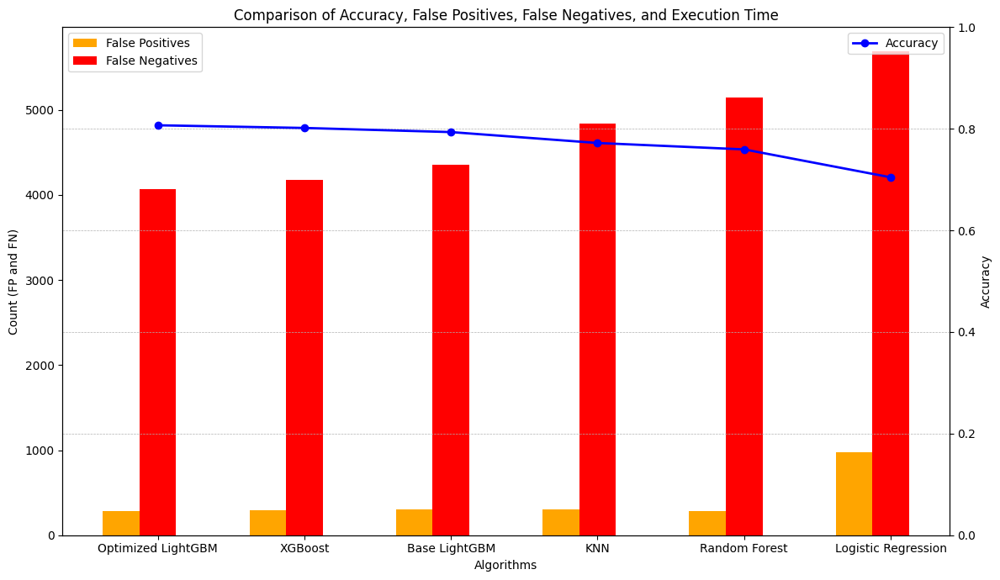

In [ ]:
# Example data (replace with your actual values)
# algorithms = ["KNN", "Logistic Regression", "SVM", "Random Forest", "XGBoost"]
# accuracy = [0.85, 0.88, 0.90, 0.92, 0.87]
# false_positives = [3000, 2500, 2000, 1500, 2200]
# false_negatives = [1000, 1200, 800, 500, 900]
execution_times = [1.2, 0.8, 1.5, 2.0, 1.3, 2.1]

# Combine data for sorting
accuracy_copy = accuracy.copy()
algorithms_copy = algorithms.copy()
false_positives_copy = false_positives.copy()
false_negatives_copy = false_negatives.copy()
execution_times_copy = execution_times.copy()

data = list(zip(accuracy_copy, algorithms_copy, false_positives_copy, false_negatives_copy, execution_times_copy))
data.sort(reverse=True, key=lambda x: x[0])  # Sort by accuracy in descending order

# Unpack sorted data
accuracy_copy, algorithms_copy, false_positives_copy, false_negatives_copy, execution_times_copy = zip(*data)
x = np.arange(len(algorithms_copy))  # Positions for groups

width = 0.25  # Bar width

# Create figure and primary y-axis
fig, ax1 = plt.subplots(figsize=(12, 7))

# Plot FP and FN on the primary y-axis
bar1 = ax1.bar(x - width, false_positives_copy, width, label="False Positives", color="orange")
bar2 = ax1.bar(x, false_negatives_copy, width, label="False Negatives", color="red")

# Configure primary y-axis
ax1.set_ylabel("Count (FP and FN)")
ax1.set_xlabel("Algorithms")
ax1.set_xticks(x)
ax1.set_xticklabels(algorithms_copy)
ax1.legend(loc="upper left")

# Create secondary y-axis for accuracy
ax2 = ax1.twinx()
line1 = ax2.plot(x, accuracy_copy, label="Accuracy", color="blue", marker="o", linewidth=2)
ax2.set_ylabel("Accuracy")
ax2.set_ylim(0, 1)  # Accuracy is between 0 and 1
ax2.legend(loc="upper right")

# Create tertiary y-axis for execution time
# ax3 = ax1.twinx()
# ax3.spines.right.set_position(("outward", 60))  # Offset tertiary y-axis
# line2 = ax3.plot(x, execution_times_copy, label="Execution Time (s)", color="blue", marker="x", linestyle="--", linewidth=2)
# ax3.set_ylabel("Execution Time (seconds)")
# ax3.legend(loc="center right")

# Title and layout
ax2.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.title("Comparison of Accuracy, False Positives, False Negatives, and Execution Time")
plt.tight_layout()
plt.show()


In [ ]:
# SAVE THE PSO-OPTIMIZED LIGHTGBM MODEL
import joblib
# Output a pickle file to save the trained model
joblib.dump(clf, '/content/drive/MyDrive/AI Project - Concept Drift/Rodrigo/Optimized_lightGBM.pkl')

['/content/drive/MyDrive/AI Project - Concept Drift/Rodrigo/Optimized_lightGBM.pkl']

In [ ]:
# The trained model can be loaded directly for future testing
savestkrf = joblib.load('/content/drive/MyDrive/AI Project - Concept Drift/Rodrigo/Optimized_lightGBM.pkl')

In [ ]:
y_pred = savestkrf.predict(X_test)
print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred))
print(accuracy_score(y_test, y_pred))

[[9424  287]
 [4066 8767]]
              precision    recall  f1-score   support

           0       0.70      0.97      0.81      9711
           1       0.97      0.68      0.80     12833

    accuracy                           0.81     22544
   macro avg       0.83      0.83      0.81     22544
weighted avg       0.85      0.81      0.81     22544

0.8069109297374024


# Why is accuracy still low?

In [ ]:
# Accuracy still relatively low, why?

In [ ]:
# ADDED Reminder
print(f"train: {df1.shape}     {100 * np.round(df1.shape[0]/df.shape[0], 2)}%")
print(f"test: {df2.shape}     {100 * np.round(df2.shape[0]/df.shape[0], 2)}%")
print(f"total: {df.shape}")

train: (125973, 42)     85.0%
test: (22544, 42)     15.0%
total: (148517, 42)


In [ ]:
df = pd.read_csv("/content/drive/MyDrive/AI Project - Concept Drift/Rodrigo/NSL_KDD_binary(train+test).csv")
X = df.iloc[:, :-1].values
y = df.iloc[:, -1].values

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y, train_size = 0.1, test_size = 0.9, random_state = 0,shuffle=False)

In [ ]:
print(f"train: {X_train.shape}     {100 * np.round(X_train.shape[0]/df.shape[0], 2)}%")
print(f"test: {X_test.shape}     {100 * np.round(X_test.shape[0]/df.shape[0], 2)}%")
print(f"total: {df.shape}")

train: (14851, 41)     10.0%
test: (133666, 41)     90.0%
total: (148517, 42)


[LightGBM] [Info] Number of positive: 6932, number of negative: 7919
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004510 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2777
[LightGBM] [Info] Number of data points in the train set: 14851, number of used features: 34
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.466770 -> initscore=-0.133117
[LightGBM] [Info] Start training from score -0.133117
              precision    recall  f1-score   support

           0       0.93      0.99      0.96     69135
           1       0.99      0.92      0.96     64531

    accuracy                           0.96    133666
   macro avg       0.96      0.96      0.96    133666
weighted avg       0.96      0.96      0.96    133666

Accuracy: 0.9604237427618093


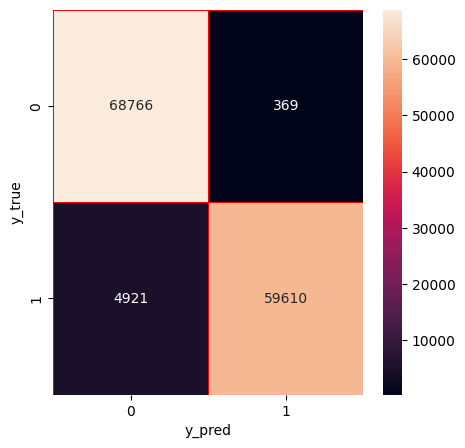

In [ ]:
# LightGBM algorithm
classifier = lgb.LGBMClassifier()
classifier.fit(X_train, y_train)
y_pred = classifier.predict(X_test)
print(classification_report(y_test,y_pred))
print("Accuracy: "+ str(accuracy_score(y_test, y_pred)))

# Plot the confusion matrix
cm=confusion_matrix(y_test,y_pred)
f,ax=plt.subplots(figsize=(5,5))
sns.heatmap(cm,annot=True,linewidth=0.5,linecolor="red",fmt=".0f",ax=ax)
plt.xlabel("y_pred")
plt.ylabel("y_true")
plt.show()

### Monitor Accuracy over time

In [ ]:
# Record the real-time accuracy based on timestamp/sample index
acc = []
acc_sum = 0
for i in range(0, len(y_test)):
    if y_test[i] == y_pred[i]:
        acc_sum = acc_sum + 1
    accuracy = acc_sum/(i+1)
    acc.append(accuracy)

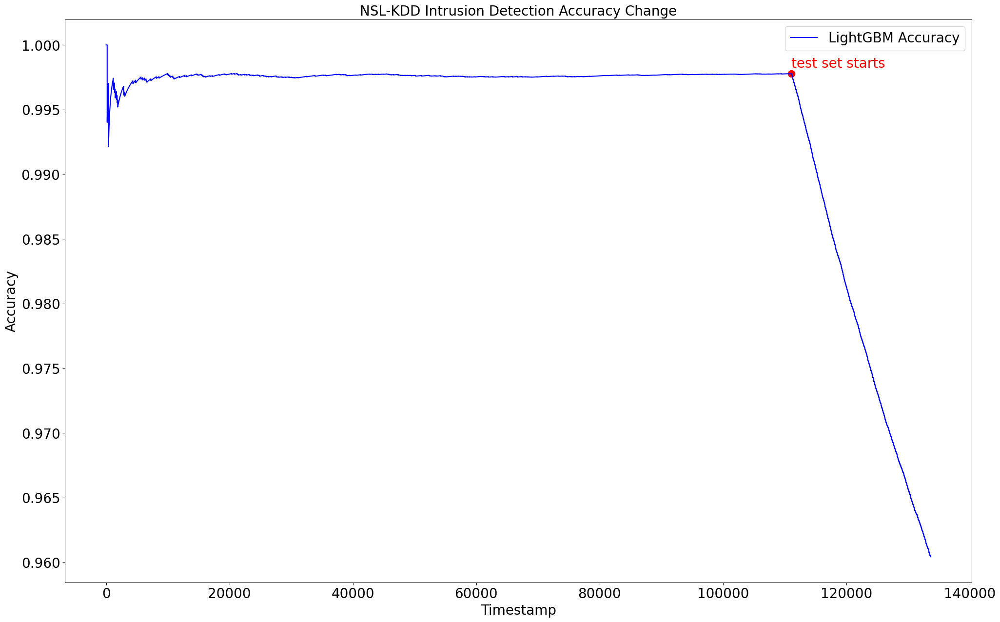

In [ ]:
# Plot the accuracy changes
plt.rcParams.update({'font.size': 20})
plt.figure(1,figsize=(24,15))
plt.clf()
plt.plot(acc,'-b',label='LightGBM Accuracy')

plt.scatter(len(df1)-len(X_train),acc[len(X_test)-len(df2)],s=100,c='r')
plt.text(len(df1)-len(X_train),acc[len(X_test)-len(df2)]+0.0005, 'test set starts', c='r')

plt.legend(loc='best')
plt.title('NSL-KDD Intrusion Detection Accuracy Change', fontsize=20)
plt.xlabel('Timestamp')
plt.ylabel('Accuracy')

plt.draw()

In [ ]:
# ADDED
X_train = df1.iloc[:, :-1].values
y_train = df1.iloc[:, -1].values
X_test = df2.iloc[:, :-1].values
y_test = df2.iloc[:, -1].values

In [ ]:
#sum(y_train_pred == y_train)/len(y_train)

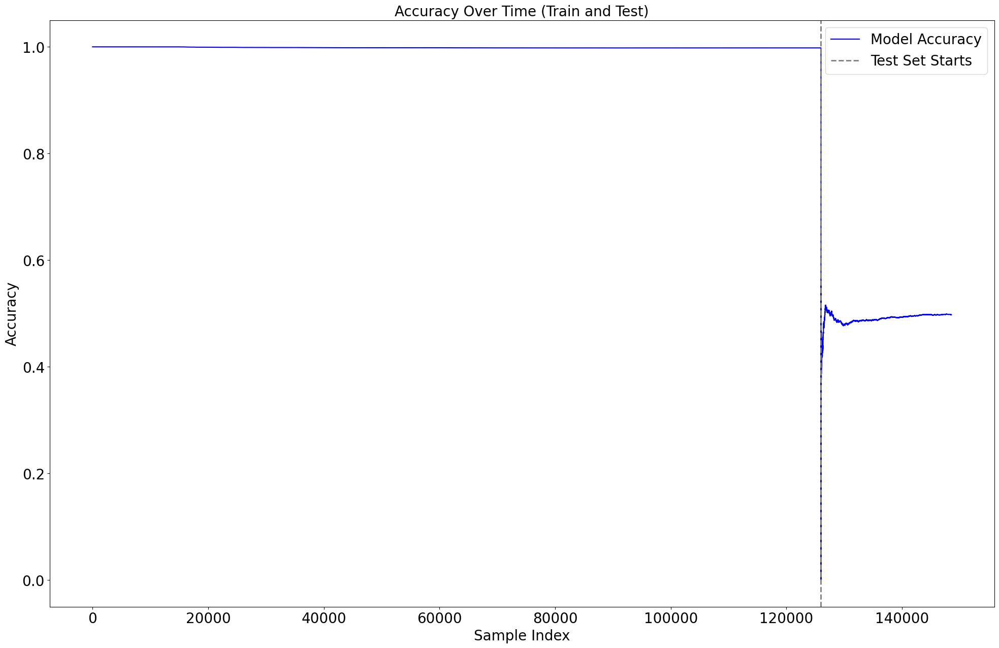

In [ ]:
# ADDED
# Calculate real-time accuracy for train data
train_acc = []
train_acc_sum = 0



# Predict on the entire training set once
y_train_pred = classifier.predict(X_train)

# Calculate cumulative training accuracy
train_acc = []
train_acc_sum = 0
for i in range(len(y_train)):
    if y_train[i] == y_train_pred[i]:  # Compare actual and predicted labels
        train_acc_sum += 1
    accuracy = train_acc_sum / (i + 1)
    train_acc.append(accuracy)


# Calculate real-time accuracy for test data
test_acc = []
test_acc_sum = 0
for i in range(0, len(y_test)):
    if y_test[i] == y_pred[i]:  # Use test predictions
        test_acc_sum += 1
    accuracy = test_acc_sum / (i + 1)
    test_acc.append(accuracy)

# Combine train and test accuracies for plotting
combined_acc = train_acc + test_acc
test_start_index = len(train_acc)  # Test data starts after train data ends

# Plot
plt.rcParams.update({'font.size': 20})
plt.figure(1, figsize=(24, 15))
plt.clf()

# Plot accuracy over time
plt.plot(combined_acc, '-b', label='Model Accuracy')

# Add vertical line and annotation for test set start
plt.axvline(x=test_start_index, color='gray', linestyle='--', linewidth=2, label='Test Set Starts')
# plt.text(test_start_index, combined_acc[test_start_index] + 0.01, 'Test Set Starts', color='r', fontsize=18)

# Labels and legend
plt.legend(loc='best')
plt.title('Accuracy Over Time (Train and Test)', fontsize=20)
plt.xlabel('Sample Index')
plt.ylabel('Accuracy')

# Display plot
plt.show()


The samples in the training set have similar statistical distribution.

However, when the statistical distribution from the training set to the test set has changed.

Hence, the model trained on the training set cannot accurately detect attacks in the test set.

In the figure, it can be seen that when the test set starts, the current accuracy starts to drop significantly due to the statistical distribution change in the dataset.

This kind of statistical distribution change is called concept drift.

# Notebook 3


In [ ]:
!pip install river

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.9/89.9 kB 4.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.8/60.8 kB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 20.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.1/13.1 MB 56.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.2/41.2 MB 21.7 MB/s eta 0:00:00
  Attempting uninstall: scipy
    Found existing installation: scipy 1.13.1
    Uninstalling scipy-1.13.1:
      Successfully uninstalled scipy-1.13.1
  Attempting uninstall: pandas
    Found existing installation: pandas 2.2.2
    Uninstalling pandas-2.2.2:
      Successfully uninstalled pandas-2.2.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
cudf-cu12 24.10.1 requires pandas<2.2.3dev0,>=2.0, but you have pandas 2.2.3 which is incompatible.
gensim 4.3.3 requires scipy

In [ ]:
from river import metrics
from river import stream

In [ ]:
# Use the last 10% of training set and the entire test set

In [ ]:
df_used = int(len(df1)*0.1) + len(df2)
df0 = df.iloc[-df_used:]

In [ ]:
df0

,duration,protocol_type,service,flag,src_bytes,dst_bytes,land,wrong_fragment,urgent,hot,...,dst_host_srv_count,dst_host_same_srv_rate,dst_host_diff_srv_rate,dst_host_same_src_port_rate,dst_host_srv_diff_host_rate,dst_host_serror_rate,dst_host_srv_serror_rate,dst_host_rerror_rate,dst_host_srv_rerror_rate,label
113376,0,1,54,9,1132,366,0,0,0,0,...,148,0.88,0.08,0.03,0.01,0.00,0.0,0.00,0.00,0
113377,0,1,24,9,256,3123,0,0,0,0,...,255,1.00,0.00,0.01,0.02,0.00,0.0,0.00,0.00,0
113378,1,1,54,9,2215,333,0,0,0,0,...,99,0.39,0.08,0.00,0.00,0.02,0.0,0.00,0.00,0
113379,0,1,5,5,0,0,0,0,0,0,...,1,0.00,0.07,0.00,0.00,1.00,1.0,0.00,0.00,1
113380,0,1,56,5,0,0,0,0,0,0,...,1,0.00,0.08,0.00,0.00,1.00,1.0,0.00,0.00,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
148512,0,1,49,9,794,333,0,0,0,0,...,141,0.72,0.06,0.01,0.01,0.01,0.0,0.00,0.00,0
148513,0,1,22,9,317,938,0,0,0,0,...,255,1.00,0.00,0.01,0.01,0.01,0.0,0.00,0.00,0
148514,0,1,22,9,54540,8314,0,0,0,2,...,255,1.00,0.00,0.00,0.00,0.00,0.0,0.07,0.07,1
148515,0,2,11,9,42,42,0,0,0,0,...,252,0.99,0.01,0.00,0.00,0.00,0.0,0.00,0.00,0


## Train-test split

10% training set, 90% test set


In [ ]:
X = df0.drop(['label'],axis=1)
y = df0['label']
X_train, X_test, y_train, y_test = train_test_split(X,y, train_size = 0.1, test_size = 0.9, shuffle=False, random_state = 0)

## Offline learning: LightGBM

In [ ]:
# ADDED
!pip install memory_profiler

In [ ]:
%%time
import memory_profiler as mem_profile
m1 = mem_profile.memory_usage()
print('Memory (Before): ' + str(m1[0]) + ' MB' )

classifier = lgb.LGBMClassifier()
# classifier = joblib.load('Optimized_lightGBM.pkl')
classifier.fit(X_train,y_train)
predictions = classifier.predict(X_test)
print("Accuracy: "+str(accuracy_score(y_test,predictions)))

m2 = mem_profile.memory_usage()
print('Memory (After) : ' + str(m2[0]) + ' MB')
print('Memory Consumption : ' + str(m2[0]-m1[0]) + ' MB')

Memory (Before): 674.1875 MB
[LightGBM] [Info] Number of positive: 1599, number of negative: 1915
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001427 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2049
[LightGBM] [Info] Number of data points in the train set: 3514, number of used features: 31
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.455037 -> initscore=-0.180339
[LightGBM] [Info] Start training from score -0.180339
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Accuracy: 0.8420969424858507
Memory (After) : 674.4453125 MB
Memory Consumption : 0.2578125 MB
CPU times: user 505 ms, sys: 7.62 ms, total: 512 ms
Wall time: 1.22 s


# OASW

In [ ]:
from hyperopt import hp, fmin, tpe, STATUS_OK, Trials

# a: warning threshold, b: drift threshold, win1: sliding window size, win2: adaptive window max size
def oasw_bo(params):

    a=abs(float(params['a']))
    b=abs(float(params['b']))
    win1=int(params['win1'])
    win2=int(params['win2'])

    i=0
    yt = []
    yp = []
    x_new=[]
    y_new=[]
    dr=[0]
    d=0
    f=0
    tt=0
    th=0
    xt=[]

    metric = metrics.Accuracy()

    classifier = lgb.LGBMClassifier() # Train the initial LightGBM model
    classifier.fit(X_train,y_train)

    for xi, yi in stream.iter_pandas(X_test, y_test):

        xi2=np.array(list(xi.values()))
        y_pred = classifier.predict(xi2.reshape(1, -1))      # make a prediction

        ## MODIFIED
        # metric = metric.update(yi, y_pred)  # update the metric
        metric.update(yi, y_pred[0])


        # Store the y_test, y_pred, and x_test
        yt.append(yi)
        yp.append(y_pred)
        xt.append(xi2)

        # Monitor the accuracy changes in the sliding window
        if i>2*win1:
            acc1=accuracy_score(yt[i-win1:],yp[i-win1:]) # Current window accuracy
            acc2=accuracy_score(yt[i-2*win1:i-win1],yp[i-2*win1:i-win1]) # Last window accuracy
            if (d==0)&(acc1<a*acc2): # If the window accuracy drops to the warning level
                x_new.append(xi2)
                y_new.append(yi)
                d=1
            if d==1: # In the warning level
                tt=len(y_new)
                if acc1<b*acc2: # If the window accuracy drops to the drift level
                    dr.append(i)# Record the drift start point
                    f=i
                    if tt<win1: # if enough new concept samples are collected
                        classifier.fit(xt[i-win1:],yt[i-win1:])
                    else:
                        classifier.fit(x_new,y_new)
                    d=2
                elif (acc1>a*acc2)|(tt==win2): # If the window accuracy increases back to the normal level (false alarm)
                    x_new=[]
                    y_new=[]
                    d=0
                else:
                    x_new.append(xi2)
                    y_new.append(yi)
            if d==2: # In the drift level
                tt=len(y_new)
                acc3=accuracy_score(yt[f:f+win1],yp[f:f+win1])
                x_new.append(xi2)
                y_new.append(yi)
                if tt>=win1:
                    if (acc1<a*acc3): # When new concept accuracy drops to the warning level
                        if th==0:
                            classifier.fit(x_new,y_new) # Retrain the classifier on all the newly collected samples to obtain a robust classifier
                            th=1
                    if (th==1)&(tt==win2): # When sufficient new concept samples are collected
                        classifier.fit(x_new,y_new) #obtain a robust classifier
                        x_new=[]
                        y_new=[]
                        d=0 # Go back to the normal state for next potential drift detection
                        th=0

        i=i+1
    score=metric.get()
    print(str(a)+" "+str(b)+" "+str(win1)+" "+str(win2)+" "+str(score)) # Output the hyperparameter values and corresponding accuracy
    return {'loss': -score, 'status': STATUS_OK }


## Hyperparameter optimization by BO-TPE

In [ ]:
# WARNING: the cell below takes very long to run

In [ ]:
from hyperopt import hp, fmin, tpe, STATUS_OK, Trials
space = {
    'a': hp.quniform('a', 0.95, 0.99, 0.001),
    'b': hp.quniform('b', 0.90, 0.98, 0.001),
    'win1': hp.quniform('win1', 200, 1000, 50),
    'win2': hp.quniform('win2', 1000, 5000, 100),
}

t1=time.time()
best = fmin(fn=oasw_bo,
            space=space,
            algo=tpe.suggest,
            max_evals=10)
print("Hyperopt estimated optimum {}".format(best))
t2=time.time()
print(t2-t1)

[LightGBM] [Info] Number of positive: 1599, number of negative: 1915
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001263 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2049
[LightGBM] [Info] Number of data points in the train set: 3514, number of used features: 31
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.455037 -> initscore=-0.180339
[LightGBM] [Info] Start training from score -0.180339
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 436, number of negative: 465
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001479 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[L

KeyboardInterrupt: 

## Hyperparameter optimization by PSO

In [ ]:
def oasw(a=0.99, b=0.95, win1=200, win2=1000):
    a = round(a, 3)
    b = round(b, 3)
    win1 = round(win1)
    win2 = round(win2)

    i=0
    yt = []
    yp = []
    x_new=[]
    y_new=[]
    dr=[0]
    d=0
    f=0
    tt=0
    th=0
    xt=[]

    metric = metrics.Accuracy()

    classifier = lgb.LGBMClassifier() # Train the initial LightGBM model
    classifier.fit(X_train,y_train)

    for xi, yi in stream.iter_pandas(X_test, y_test):

        xi2=np.array(list(xi.values()))
        y_pred = classifier.predict(xi2.reshape(1, -1))      # make a prediction

        ## MODIFIED
        # metric = metric.update(yi, y_pred)  # update the metric
        metric.update(yi, y_pred[0]) # y_pred[0]


        # Store the y_test, y_pred, and x_test
        yt.append(yi)
        yp.append(y_pred)
        xt.append(xi2)

        # Monitor the accuracy changes in the sliding window
        if i>2*win1:
            acc1=accuracy_score(yt[i-win1:],yp[i-win1:]) # Current window accuracy
            acc2=accuracy_score(yt[i-2*win1:i-win1],yp[i-2*win1:i-win1]) # Last window accuracy
            if (d==0)&(acc1<a*acc2): # If the window accuracy drops to the warning level
                x_new.append(xi2)
                y_new.append(yi)
                d=1
            if d==1: # In the warning level
                tt=len(y_new)
                if acc1<b*acc2: # If the window accuracy drops to the drift level
                    dr.append(i)# Record the drift start point
                    f=i
                    if tt<win1: # if enough new concept samples are collected
                        classifier.fit(xt[i-win1:],yt[i-win1:])
                    else:
                        classifier.fit(x_new,y_new)
                    d=2
                elif (acc1>a*acc2)|(tt==win2): # If the window accuracy increases back to the normal level (false alarm)
                    x_new=[]
                    y_new=[]
                    d=0
                else:
                    x_new.append(xi2)
                    y_new.append(yi)
            if d==2: # In the drift level
                tt=len(y_new)
                acc3=accuracy_score(yt[f:f+win1],yp[f:f+win1])
                x_new.append(xi2)
                y_new.append(yi)
                if tt>=win1:
                    if (acc1<a*acc3): # When new concept accuracy drops to the warning level
                        if th==0:
                            classifier.fit(x_new,y_new) # Retrain the classifier on all the newly collected samples to obtain a robust classifier
                            th=1
                    if (th==1)&(tt==win2): # When sufficient new concept samples are collected
                        classifier.fit(x_new,y_new) #obtain a robust classifier
                        x_new=[]
                        y_new=[]
                        d=0 # Go back to the normal state for next potential drift detection
                        th=0

        i=i+1
    score=metric.get()
    print(str(a)+" "+str(b)+" "+str(win1)+" "+str(win2)+" "+str(score)) # Output the hyperparameter values and corresponding accuracy
    return score

In [ ]:
!pip install optunity

In [ ]:
# WARNING: the cell below takes very long to run

In [ ]:
import optunity
search = {
    'a': [0.95,0.99],
    'b': [0.90,0.98],
    'win1': [200,1000],
    'win2': [1000,5000],
         }

optimal_configuration, info, _ = optunity.maximize(oasw,
                                                  solver_name='particle swarm',
                                                  num_evals=10,
                                                   **search
                                                  )
print(optimal_configuration)
print("Accuracy:"+ str(info.optimum))

[LightGBM] [Info] Number of positive: 1599, number of negative: 1915
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001095 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2049
[LightGBM] [Info] Number of data points in the train set: 3514, number of used features: 31
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.455037 -> initscore=-0.180339
[LightGBM] [Info] Start training from score -0.180339
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 388, number of negative: 392
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000342 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[L

KeyboardInterrupt: 

# Train the optimized OASW model with optimal hyperparameters

In [ ]:
# Define OASW with a figure
def oasw_plot(a=0.99, b=0.95, win1=200, win2=1000):
    a = round(a, 3)
    b = round(b, 3)
    win1 = round(win1)
    win2 = round(win2)

    metric = metrics.Accuracy()
    metric2 = metrics.Accuracy()

    i = 0
    t = []
    yt = []
    yp = []
    m = []
    m2 = []
    x_new=[]
    y_new=[]
    dr=[0]
    d=0
    f=0
    tt=0
    th=0
    xt=[]

    classifier = lgb.LGBMClassifier() # Train the initial LightGBM model
    classifier.fit(X_train,y_train)

    classifier2 = lgb.LGBMClassifier() # Train an offline LightGBM model as a comparison model
    classifier2.fit(X_train,y_train)

    for xi, yi in stream.iter_pandas(X_test, y_test):

        xi2=np.array(list(xi.values()))
        y_pred = classifier.predict(xi2.reshape(1, -1))      # make a prediction
        metric.update(yi, y_pred[0])  # update the metric

        y_pred2= classifier2.predict(xi2.reshape(1, -1))
        metric2.update(yi, y_pred2[0])

        # Store the y_test, y_pred, x_test, and real-time accuracy
        t.append(i)
        m.append(metric.get()*100)
        yt.append(yi)
        yp.append(y_pred)
        m2.append(metric2.get()*100)
        xt.append(xi2)

        # Monitor the accuracy changes in the sliding window
        if i>2*win1:
            acc1=accuracy_score(yt[i-win1:],yp[i-win1:]) # Current window accuracy
            acc2=accuracy_score(yt[i-2*win1:i-win1],yp[i-2*win1:i-win1]) # Last window accuracy
            if (d==0)&(acc1<a*acc2): # If the window accuracy drops to the warning level
                x_new.append(xi2)
                y_new.append(yi)
                d=1
            if d==1: # In the warning level
                tt=len(y_new)
                if acc1<b*acc2: # If the window accuracy drops to the drift level
                    dr.append(i)# Record the drift start point
                    f=i
                    if tt<win1: # if enough new concept samples are collected
                        classifier.fit(xt[i-win1:],yt[i-win1:])
                    else:
                        classifier.fit(x_new,y_new)
                    d=2
                elif (acc1>a*acc2)|(tt==win2): # If the window accuracy increases back to the normal level (false alarm)
                    x_new=[]
                    y_new=[]
                    d=0
                else:
                    x_new.append(xi2)
                    y_new.append(yi)

            if d==2: # In the drift level
                tt=len(y_new)
                acc3=accuracy_score(yt[f:f+win1],yp[f:f+win1])
                x_new.append(xi2)
                y_new.append(yi)
                if tt>=win1:
                    if (acc1<a*acc3): # When new concept accuracy drops to the warning level
                        if th==0:
                            classifier.fit(x_new,y_new) # Retrain the classifier on all the newly collected samples to obtain a robust classifier
                            th=1
                    if (th==1)&(tt==win2): # When sufficient new concept samples are collected
                        classifier.fit(x_new,y_new) #obtain a robust classifier
                        x_new=[]
                        y_new=[]
                        d=0 # Go back to the normal state for next potential drift detection
                        th=0

        i=i+1

    # Plot the accuracy change figure
    plt.rcParams.update({'font.size': 35})
    plt.ion()
    plt.figure(1,figsize=(24,15))
    sns.set_style("darkgrid")
    plt.clf()
    plt.plot(t,m,'-b',label='OASW+LightGBM, Avg Accuracy: %.2f%%'%(metric.get()*100))
    plt.plot(t,m2,'red',label='Offline LightGBM, Avg Avg Accuracy: %.2f%%'%(metric2.get()*100))

    #Plot the drift points
    for i in range(len(dr)):
        if i!=0:
            plt.scatter(dr[i],m[dr[i]],s=200,c='r')

    plt.legend(loc='best')
    plt.ylim(80, 101)
    plt.title('NSL-KDD', fontsize=40)
    plt.xlabel('Number of samples')
    plt.ylabel('Accuracy(%)')

    plt.draw()

[LightGBM] [Info] Number of positive: 1599, number of negative: 1915
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001219 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2049
[LightGBM] [Info] Number of data points in the train set: 3514, number of used features: 31
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.455037 -> initscore=-0.180339
[LightGBM] [Info] Start training from score -0.180339
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 1599, number of negative: 1915
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001155 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.


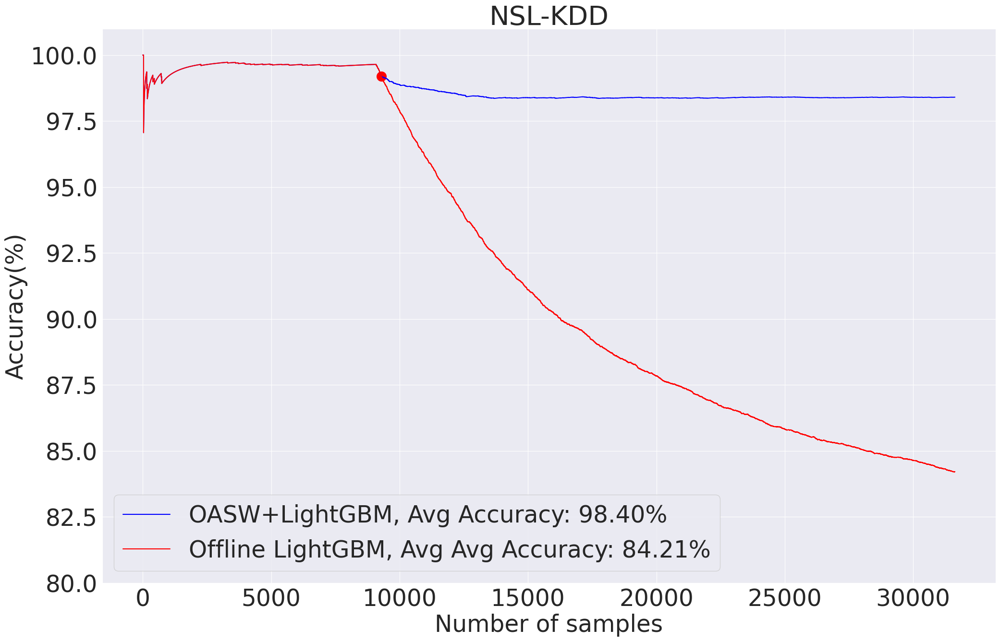

In [ ]:
# Assign the optimal hyperparameters detected by PSO
oasw_plot(a = 0.978, b = 0.931, win1 = 611, win2 = 4320)

# Notebook 4

Aims:

  1): Develop a real-time classifier with concept drift detection
  
  2): Plot a figure/gif to show the real-time prediction results that can be updated over time.

Use the last 10% of training set and the entire test set

In [ ]:
df_used = int(len(df1)*0.1) + len(df2)
df0 = df.iloc[-df_used:]

10% training set, and 90% test set

In [ ]:
X = df0.drop(['label'],axis=1)
y = df0['label']
X_train, X_test, y_train, y_test = train_test_split(X,y, train_size = 0.1, test_size = 0.9, shuffle=False, random_state = 0)

### Offline learning: LightGBM

In [ ]:
classifier = lgb.LGBMClassifier()
# classifier = joblib.load('Optimized_lightGBM.pkl')
classifier.fit(X_train,y_train)
predictions = classifier.predict(X_test)
print("Accuracy: "+str(accuracy_score(y_test,predictions)))

[LightGBM] [Info] Number of positive: 1599, number of negative: 1915
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001356 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2049
[LightGBM] [Info] Number of data points in the train set: 3514, number of used features: 31
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.455037 -> initscore=-0.180339
[LightGBM] [Info] Start training from score -0.180339
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Accuracy: 0.8420969424858507


In [ ]:
!pip install PyQt5
!pip install PySide2

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 164.3/164.3 MB 4.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 975.4/975.4 kB 35.3 MB/s eta 0:00:00


In [ ]:
# %matplotlib qt5
%matplotlib inline

def oasw_real_time(a=0.99, b=0.95, win1=200, win2=1000):
    a = round(a, 3)
    b = round(b, 3)
    win1 = round(win1)
    win2 = round(win2)

    plt.ion() #start interactive mode
    #plt.figure(1, constrained_layout=True)
    plt.figure(1,figsize=(12,7.5))
    sns.set_style("darkgrid")

    metric = metrics.Accuracy()
    metric2 = metrics.Accuracy()

    i = 0
    t = []
    yt = []
    yp = []
    m = []
    m2 = []
    x_new=[]
    y_new=[]
    dr=[0]
    d=0
    f=0
    tt=0
    th=0
    xt=[]

    classifier = lgb.LGBMClassifier() # Train the initial LightGBM model
    classifier.fit(X_train,y_train)

    classifier2 = lgb.LGBMClassifier() # Train an offline LightGBM model as a comparison model
    classifier2.fit(X_train,y_train)

    for xi, yi in stream.iter_pandas(X_test, y_test):

        xi2=np.array(list(xi.values()))
        y_pred = classifier.predict(xi2.reshape(1, -1))      # make a prediction

        ## MODIFIED
        # metric = metric.update(yi, y_pred)  # update the metric
        metric.update(yi, y_pred[0])  # update the metric

        y_pred2= classifier2.predict(xi2.reshape(1, -1))
        # metric2 = metric2.update(yi, y_pred2)
        metric2.update(yi, y_pred2[0])


        # Store the y_test, y_pred, x_test, and real-time accuracy
        t.append(i)
        m.append(metric.get()*100)
        yt.append(yi)
        yp.append(y_pred)
        m2.append(metric2.get()*100)
        xt.append(xi2)

        # Monitor the accuracy changes in the sliding window
        if i>2*win1:
            acc1=accuracy_score(yt[i-win1:],yp[i-win1:]) # Current window accuracy
            acc2=accuracy_score(yt[i-2*win1:i-win1],yp[i-2*win1:i-win1]) # Last window accuracy
            if (d==0)&(acc1<a*acc2): # If the window accuracy drops to the warning level
                x_new.append(xi2)
                y_new.append(yi)
                d=1
            if d==1: # In the warning level
                tt=len(y_new)
                if acc1<b*acc2: # If the window accuracy drops to the drift level
                    dr.append(i)# Record the drift start point
                    f=i
                    if tt<win1: # if enough new concept samples are collected
                        classifier.fit(xt[i-win1:],yt[i-win1:])
                    else:
                        classifier.fit(x_new,y_new)
                    d=2
                elif (acc1>a*acc2)|(tt==win2): # If the window accuracy increases back to the normal level (false alarm)
                    x_new=[]
                    y_new=[]
                    d=0
                else:
                    x_new.append(xi2)
                    y_new.append(yi)
            if d==2: # In the drift level
                tt=len(y_new)
                acc3=accuracy_score(yt[f:f+win1],yp[f:f+win1])
                x_new.append(xi2)
                y_new.append(yi)
                if tt>=win1:
                    if (acc1<a*acc3): # When new concept accuracy drops to the warning level
                        if th==0:
                            classifier.fit(x_new,y_new) # Retrain the classifier on all the newly collected samples to obtain a robust classifier
                            th=1
                    if (th==1)&(tt==win2): # When sufficient new concept samples are collected
                        classifier.fit(x_new,y_new) #obtain a robust classifier
                        x_new=[]
                        y_new=[]
                        d=0 # Go back to the normal state for next potential drift detection
                        th=0

        if i % 100 == 0:  # Update every 100 samples

            plt.clf()
            plt.figure(figsize=(15, 9))  # Larger figure size for better readability

            # Plot the data
            plt.plot(t, m, '-b', label='RMSE with drift', linewidth=1.5)  # Adjust line width
            plt.plot(t, m2, 'pink', label='RMSE without drift', linewidth=1.5)

            # Customize the legend
            plt.legend(loc='upper left', fontsize=12, bbox_to_anchor=(1.02, 1))  # Move legend outside the plot

            # Set title and subtitle
            plt.title('NSL-KDD Dataset Online Learning Results', fontsize=18, pad=15)
            plt.suptitle('NSL-KDD Dataset Results\nAvg Test Accuracy of Adaptive LightGBM: '
                        + str(round(metric.get() * 100, 2)) +
                        '\nAvg Test Accuracy of Offline LightGBM: ' +
                        str(round(metric2.get() * 100, 2)) +
                        '\nDrift detected at timestamps: ' + str(dr[1:]),
                        fontsize=12, verticalalignment='baseline')

            # Set axis labels and customize font size
            plt.xlabel('Number of samples', fontsize=14)
            plt.ylabel('Accuracy (%)', fontsize=14)

            # Fix y-axis range and format
            plt.ylim(90, 105)  # Adjust limits based on your data
            plt.yticks(fontsize=12)
            plt.xticks(fontsize=12)

            plt.grid(True, which='both', linestyle='--', linewidth=0.5)  # Optional grid for better visualization

            plt.tight_layout()  # Adjust layout to avoid overlap
            plt.draw()
            plt.pause(1)  # Ensure the graph is updated


        i=i+1

In [ ]:
# old

#     if i == (10000):
        plt.clf()
        plt.plot(t,m,'-b',label='RMSE with drift')
        plt.plot(t,m2,'pink',label='RMSE without drift')
        #plt.plot(t,yp,'-g',label='True values')
        #plt.plot(t,yt,'-r',label='Predicted values')
        plt.legend(loc='upper left')
        plt.title('NSL-KDD Dataset Online Learning Results', fontsize=15,pad =10)
        plt.suptitle('NSL-KDD Dataset Results'+'\nAvg Test Accuracy of Adaptive LightGBM: '+str(round(metric.get()*100, 2))+'\nAvg Test Accuracy of Offline LightGBM: '
                     +str(round(metric2.get()*100, 2))+'\nDrift detected at timestamps: '+str(dr[1:]), fontsize=10,verticalalignment='baseline')
        plt.xlabel('Number of samples')
        plt.ylabel('Accuracy (%)')

        plt.draw()

        plt.pause(0.000000001)

        i=i+1

[LightGBM] [Info] Number of positive: 1599, number of negative: 1915
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2049
[LightGBM] [Info] Number of data points in the train set: 3514, number of used features: 31
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.455037 -> initscore=-0.180339
[LightGBM] [Info] Start training from score -0.180339
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 1599, number of negative: 1915
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001029 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.


<Figure size 1200x750 with 0 Axes>

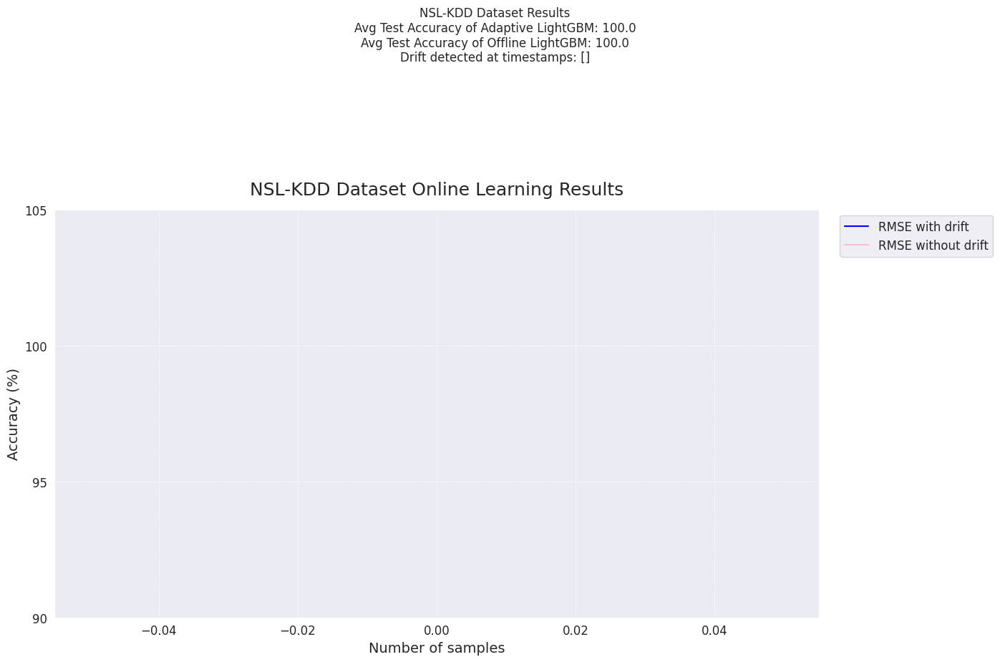

<Figure size 640x480 with 0 Axes>

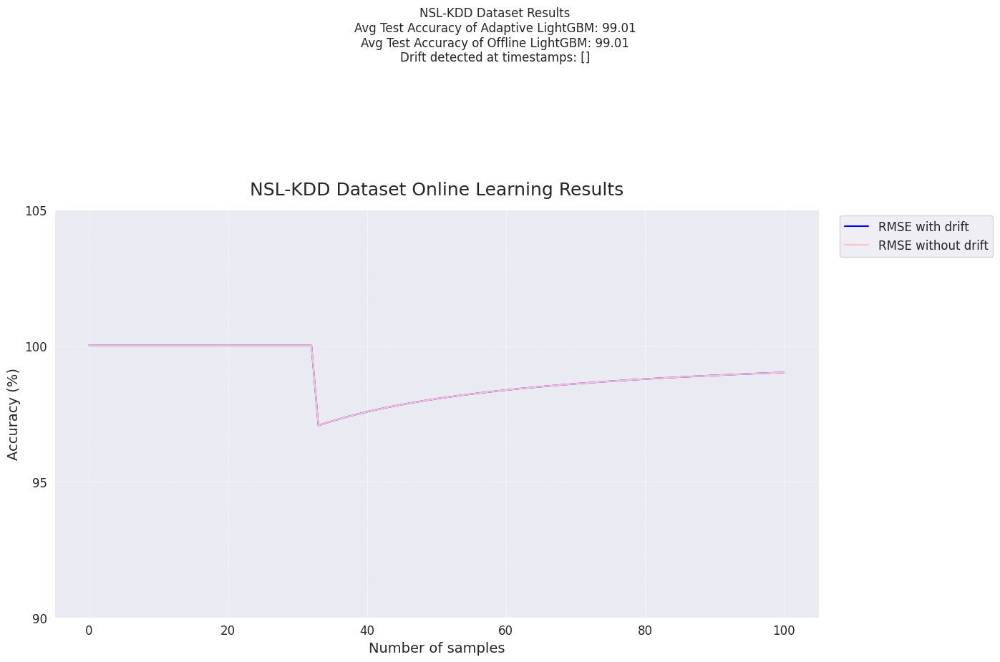

<Figure size 640x480 with 0 Axes>

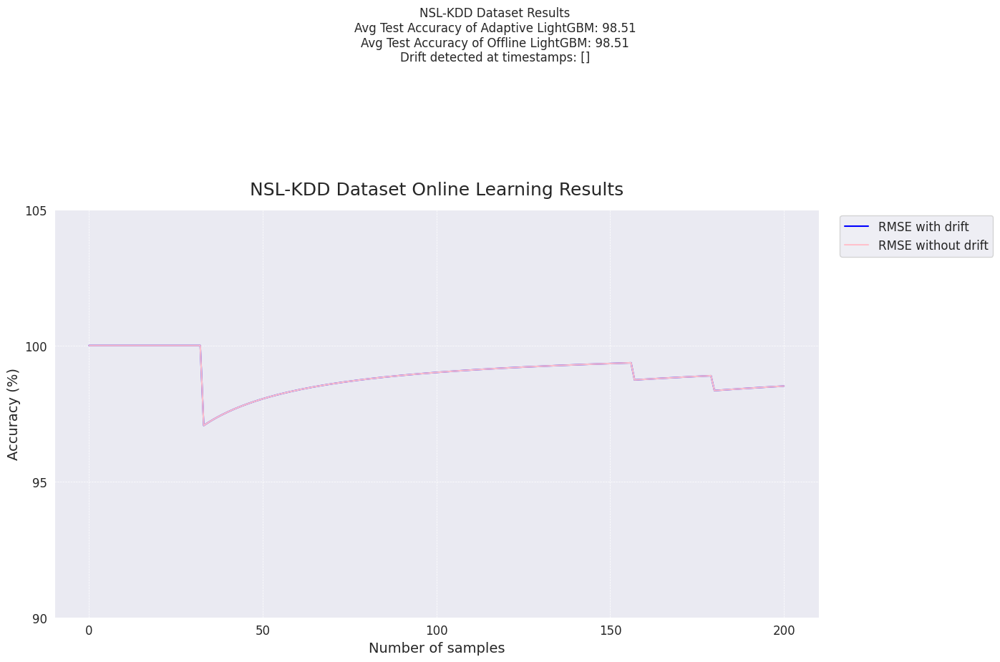

<Figure size 640x480 with 0 Axes>

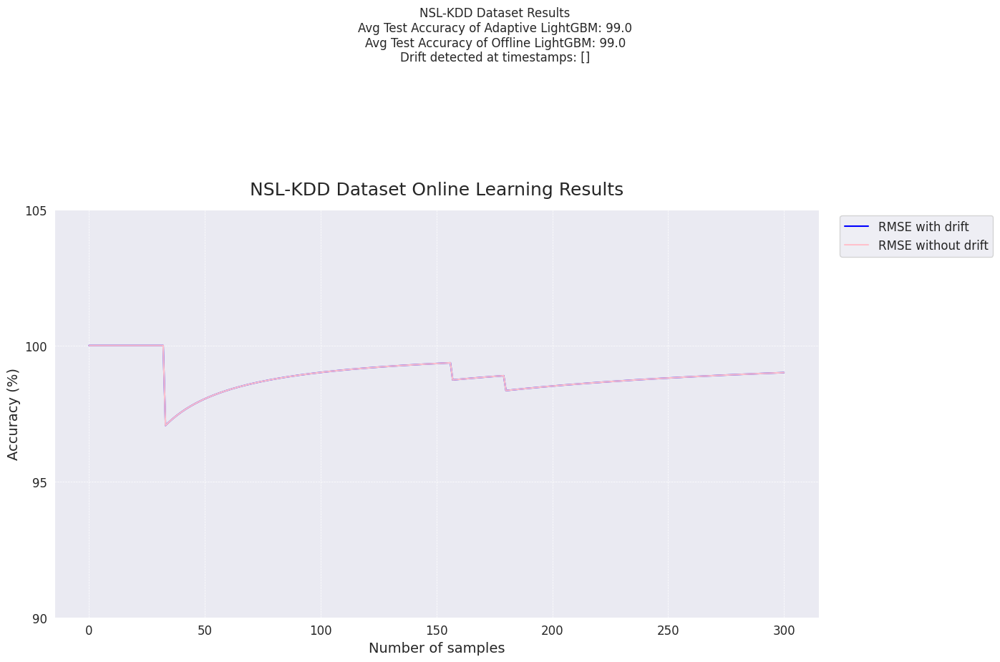

<Figure size 640x480 with 0 Axes>

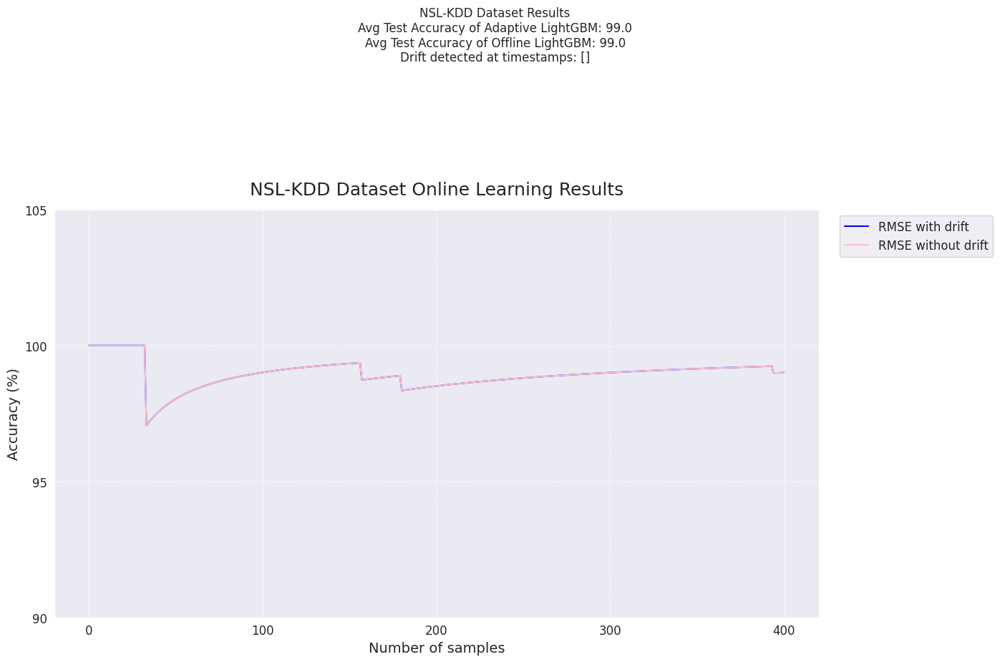

<Figure size 640x480 with 0 Axes>

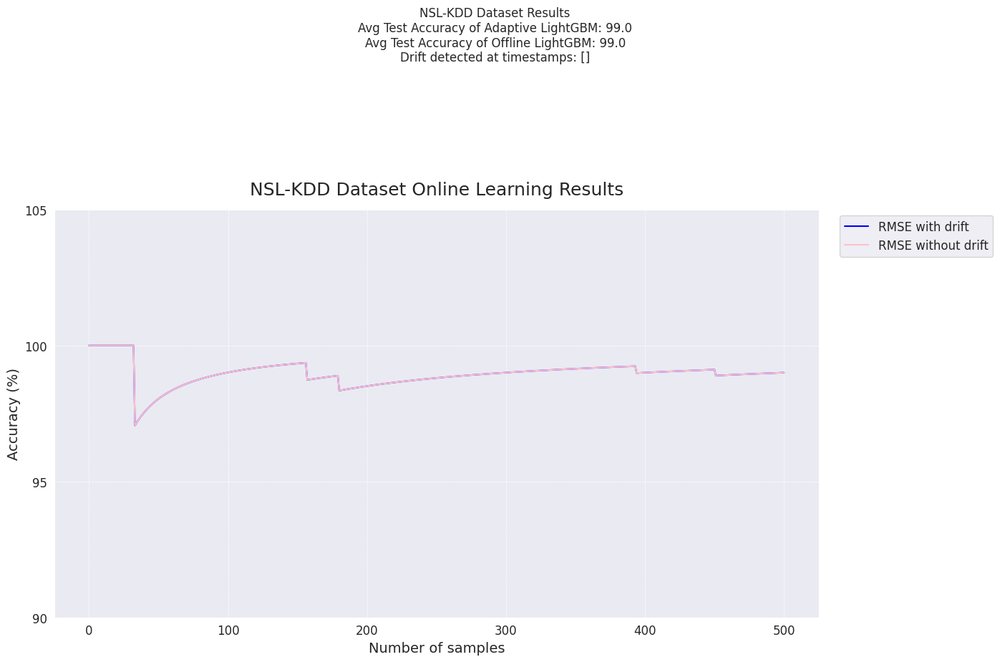

<Figure size 640x480 with 0 Axes>

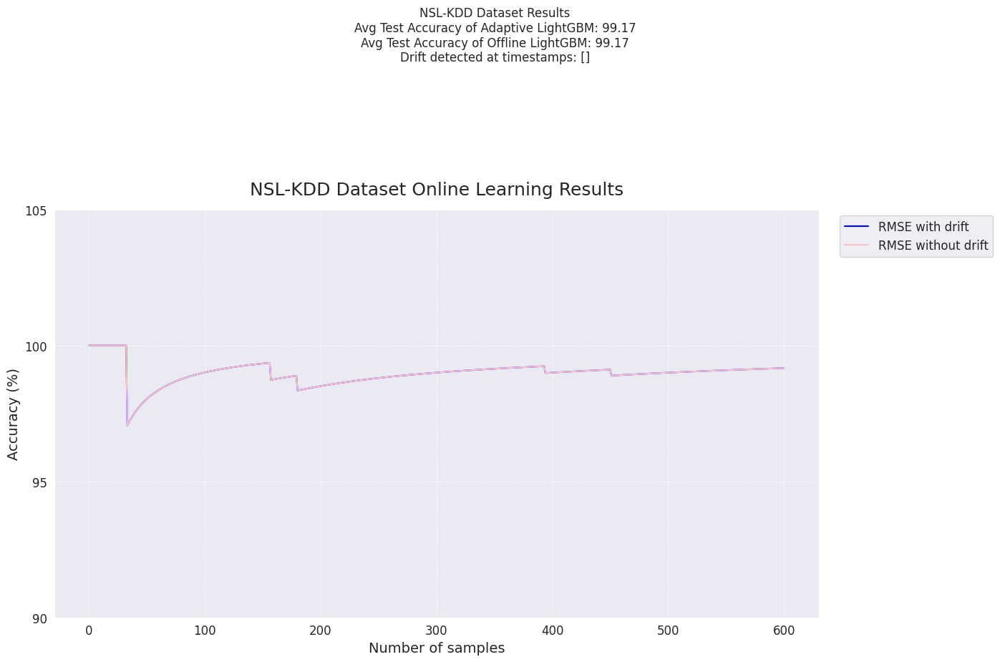

<Figure size 640x480 with 0 Axes>

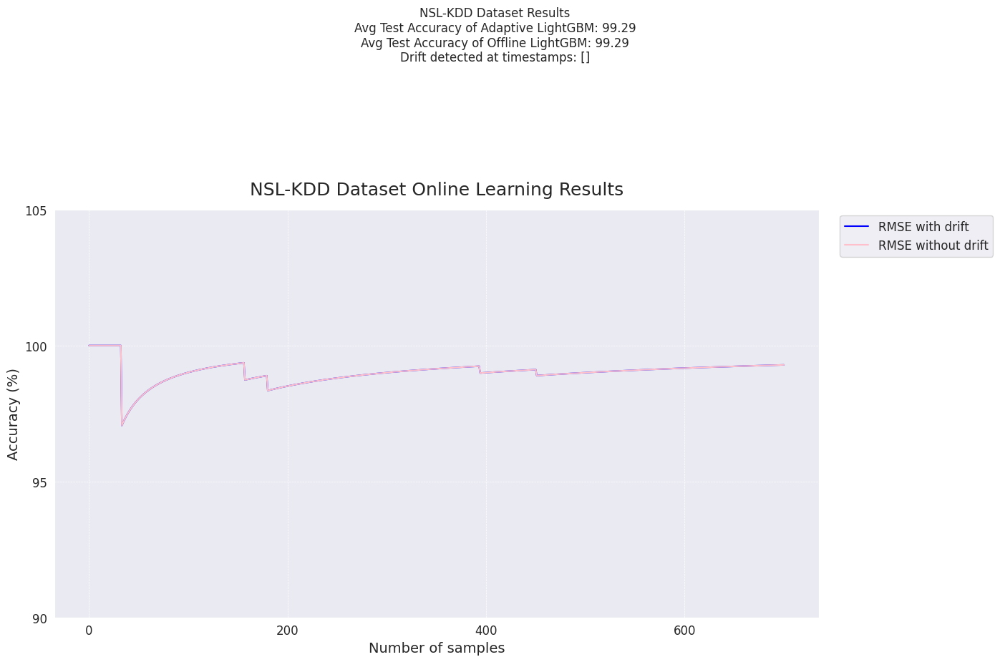

<Figure size 640x480 with 0 Axes>

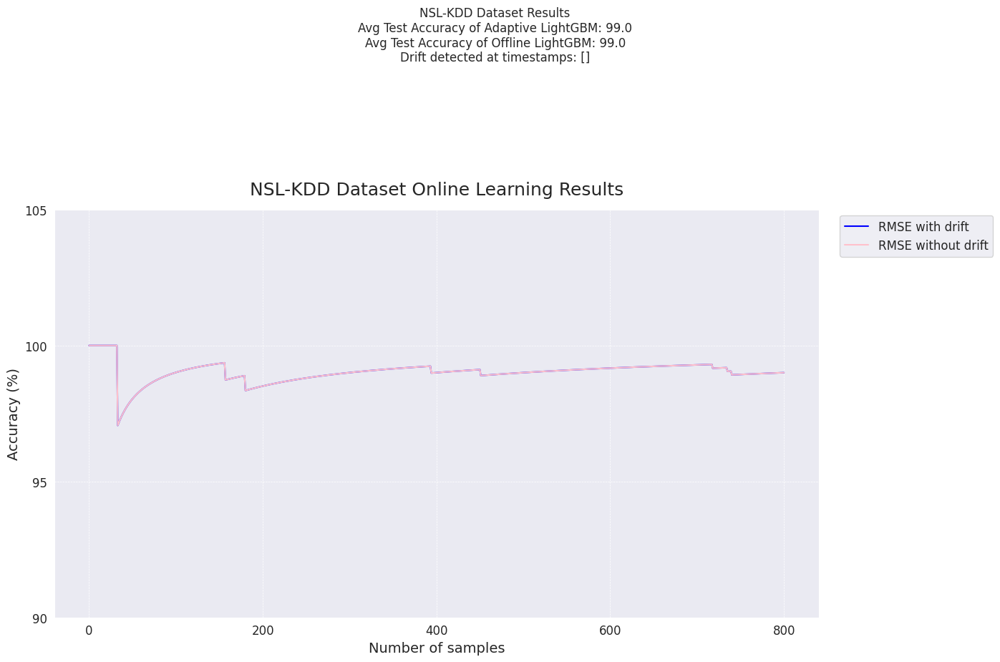

<Figure size 640x480 with 0 Axes>

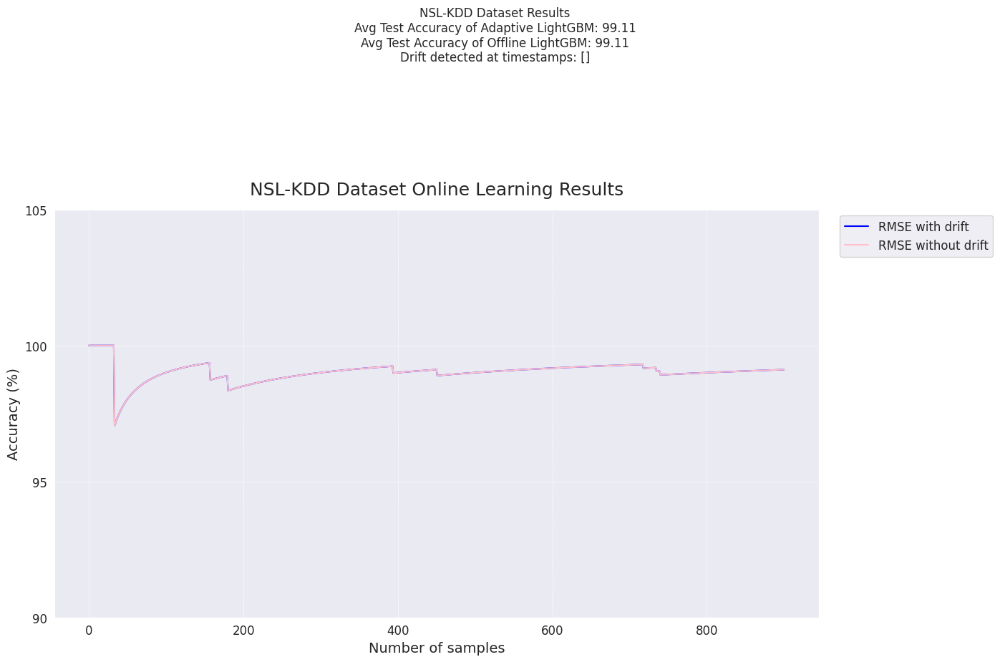

<Figure size 640x480 with 0 Axes>

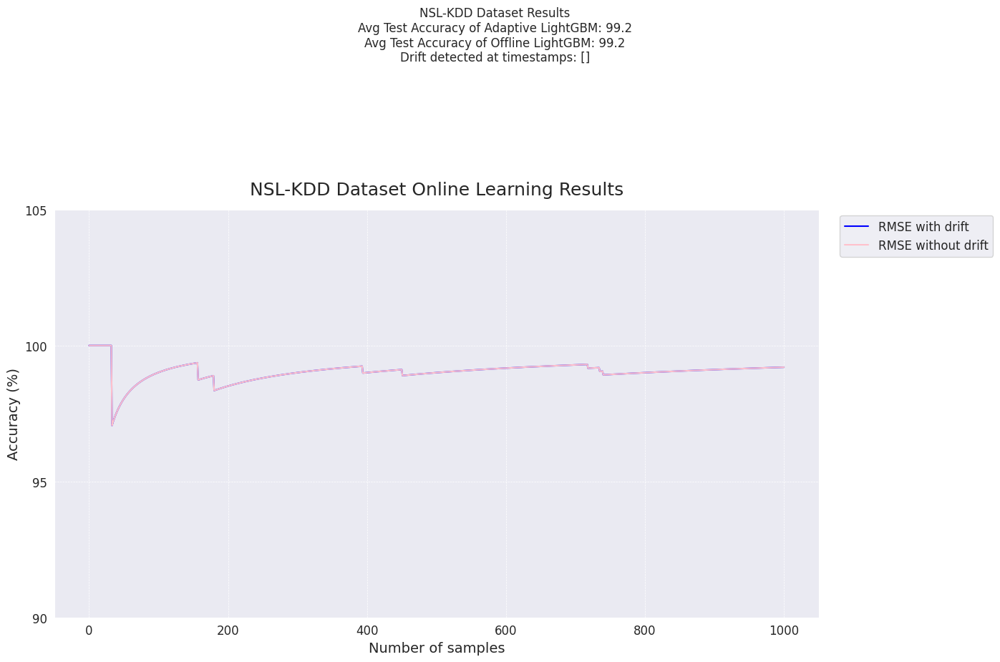

<Figure size 640x480 with 0 Axes>

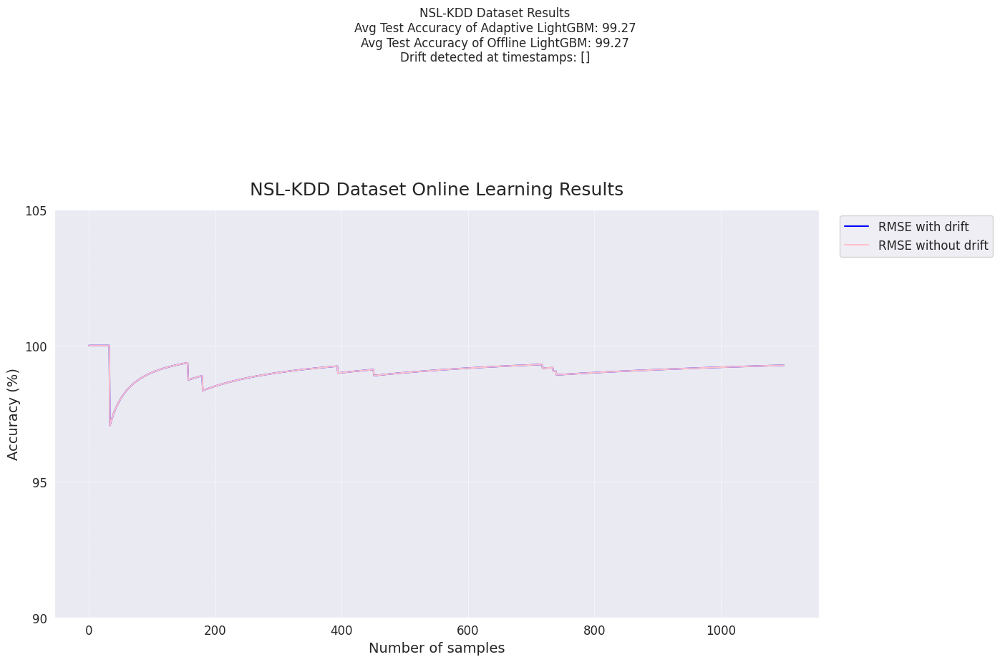

<Figure size 640x480 with 0 Axes>

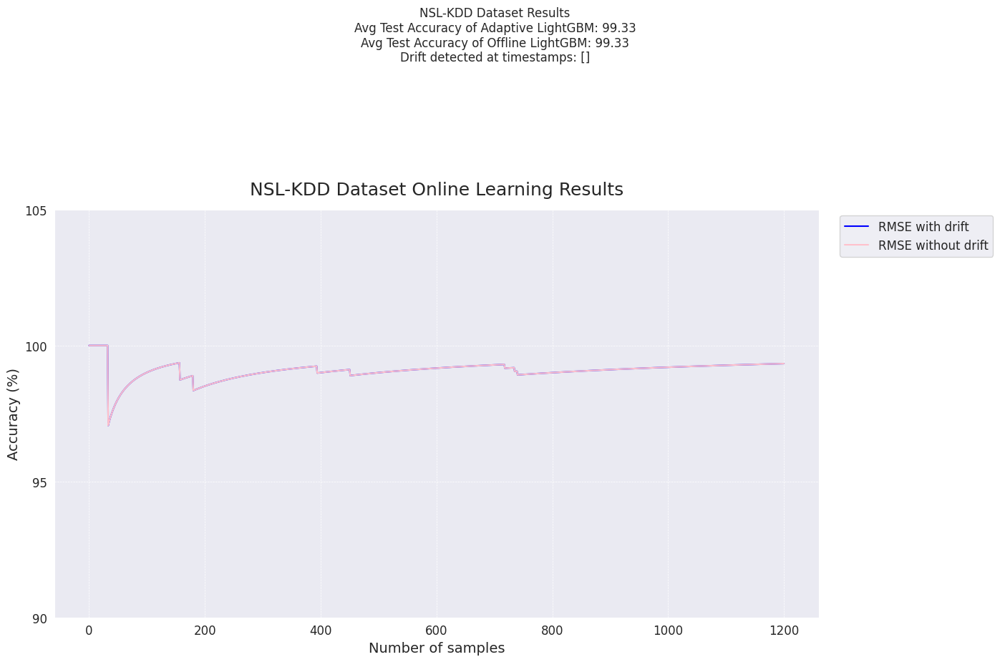

<Figure size 640x480 with 0 Axes>

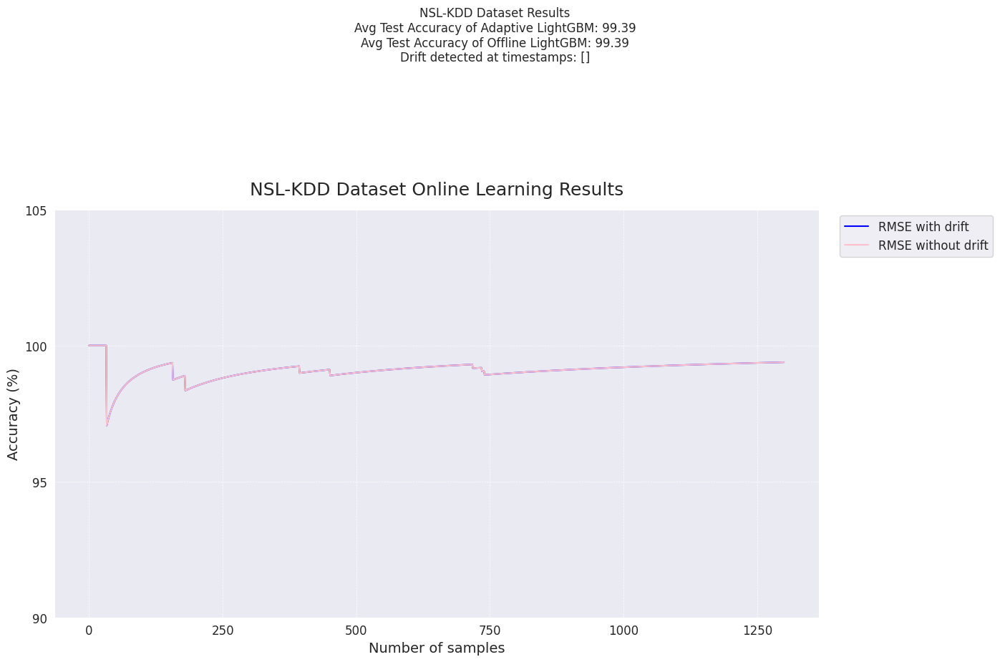

<Figure size 640x480 with 0 Axes>

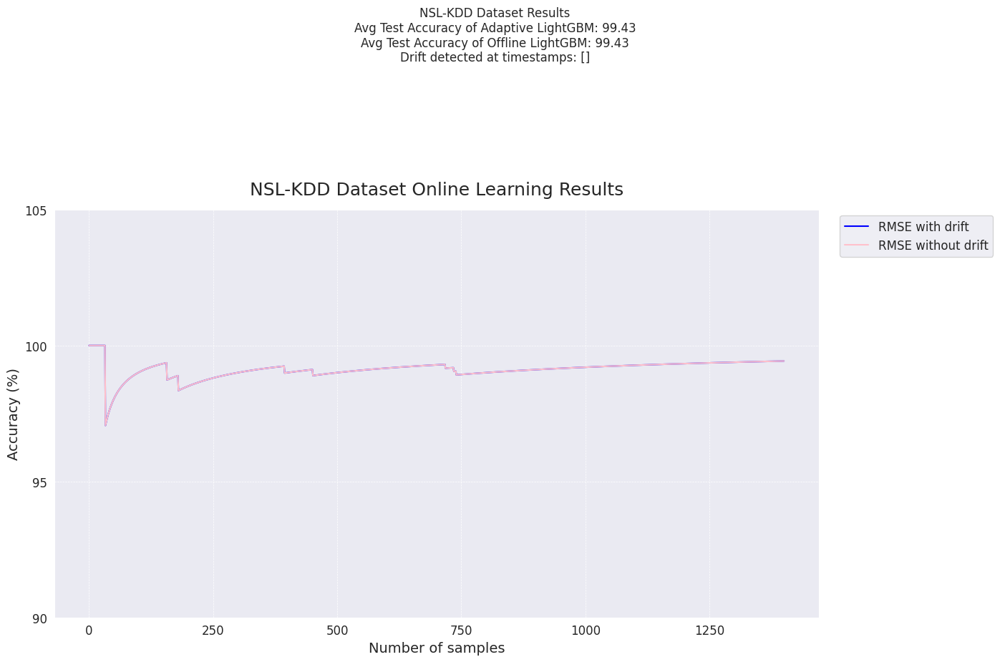

<Figure size 640x480 with 0 Axes>

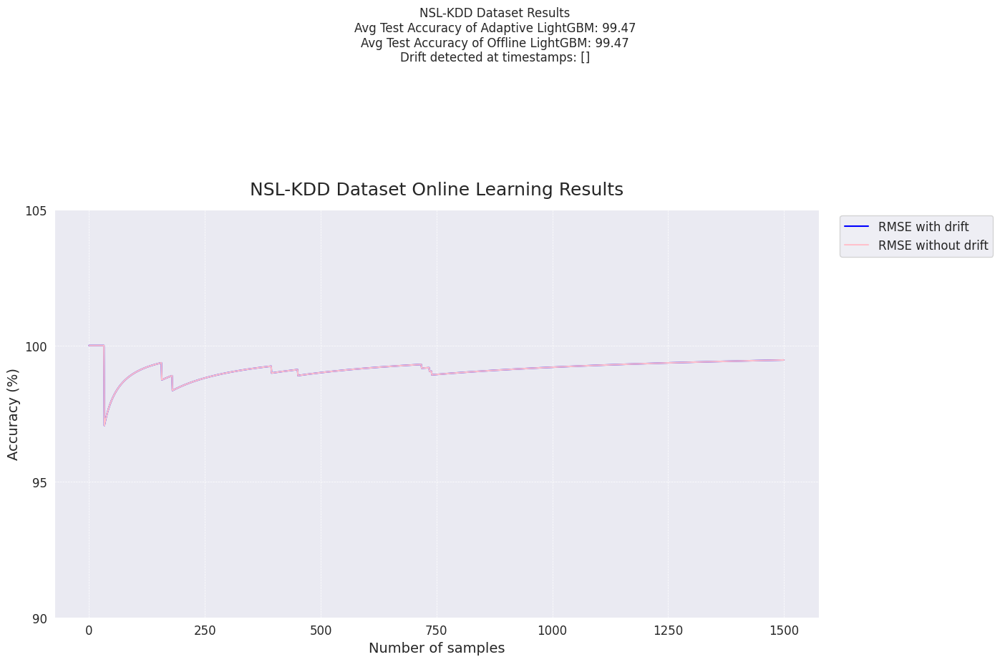

<Figure size 640x480 with 0 Axes>

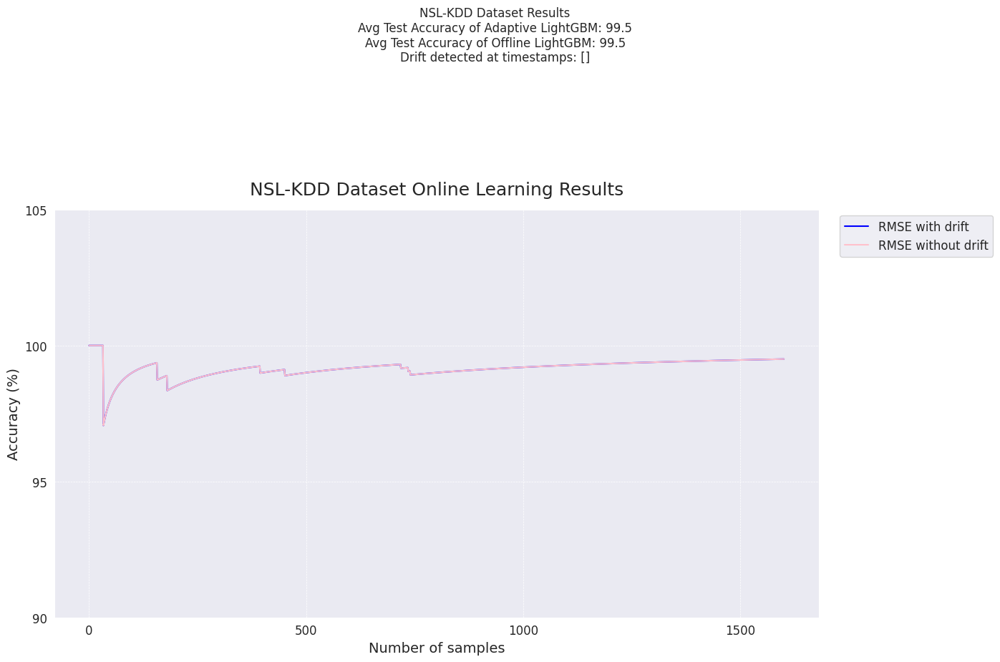

<Figure size 640x480 with 0 Axes>

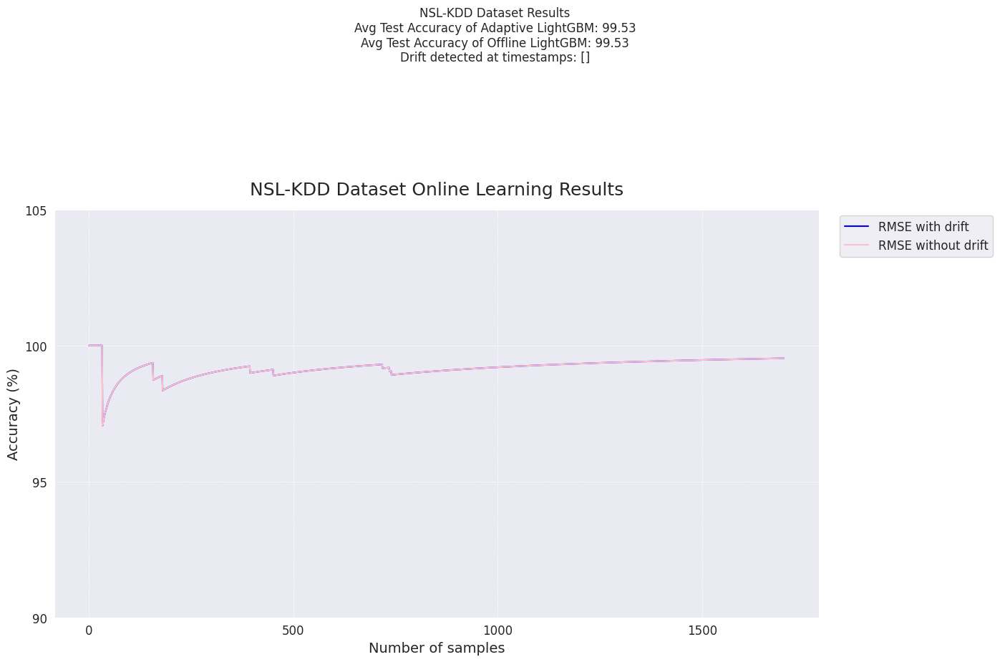

<Figure size 640x480 with 0 Axes>

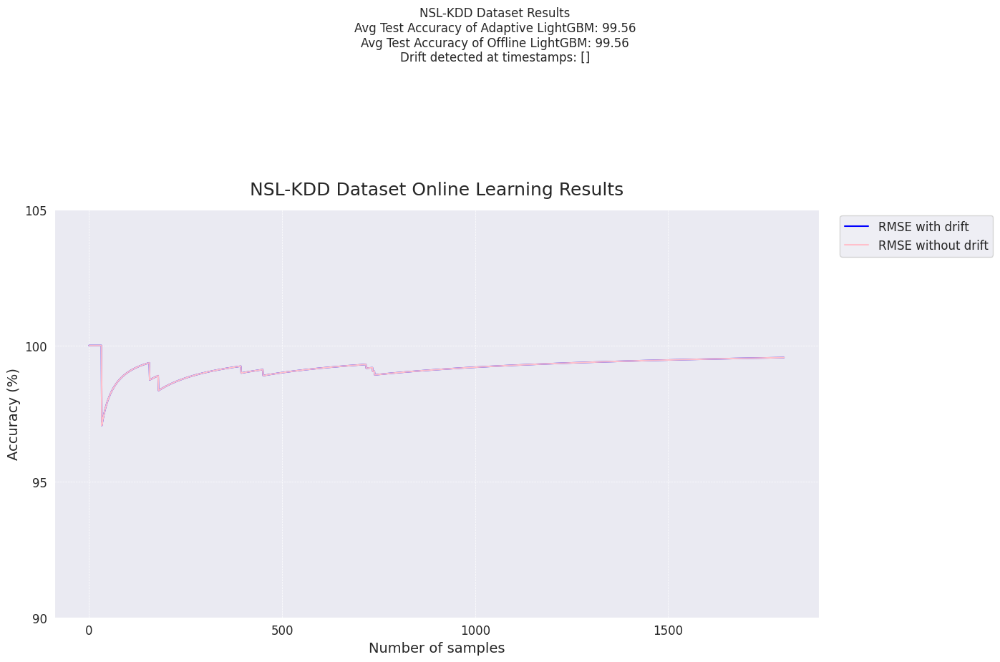

<Figure size 640x480 with 0 Axes>

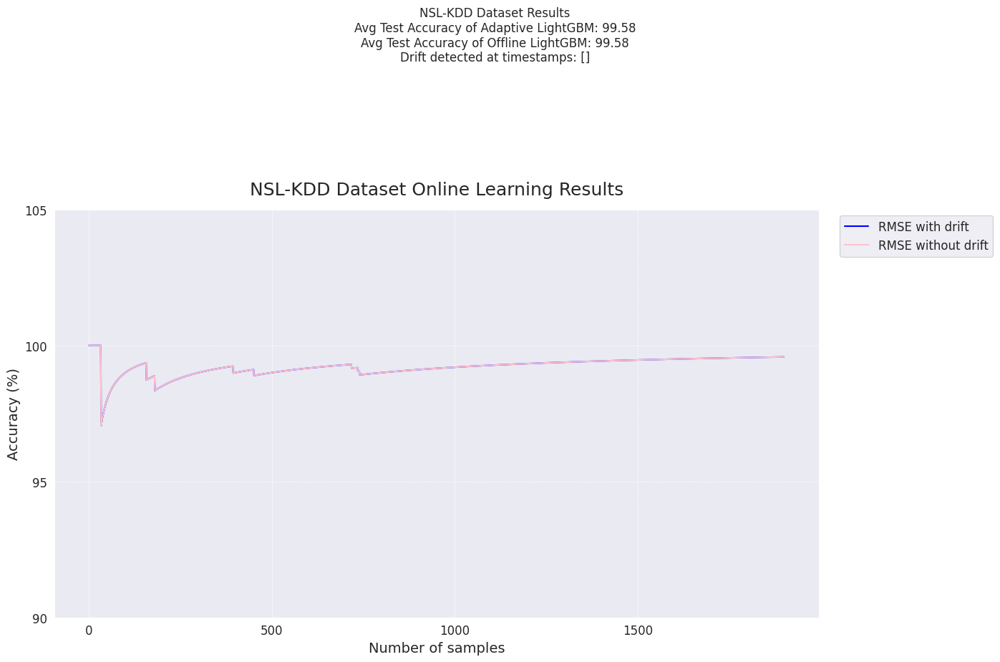

<Figure size 640x480 with 0 Axes>

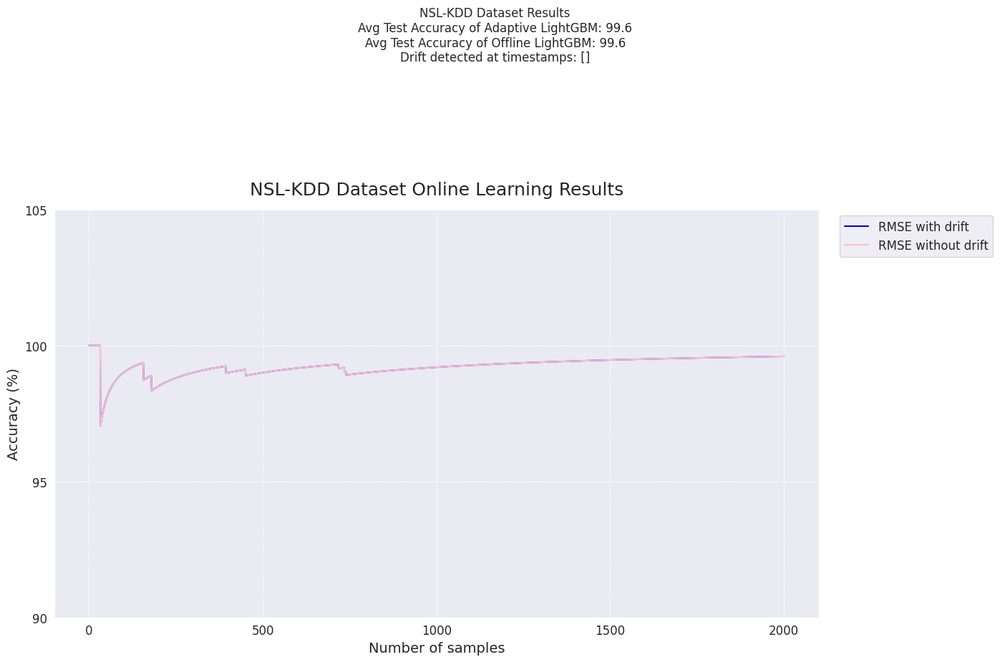

<Figure size 640x480 with 0 Axes>

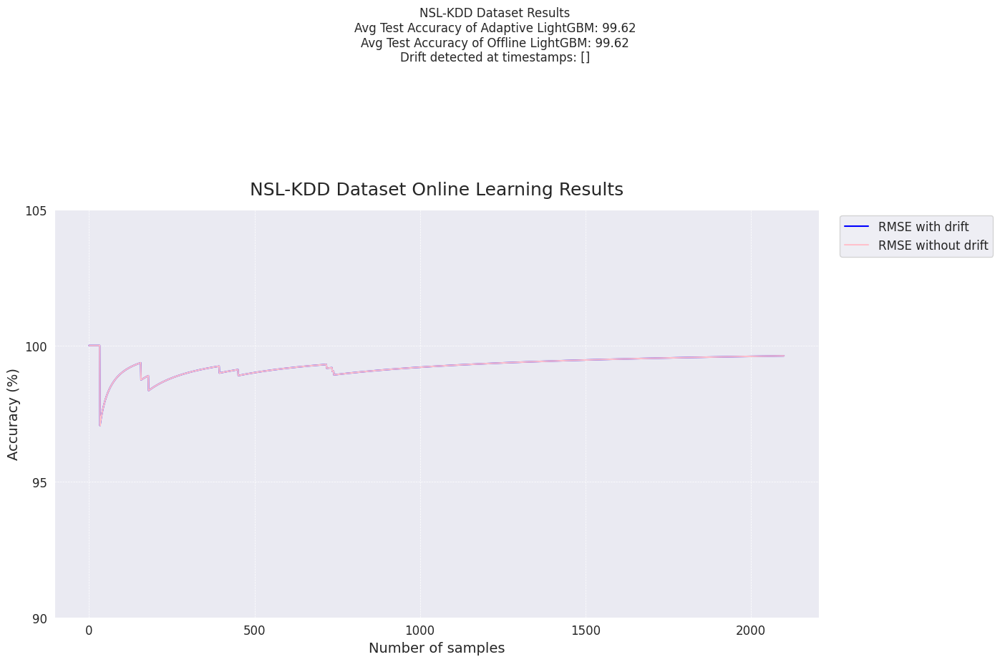

<Figure size 640x480 with 0 Axes>

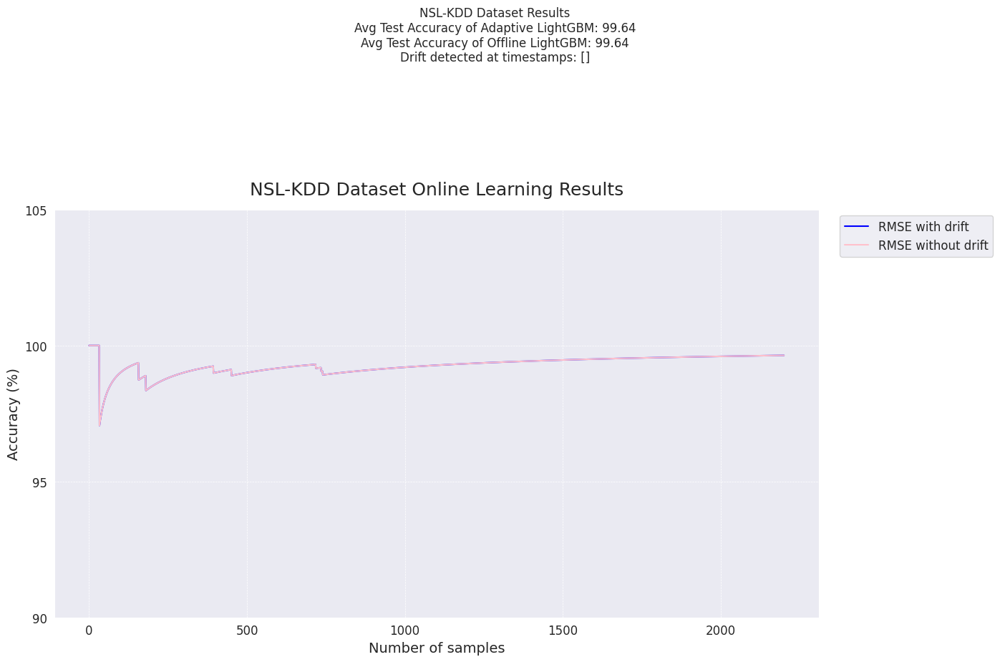

<Figure size 640x480 with 0 Axes>

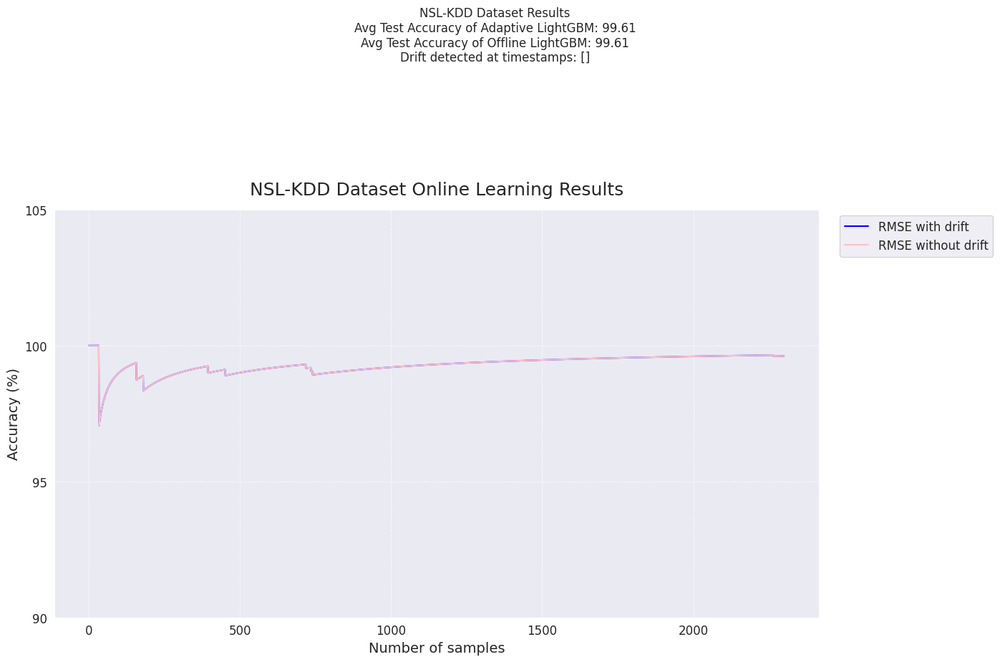

<Figure size 640x480 with 0 Axes>

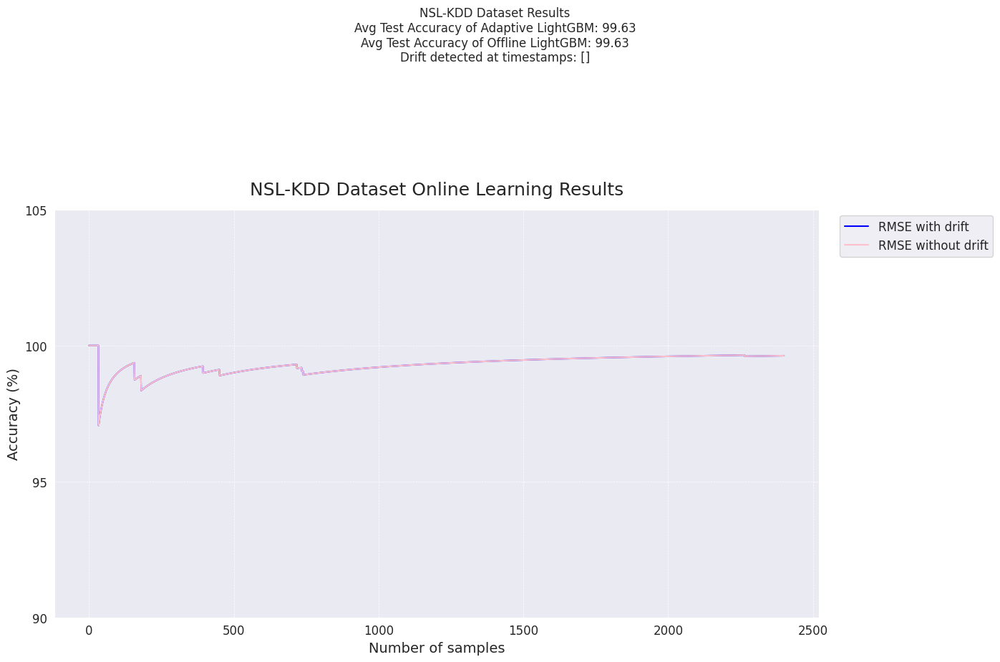

<Figure size 640x480 with 0 Axes>

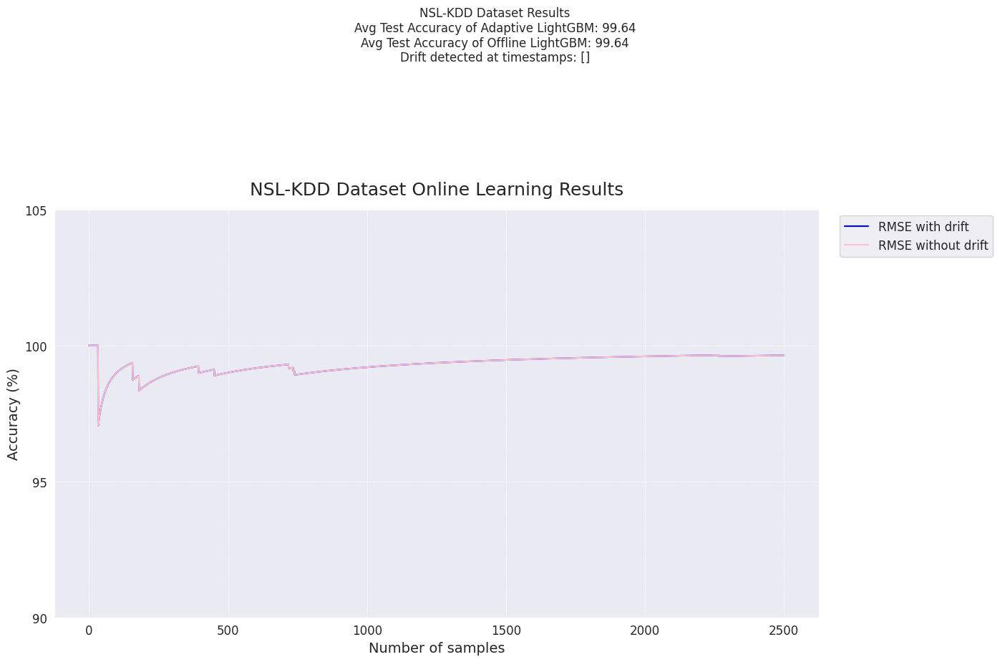

<Figure size 640x480 with 0 Axes>

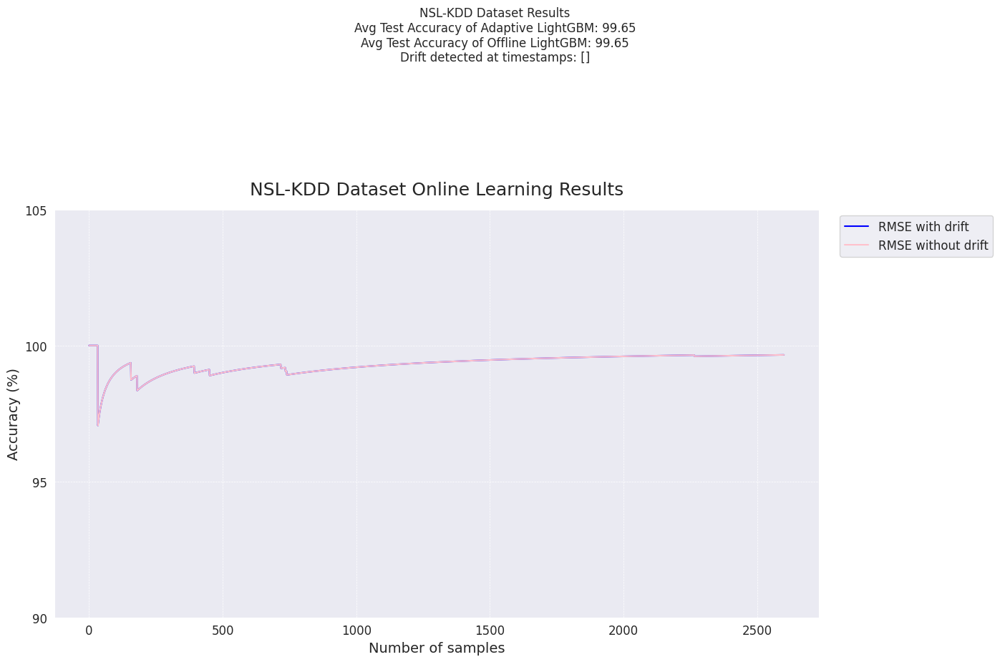

<Figure size 640x480 with 0 Axes>

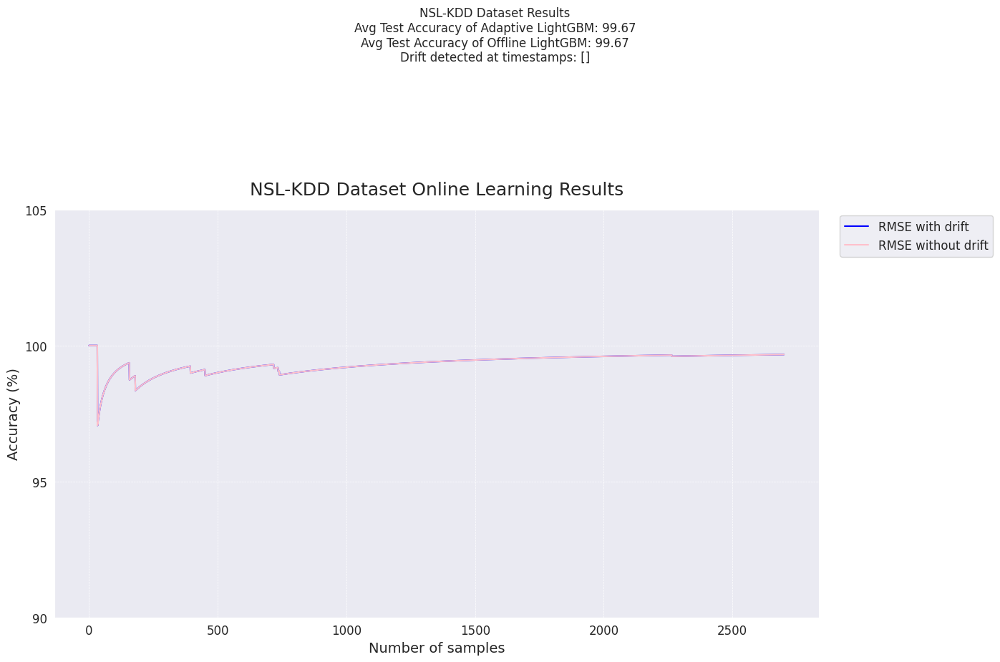

<Figure size 640x480 with 0 Axes>

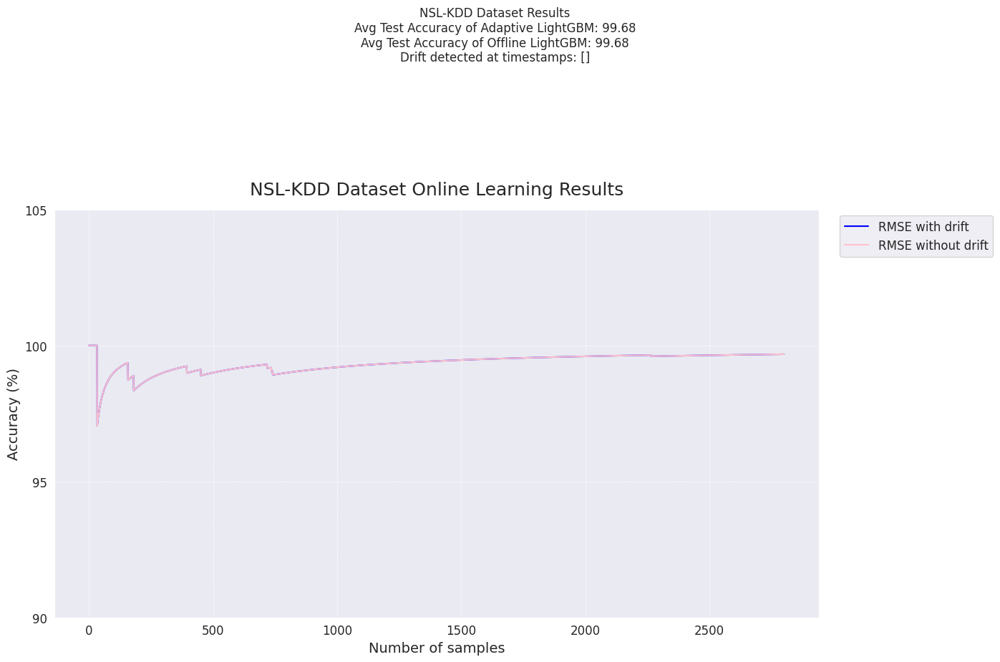

<Figure size 640x480 with 0 Axes>

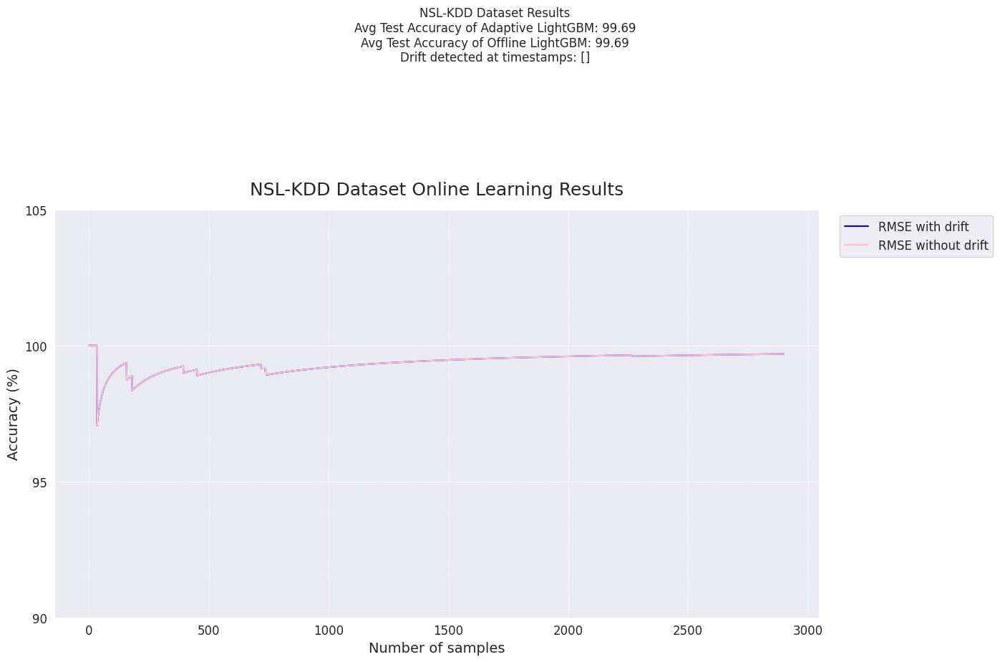

<Figure size 640x480 with 0 Axes>

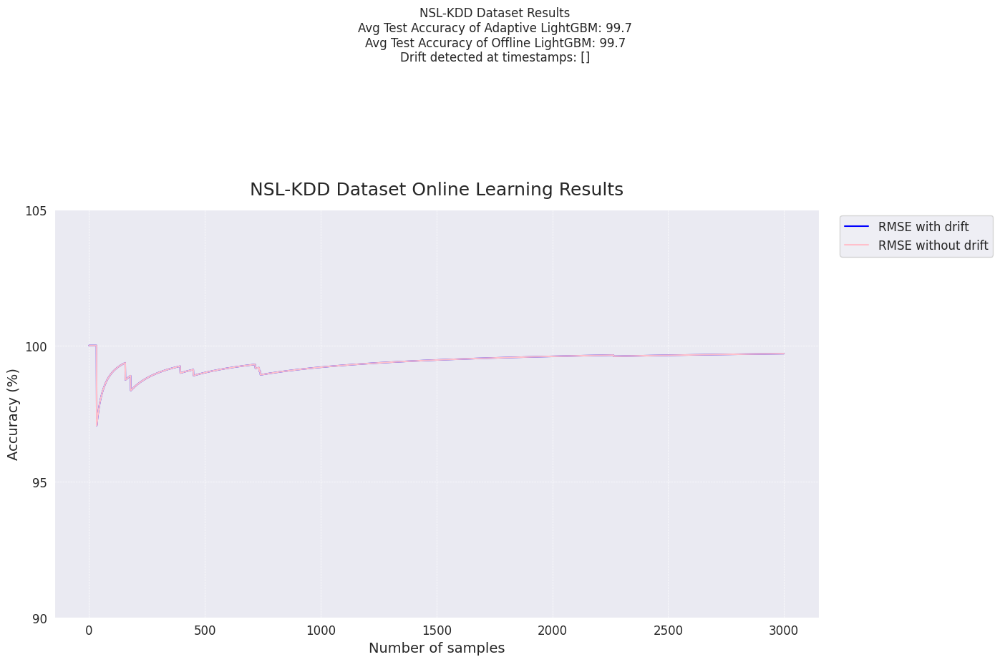

<Figure size 640x480 with 0 Axes>

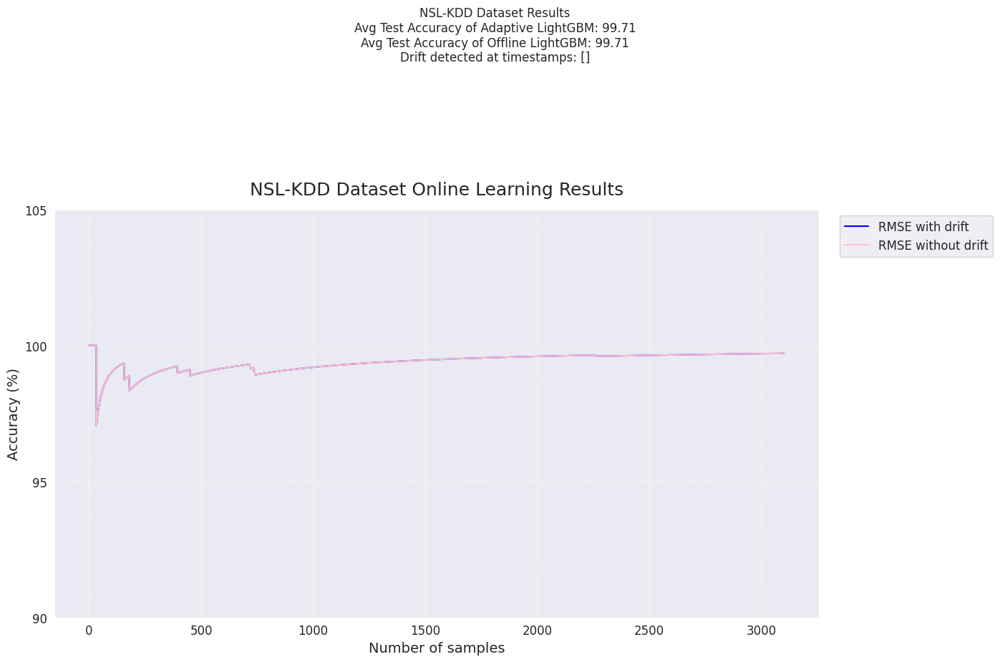

<Figure size 640x480 with 0 Axes>

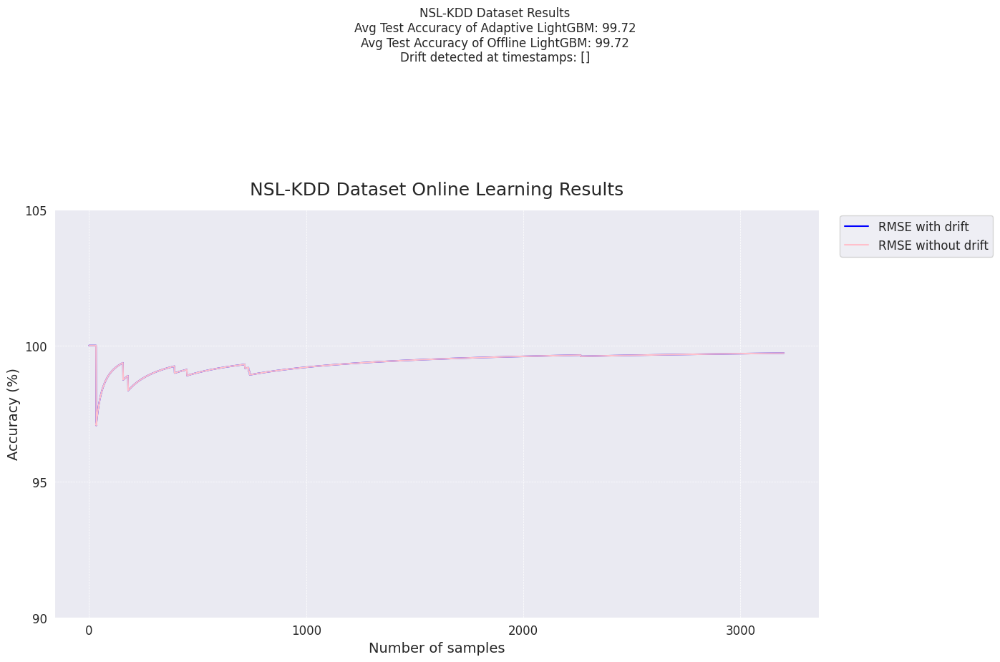

<Figure size 640x480 with 0 Axes>

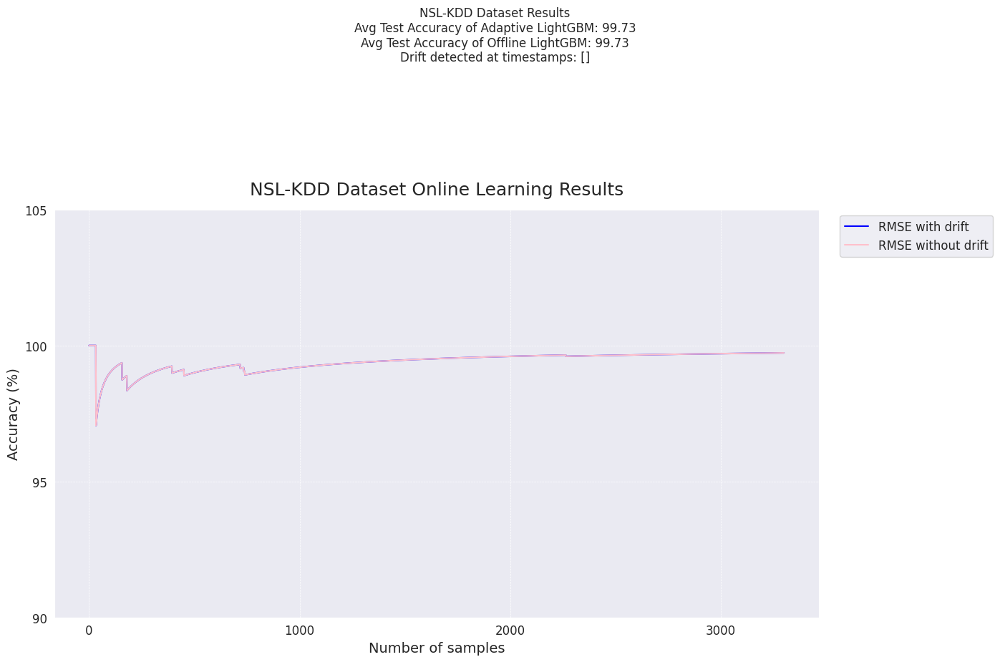

<Figure size 640x480 with 0 Axes>

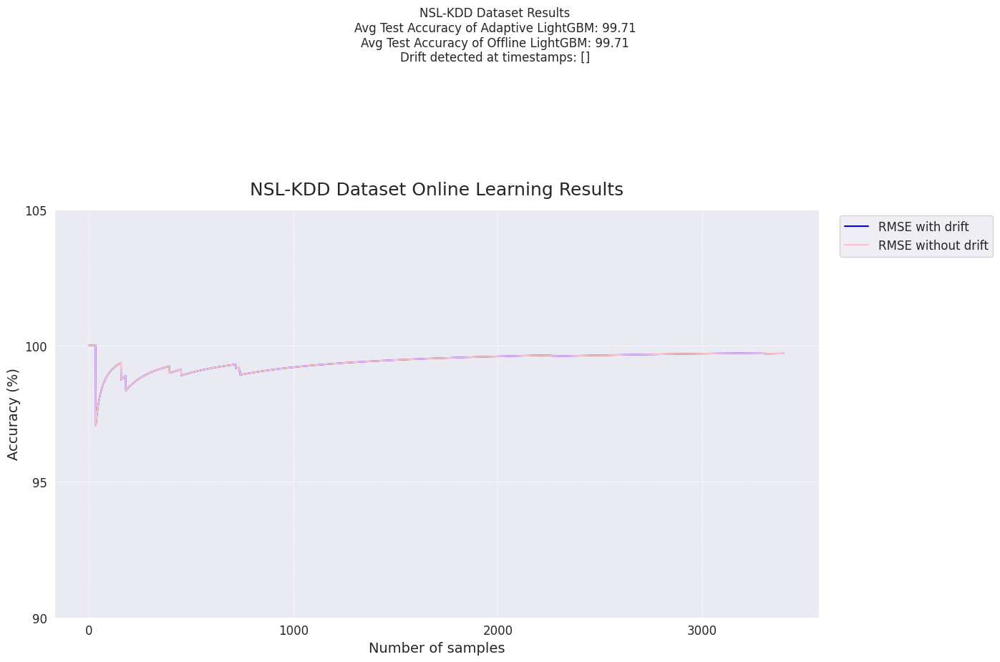

<Figure size 640x480 with 0 Axes>

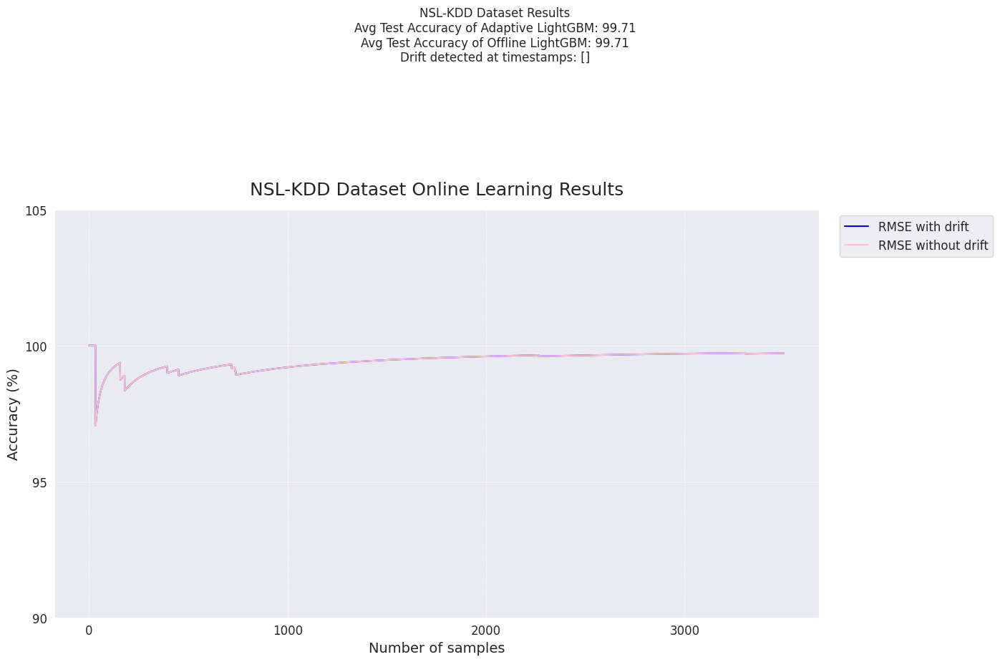

<Figure size 640x480 with 0 Axes>

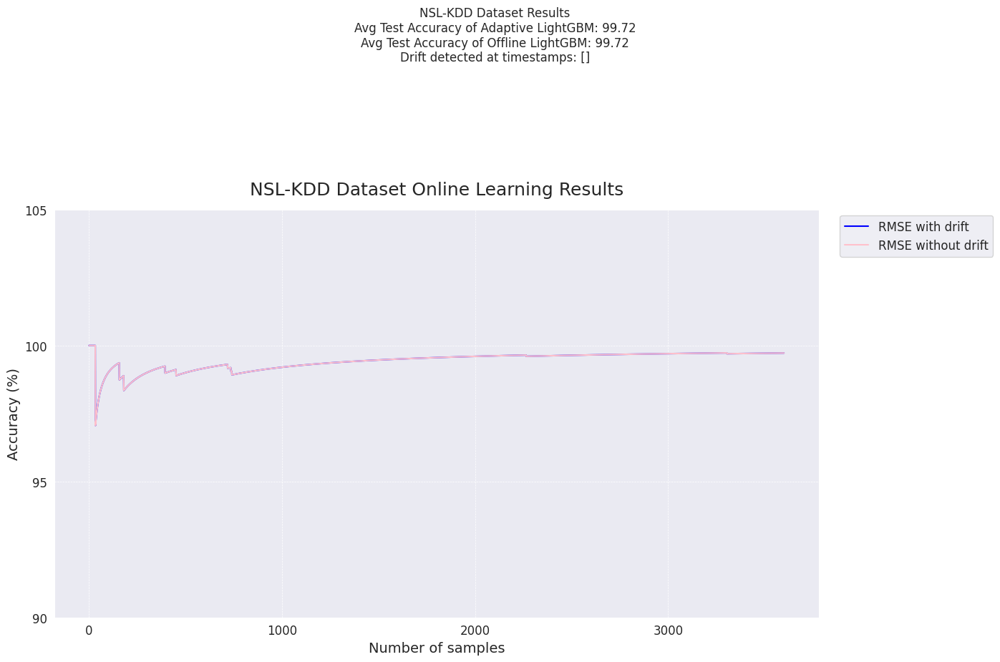

<Figure size 640x480 with 0 Axes>

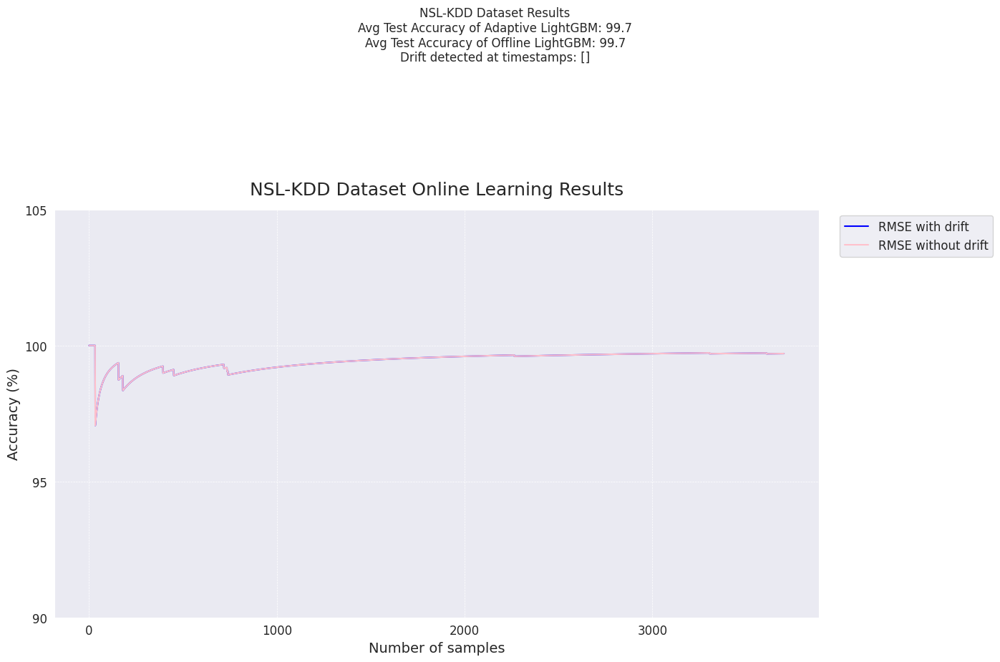

<Figure size 640x480 with 0 Axes>

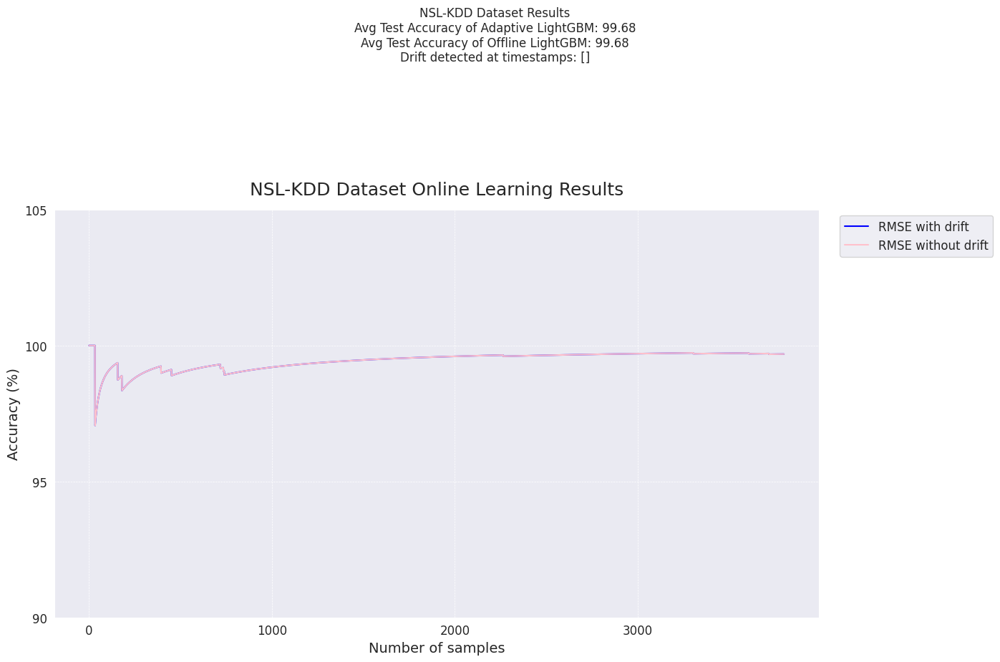

<Figure size 640x480 with 0 Axes>

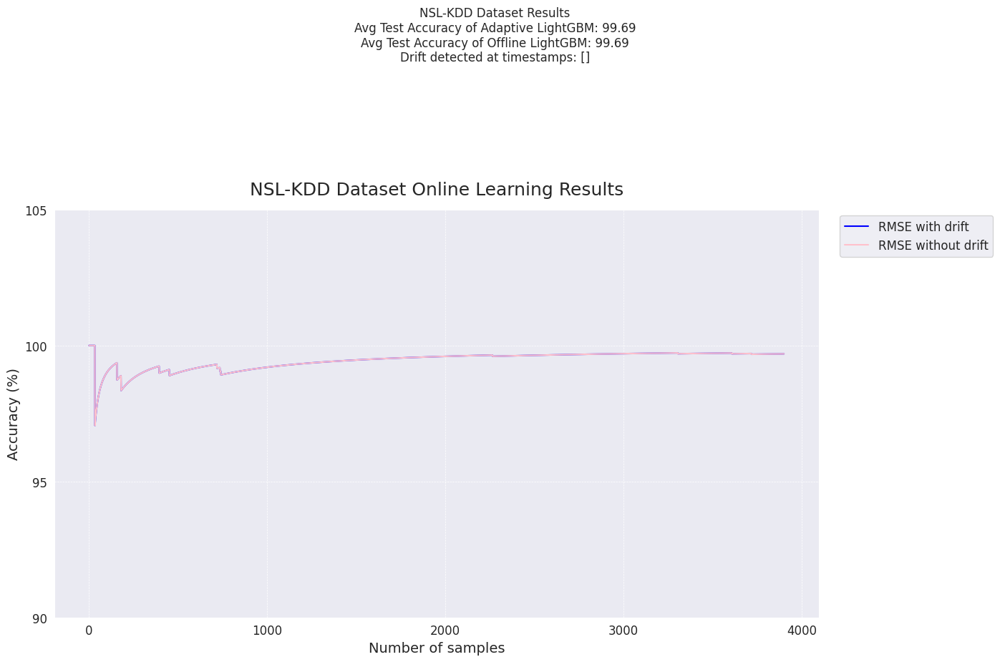

<Figure size 640x480 with 0 Axes>

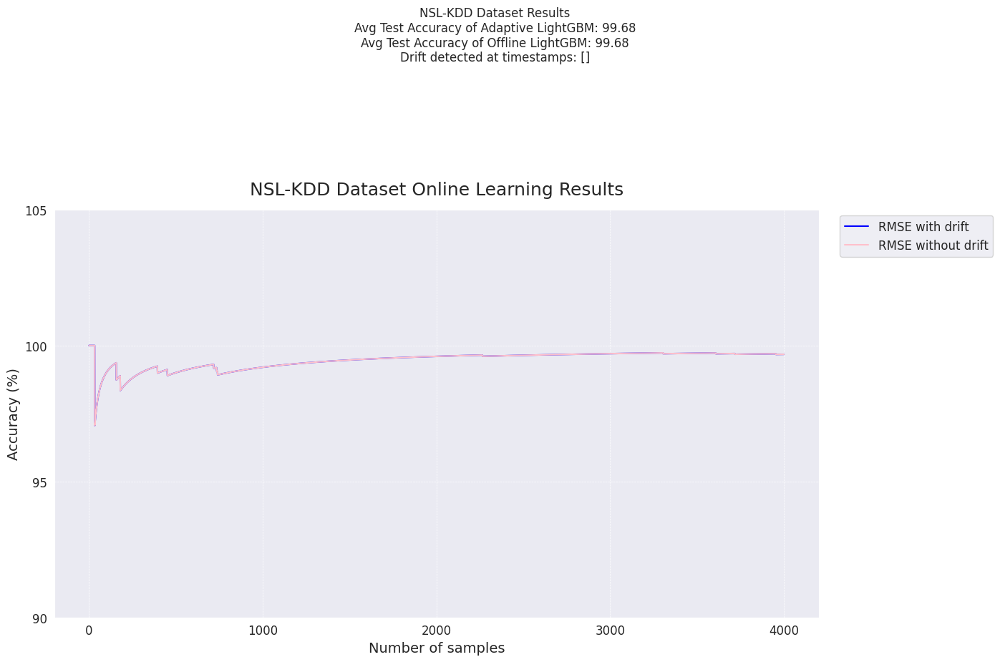

<Figure size 640x480 with 0 Axes>

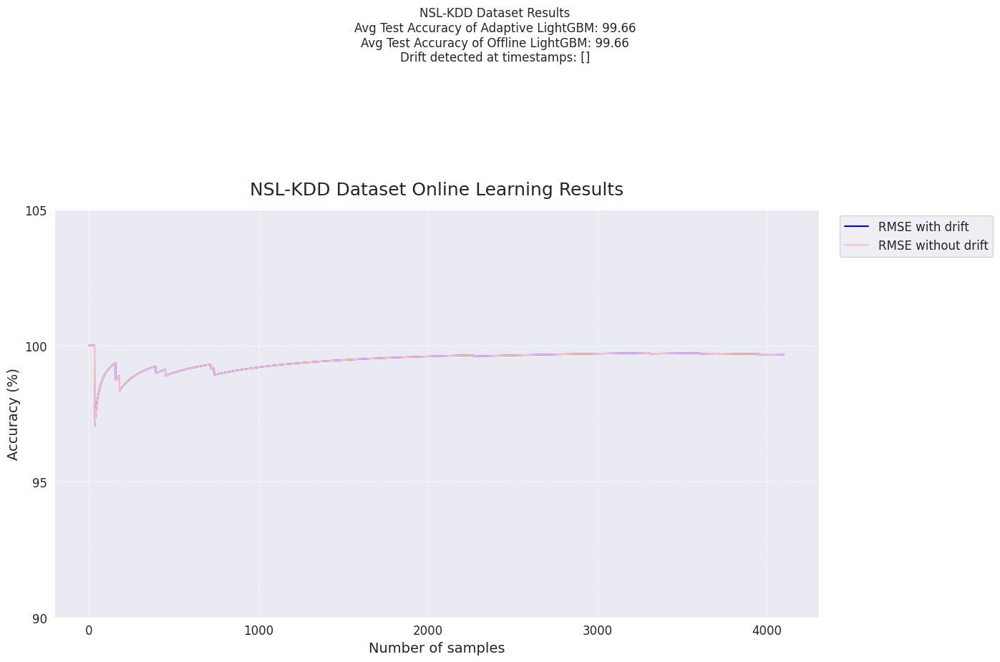

<Figure size 640x480 with 0 Axes>

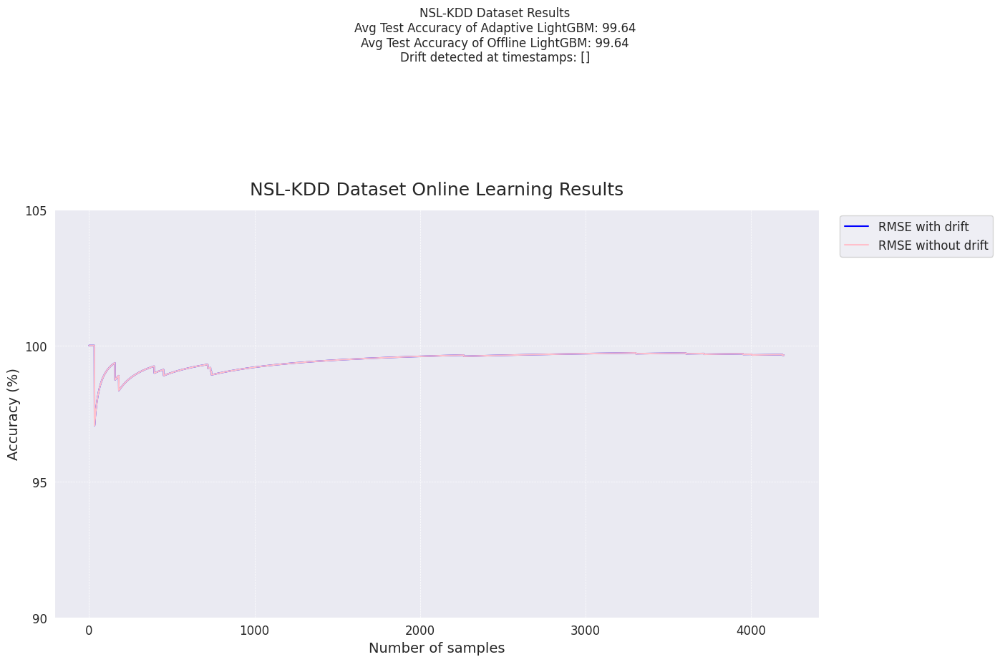

<Figure size 640x480 with 0 Axes>

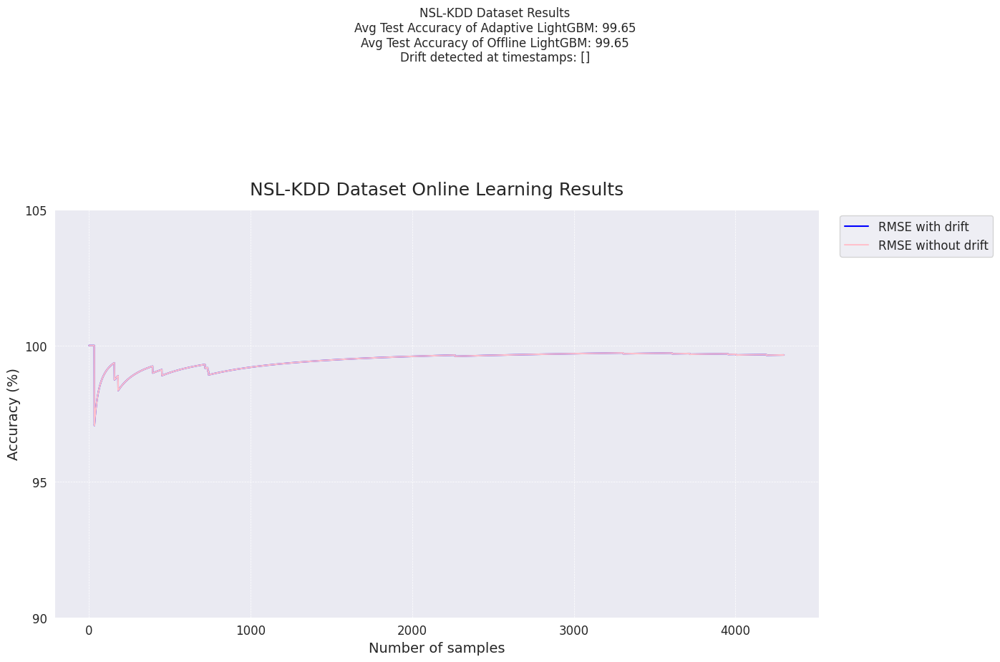

<Figure size 640x480 with 0 Axes>

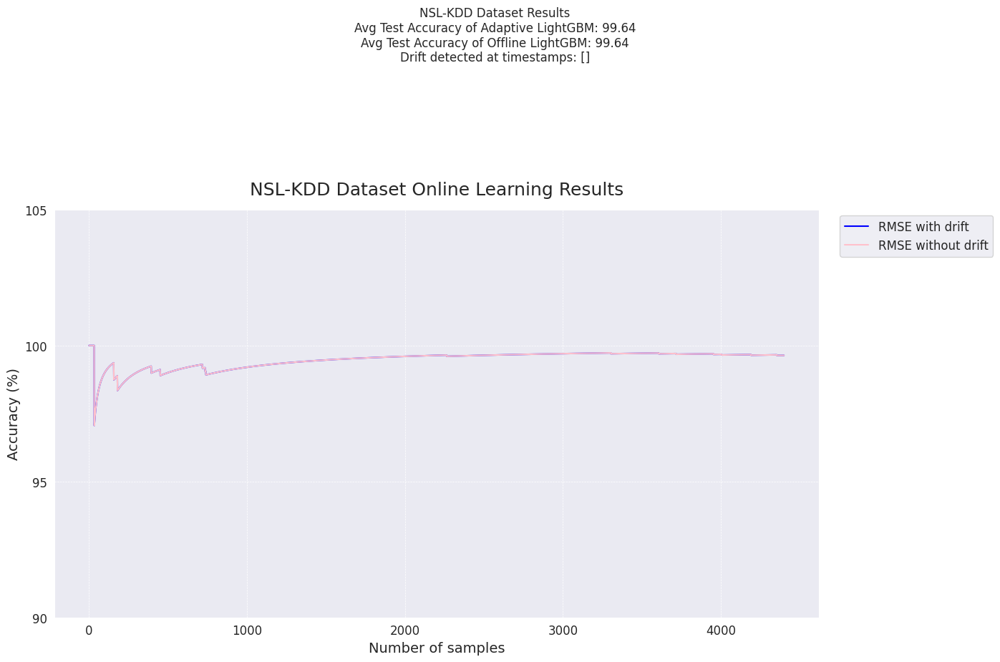

<Figure size 640x480 with 0 Axes>

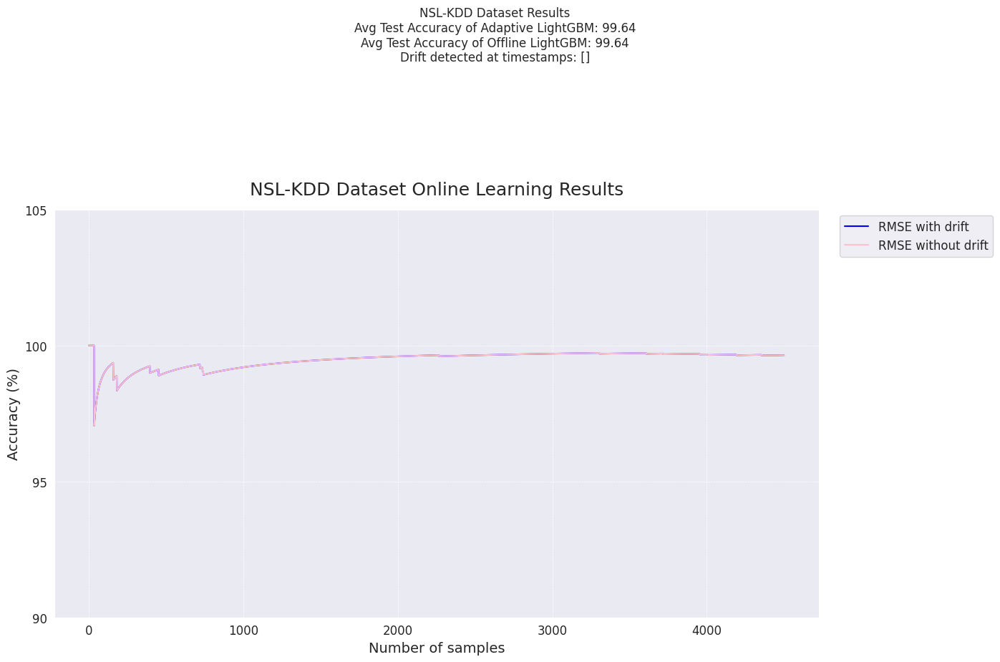

<Figure size 640x480 with 0 Axes>

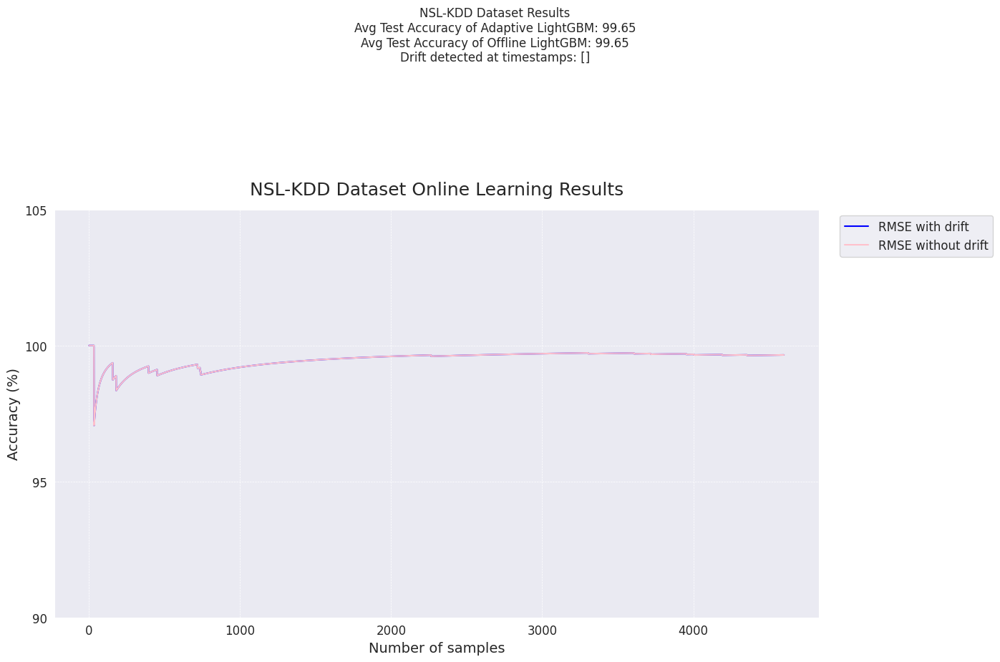

<Figure size 640x480 with 0 Axes>

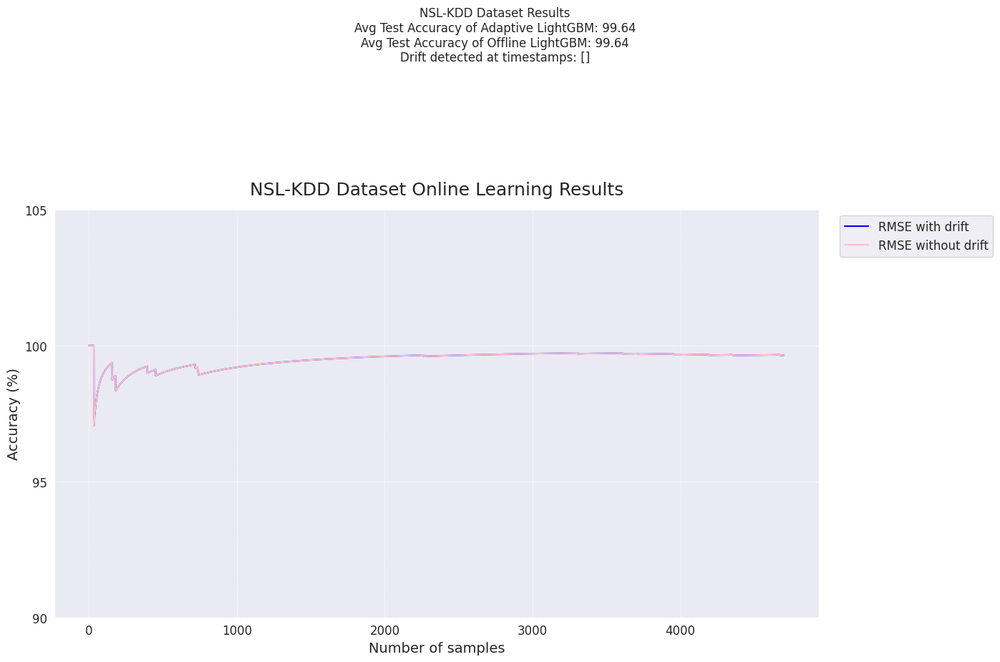

<Figure size 640x480 with 0 Axes>

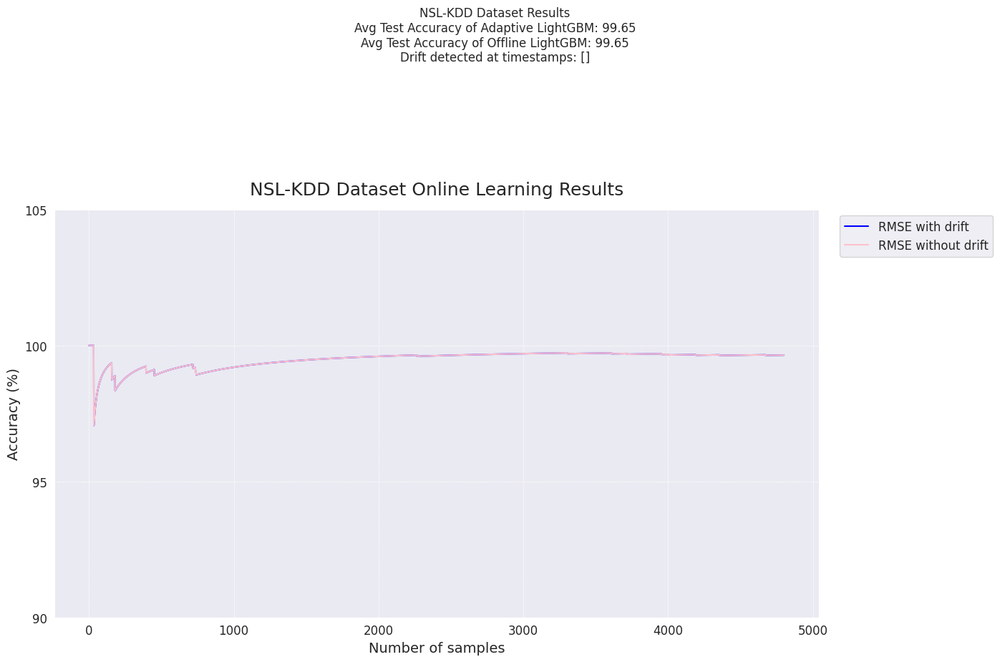

<Figure size 640x480 with 0 Axes>

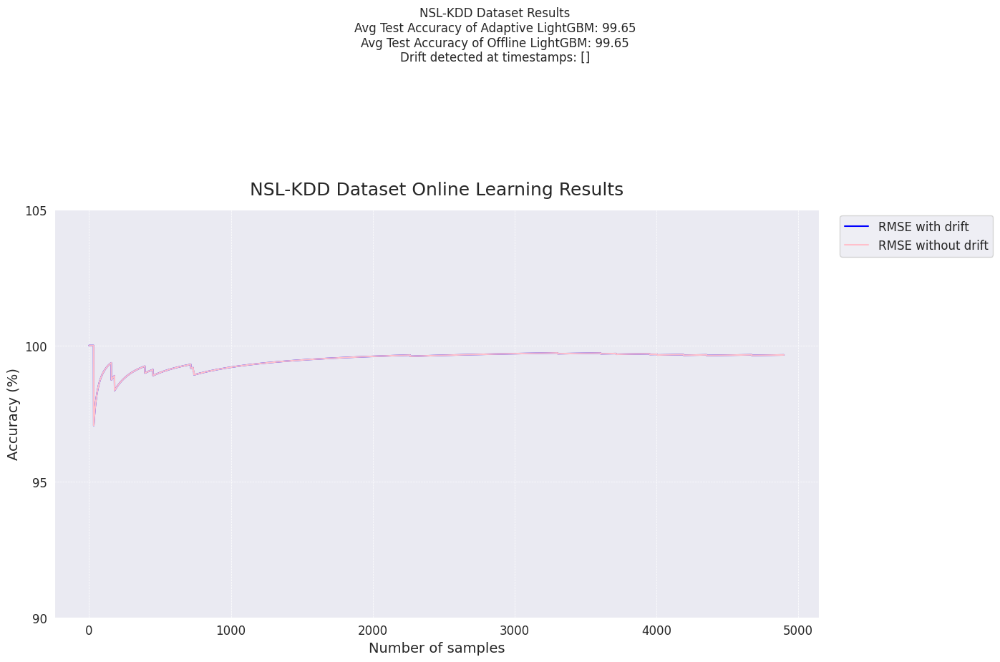

<Figure size 640x480 with 0 Axes>

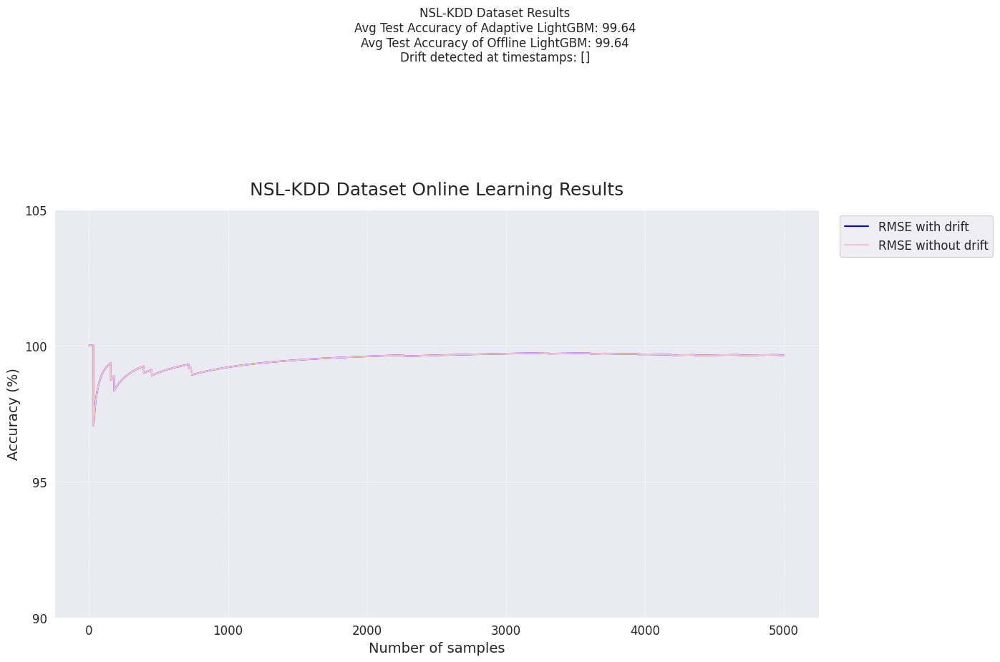

<Figure size 640x480 with 0 Axes>

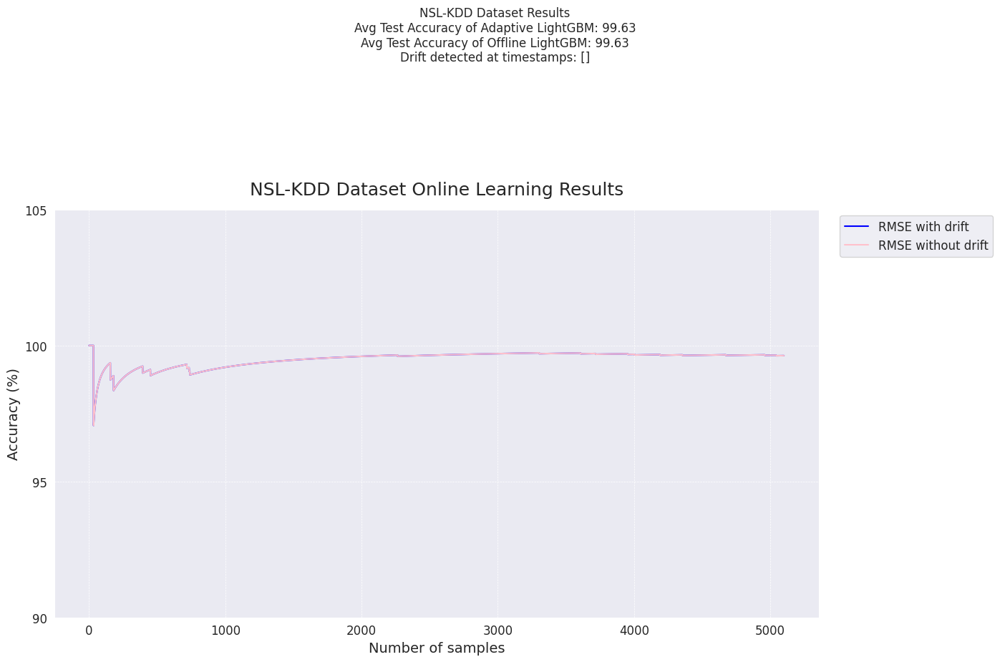

<Figure size 640x480 with 0 Axes>

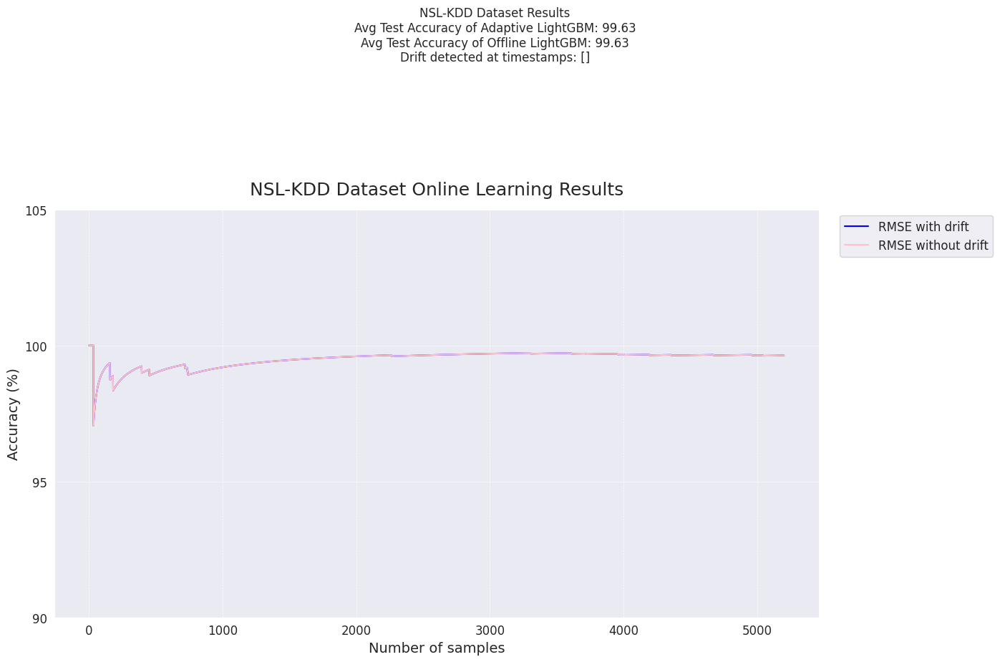

<Figure size 640x480 with 0 Axes>

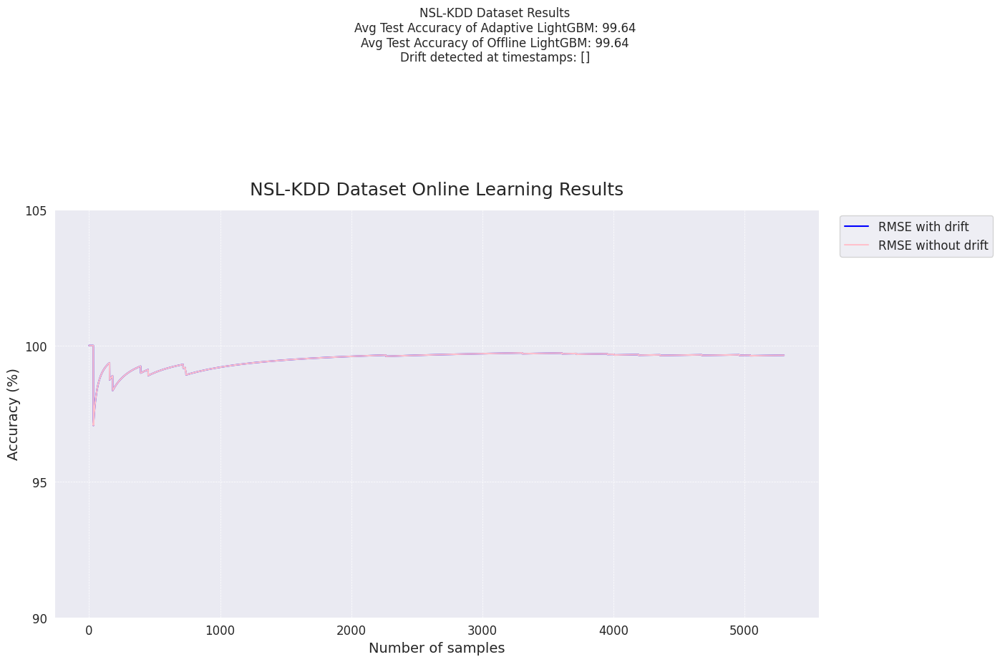

<Figure size 640x480 with 0 Axes>

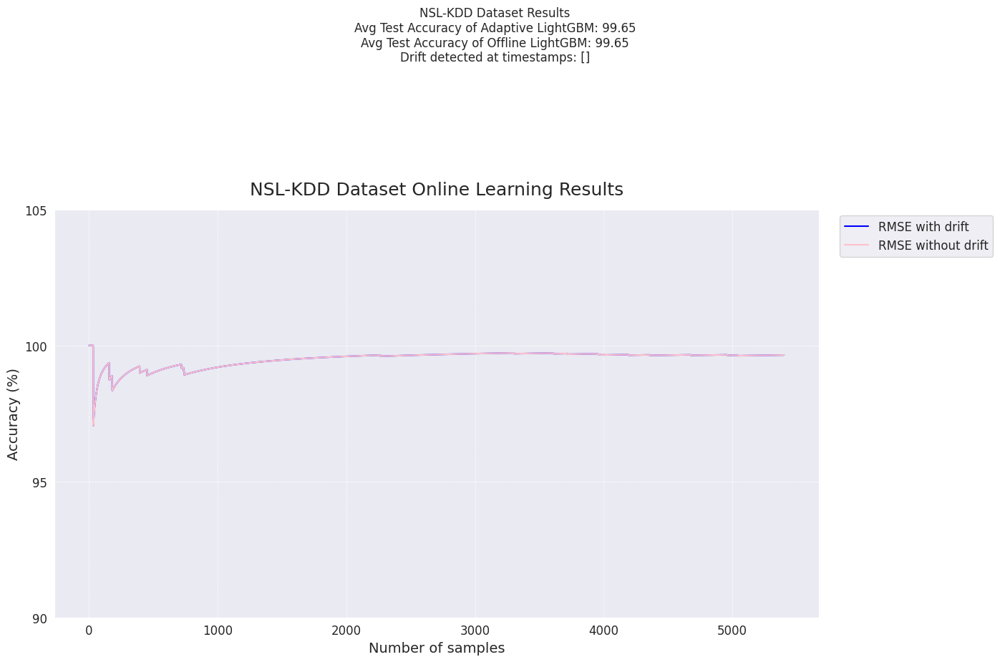

<Figure size 640x480 with 0 Axes>

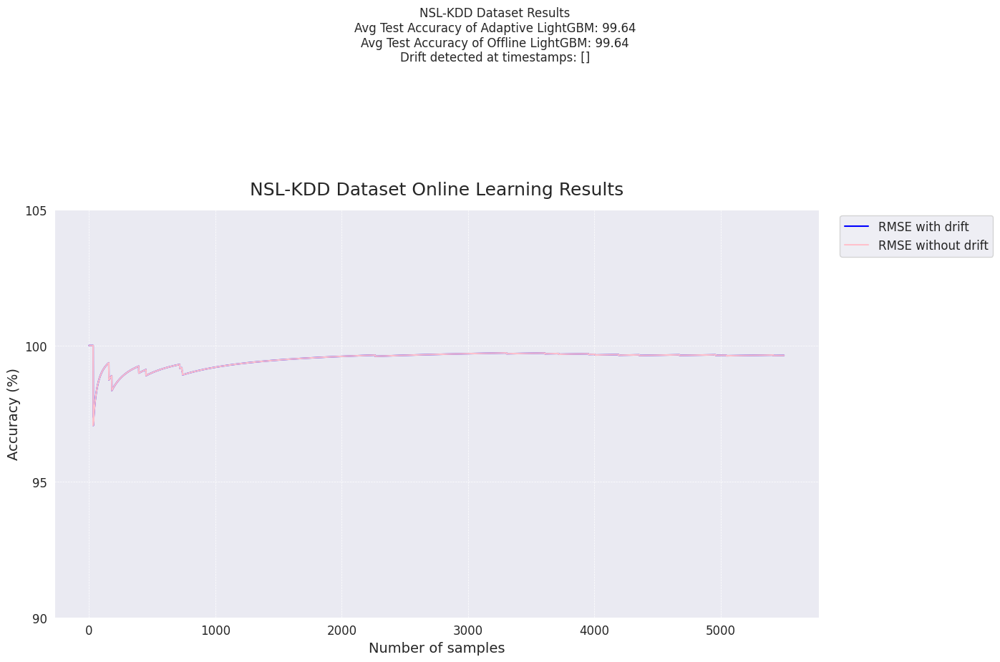

<Figure size 640x480 with 0 Axes>

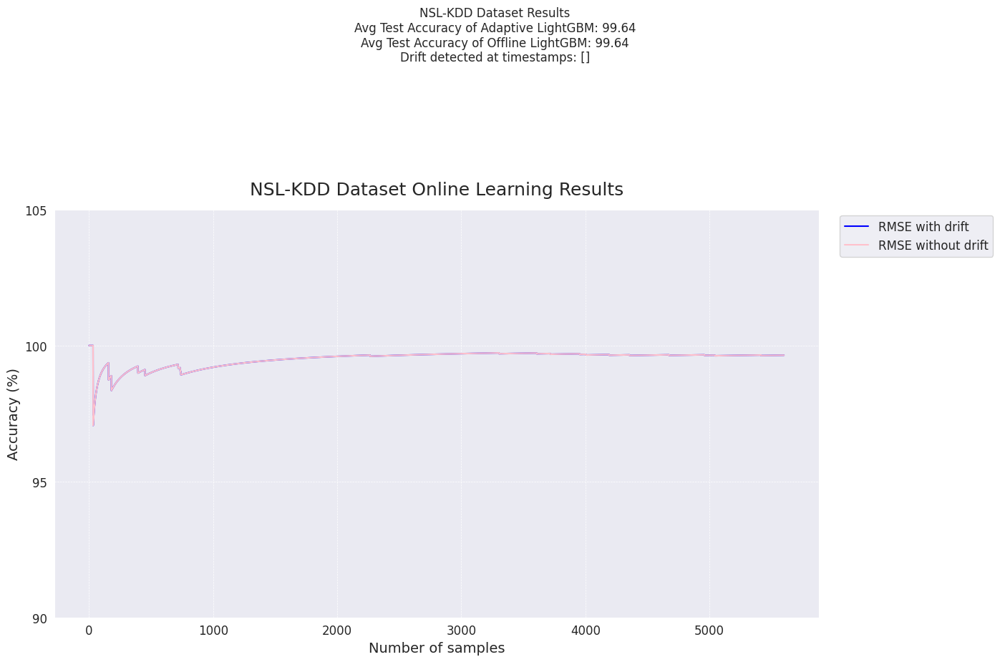

<Figure size 640x480 with 0 Axes>

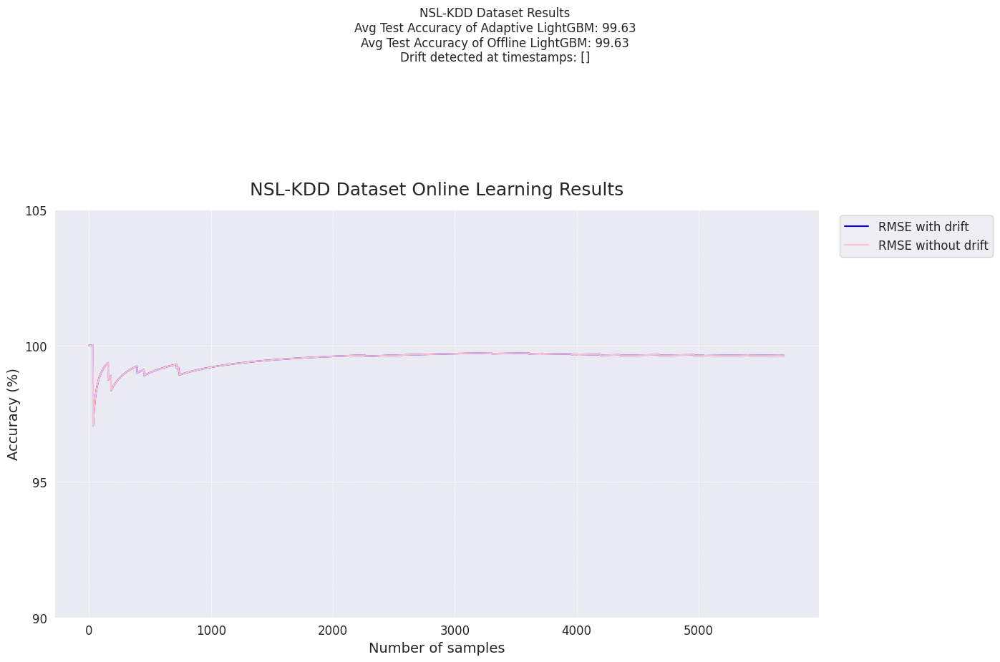

<Figure size 640x480 with 0 Axes>

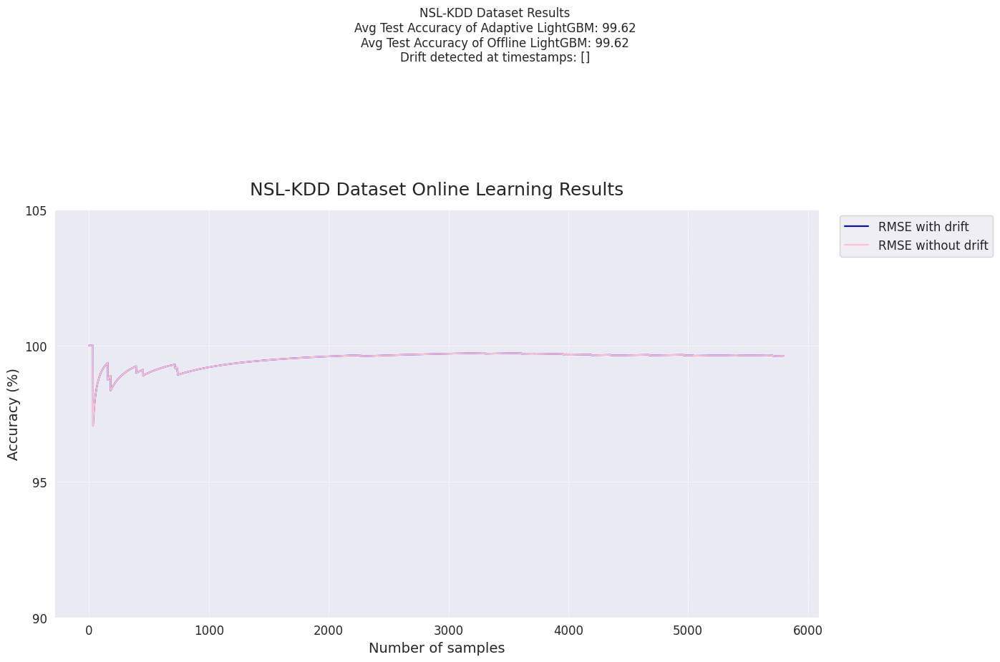

<Figure size 640x480 with 0 Axes>

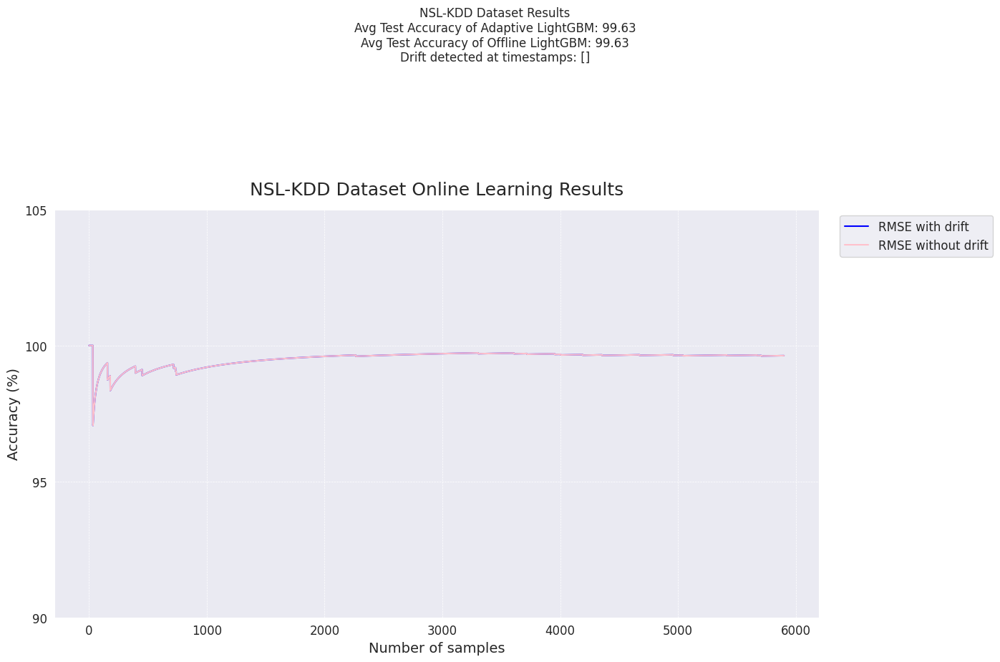

<Figure size 640x480 with 0 Axes>

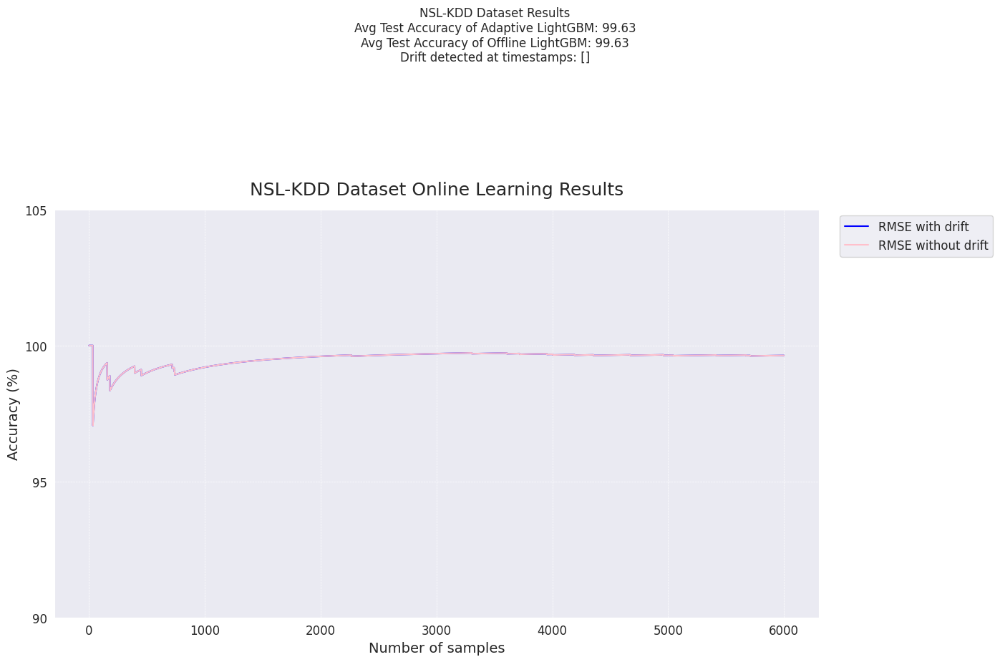

<Figure size 640x480 with 0 Axes>

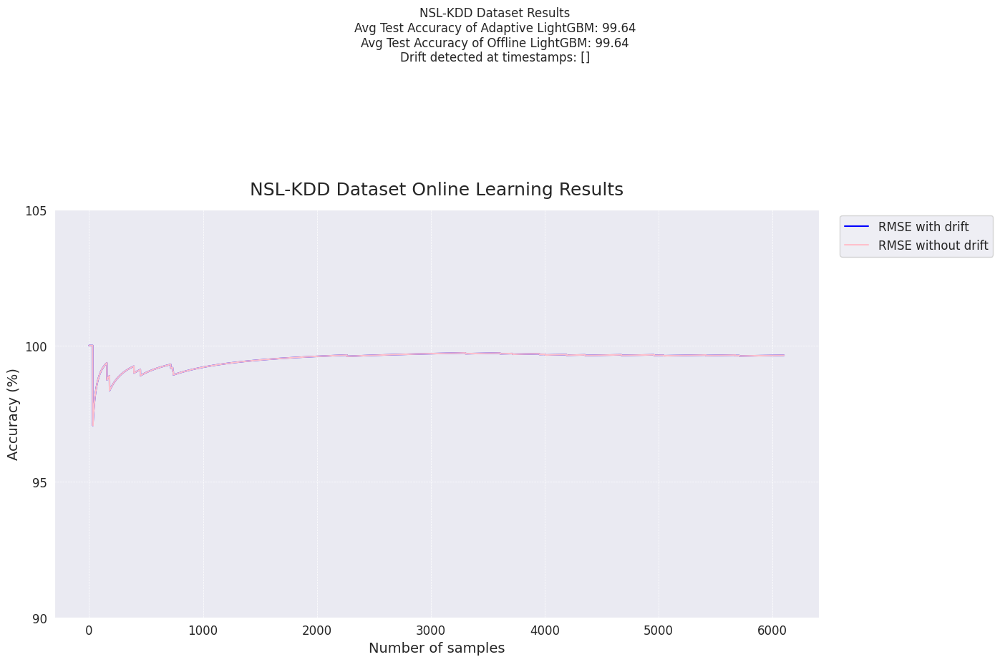

<Figure size 640x480 with 0 Axes>

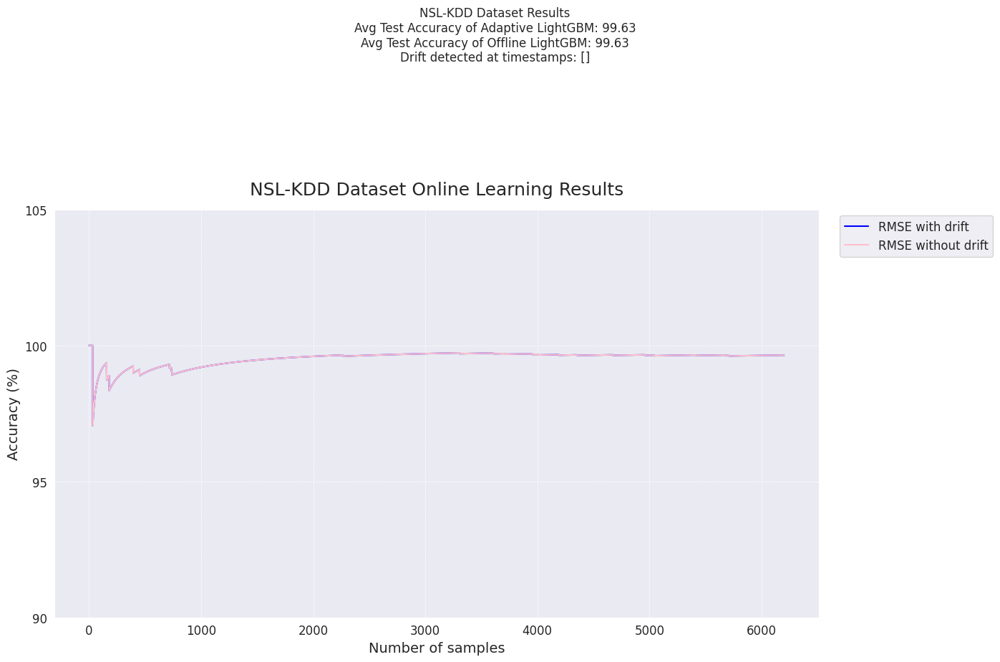

<Figure size 640x480 with 0 Axes>

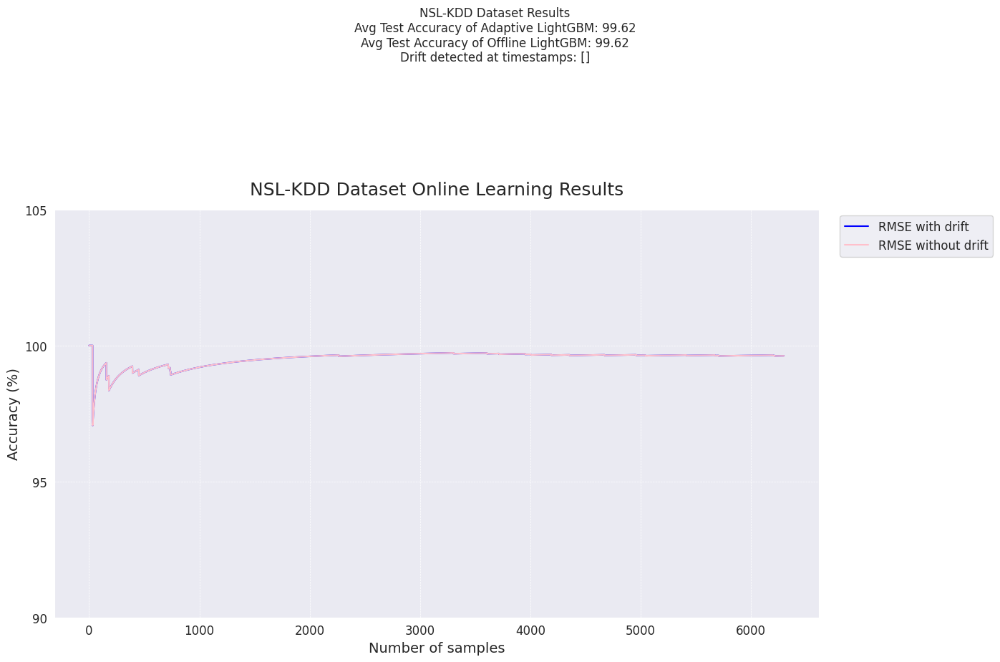

<Figure size 640x480 with 0 Axes>

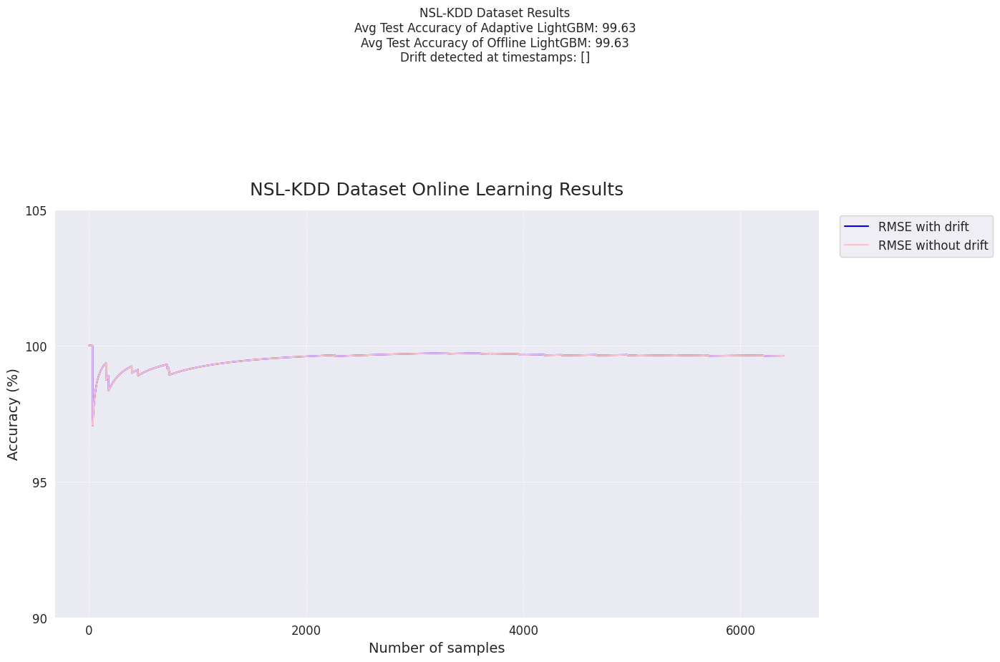

<Figure size 640x480 with 0 Axes>

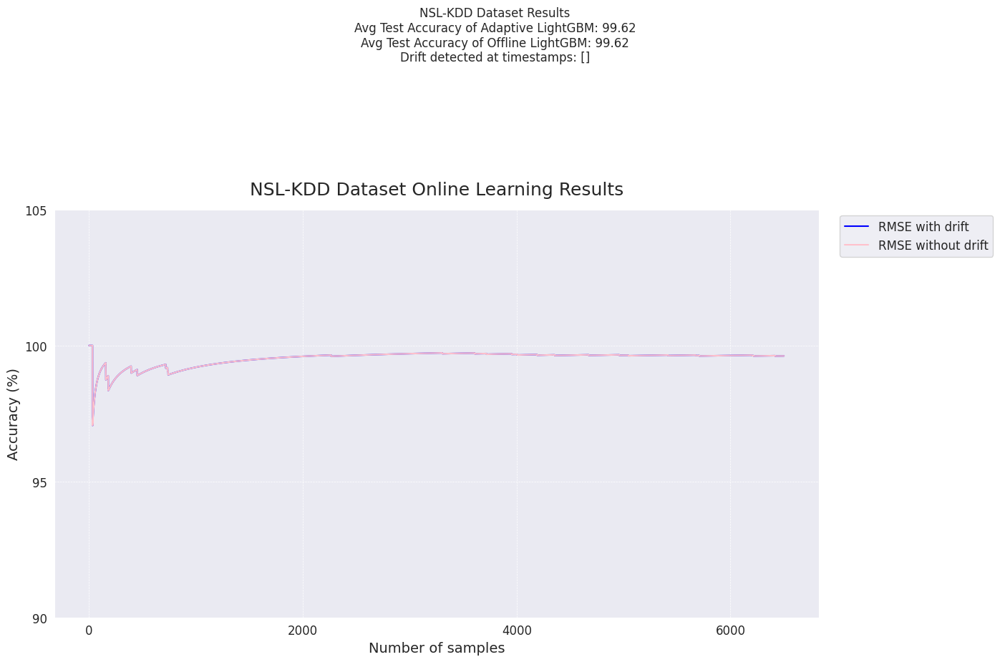

<Figure size 640x480 with 0 Axes>

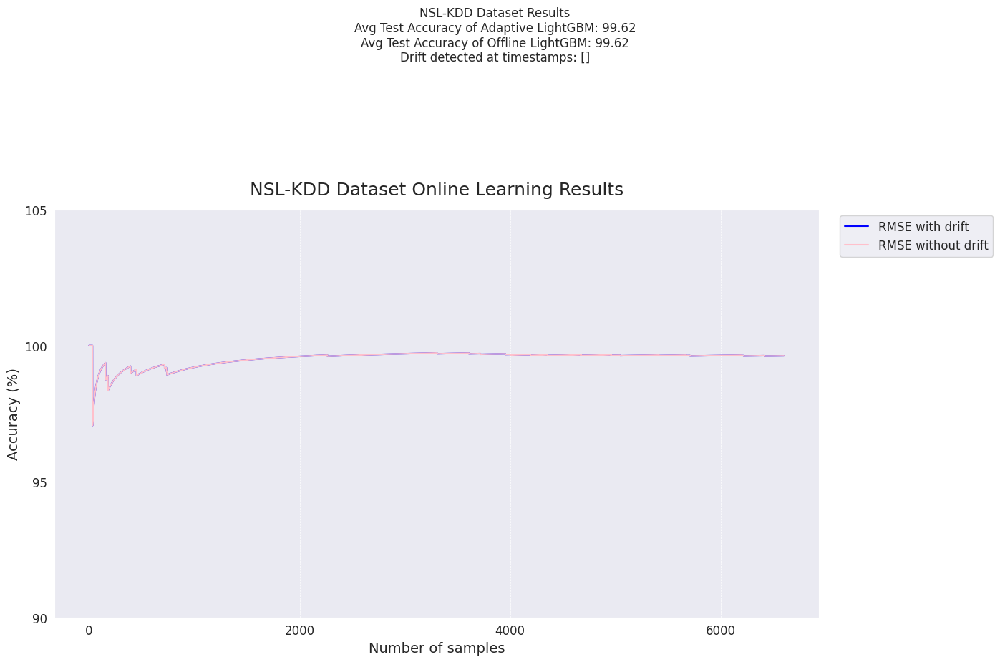

<Figure size 640x480 with 0 Axes>

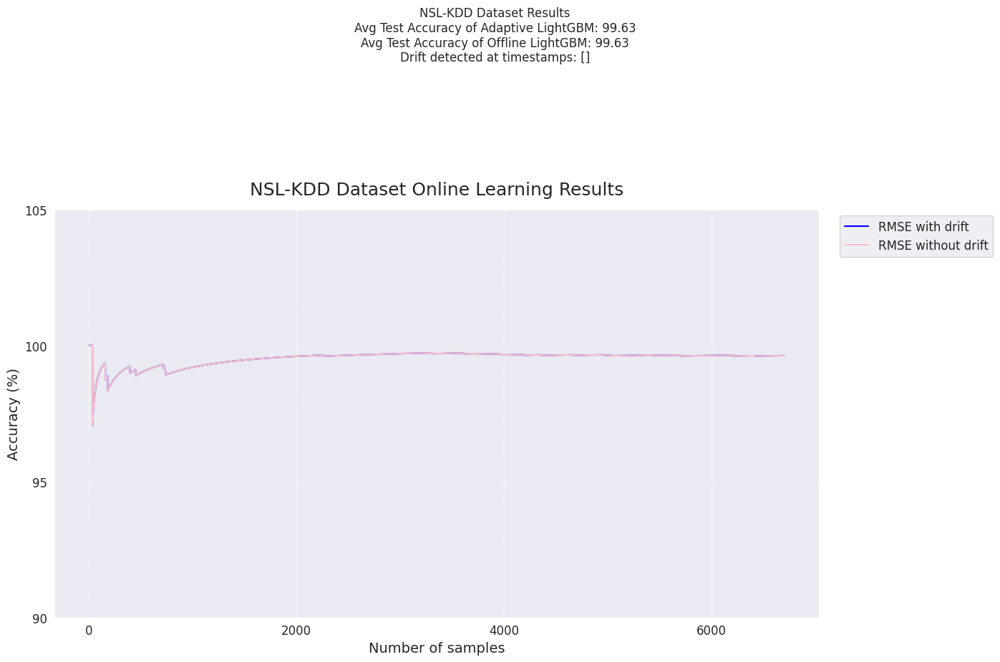

<Figure size 640x480 with 0 Axes>

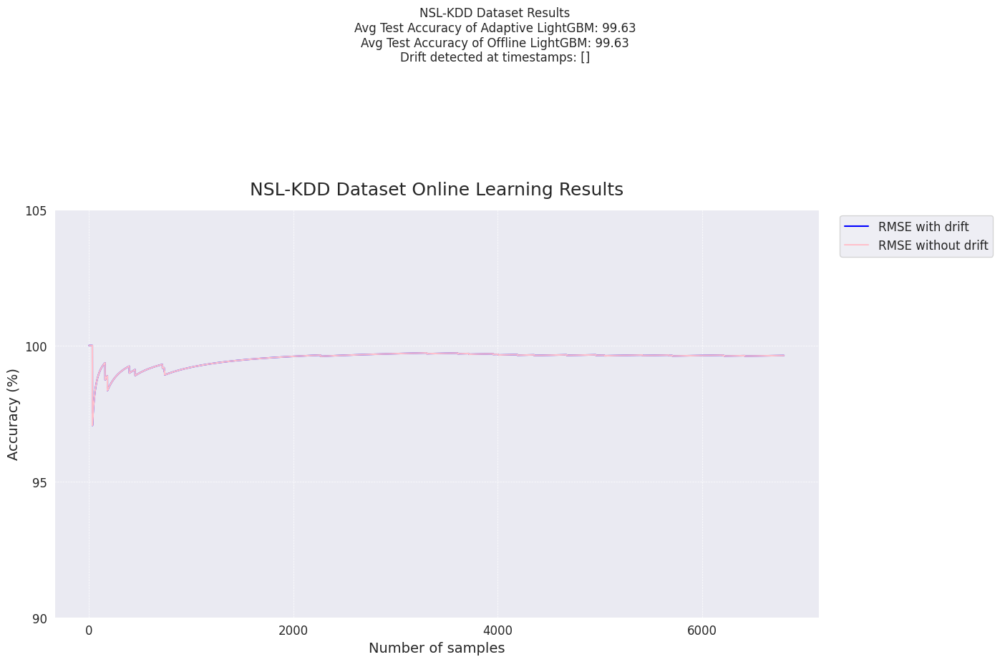

<Figure size 640x480 with 0 Axes>

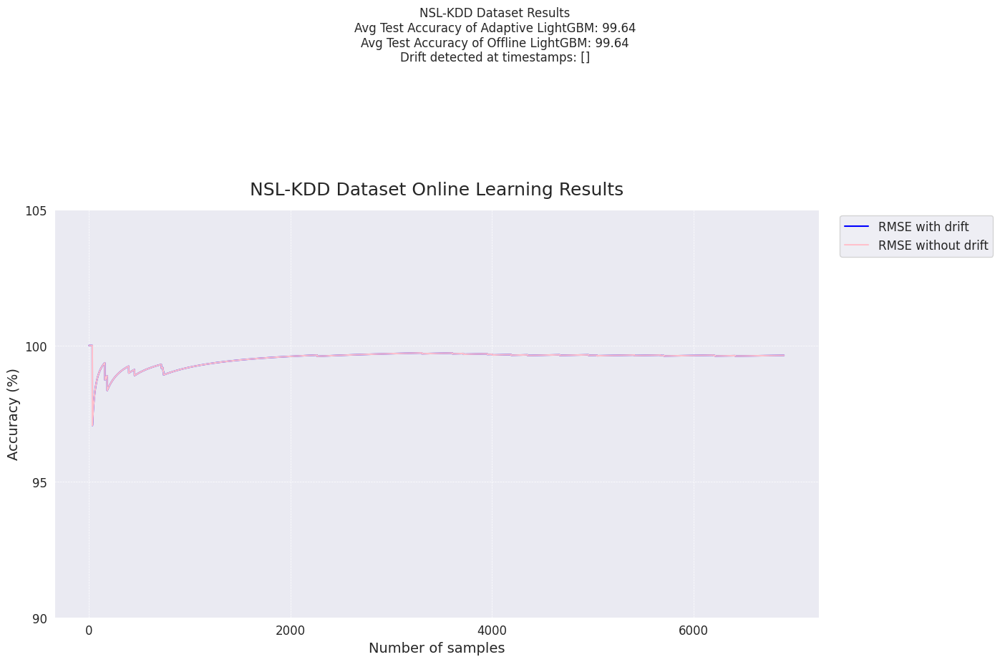

<Figure size 640x480 with 0 Axes>

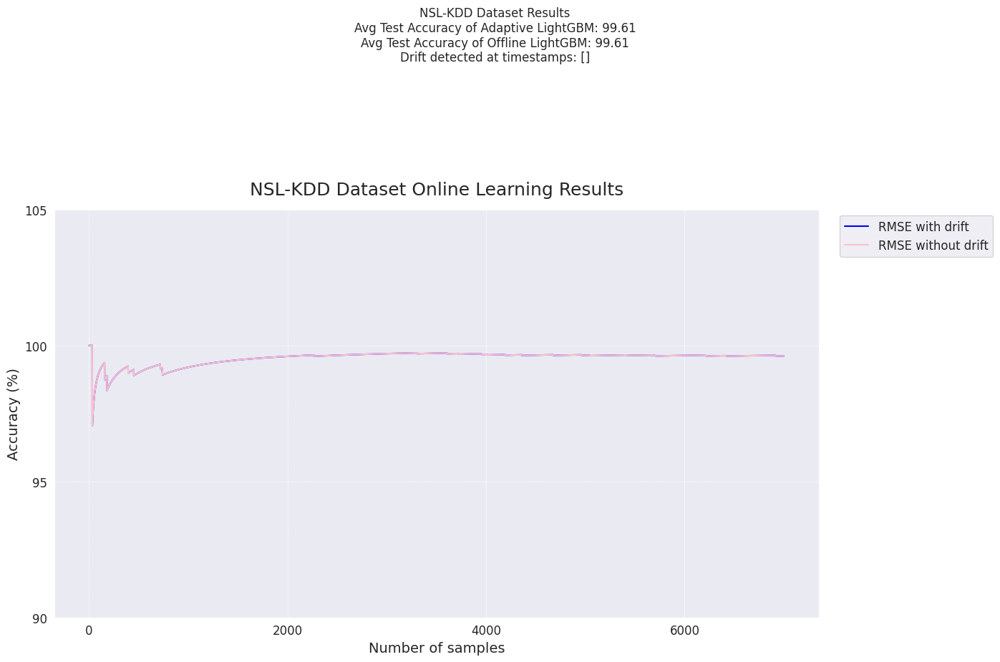

<Figure size 640x480 with 0 Axes>

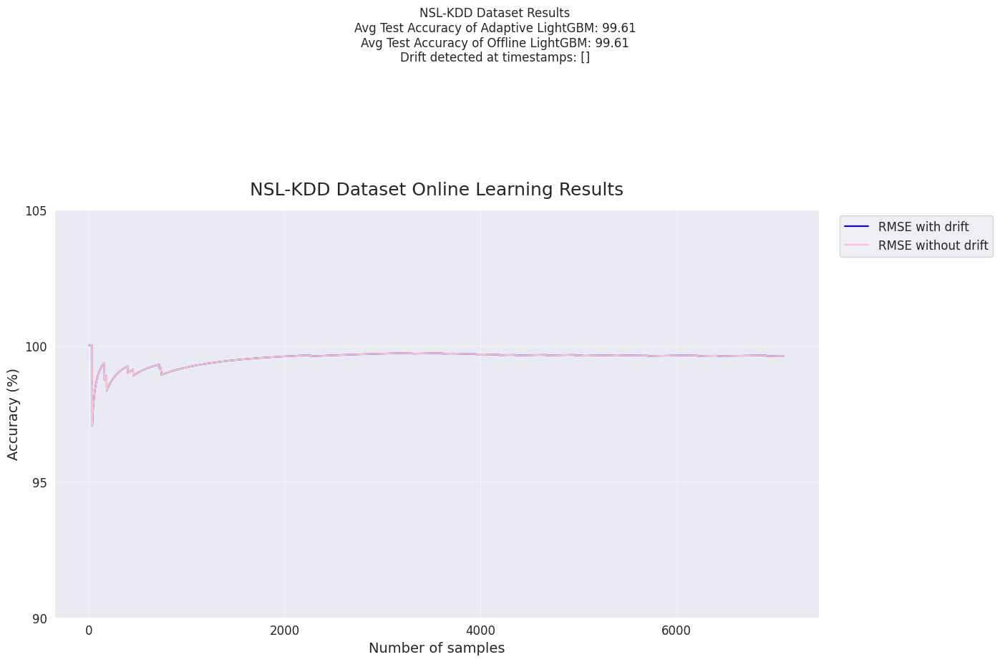

<Figure size 640x480 with 0 Axes>

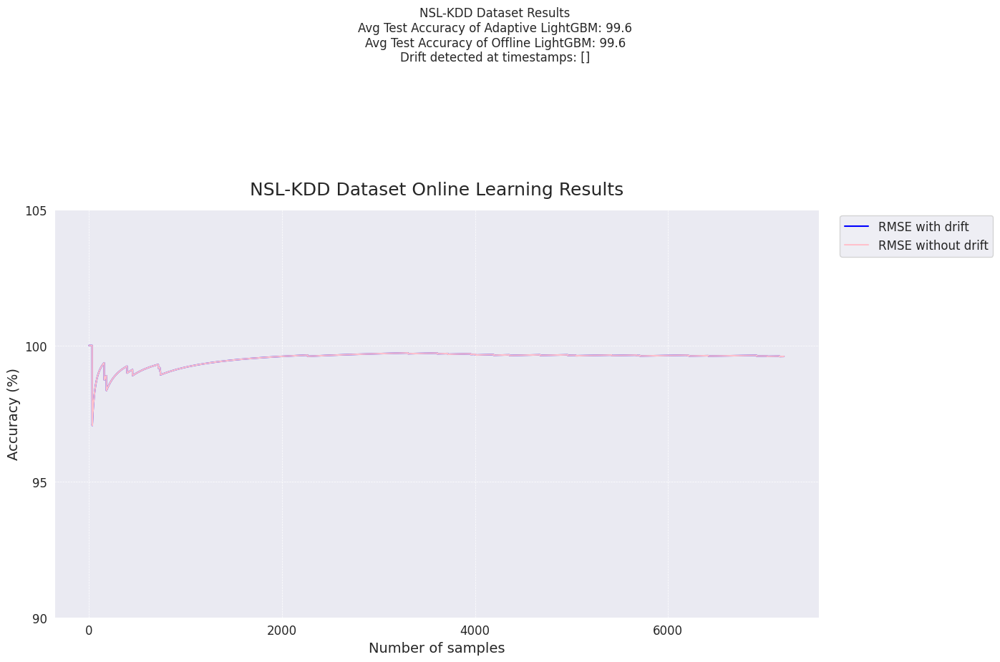

<Figure size 640x480 with 0 Axes>

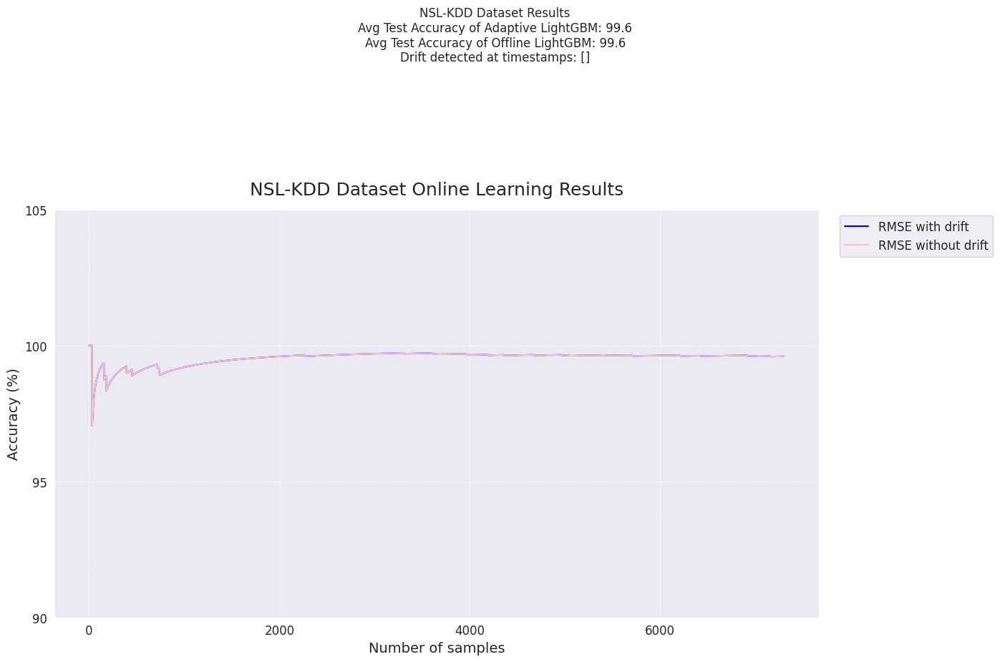

<Figure size 640x480 with 0 Axes>

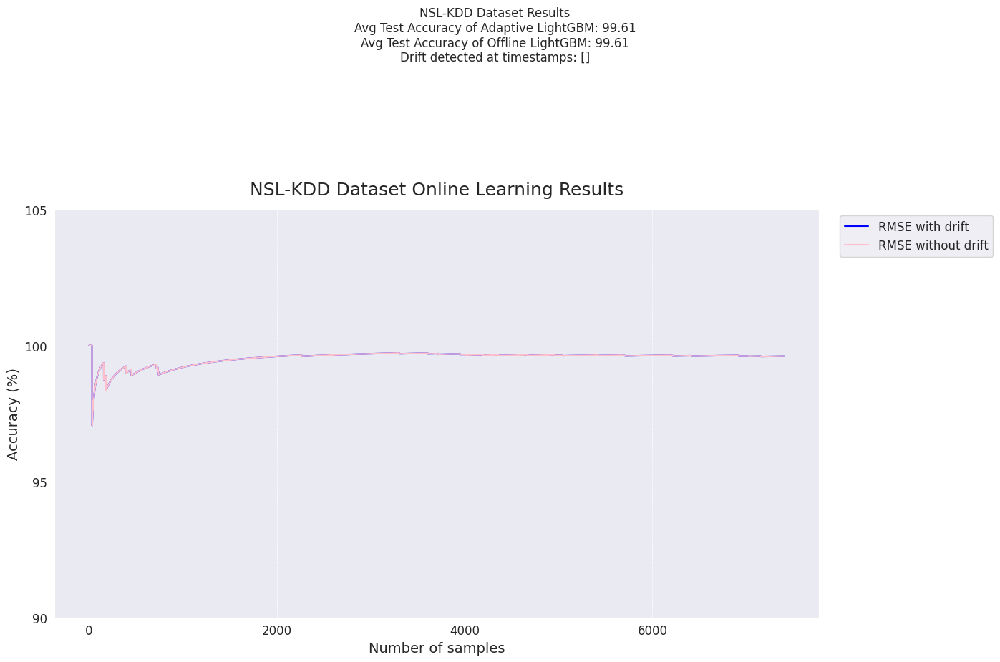

<Figure size 640x480 with 0 Axes>

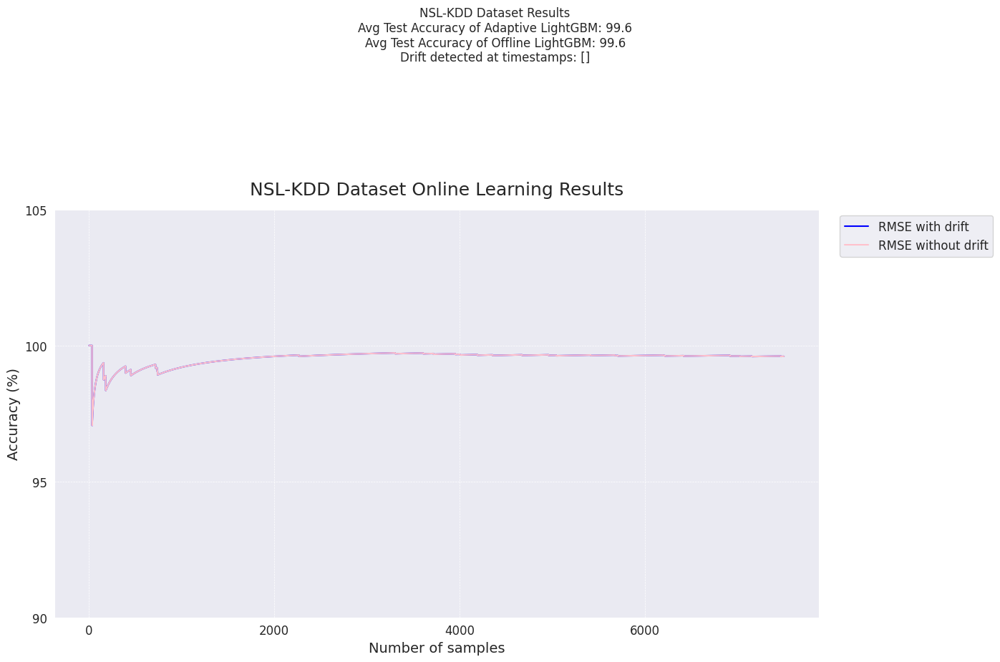

<Figure size 640x480 with 0 Axes>

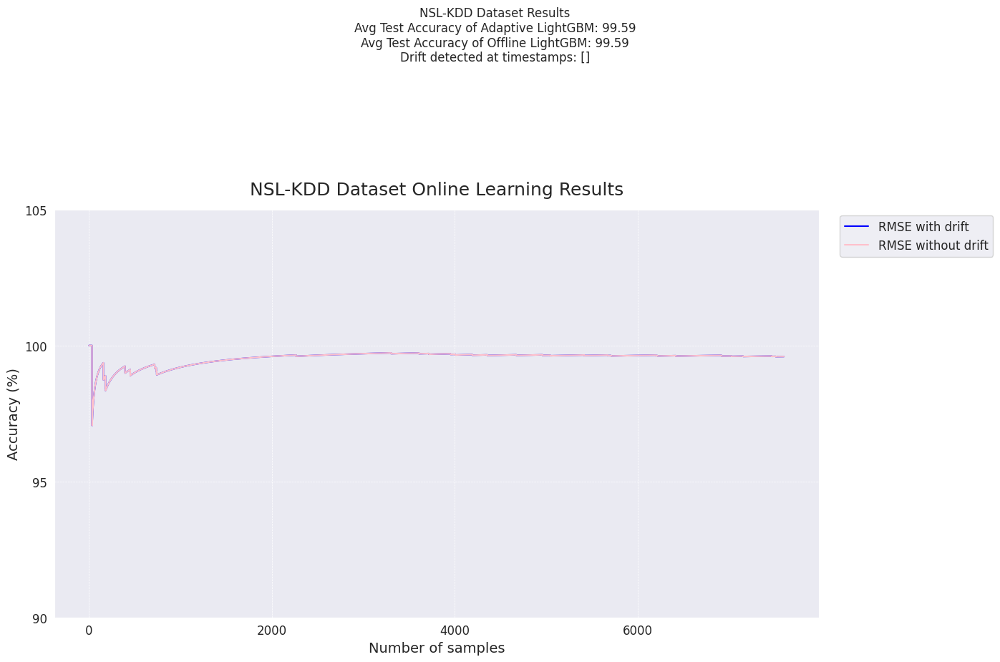

<Figure size 640x480 with 0 Axes>

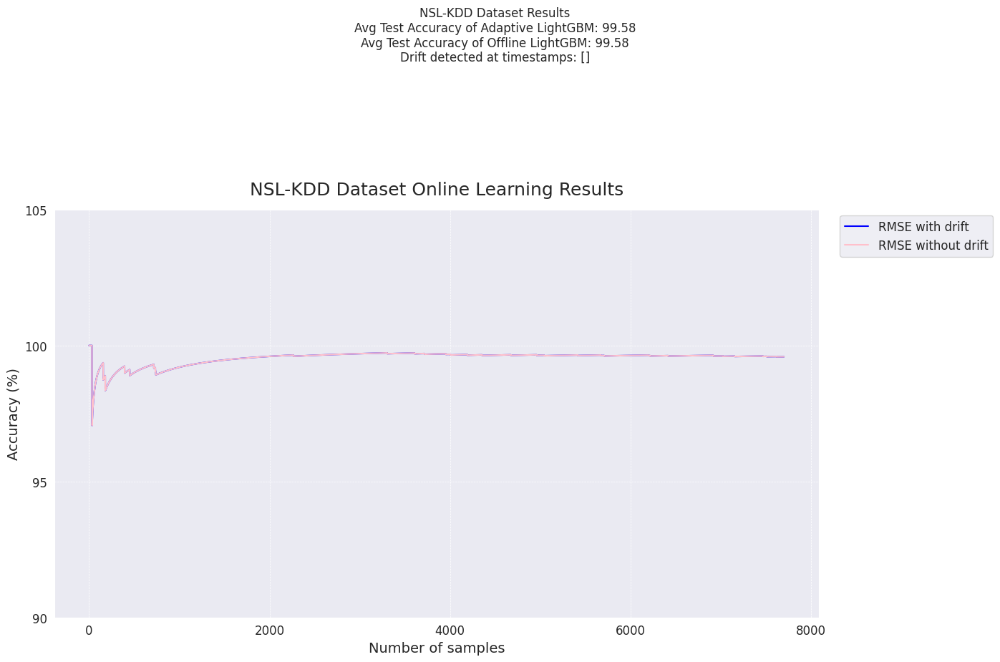

<Figure size 640x480 with 0 Axes>

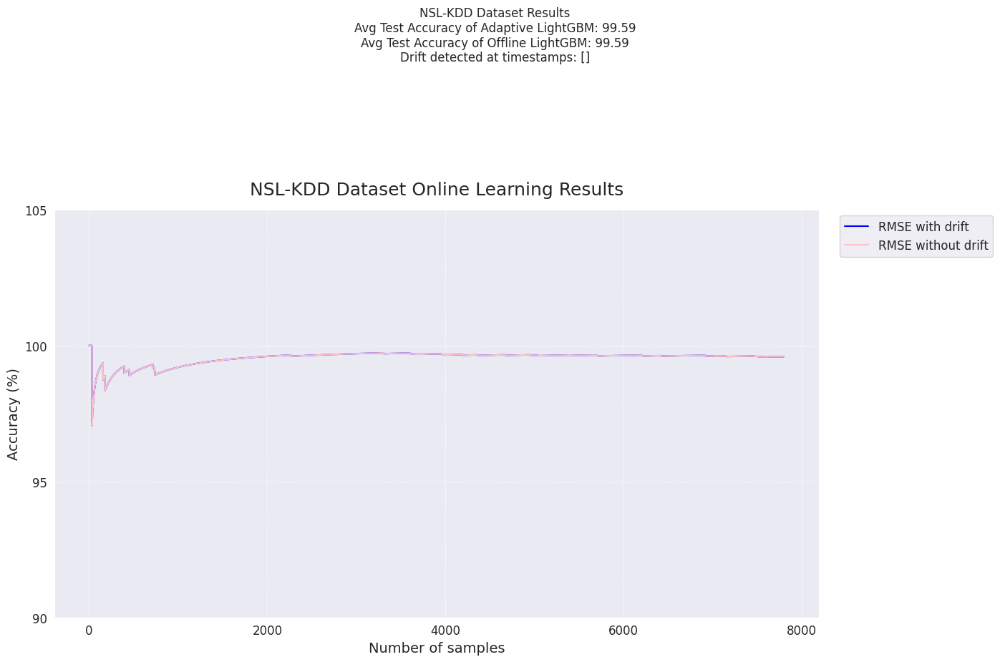

<Figure size 640x480 with 0 Axes>

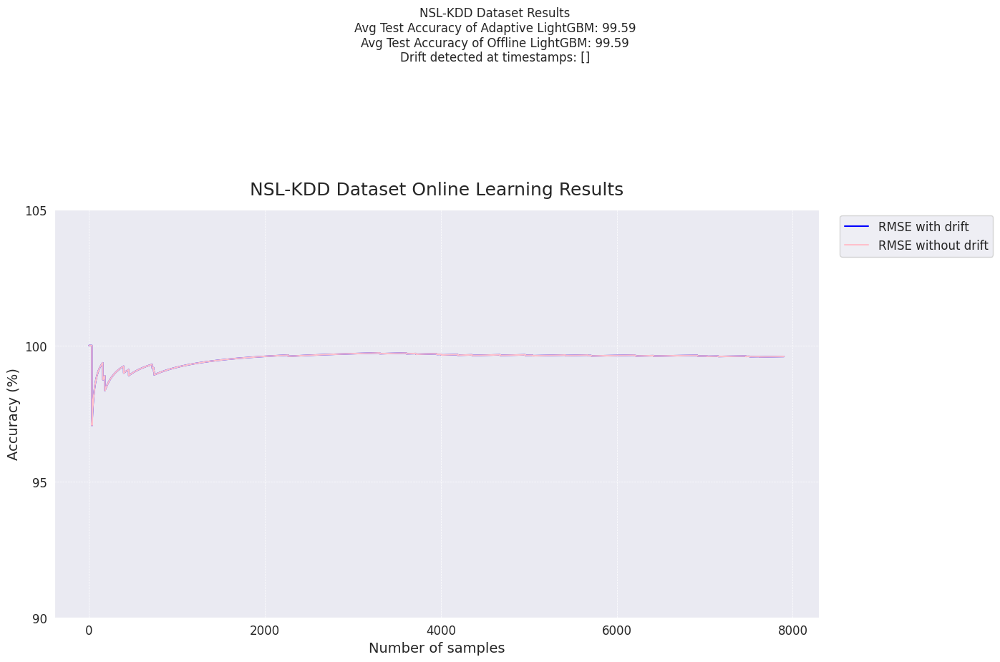

<Figure size 640x480 with 0 Axes>

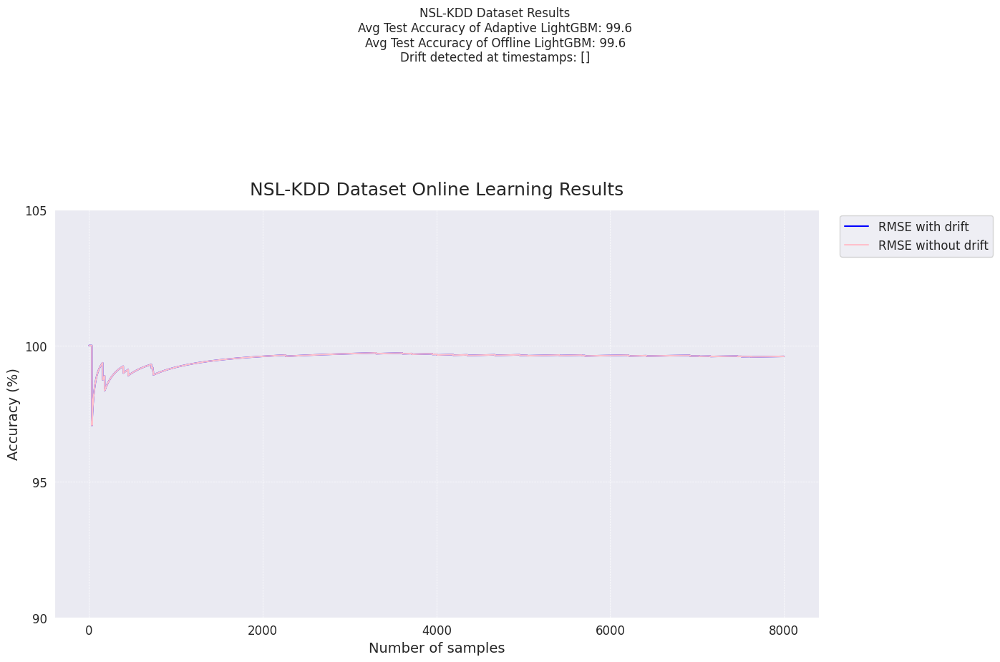

<Figure size 640x480 with 0 Axes>

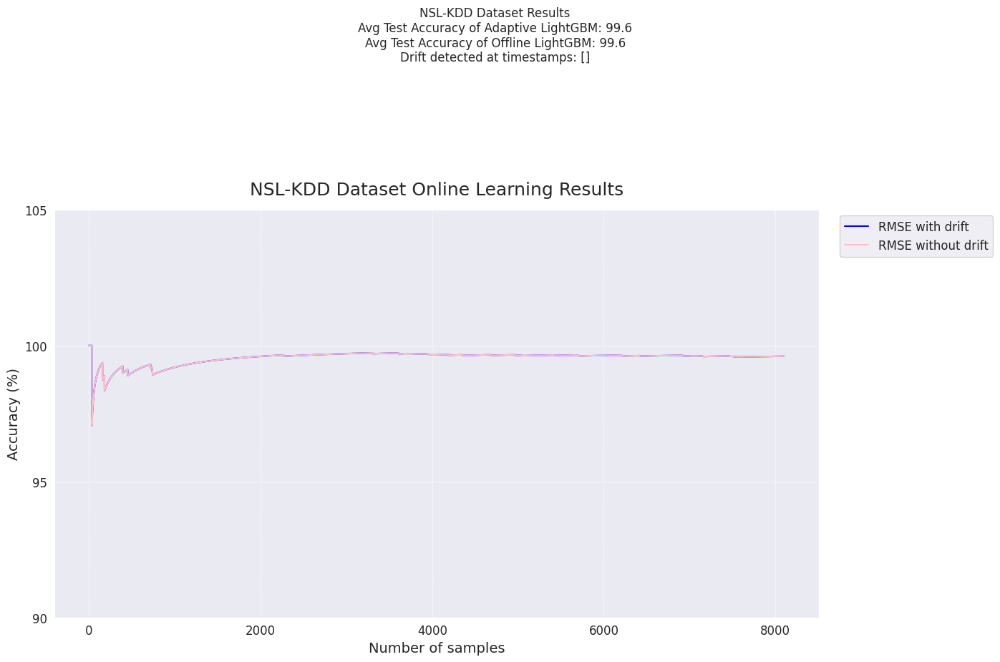

<Figure size 640x480 with 0 Axes>

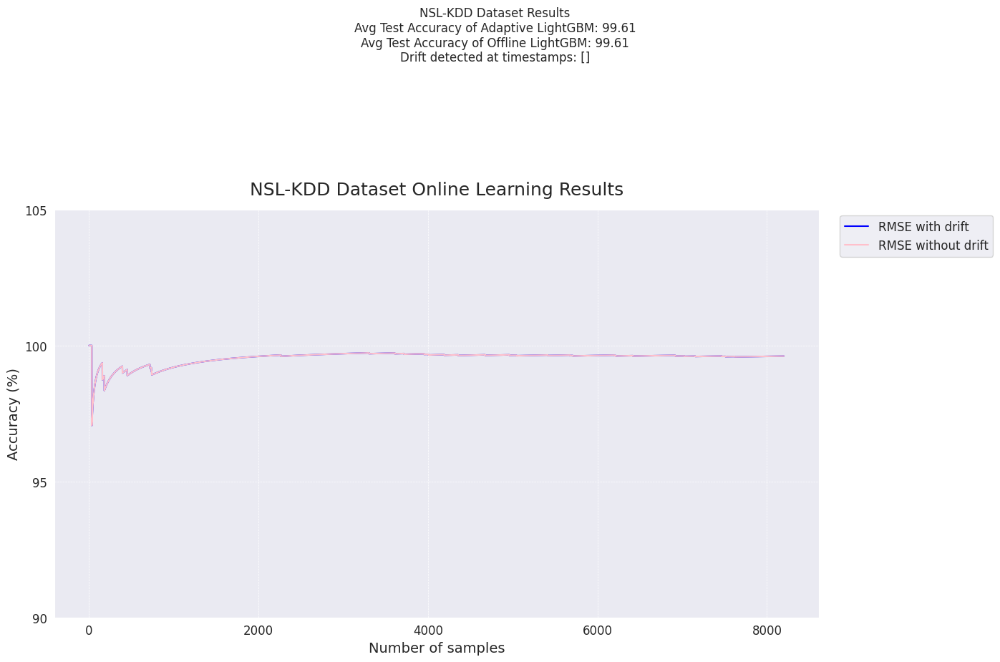

<Figure size 640x480 with 0 Axes>

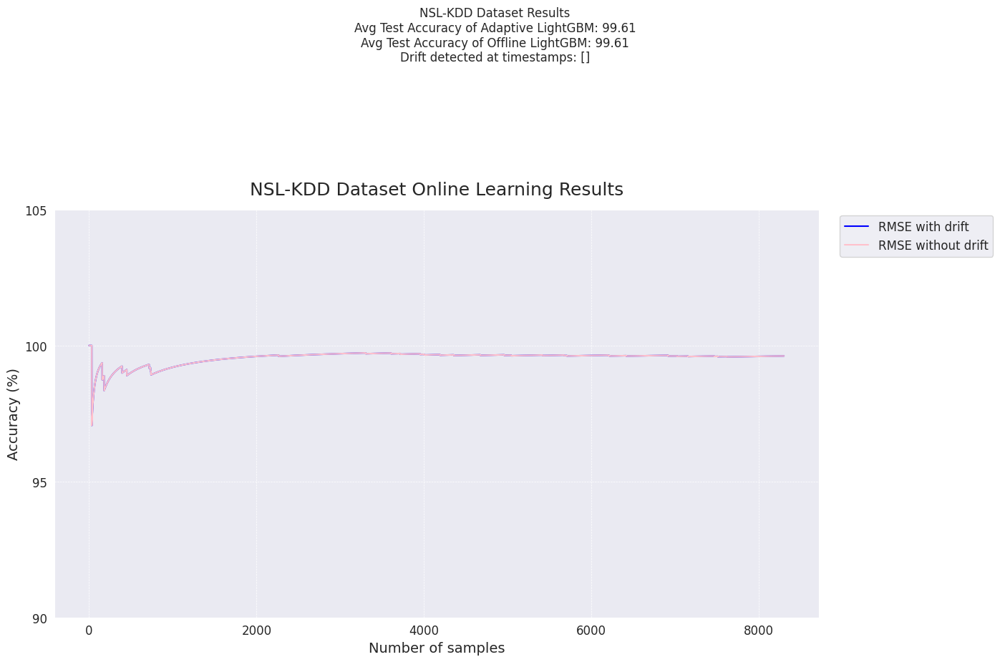

<Figure size 640x480 with 0 Axes>

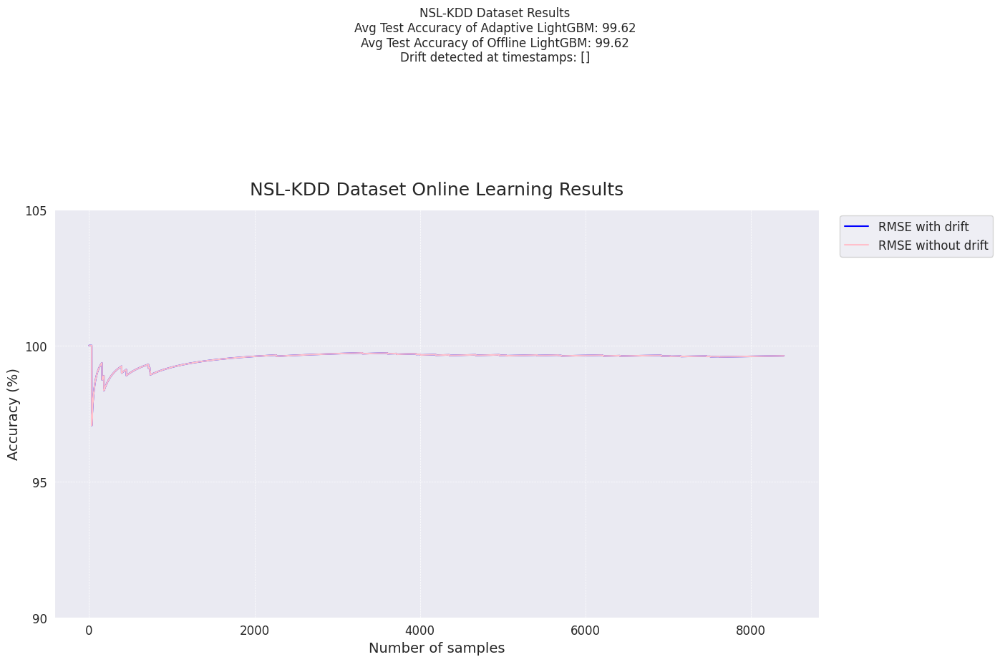

<Figure size 640x480 with 0 Axes>

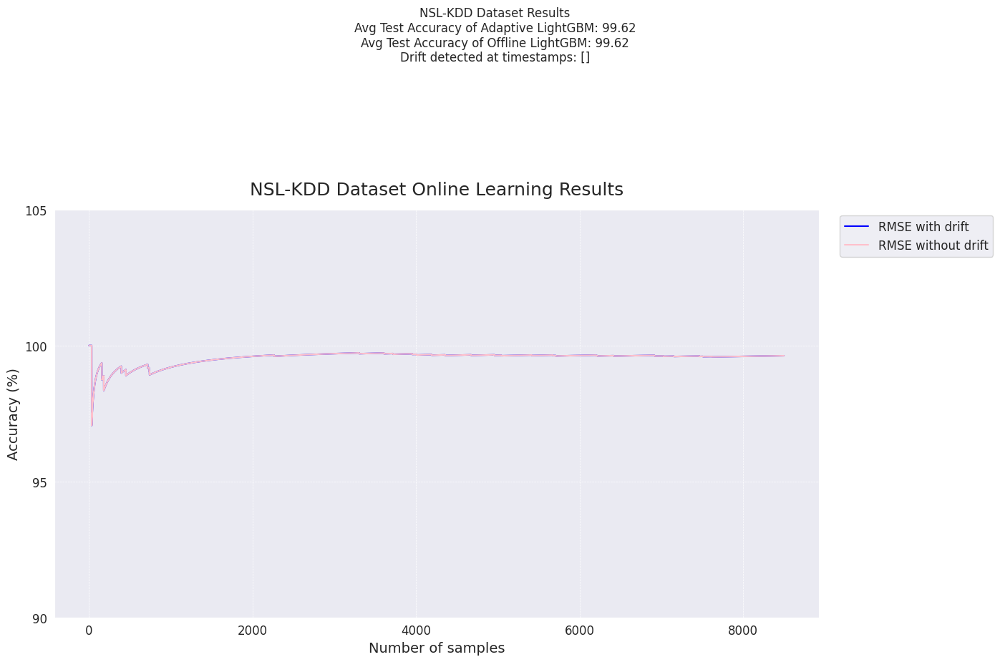

<Figure size 640x480 with 0 Axes>

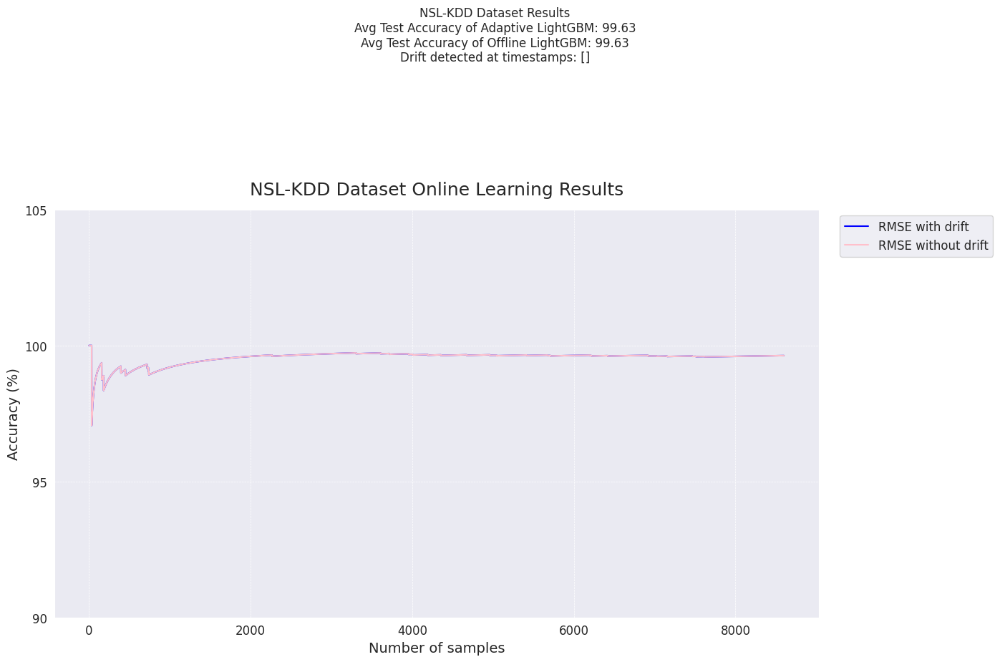

<Figure size 640x480 with 0 Axes>

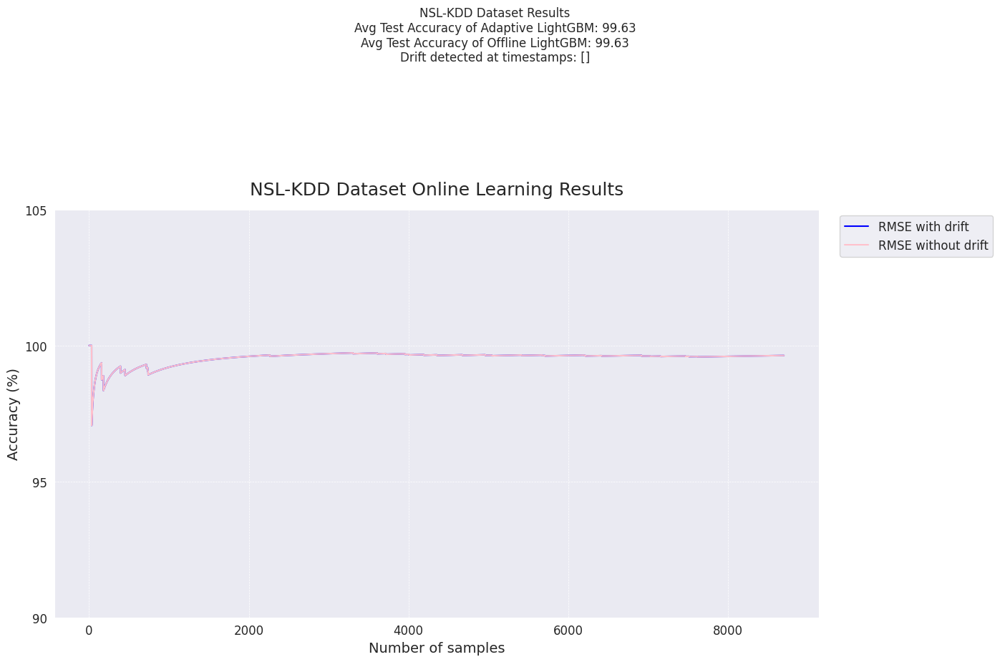

<Figure size 640x480 with 0 Axes>

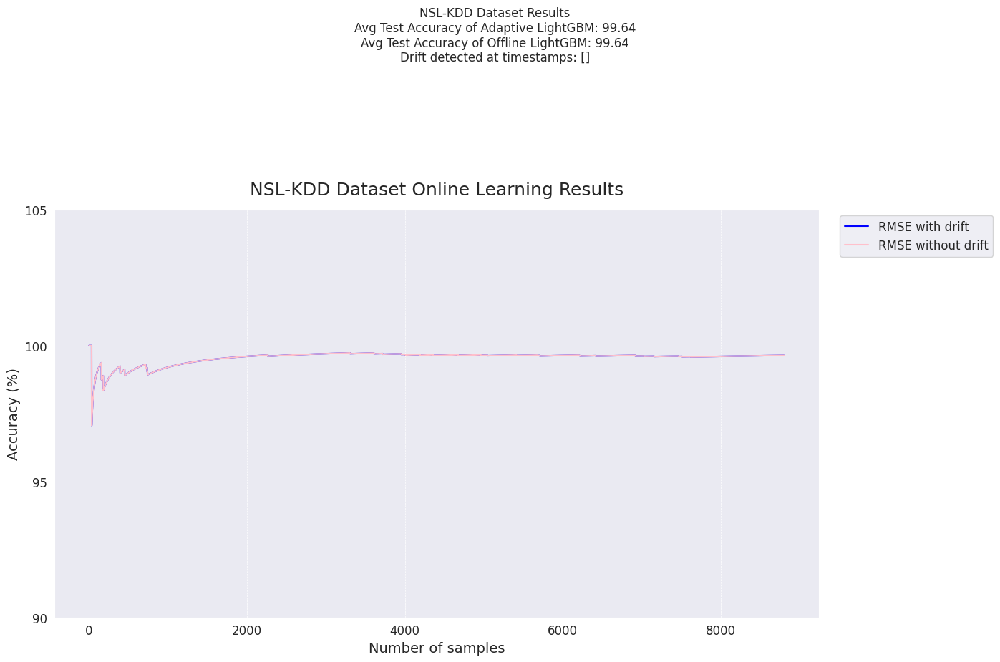

<Figure size 640x480 with 0 Axes>

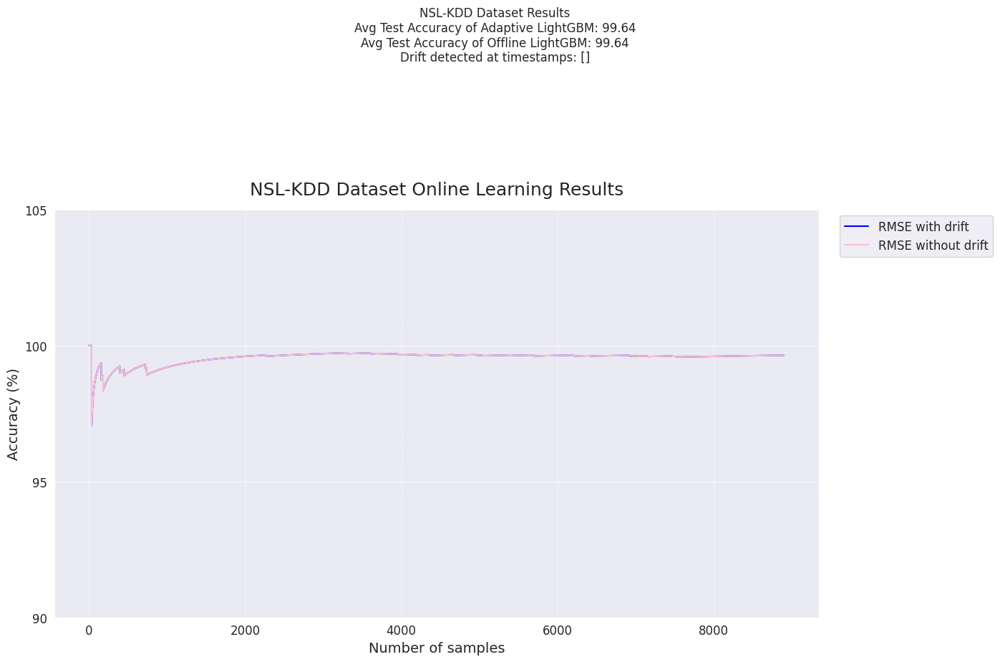

<Figure size 640x480 with 0 Axes>

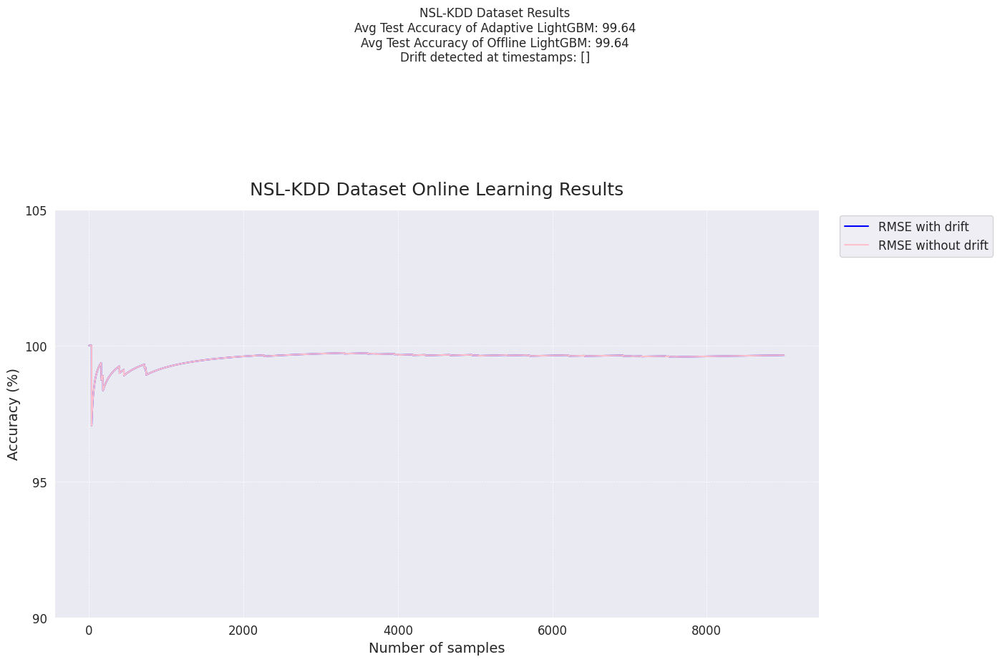

<Figure size 640x480 with 0 Axes>

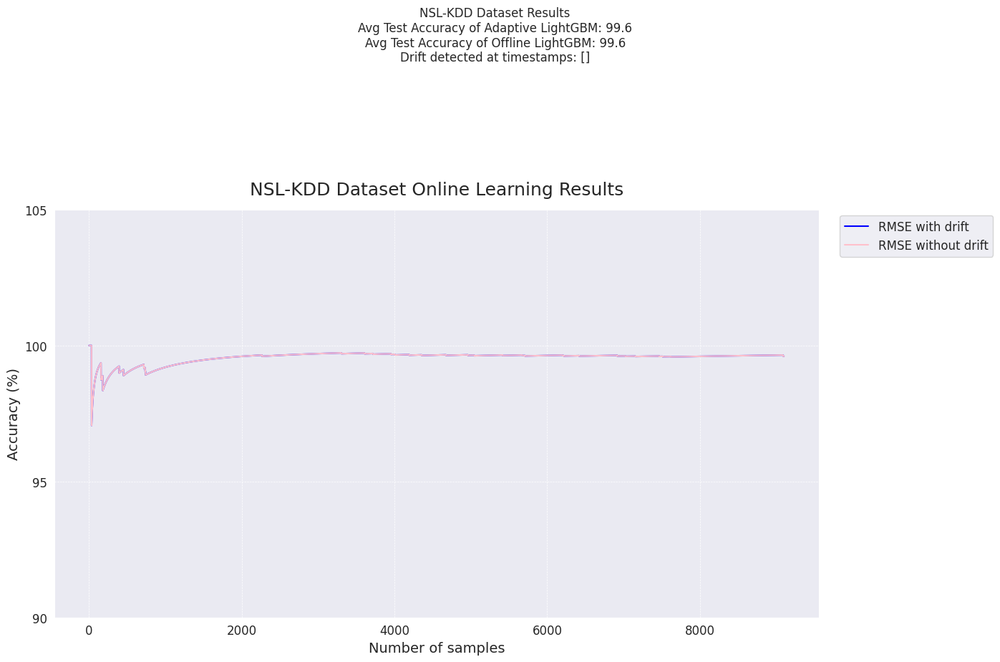

<Figure size 640x480 with 0 Axes>

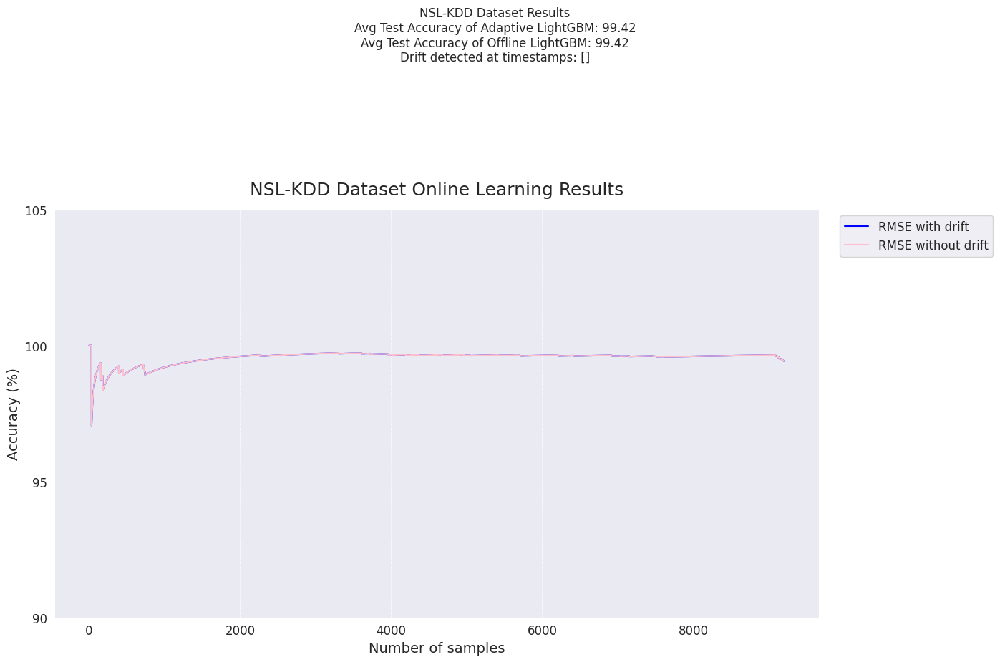

[LightGBM] [Info] Number of positive: 298, number of negative: 314
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000305 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 790
[LightGBM] [Info] Number of data points in the train set: 612, number of used features: 26
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.486928 -> initscore=-0.052299
[LightGBM] [Info] Start training from score -0.052299
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

<Figure size 640x480 with 0 Axes>

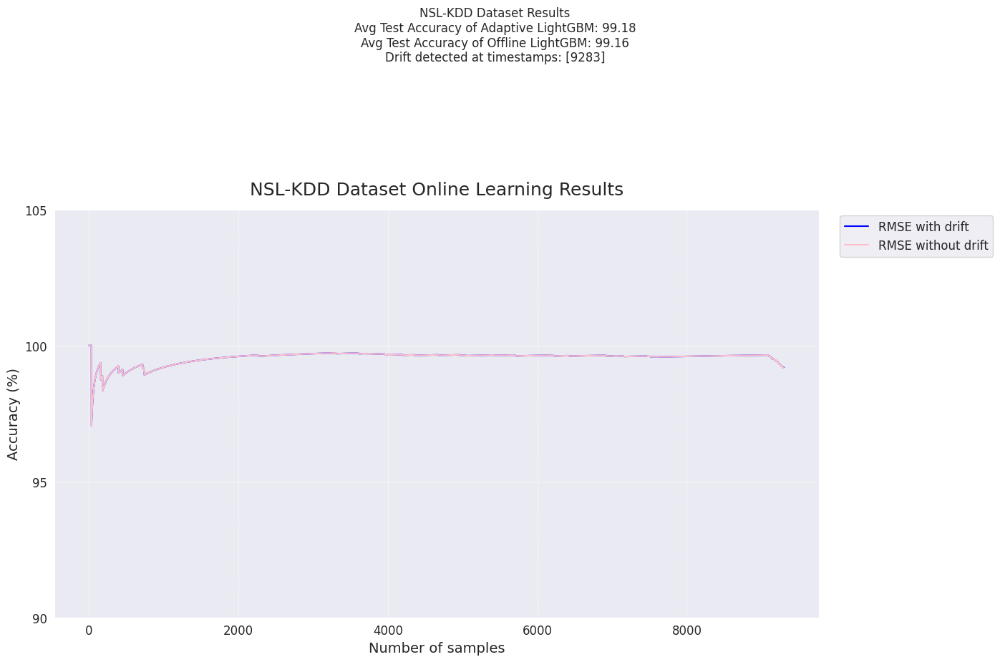

<Figure size 640x480 with 0 Axes>

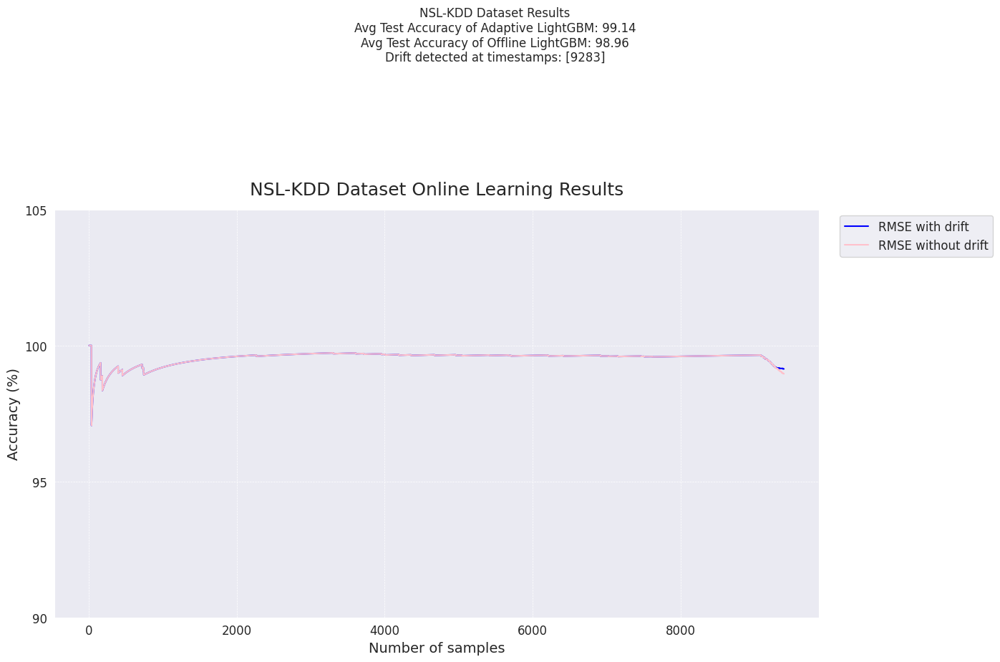

<Figure size 640x480 with 0 Axes>

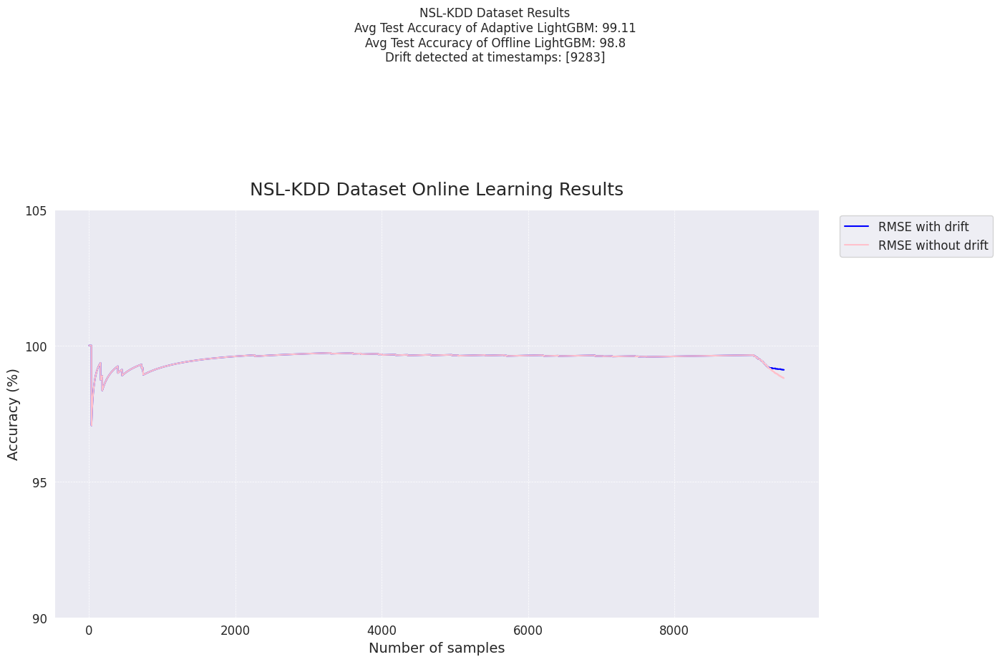

<Figure size 640x480 with 0 Axes>

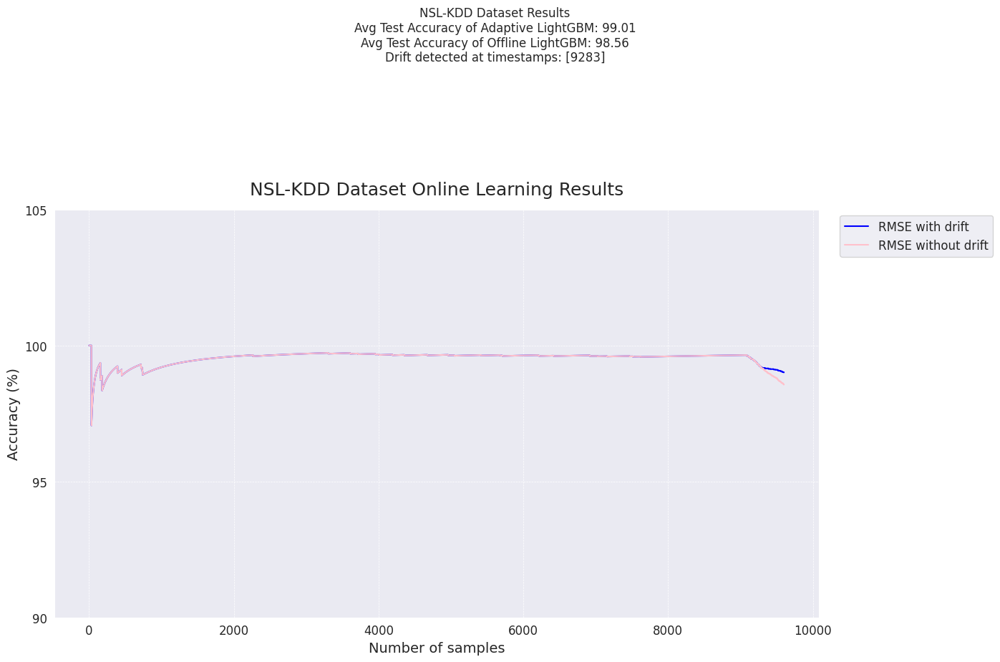

<Figure size 640x480 with 0 Axes>

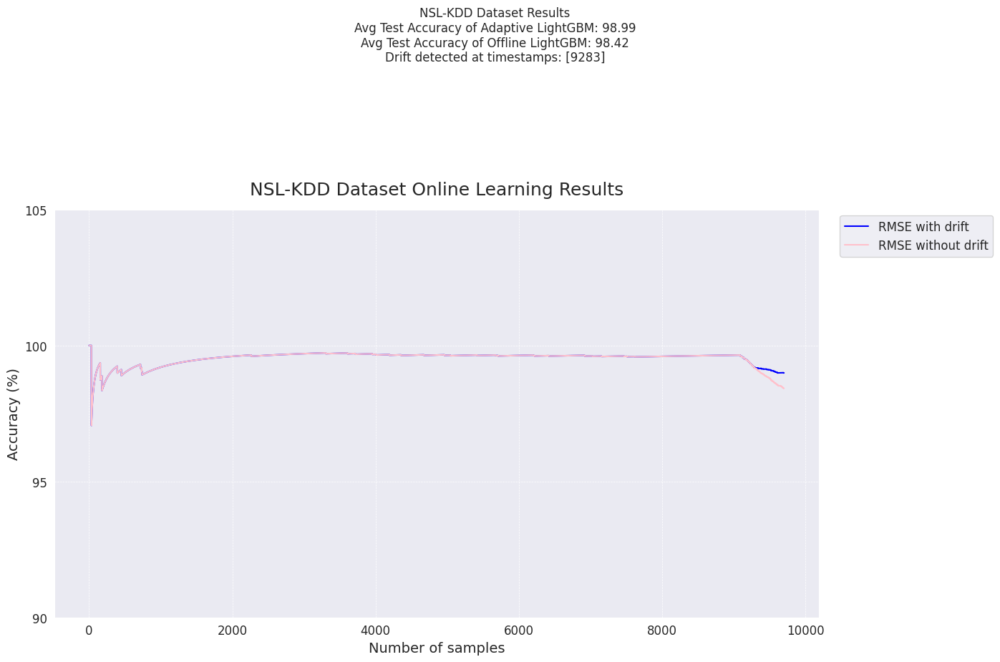

[LightGBM] [Info] Number of positive: 339, number of negative: 273
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000266 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 809
[LightGBM] [Info] Number of data points in the train set: 612, number of used features: 27
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.553922 -> initscore=0.216528
[LightGBM] [Info] Start training from score 0.216528
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

<Figure size 640x480 with 0 Axes>

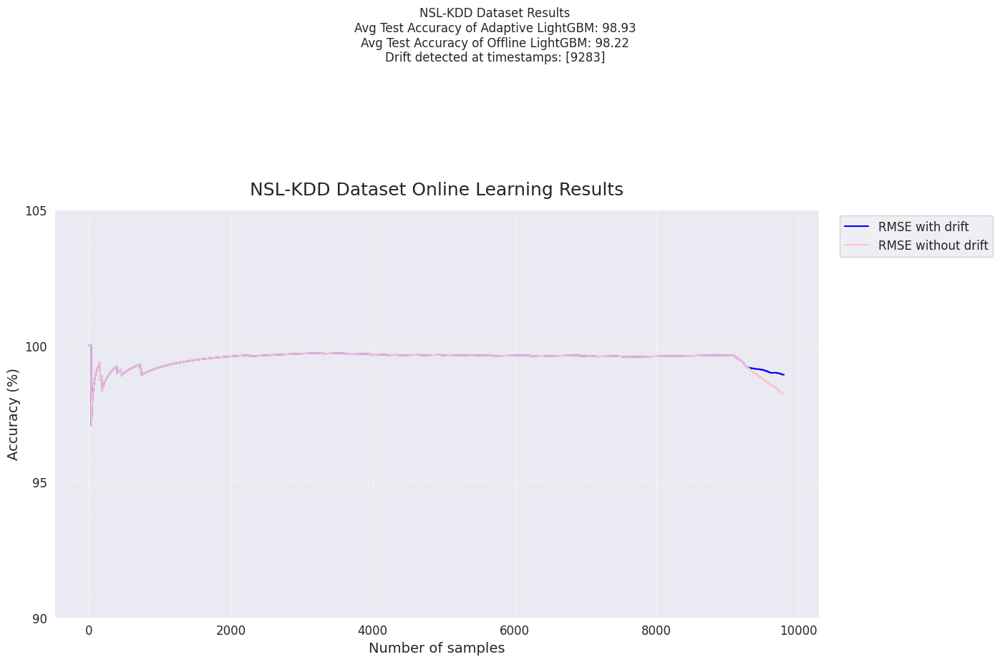

<Figure size 640x480 with 0 Axes>

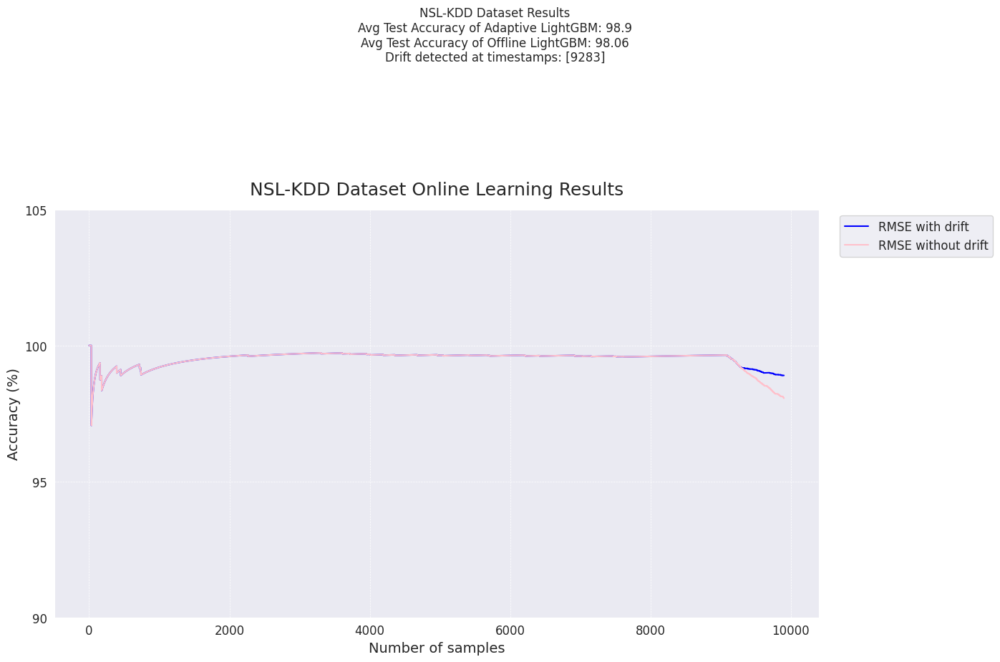

<Figure size 640x480 with 0 Axes>

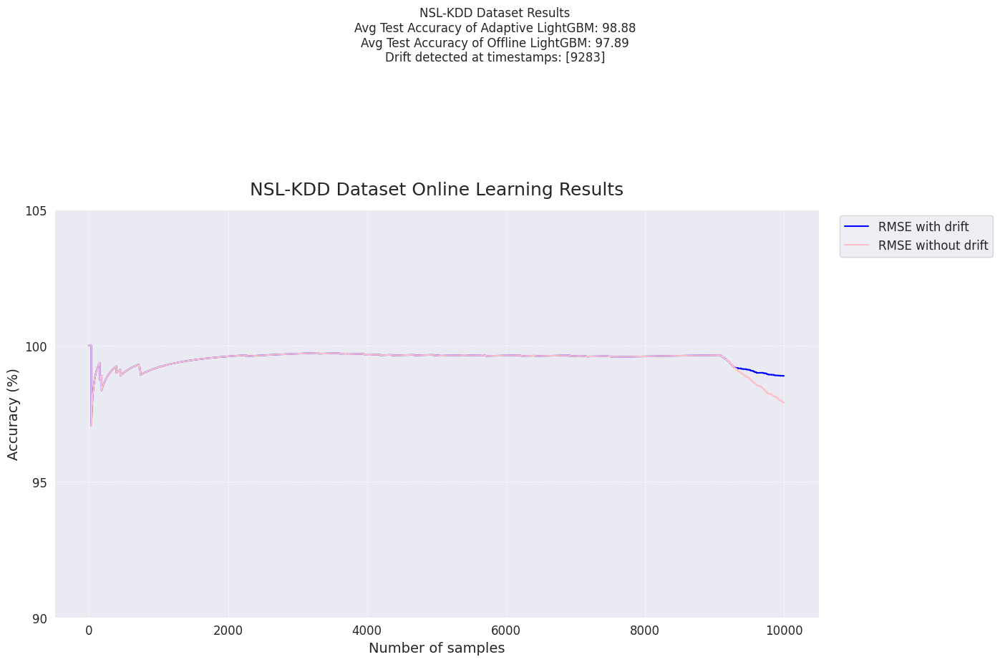

<Figure size 640x480 with 0 Axes>

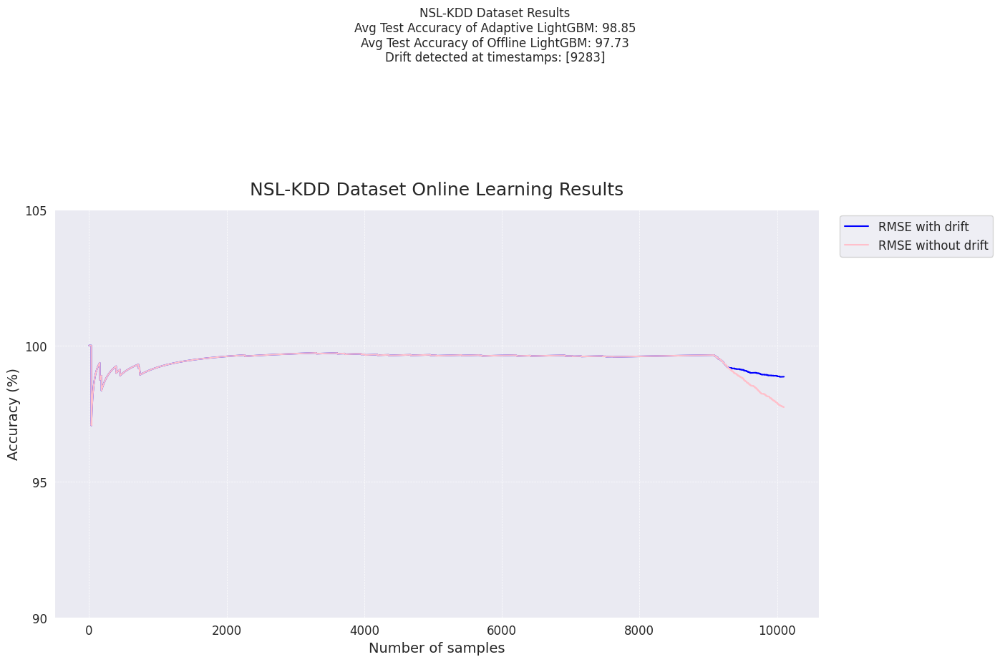

<Figure size 640x480 with 0 Axes>

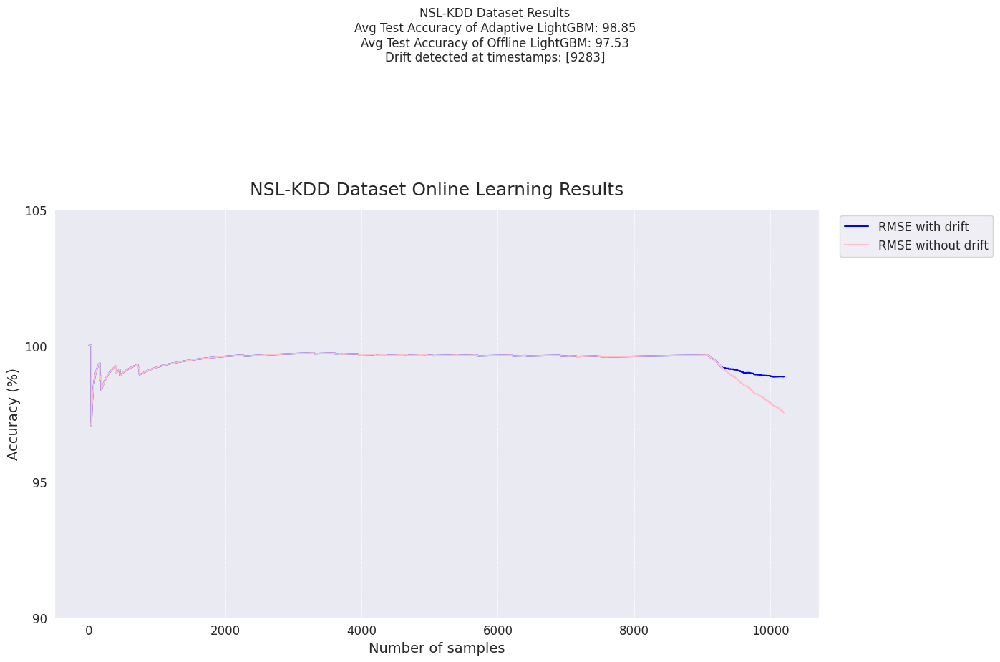

<Figure size 640x480 with 0 Axes>

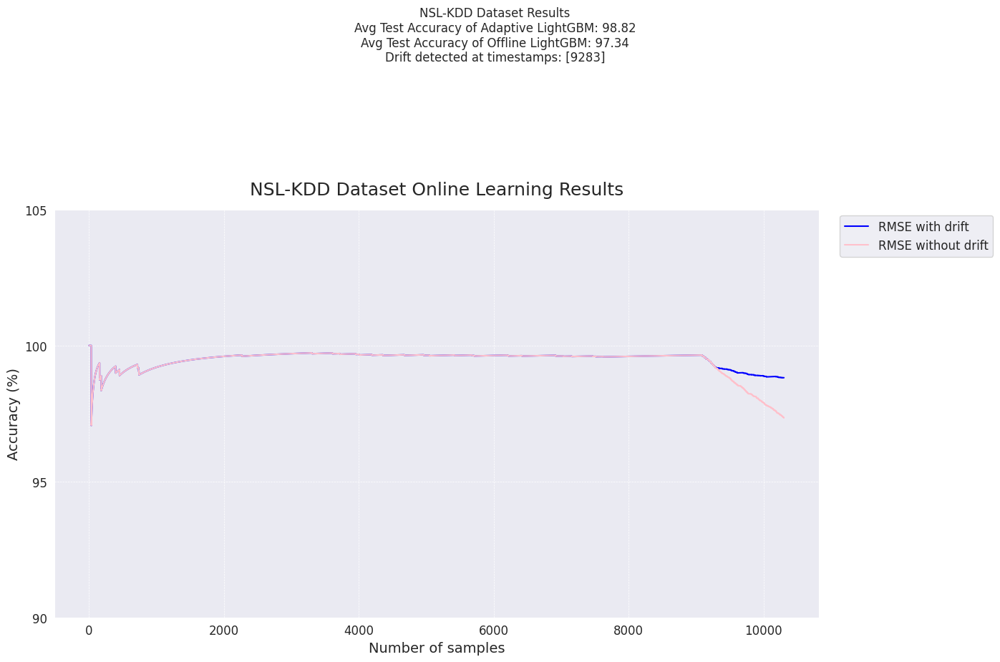

<Figure size 640x480 with 0 Axes>

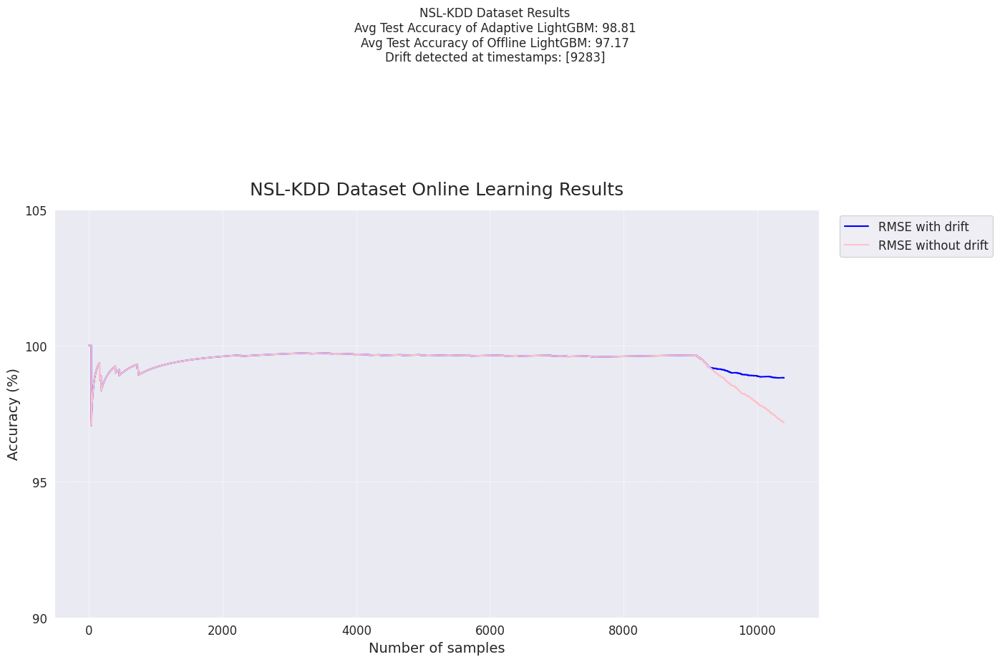

<Figure size 640x480 with 0 Axes>

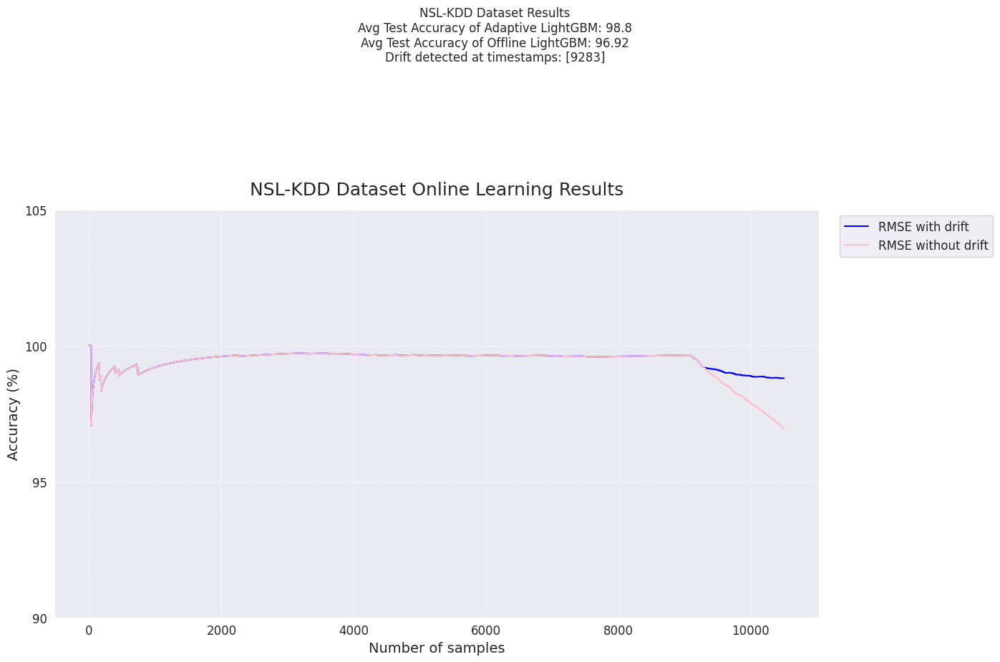

<Figure size 640x480 with 0 Axes>

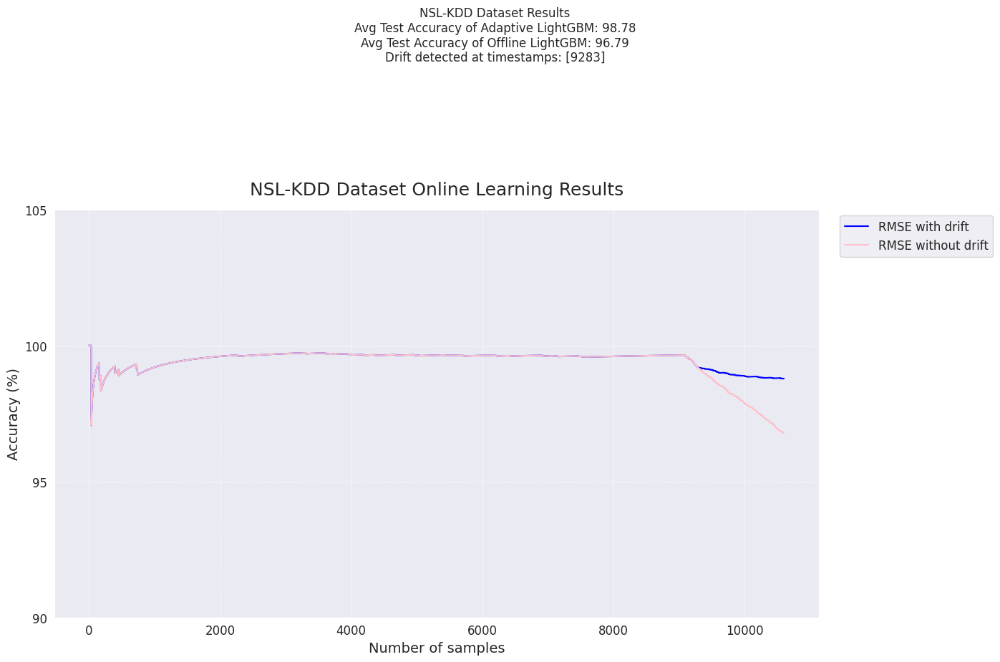

<Figure size 640x480 with 0 Axes>

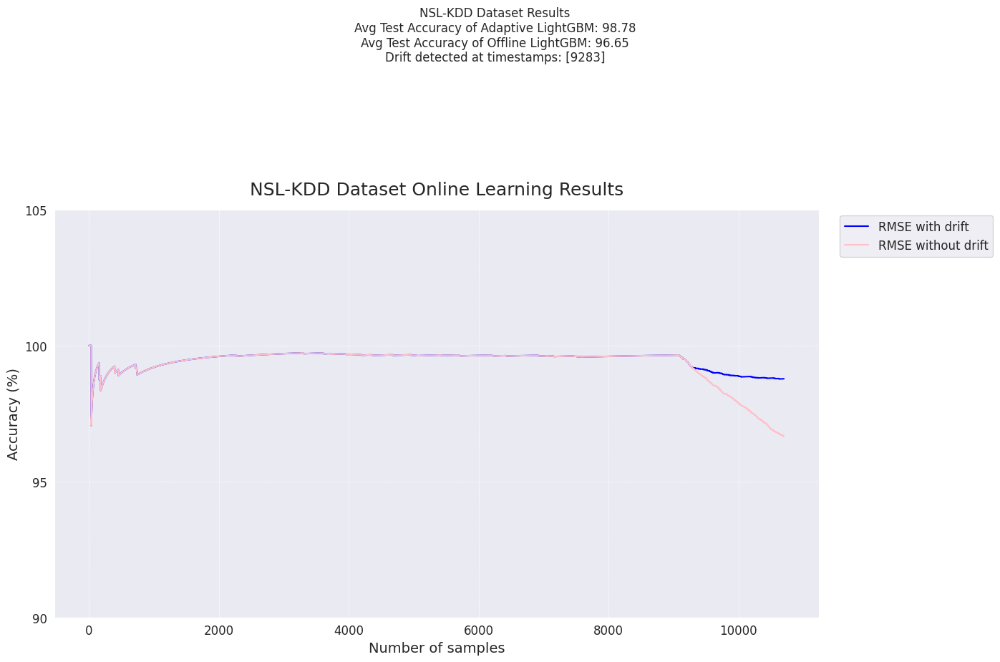

<Figure size 640x480 with 0 Axes>

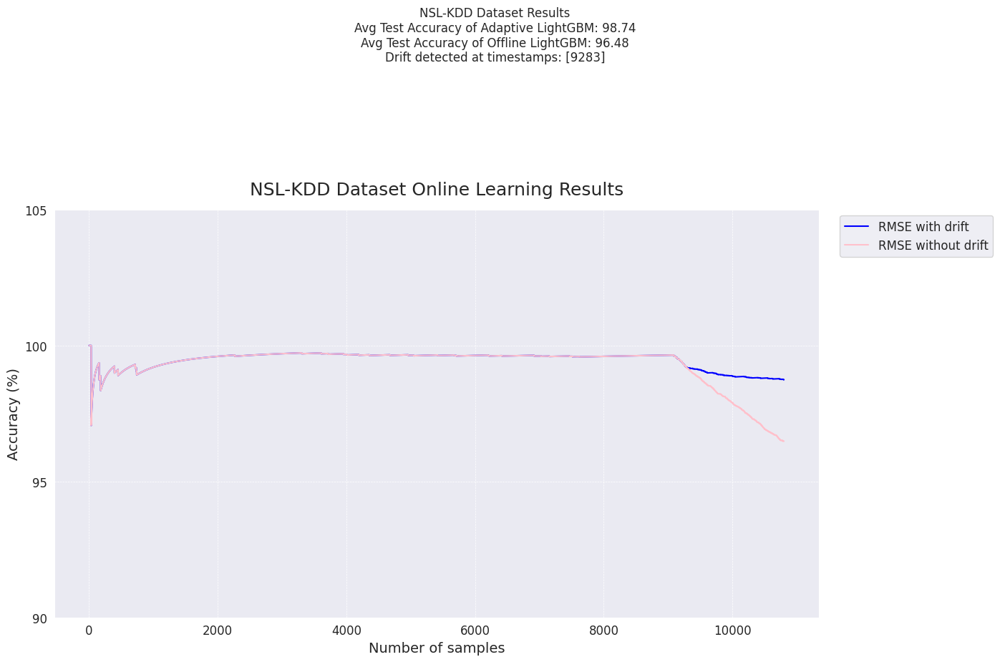

<Figure size 640x480 with 0 Axes>

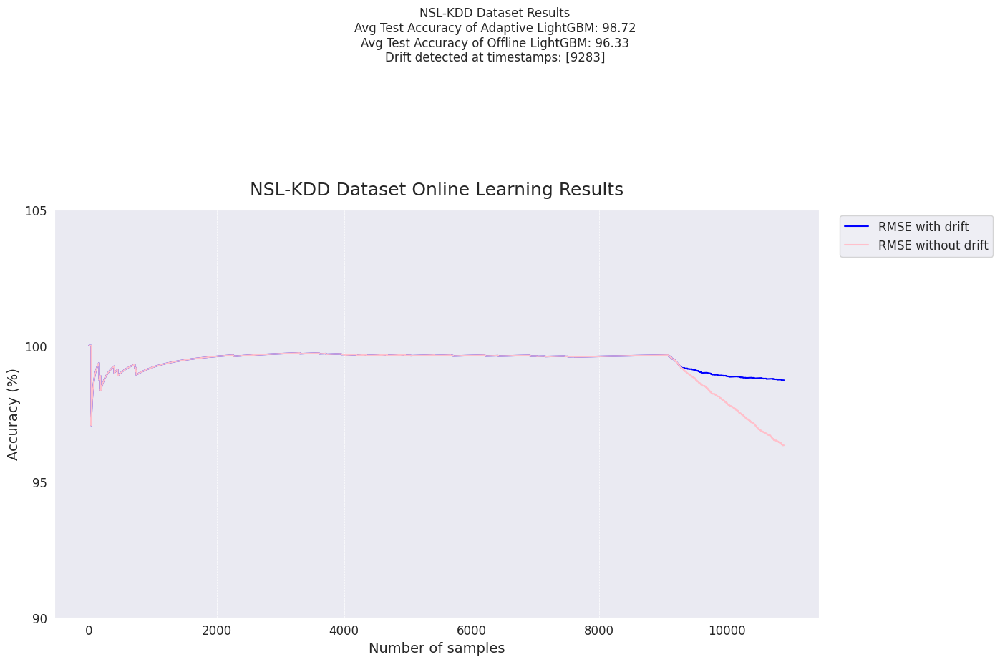

<Figure size 640x480 with 0 Axes>

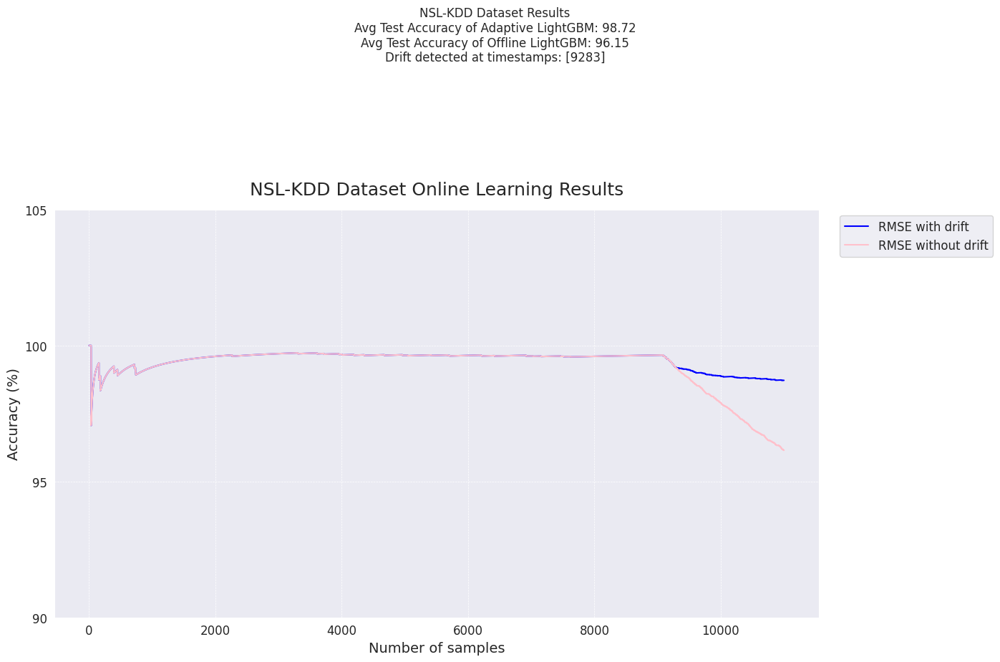

<Figure size 640x480 with 0 Axes>

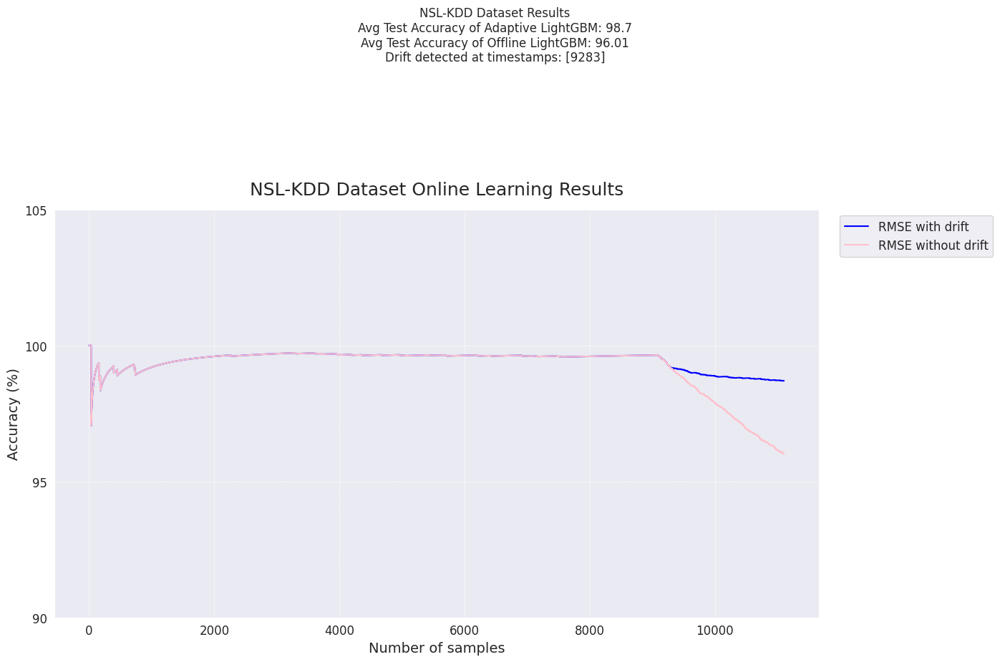

<Figure size 640x480 with 0 Axes>

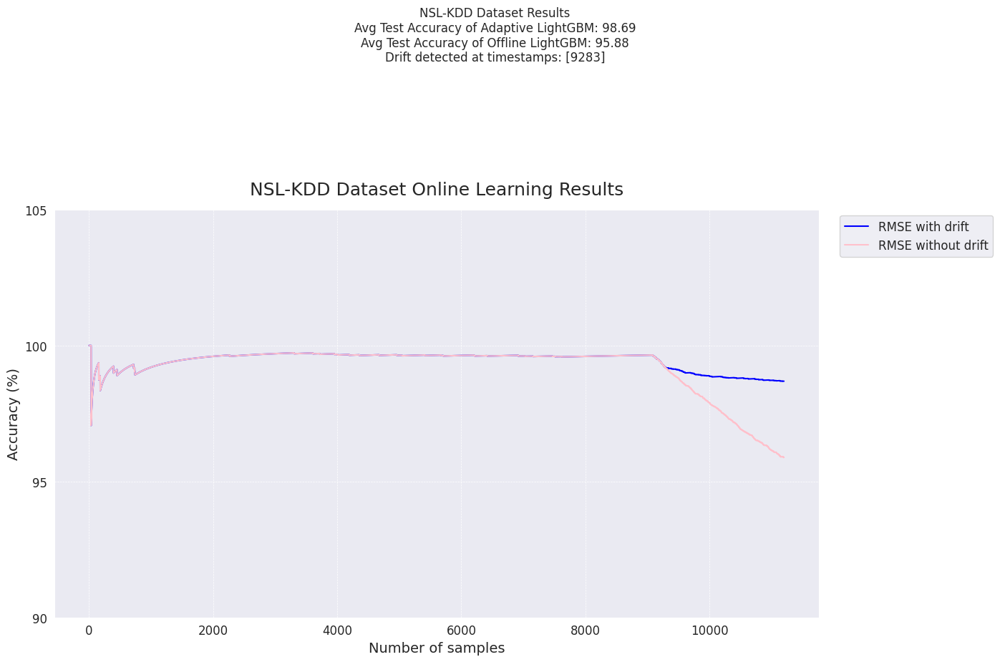

<Figure size 640x480 with 0 Axes>

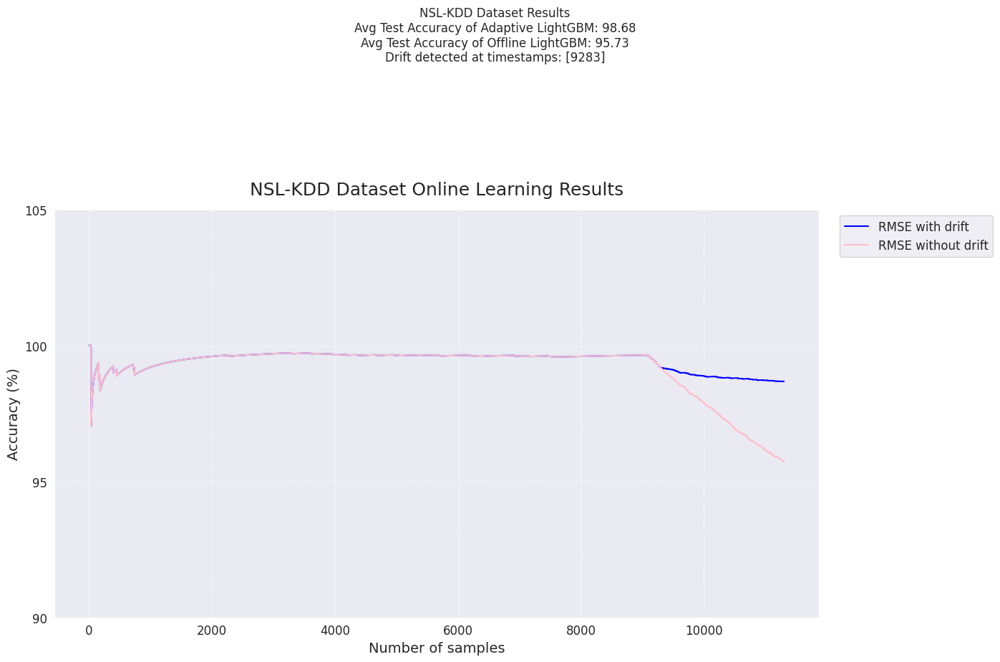

<Figure size 640x480 with 0 Axes>

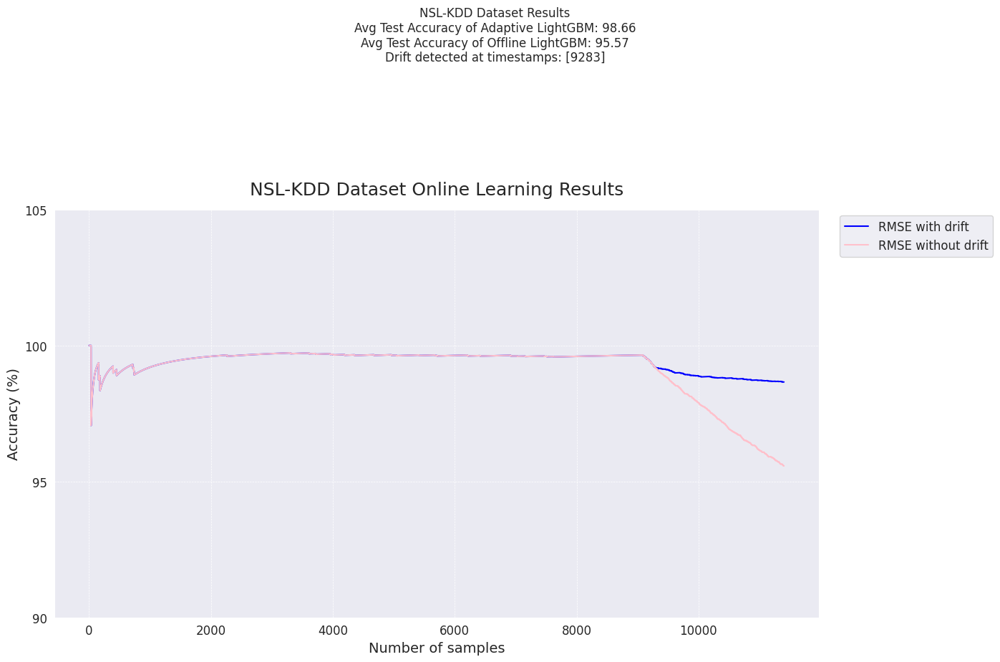

<Figure size 640x480 with 0 Axes>

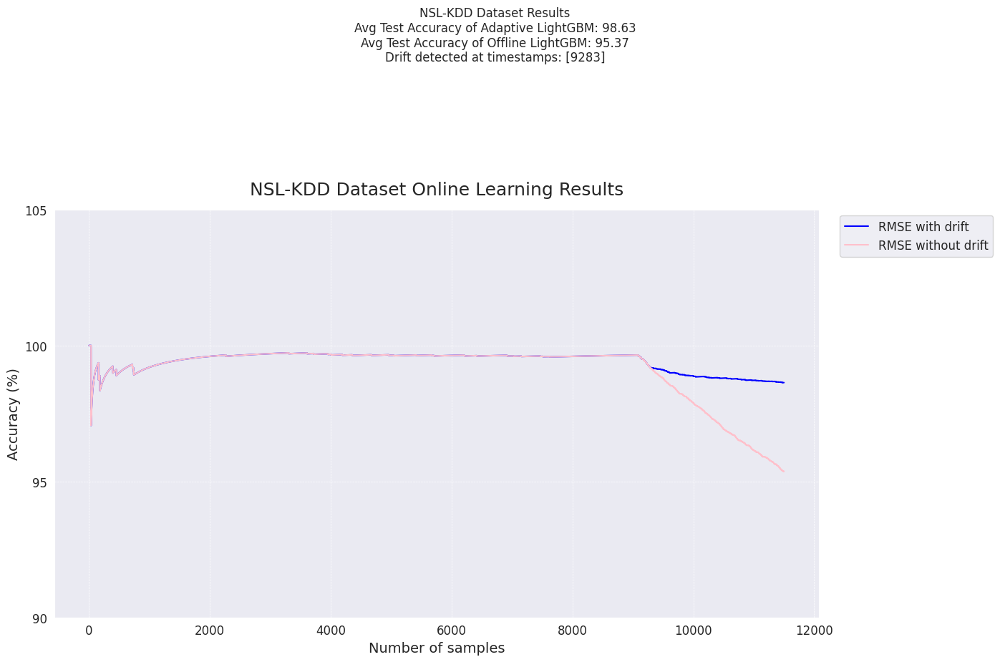

<Figure size 640x480 with 0 Axes>

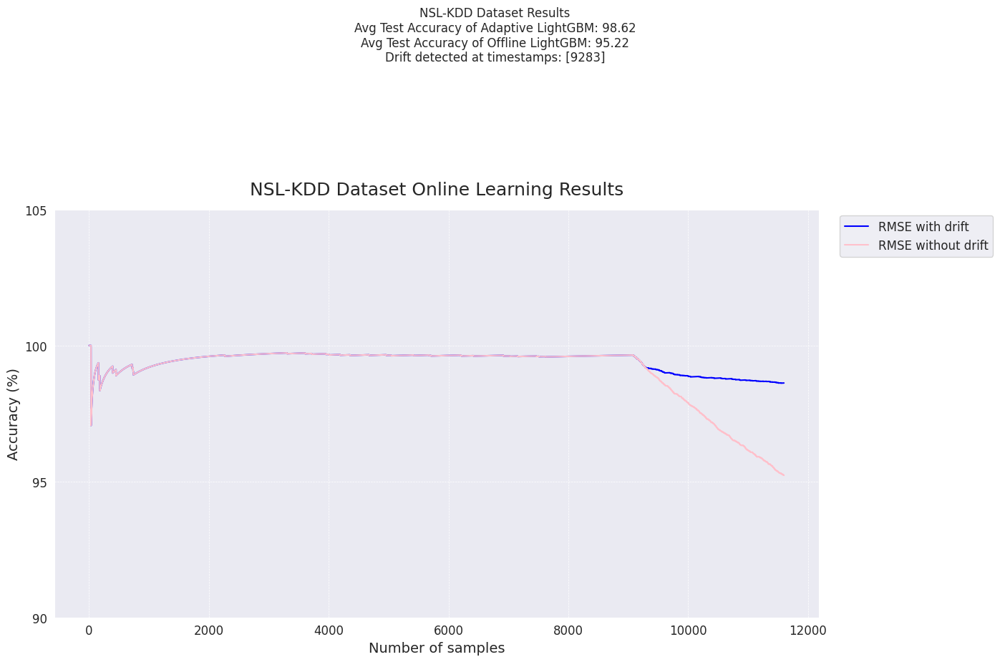

<Figure size 640x480 with 0 Axes>

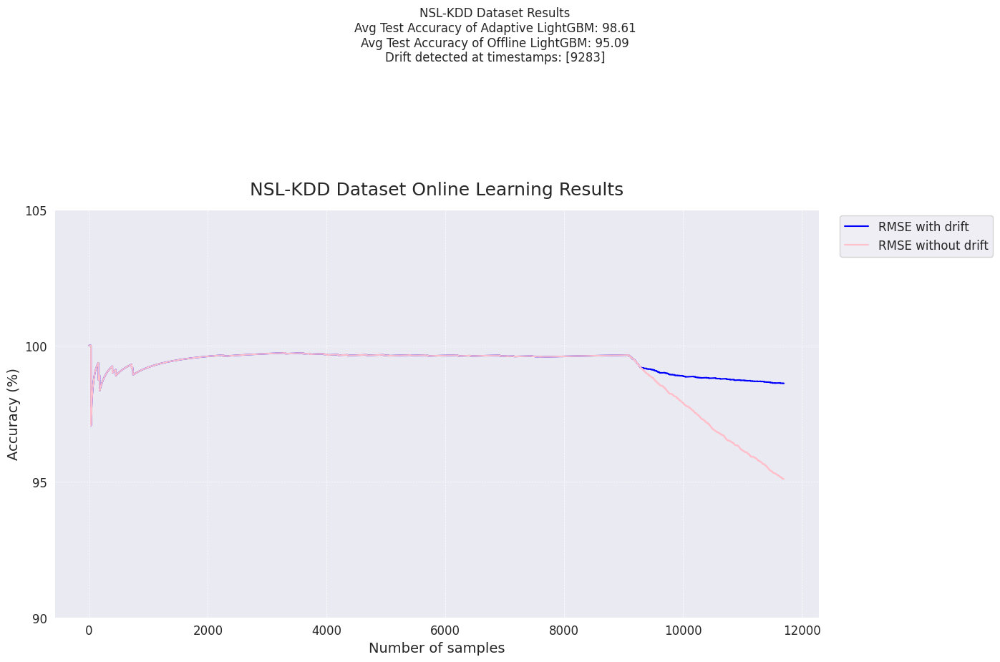

<Figure size 640x480 with 0 Axes>

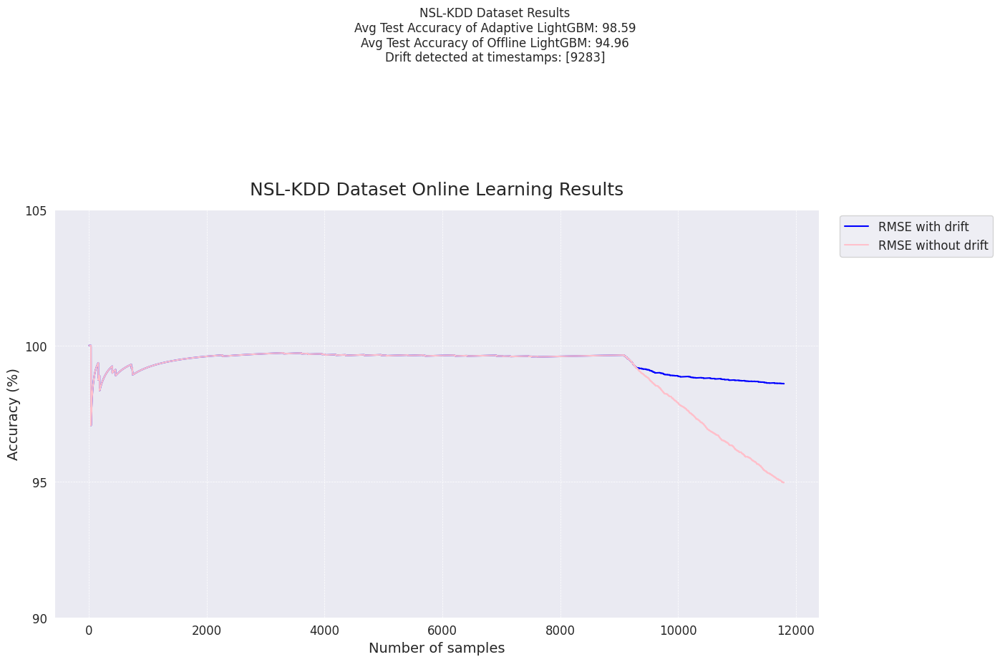

<Figure size 640x480 with 0 Axes>

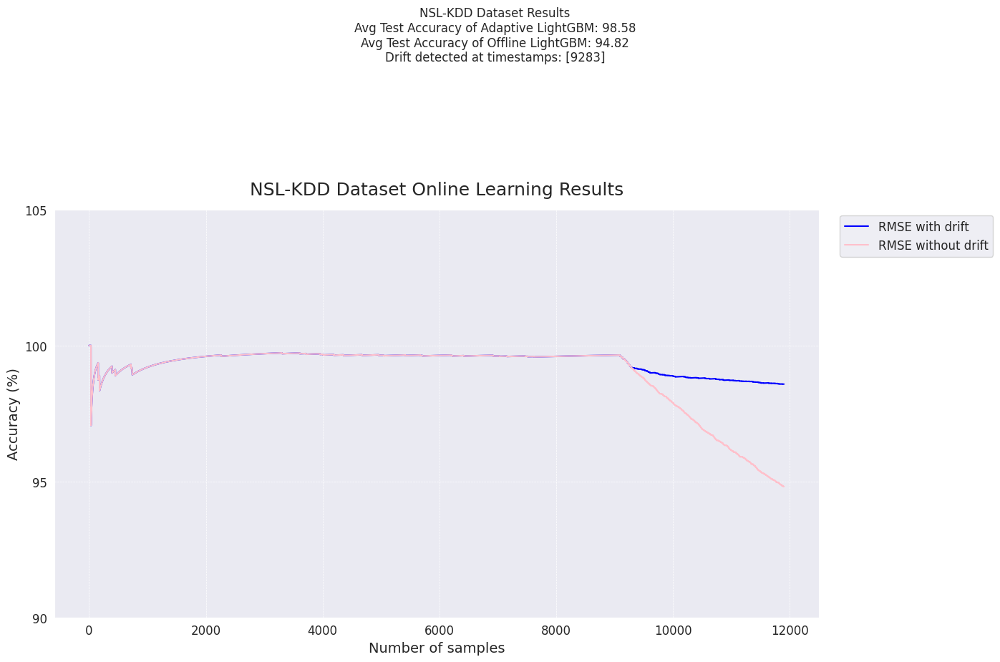

<Figure size 640x480 with 0 Axes>

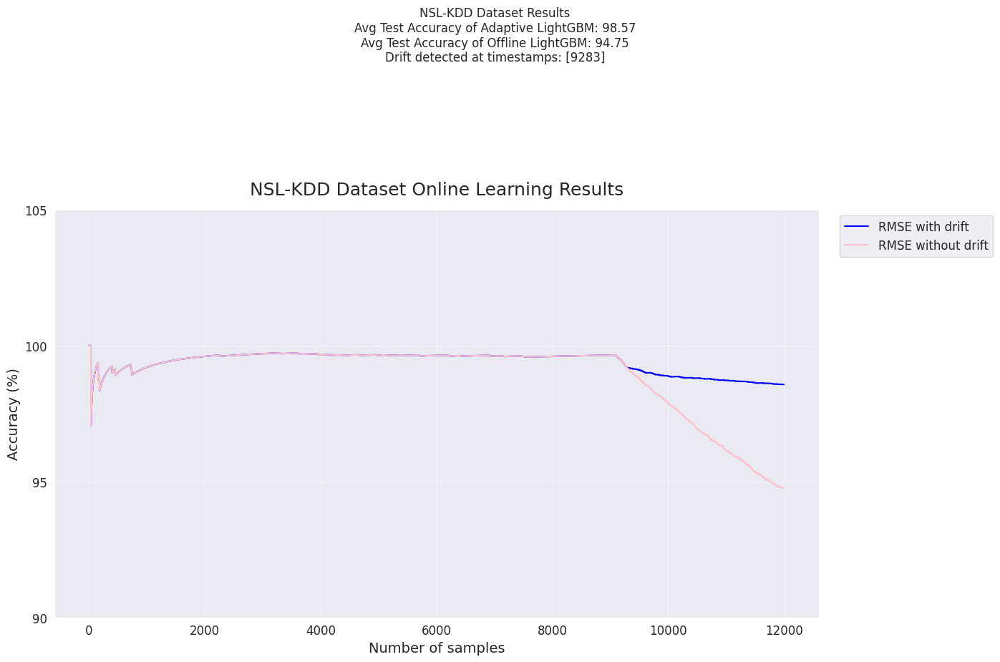

<Figure size 640x480 with 0 Axes>

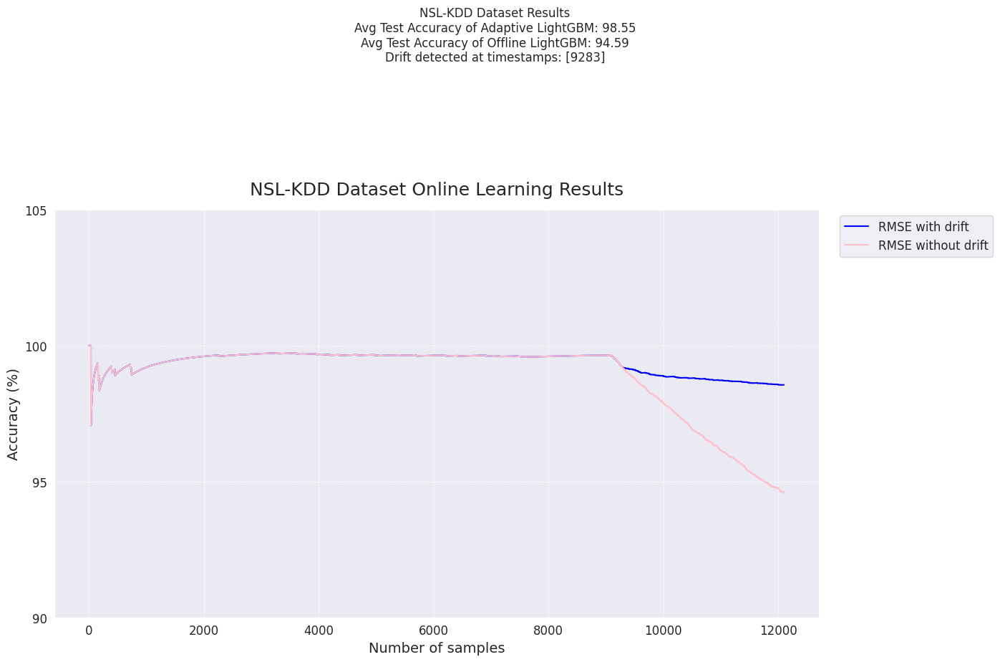

<Figure size 640x480 with 0 Axes>

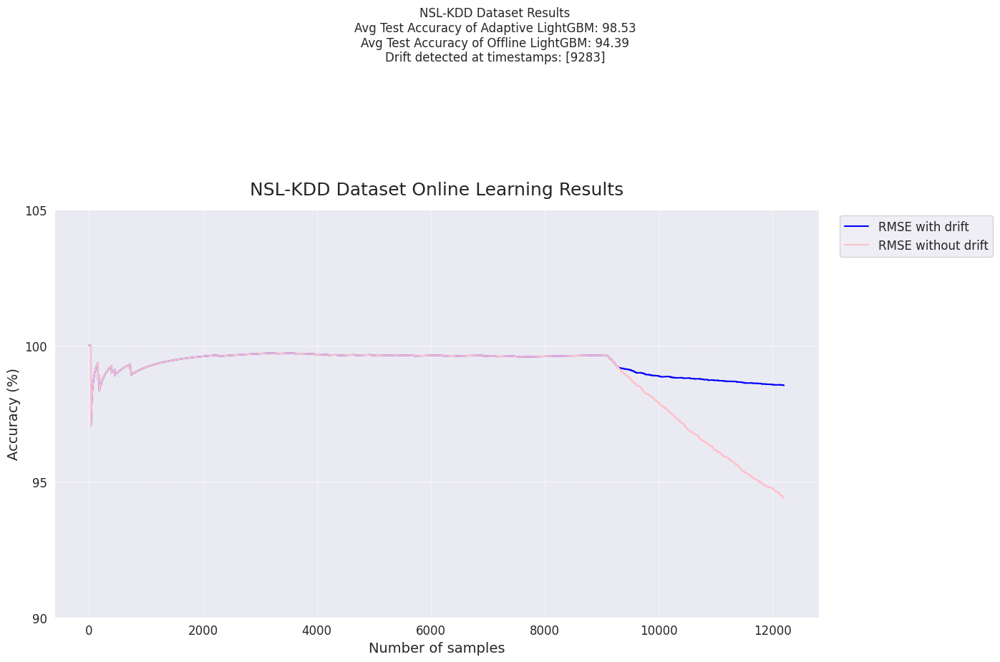

<Figure size 640x480 with 0 Axes>

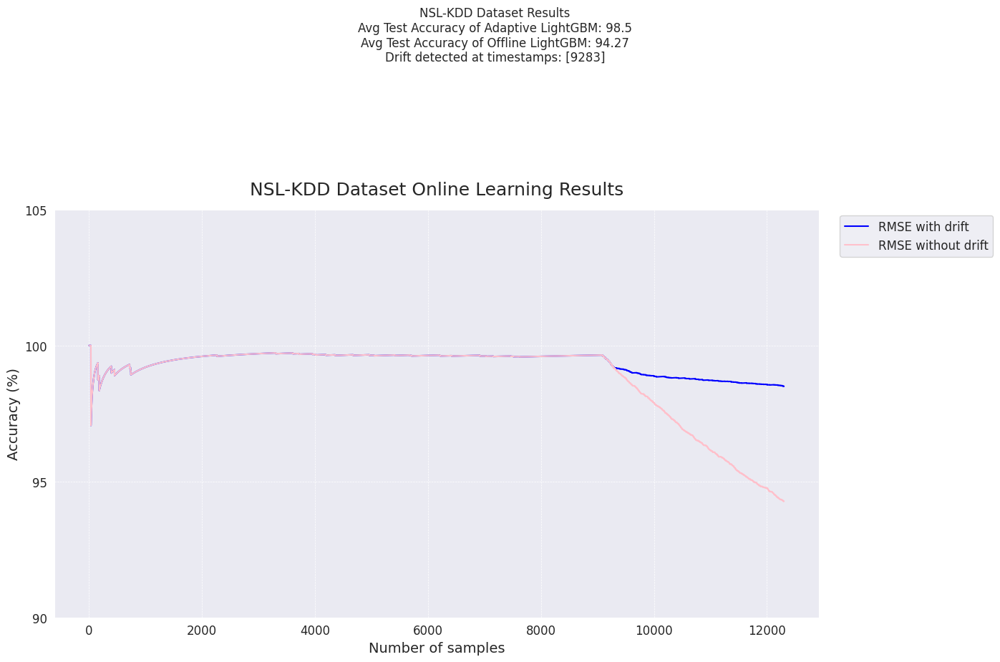

<Figure size 640x480 with 0 Axes>

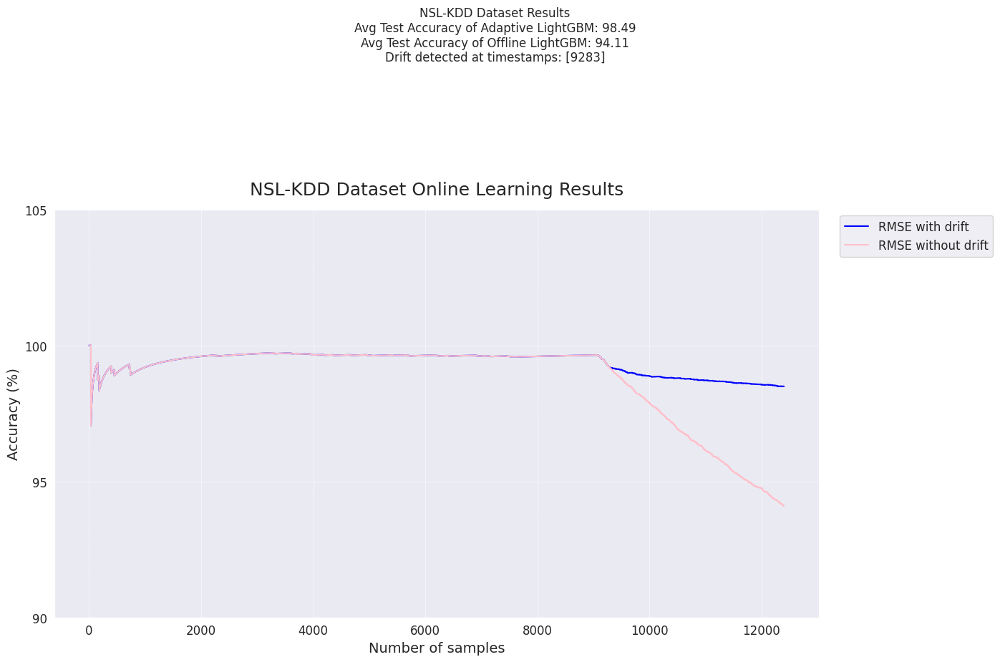

<Figure size 640x480 with 0 Axes>

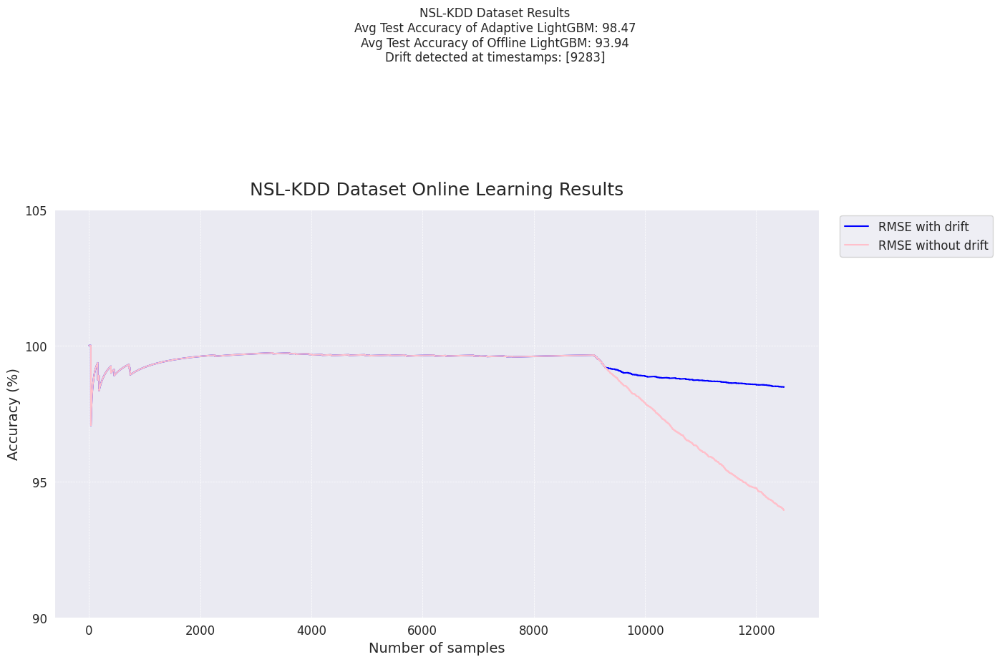

<Figure size 640x480 with 0 Axes>

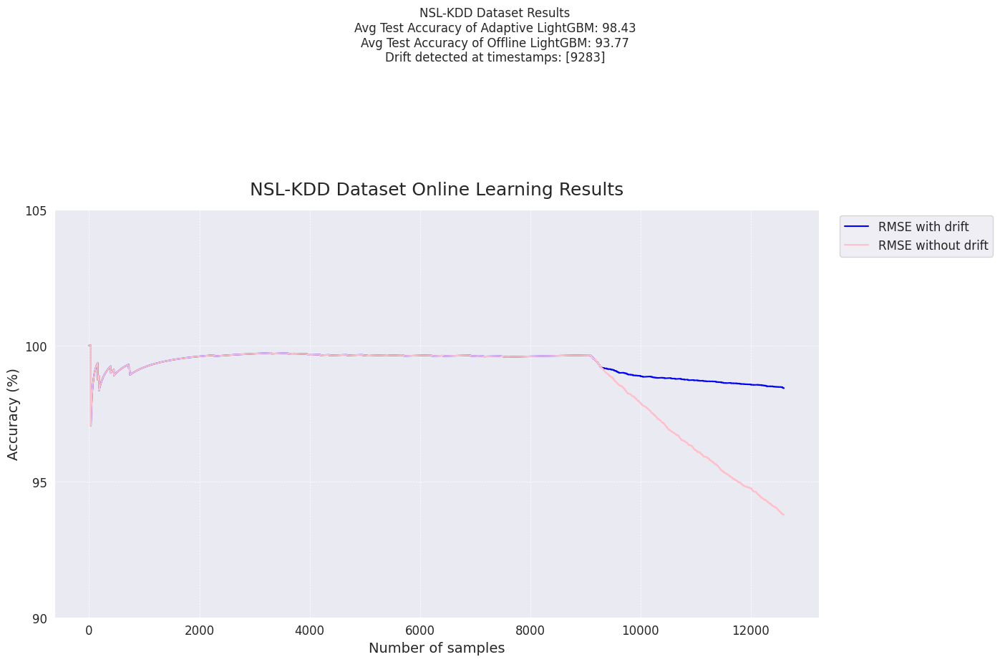

<Figure size 640x480 with 0 Axes>

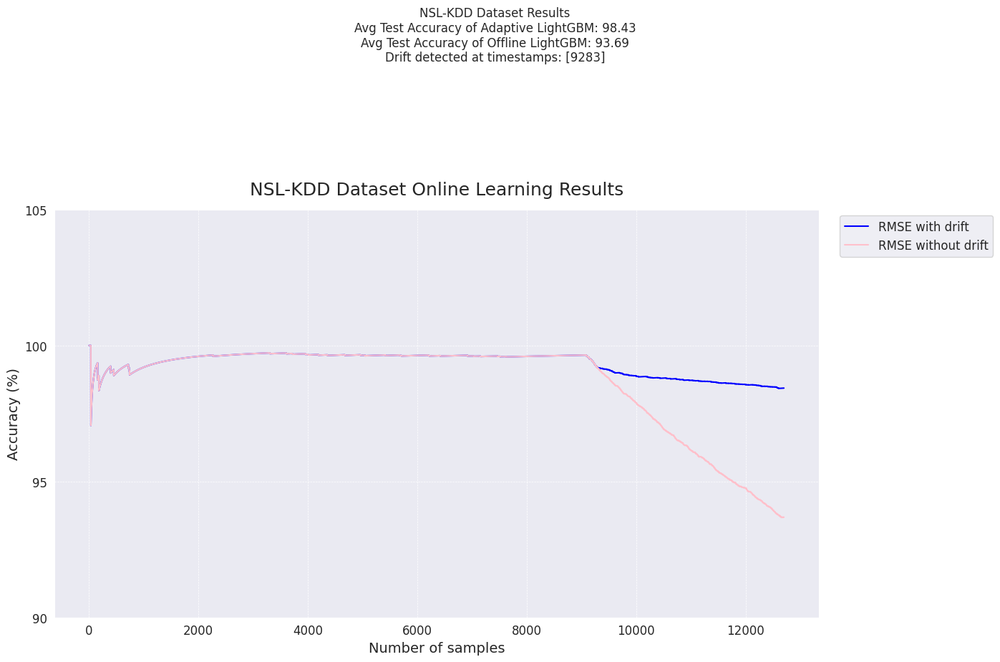

<Figure size 640x480 with 0 Axes>

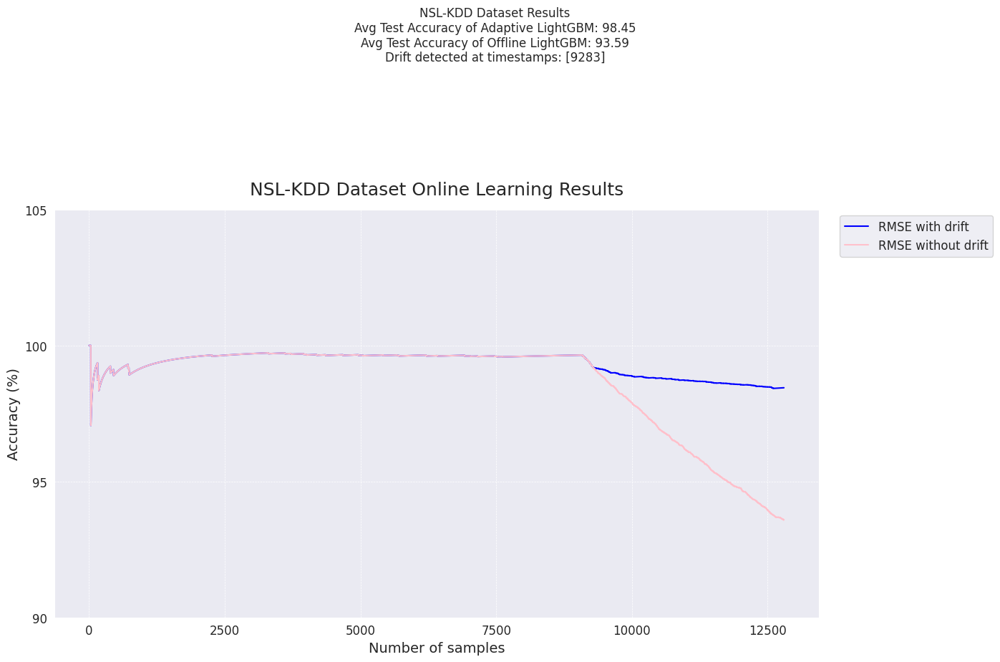

<Figure size 640x480 with 0 Axes>

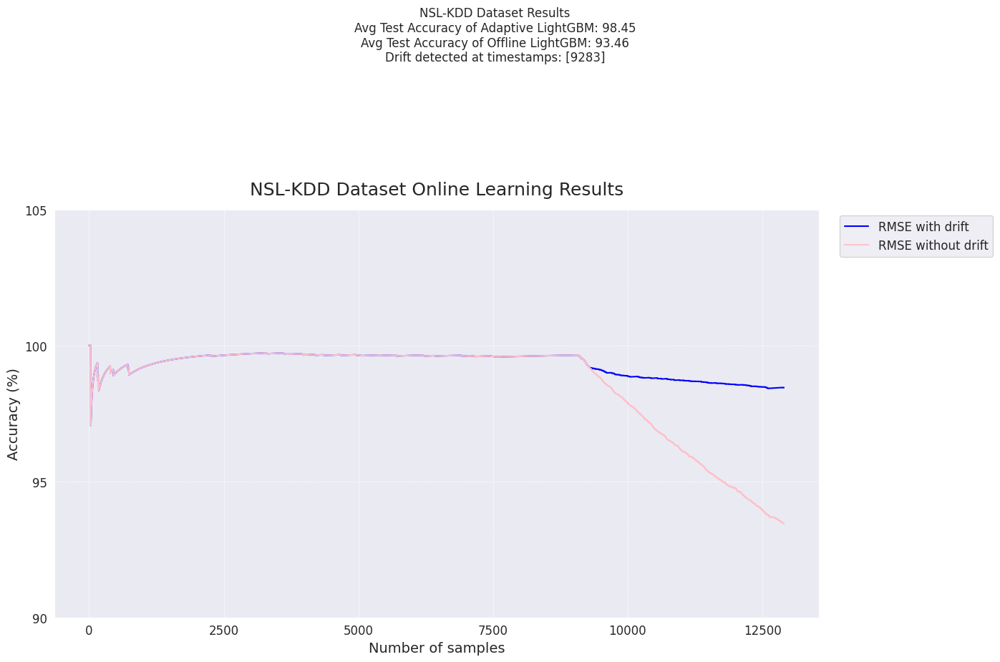

<Figure size 640x480 with 0 Axes>

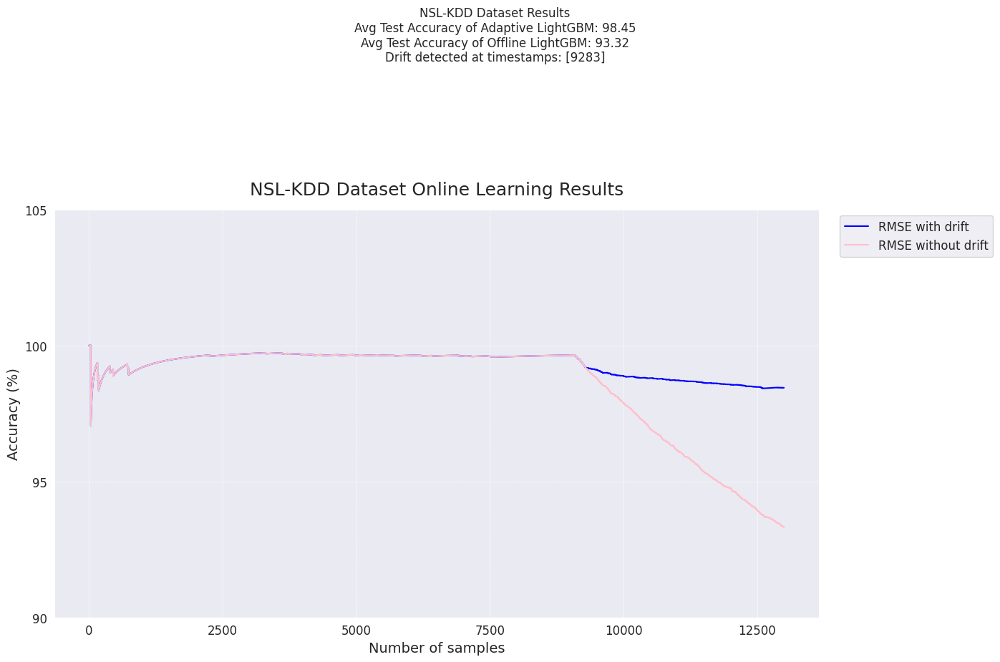

<Figure size 640x480 with 0 Axes>

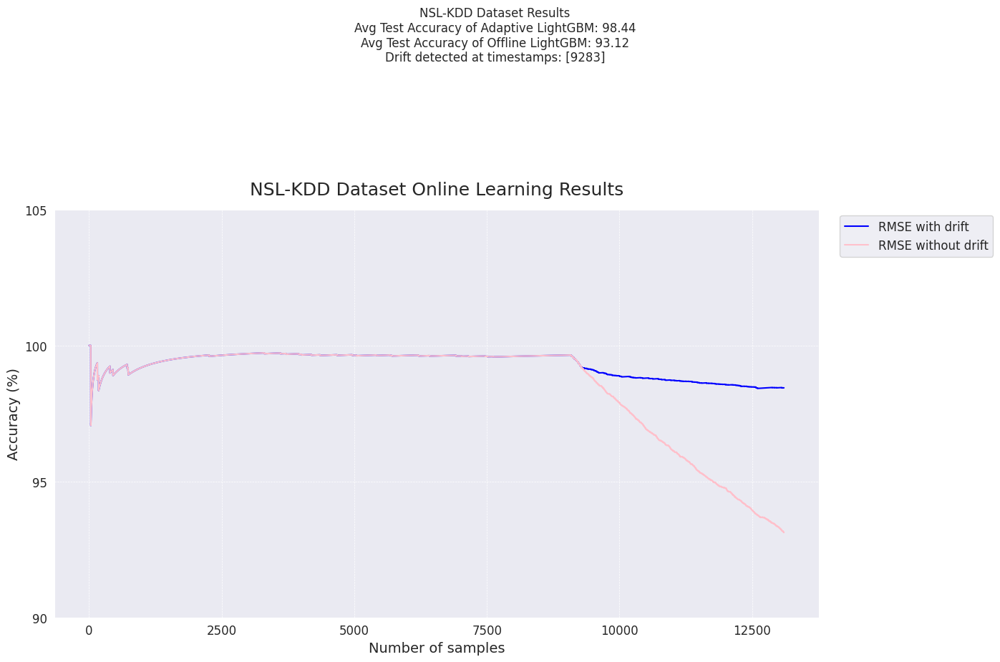

<Figure size 640x480 with 0 Axes>

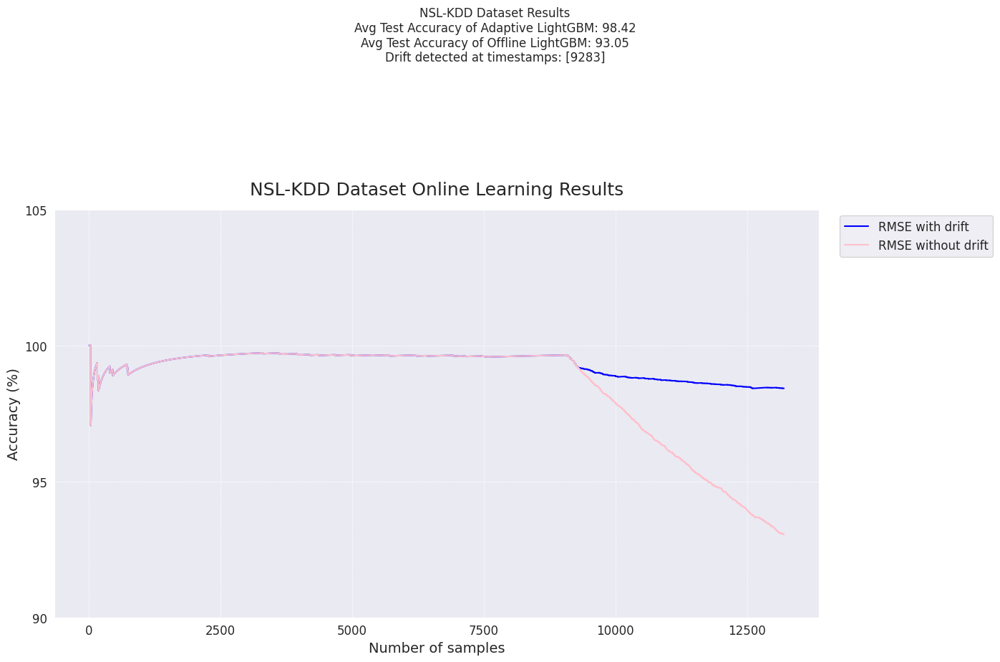

<Figure size 640x480 with 0 Axes>

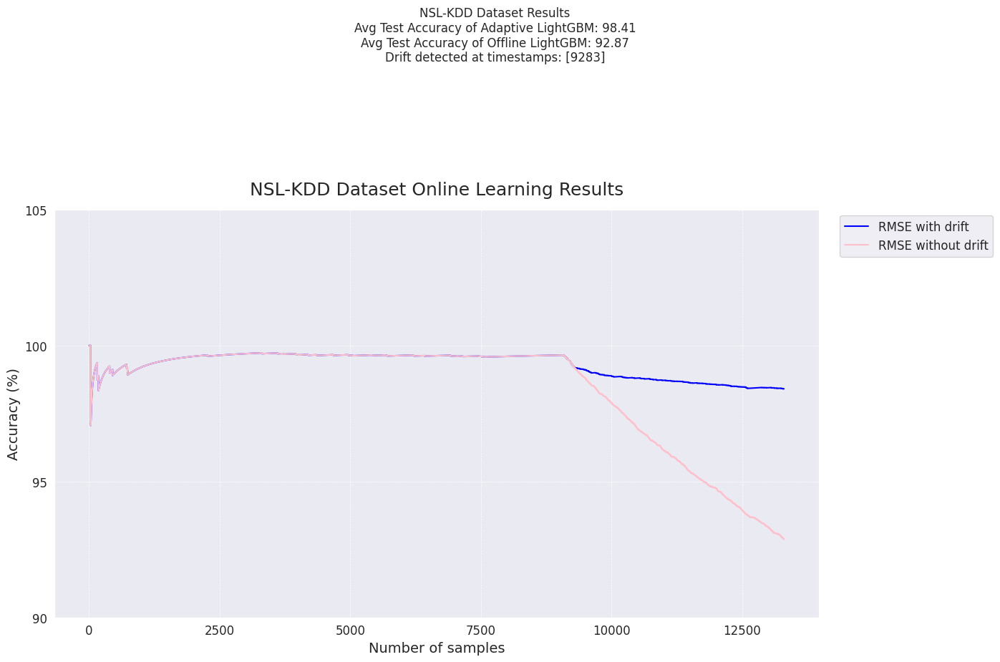

<Figure size 640x480 with 0 Axes>

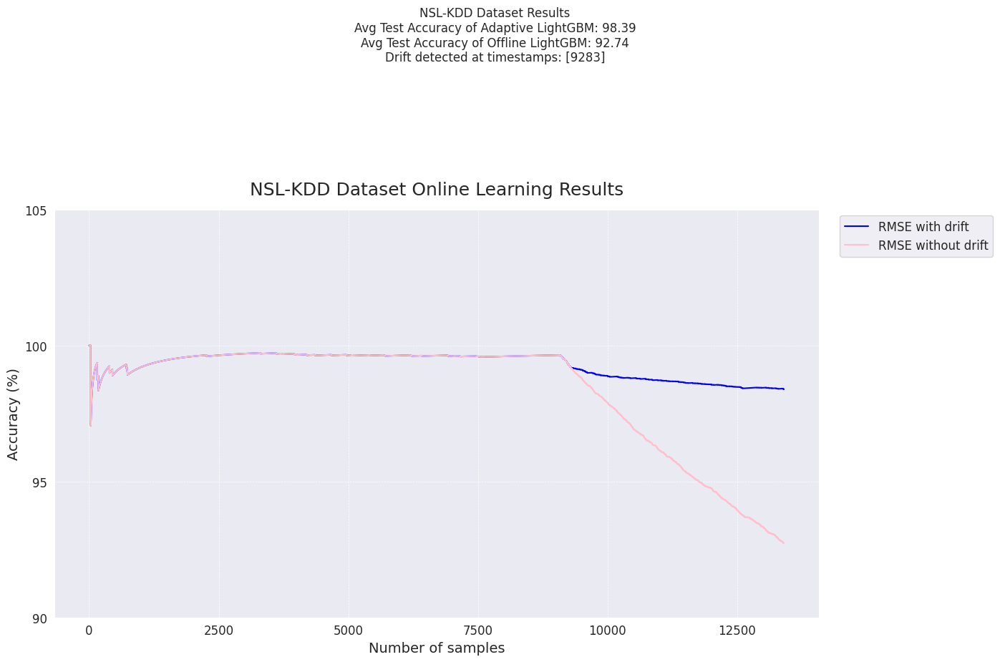

[LightGBM] [Info] Number of positive: 2481, number of negative: 1840
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001416 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2285
[LightGBM] [Info] Number of data points in the train set: 4321, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.574173 -> initscore=0.298896
[LightGBM] [Info] Start training from score 0.298896


<Figure size 640x480 with 0 Axes>

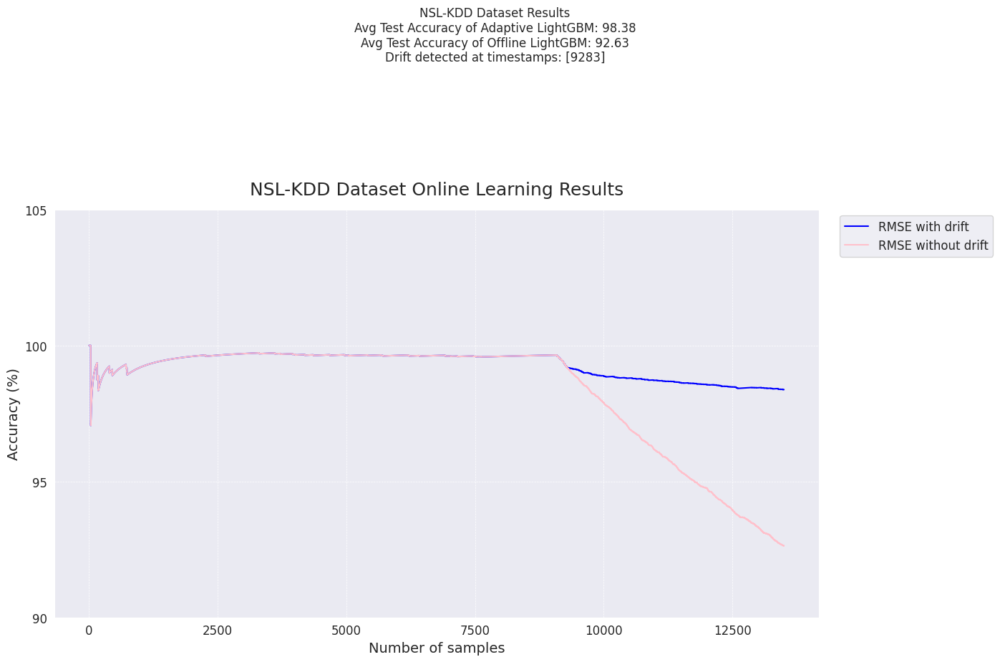

<Figure size 640x480 with 0 Axes>

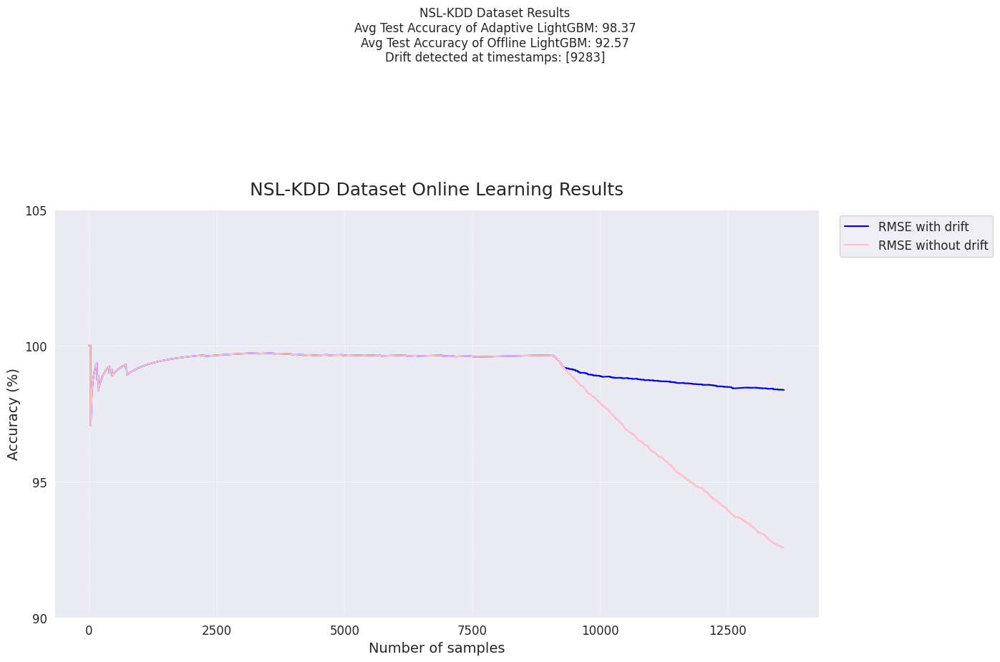

<Figure size 640x480 with 0 Axes>

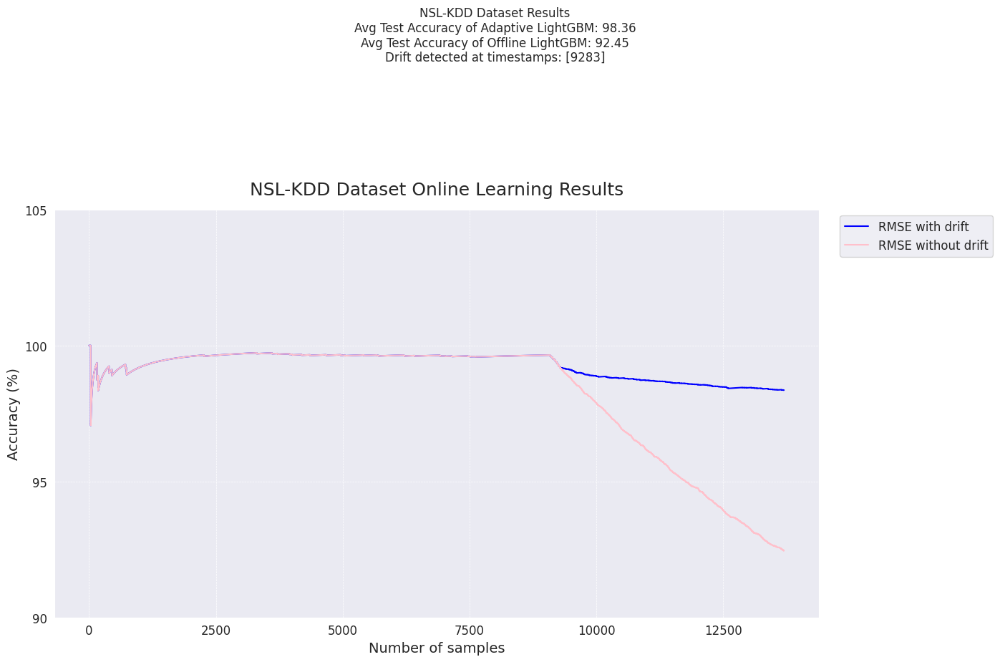

<Figure size 640x480 with 0 Axes>

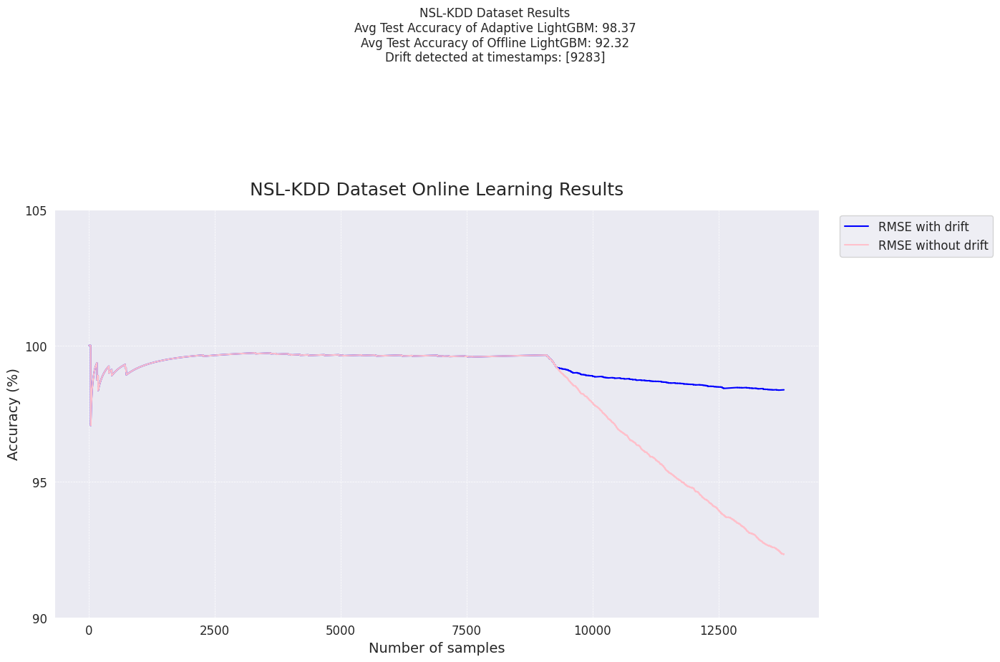

<Figure size 640x480 with 0 Axes>

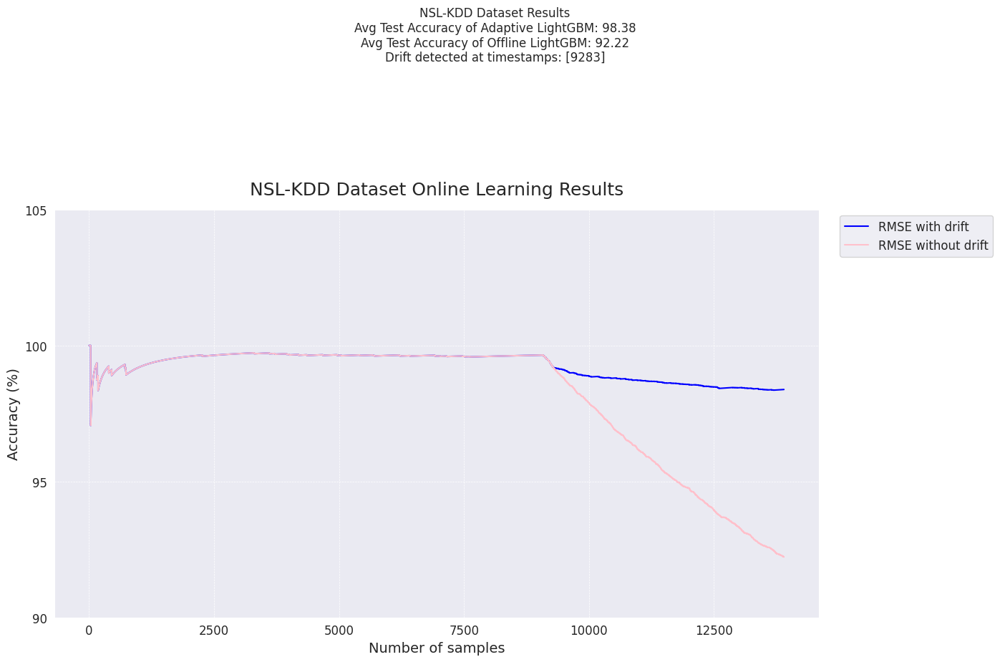

<Figure size 640x480 with 0 Axes>

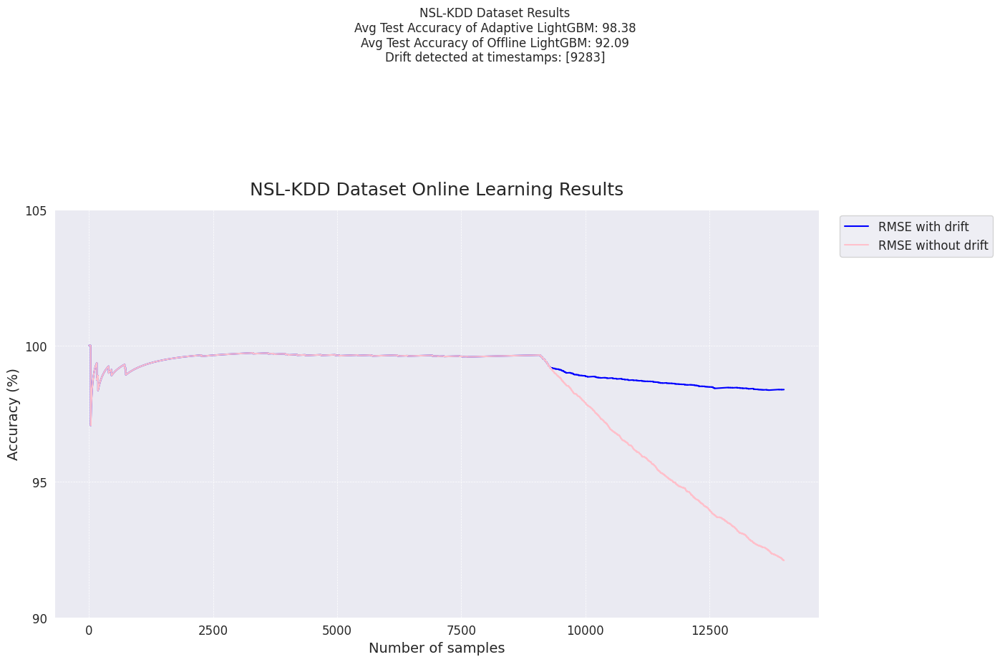

<Figure size 640x480 with 0 Axes>

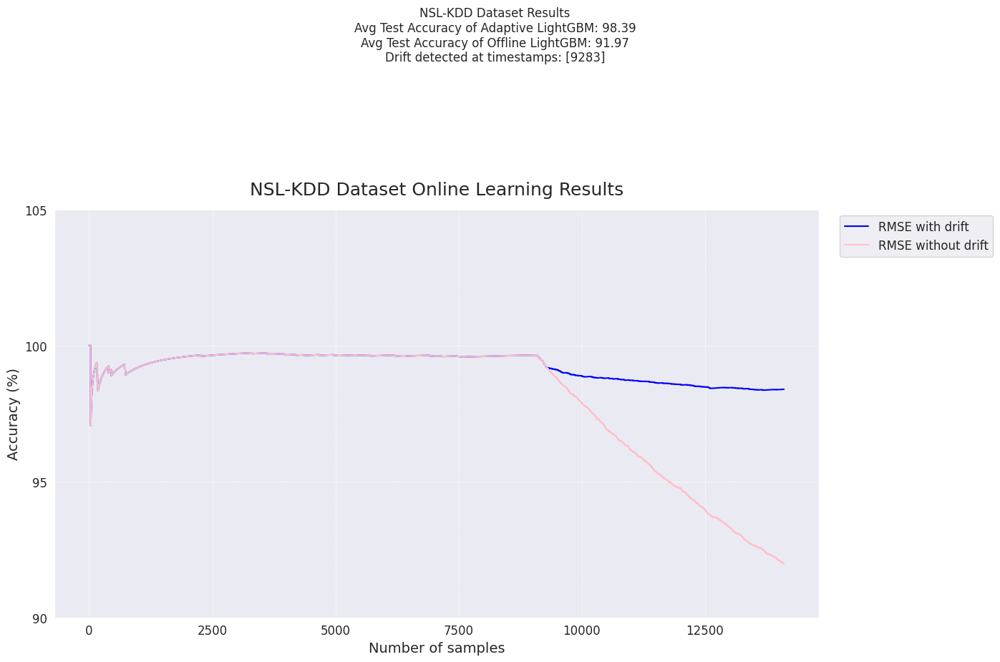

<Figure size 640x480 with 0 Axes>

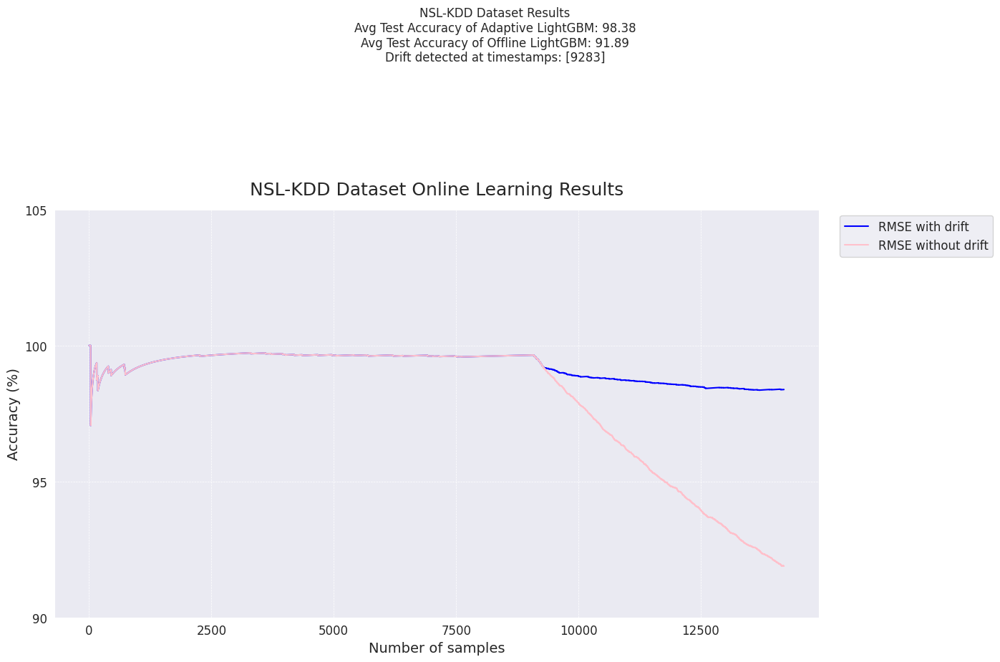

<Figure size 640x480 with 0 Axes>

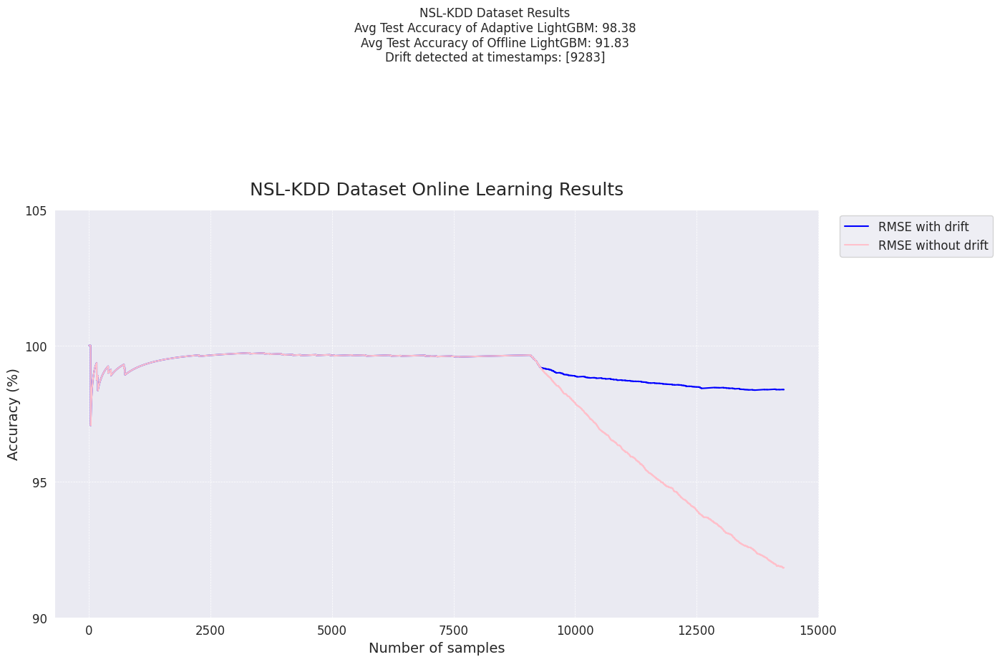

<Figure size 640x480 with 0 Axes>

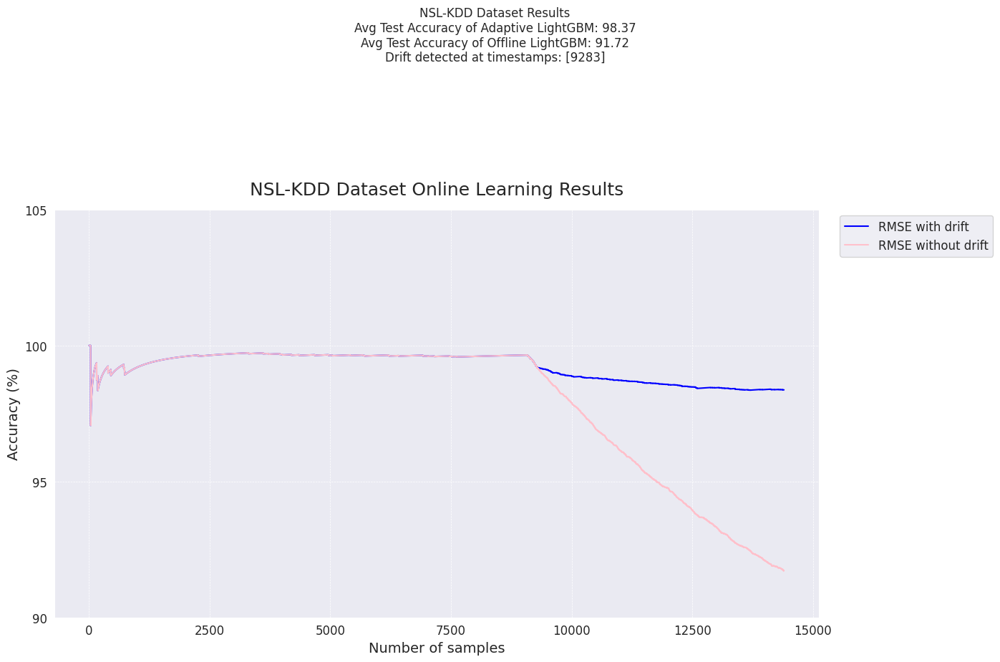

<Figure size 640x480 with 0 Axes>

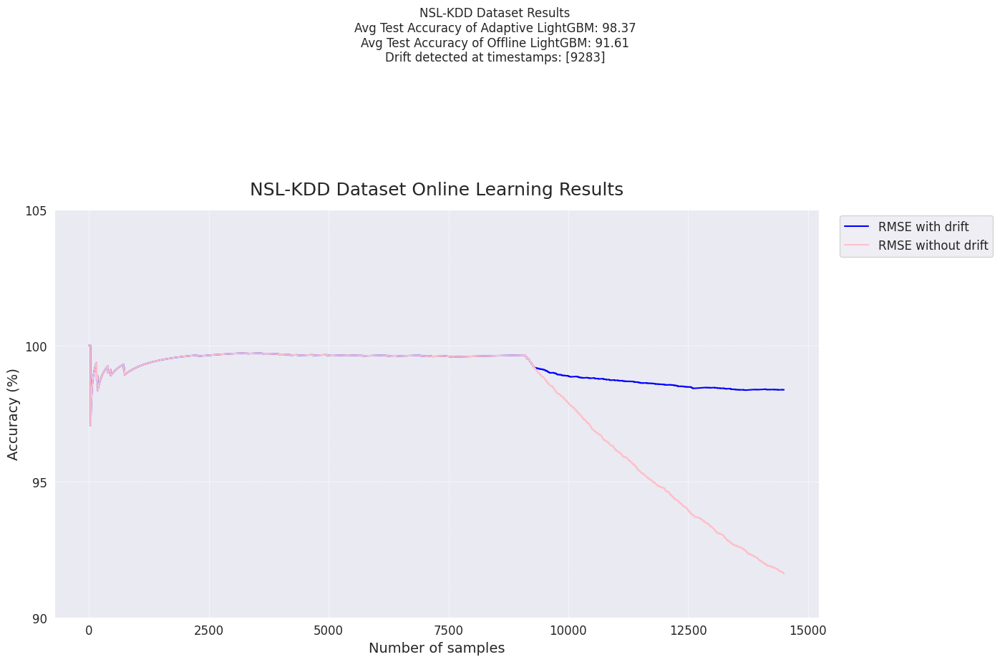

<Figure size 640x480 with 0 Axes>

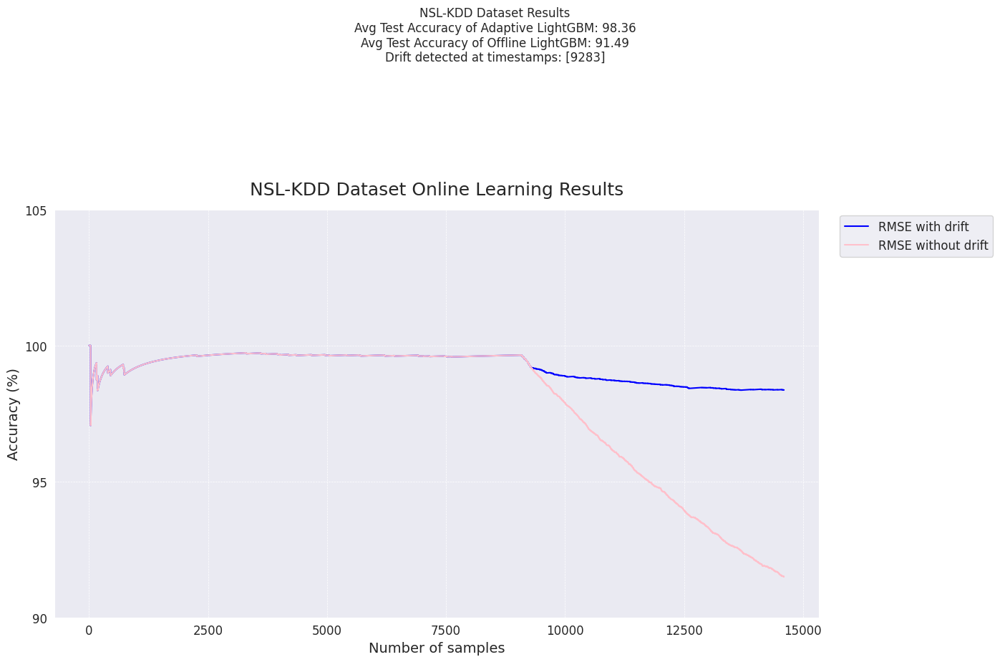

<Figure size 640x480 with 0 Axes>

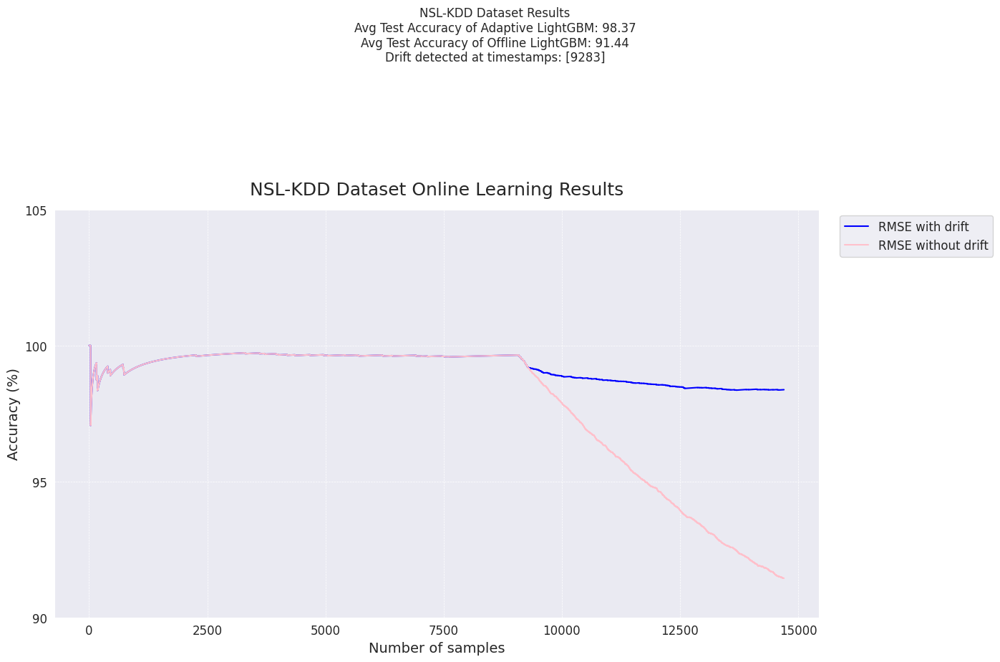

<Figure size 640x480 with 0 Axes>

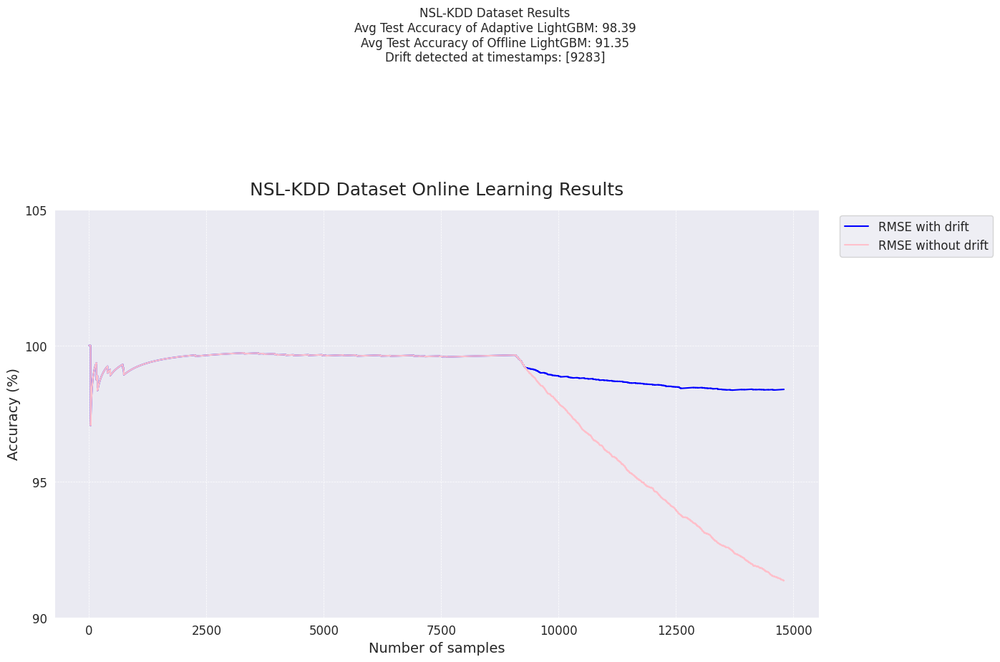

<Figure size 640x480 with 0 Axes>

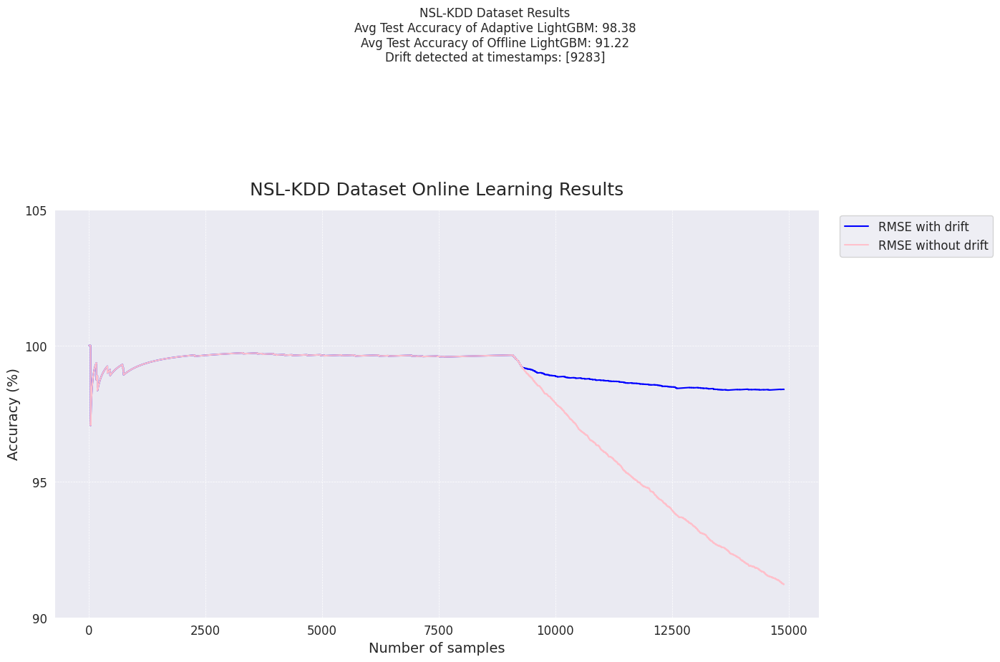

<Figure size 640x480 with 0 Axes>

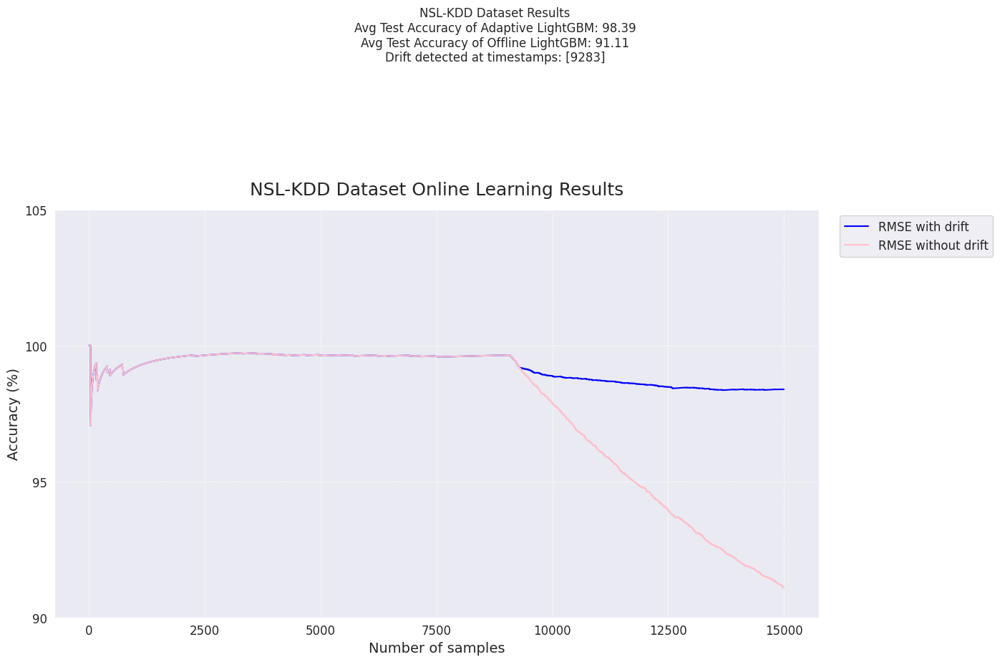

<Figure size 640x480 with 0 Axes>

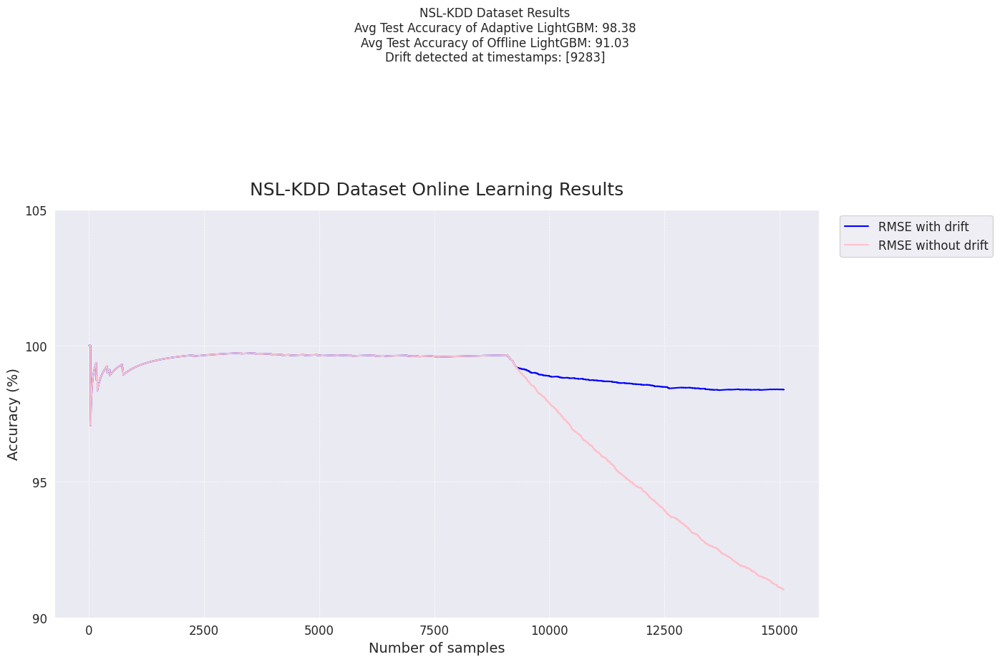

<Figure size 640x480 with 0 Axes>

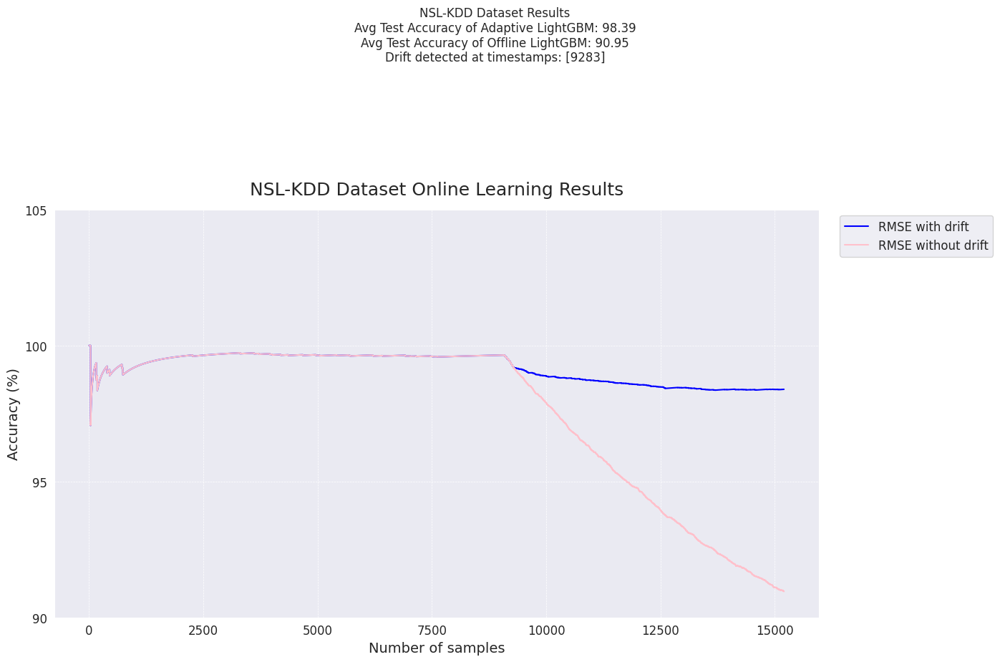

<Figure size 640x480 with 0 Axes>

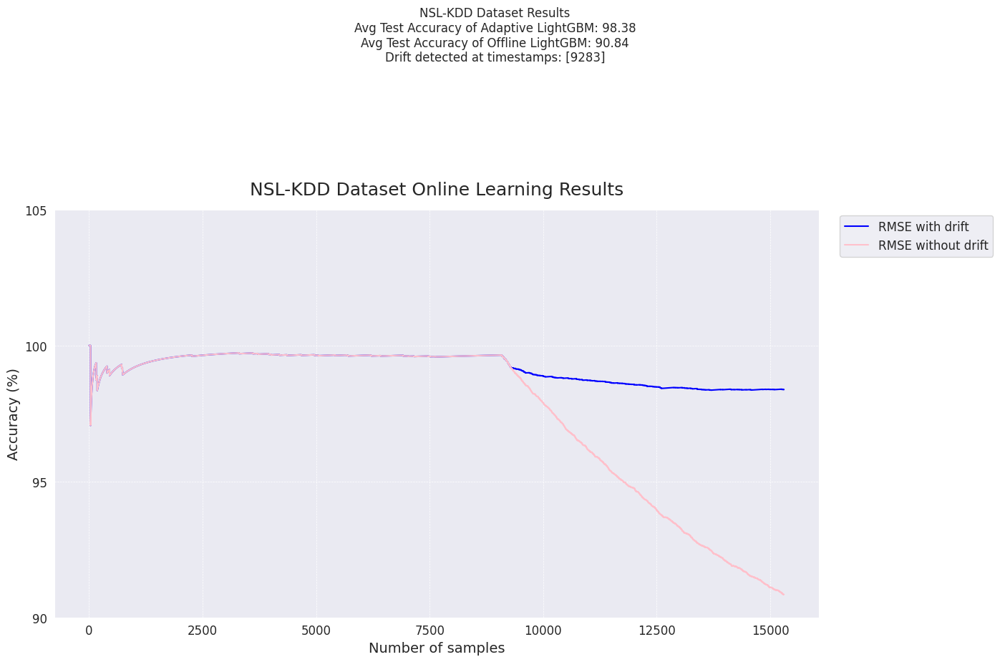

<Figure size 640x480 with 0 Axes>

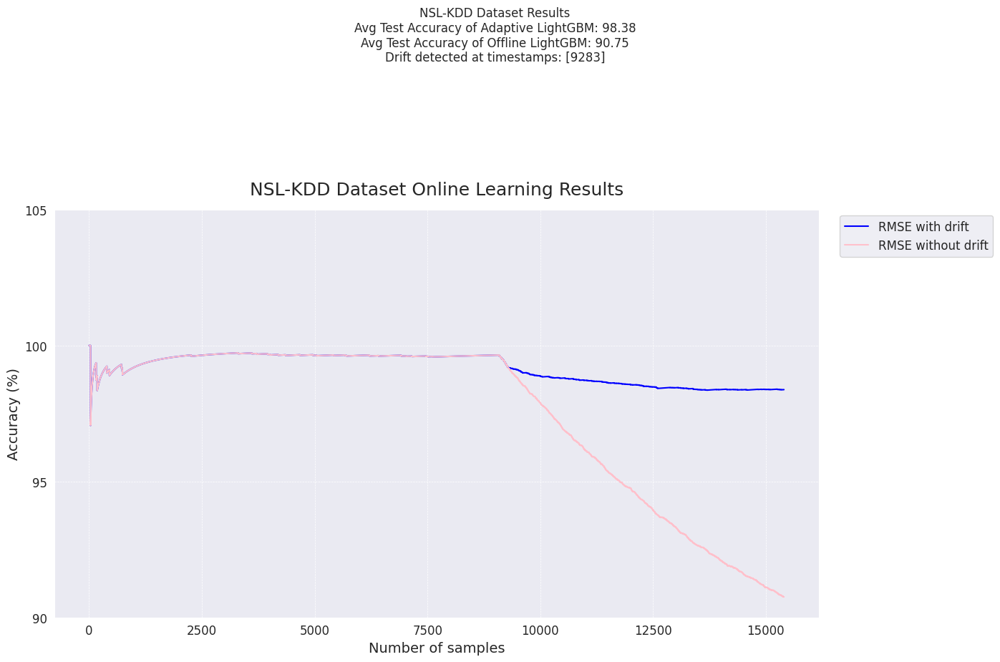

<Figure size 640x480 with 0 Axes>

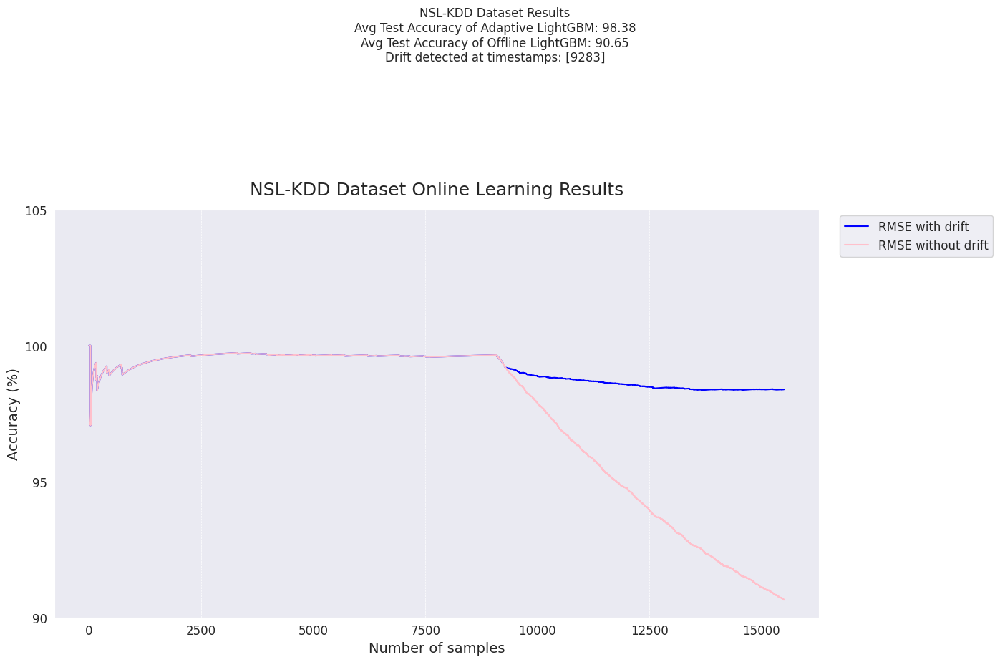

<Figure size 640x480 with 0 Axes>

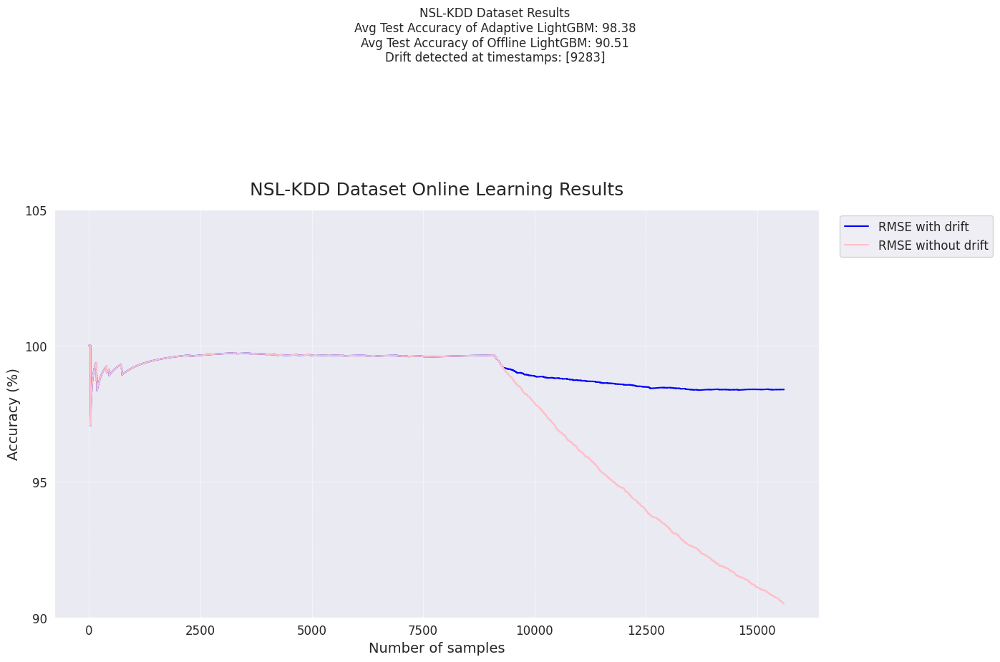

<Figure size 640x480 with 0 Axes>

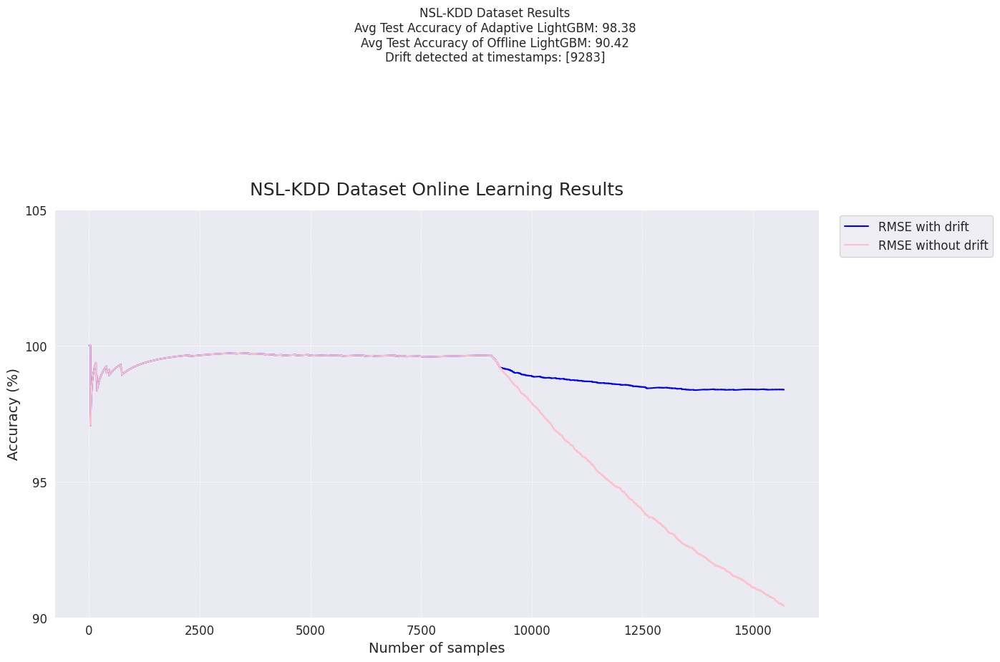

<Figure size 640x480 with 0 Axes>

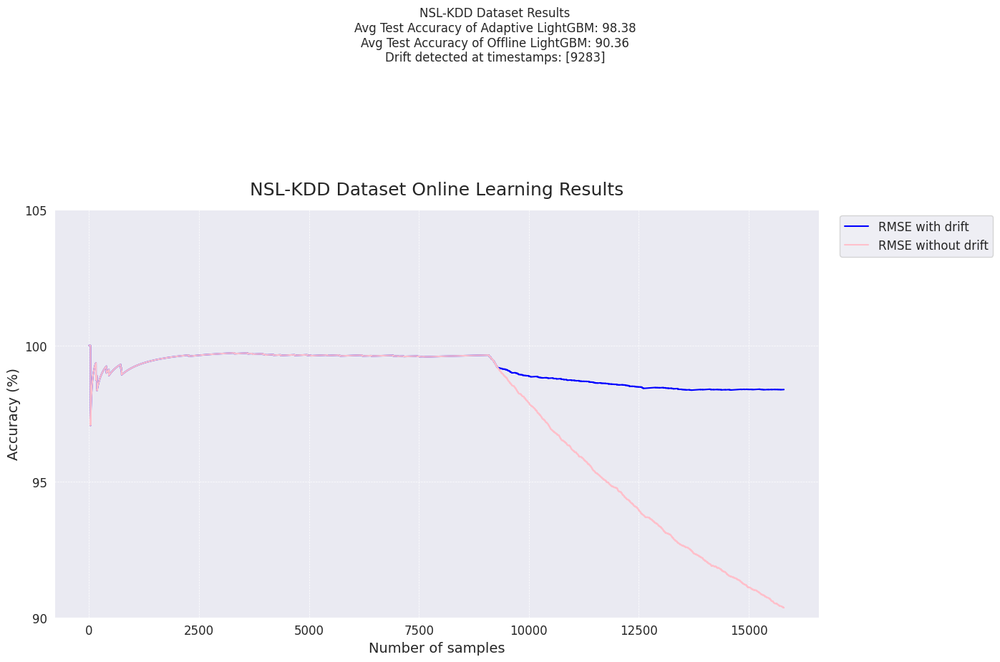

<Figure size 640x480 with 0 Axes>

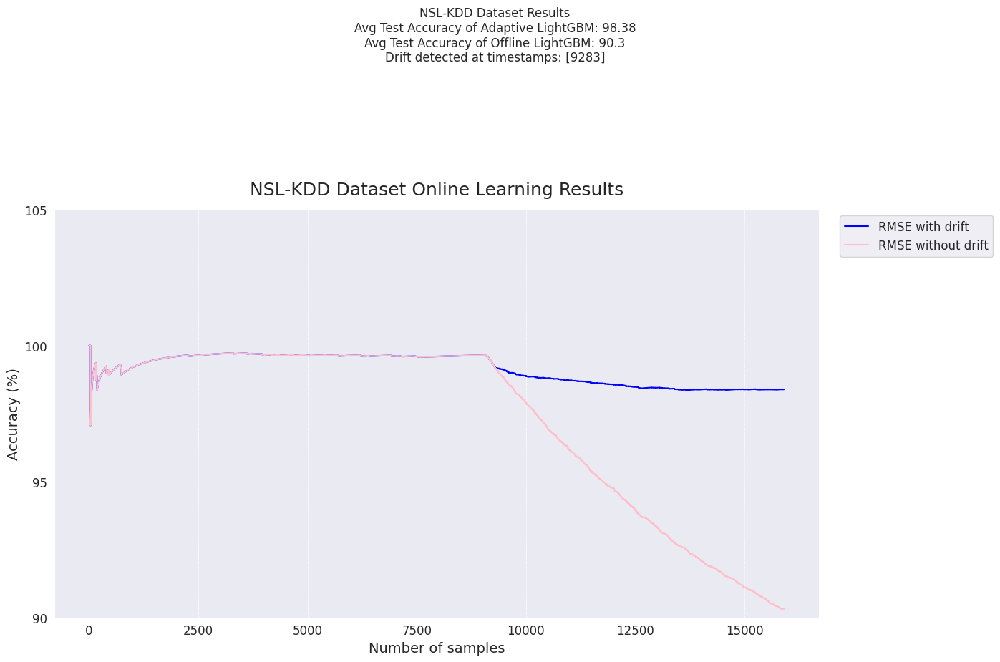

<Figure size 640x480 with 0 Axes>

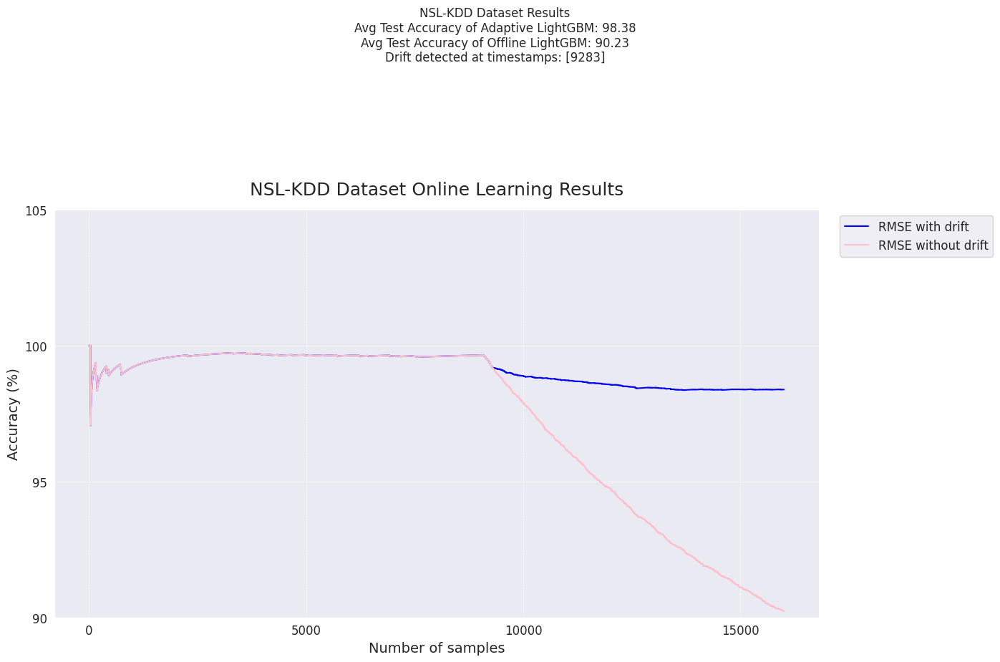

<Figure size 640x480 with 0 Axes>

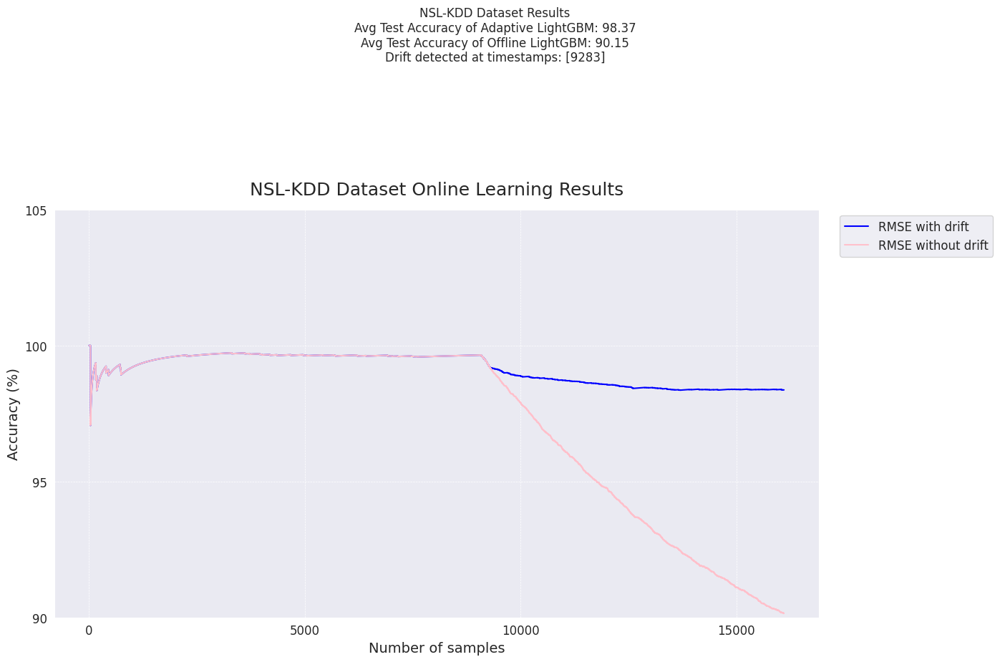

<Figure size 640x480 with 0 Axes>

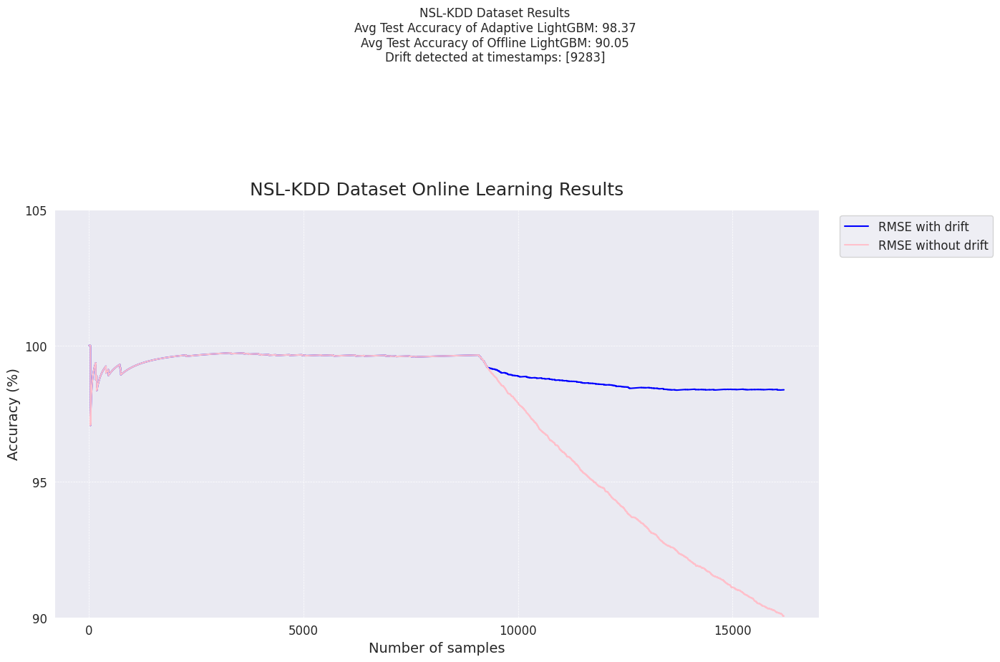

<Figure size 640x480 with 0 Axes>

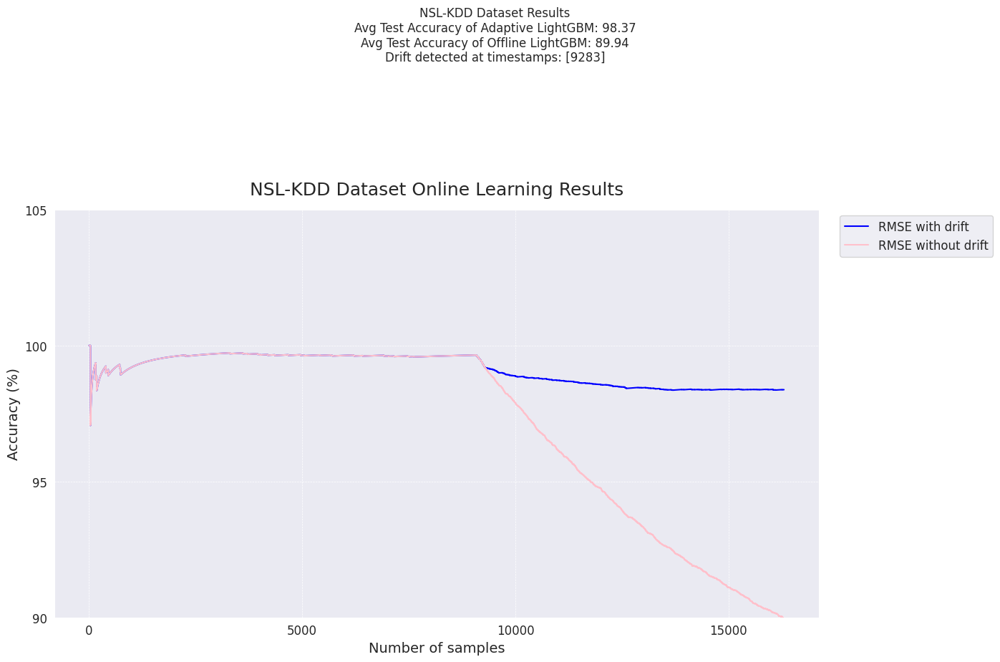

<Figure size 640x480 with 0 Axes>

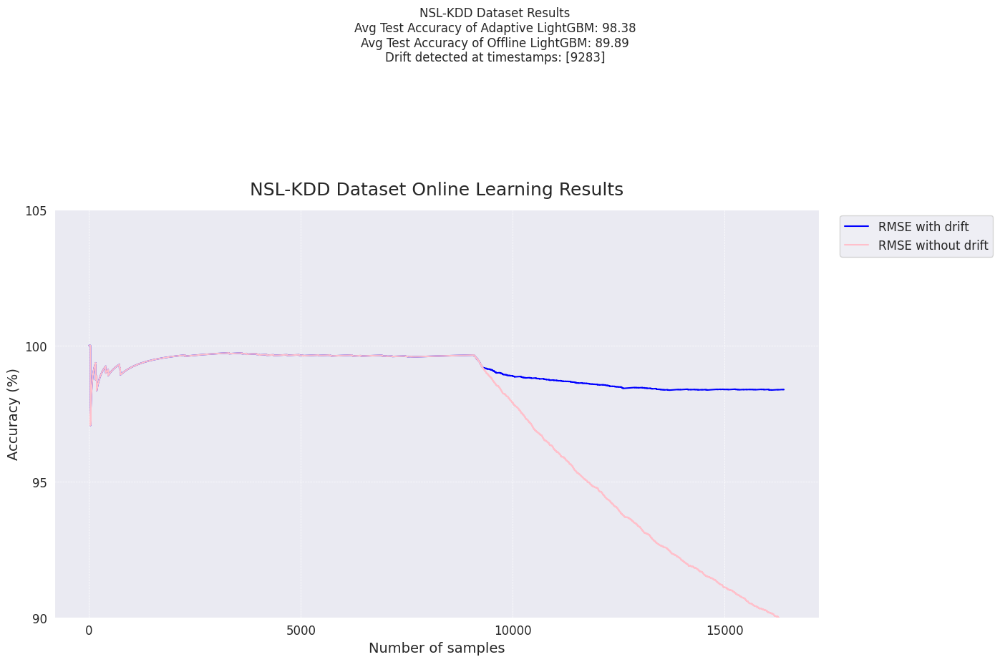

<Figure size 640x480 with 0 Axes>

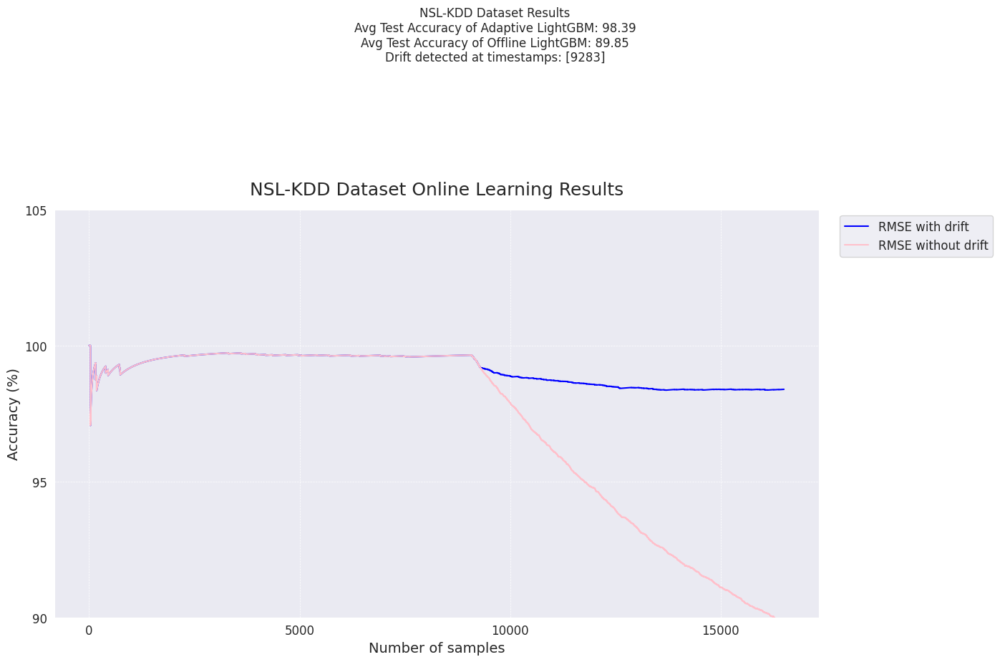

<Figure size 640x480 with 0 Axes>

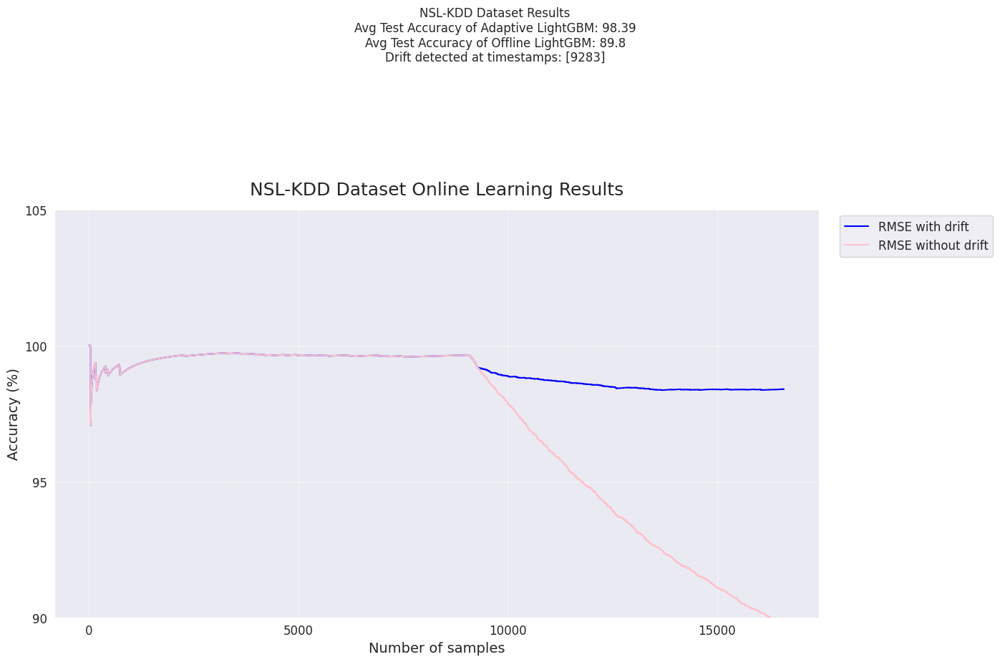

<Figure size 640x480 with 0 Axes>

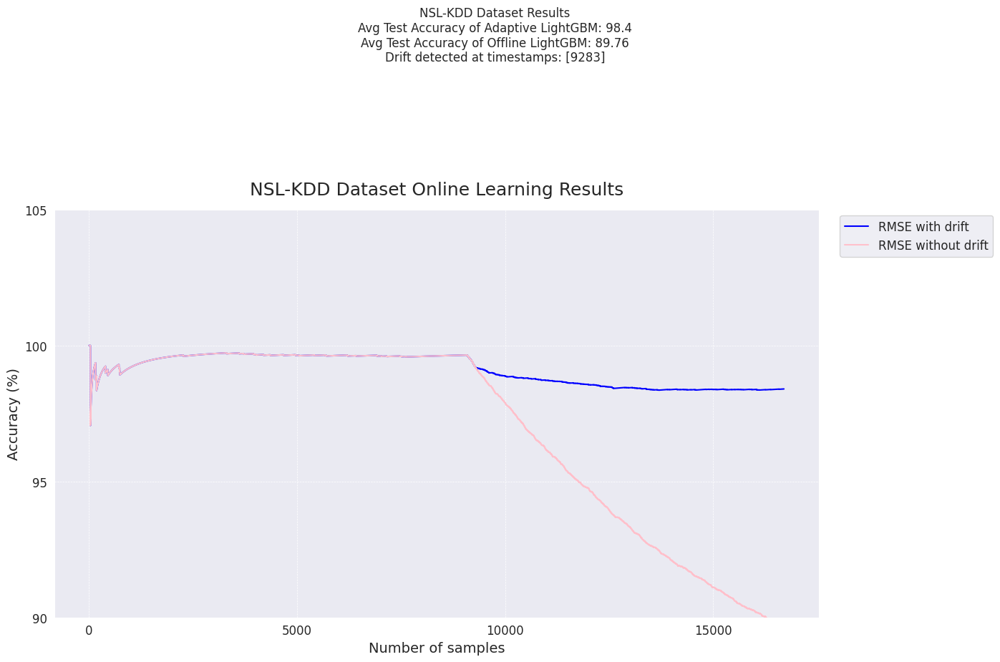

<Figure size 640x480 with 0 Axes>

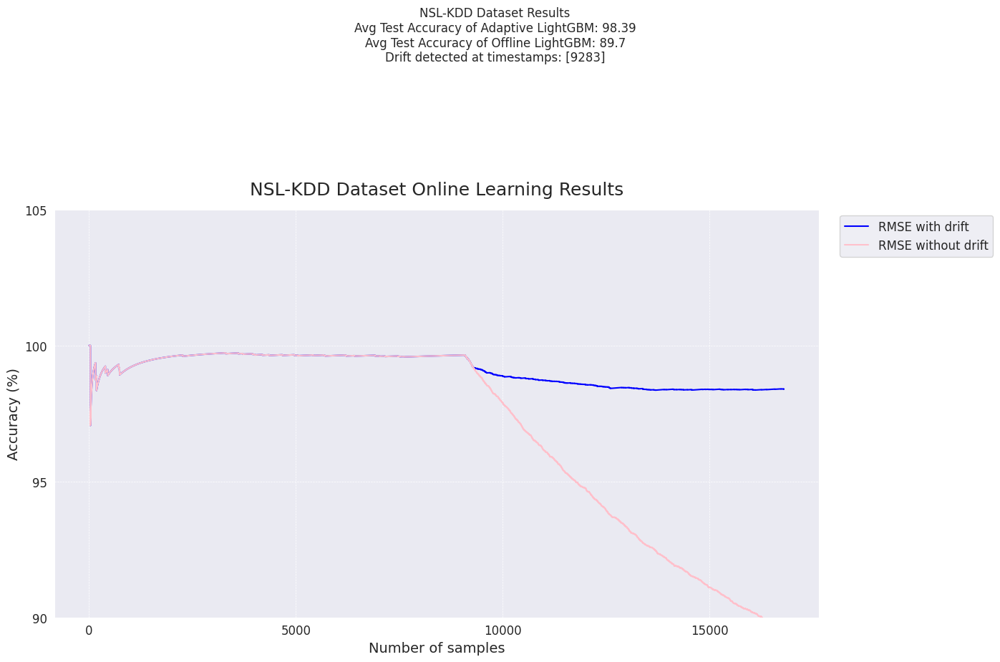

<Figure size 640x480 with 0 Axes>

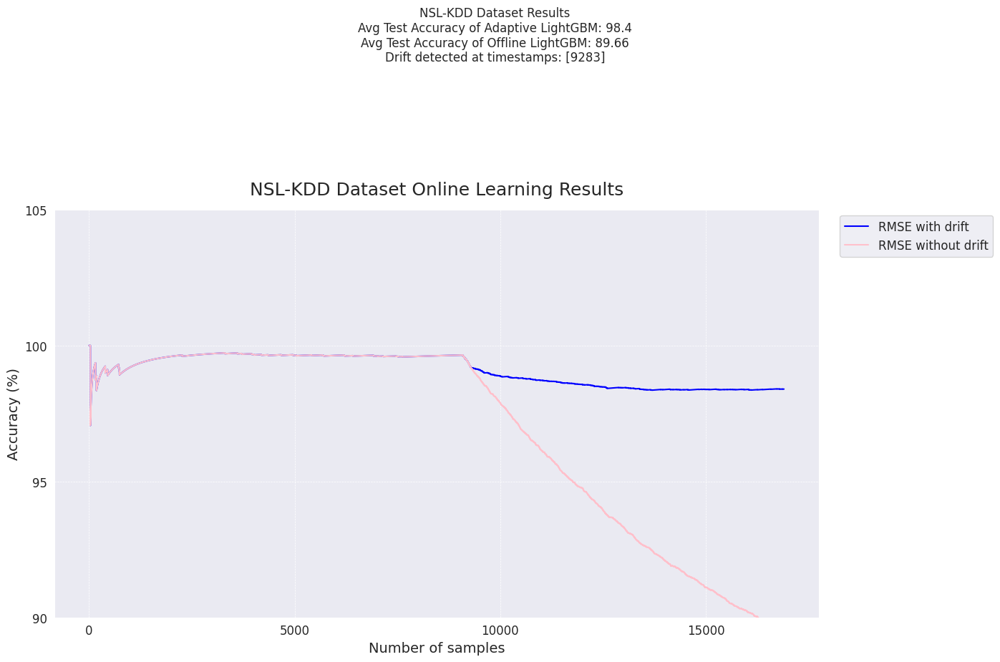

<Figure size 640x480 with 0 Axes>

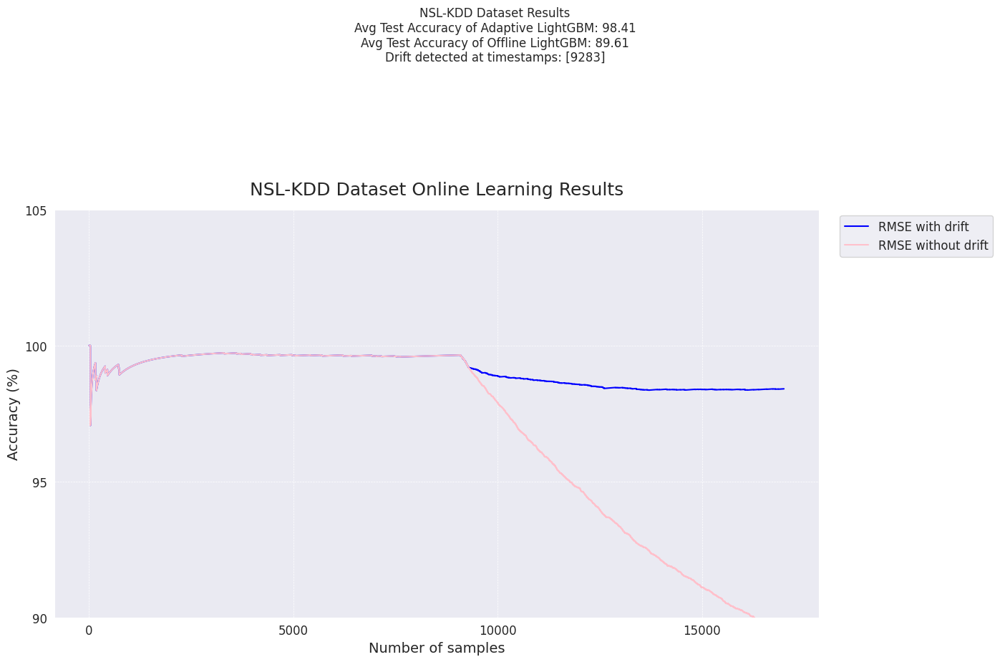

<Figure size 640x480 with 0 Axes>

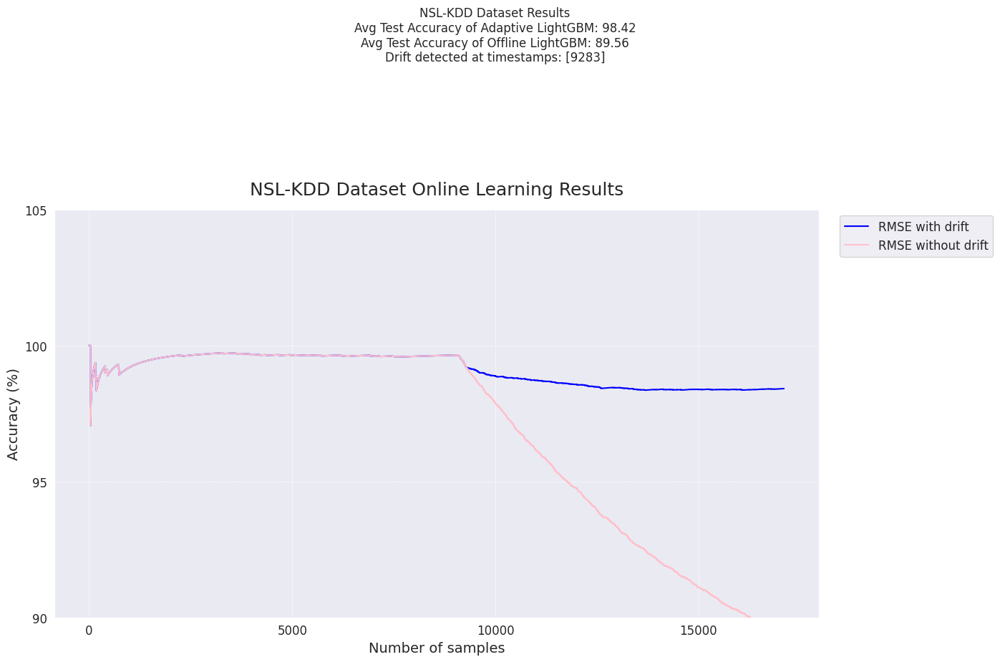

<Figure size 640x480 with 0 Axes>

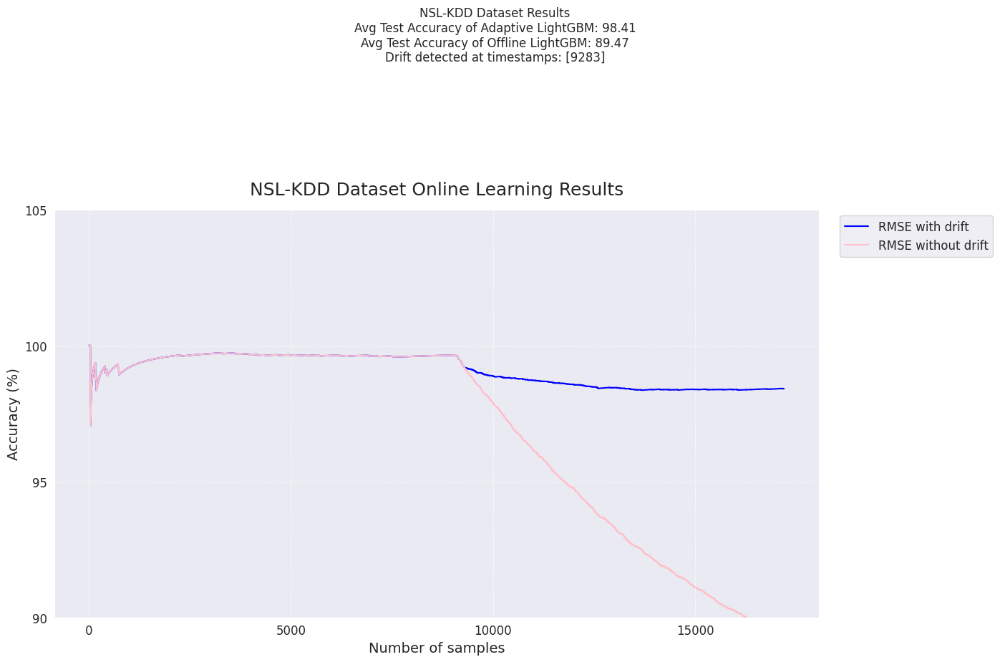

<Figure size 640x480 with 0 Axes>

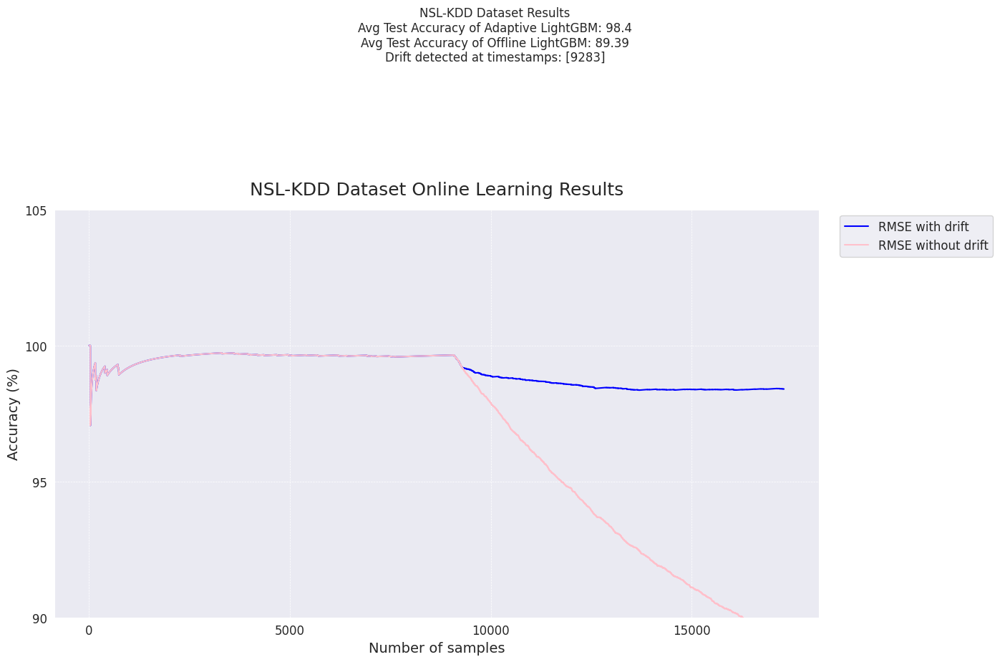

<Figure size 640x480 with 0 Axes>

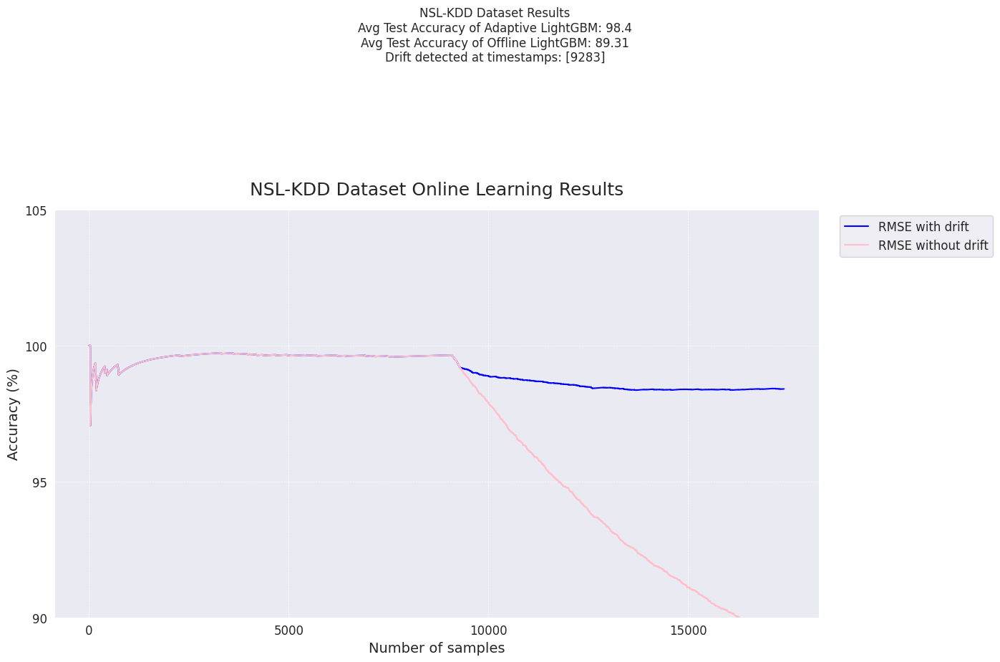

<Figure size 640x480 with 0 Axes>

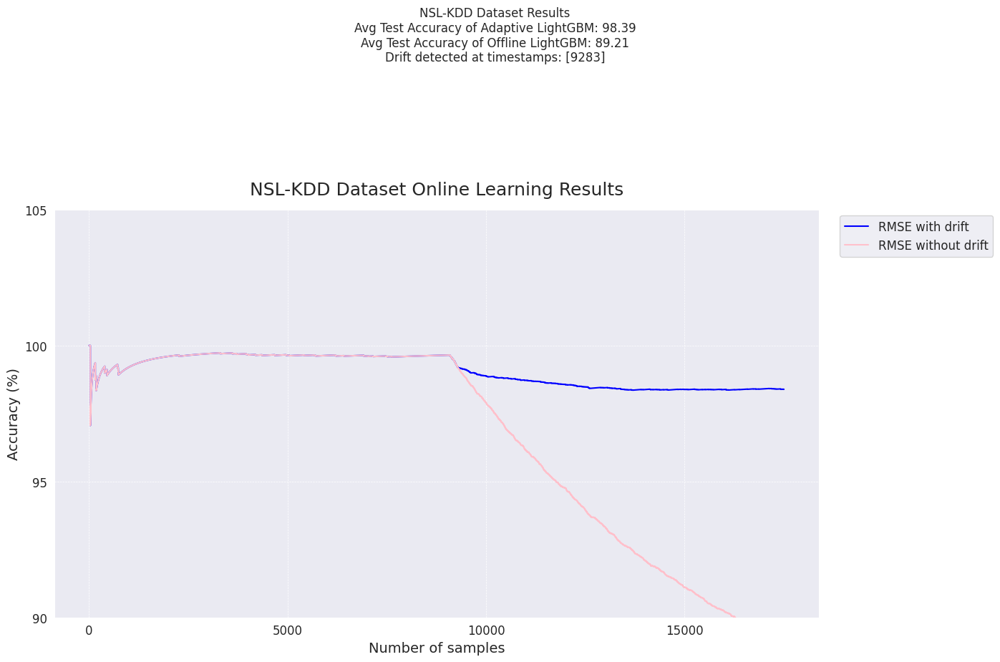

<Figure size 640x480 with 0 Axes>

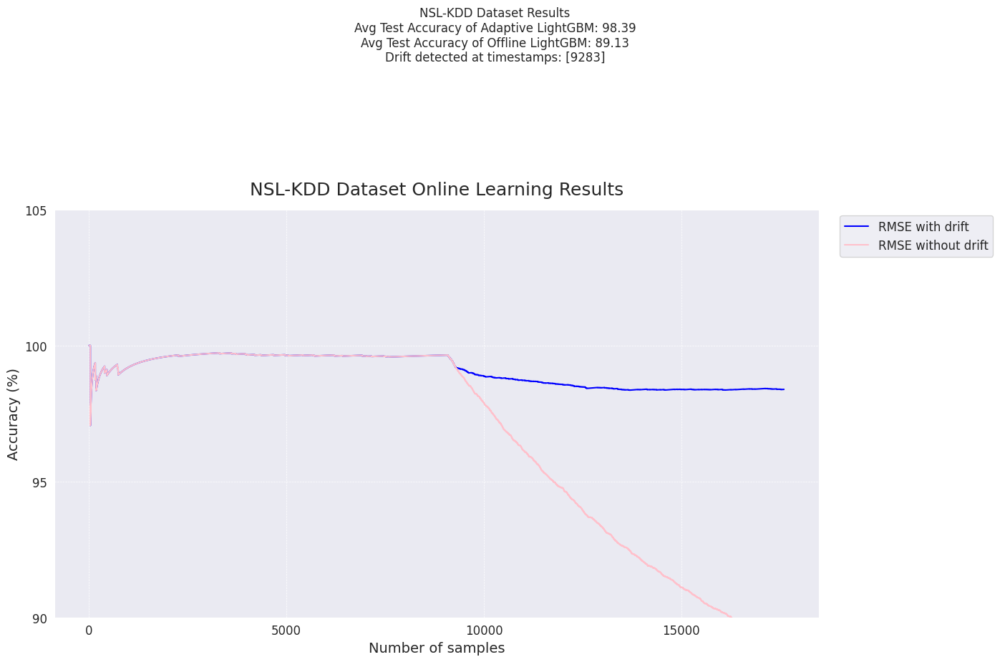

<Figure size 640x480 with 0 Axes>

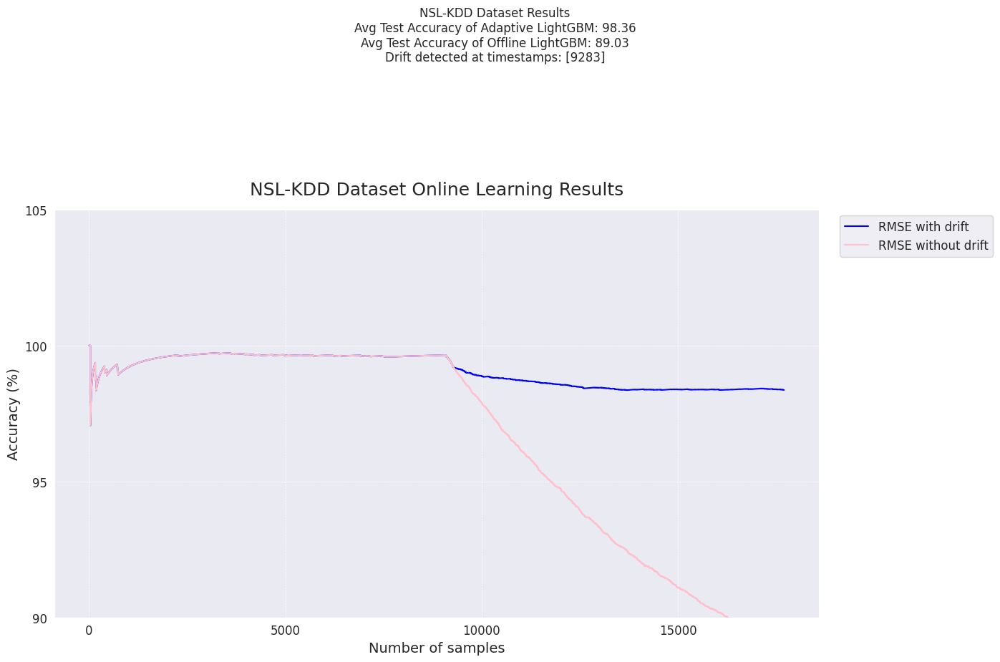

<Figure size 640x480 with 0 Axes>

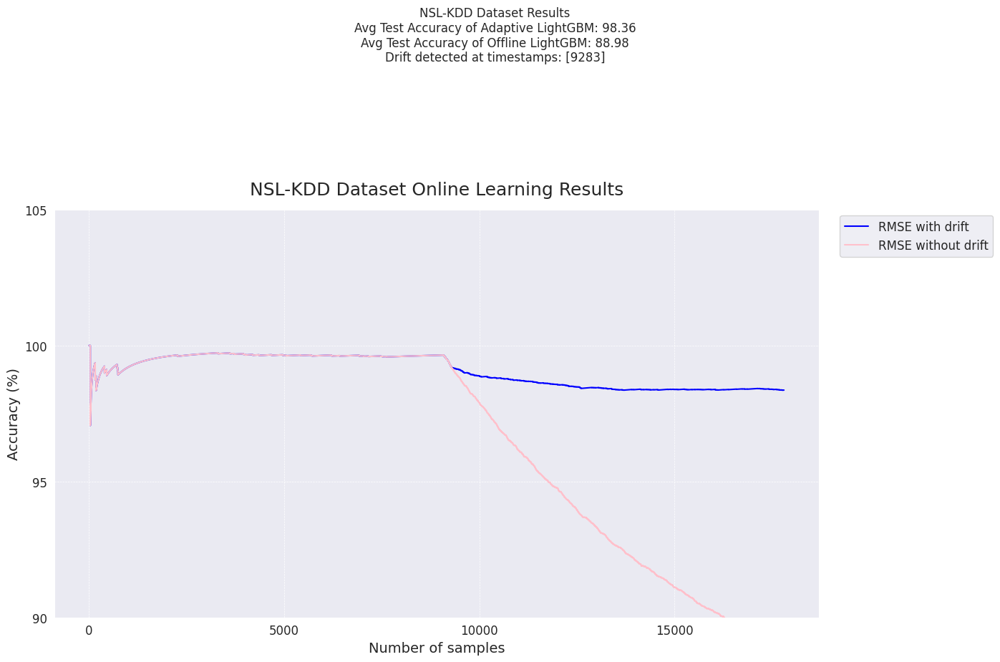

<Figure size 640x480 with 0 Axes>

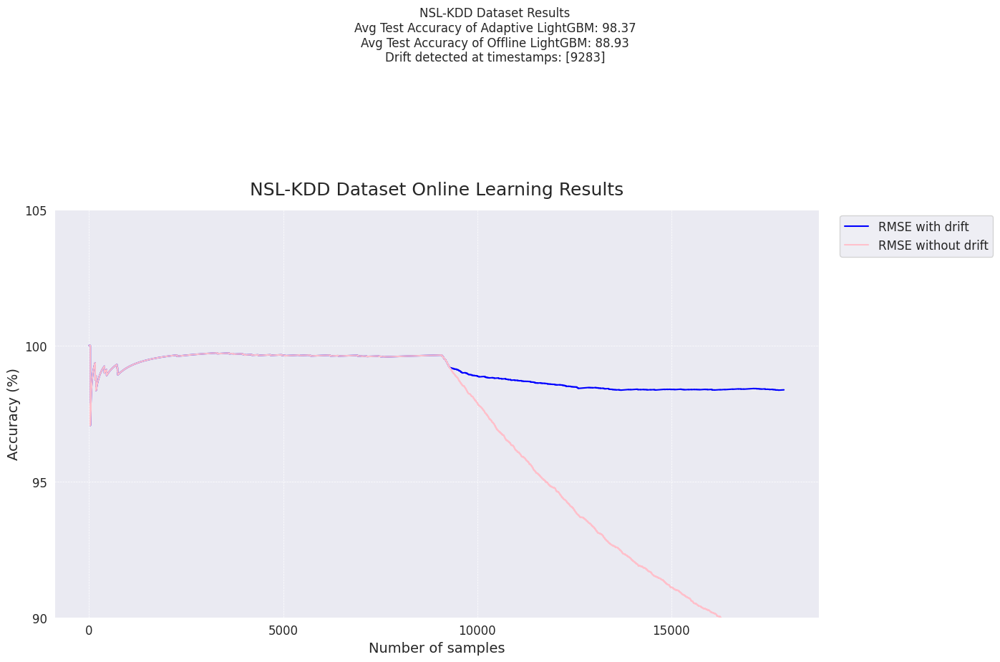

<Figure size 640x480 with 0 Axes>

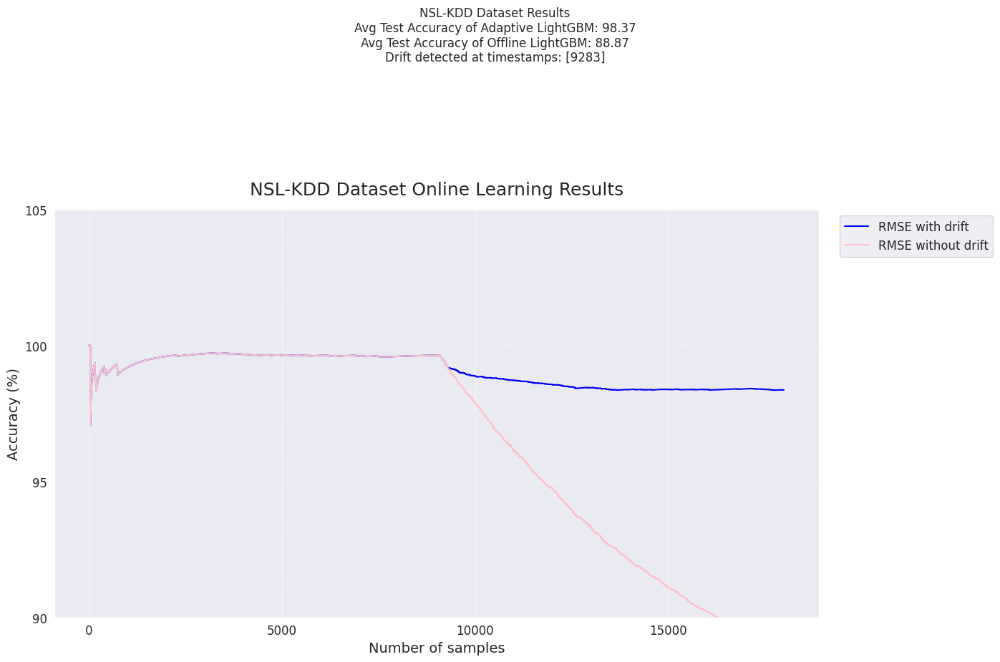

<Figure size 640x480 with 0 Axes>

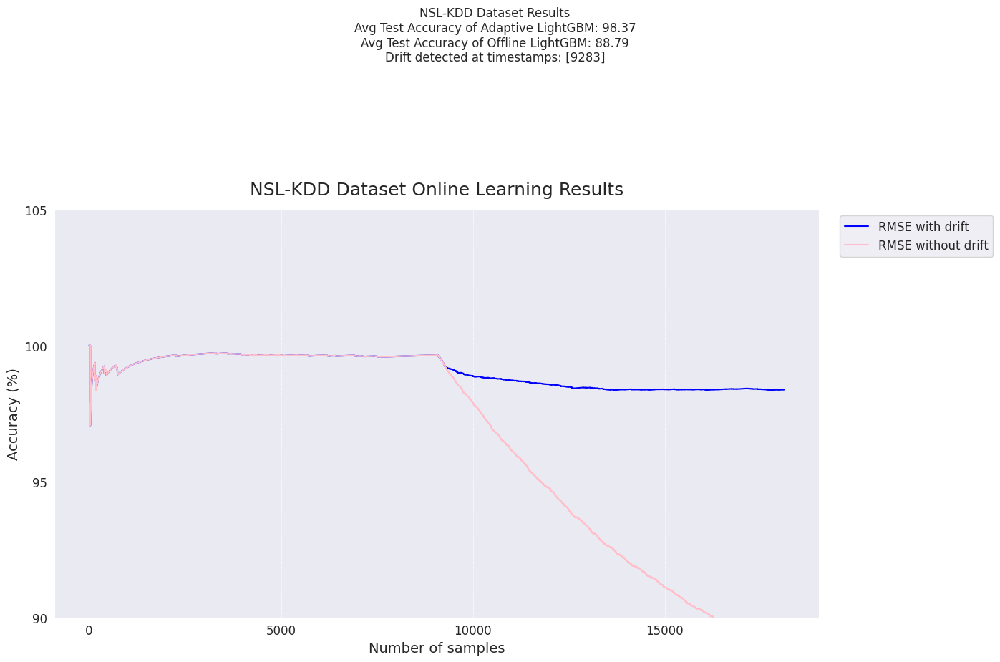

<Figure size 640x480 with 0 Axes>

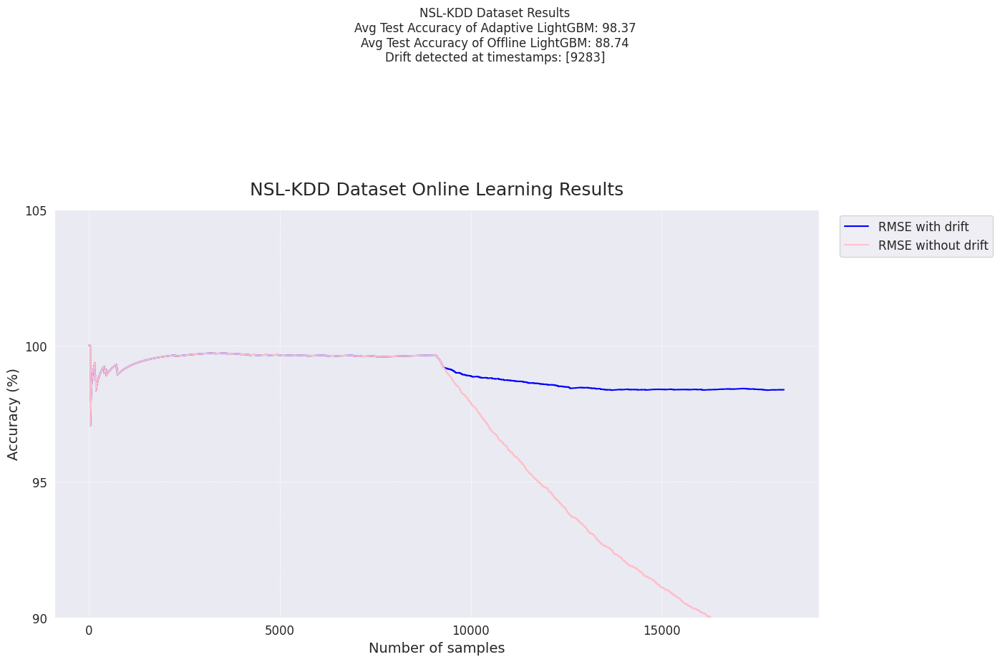

<Figure size 640x480 with 0 Axes>

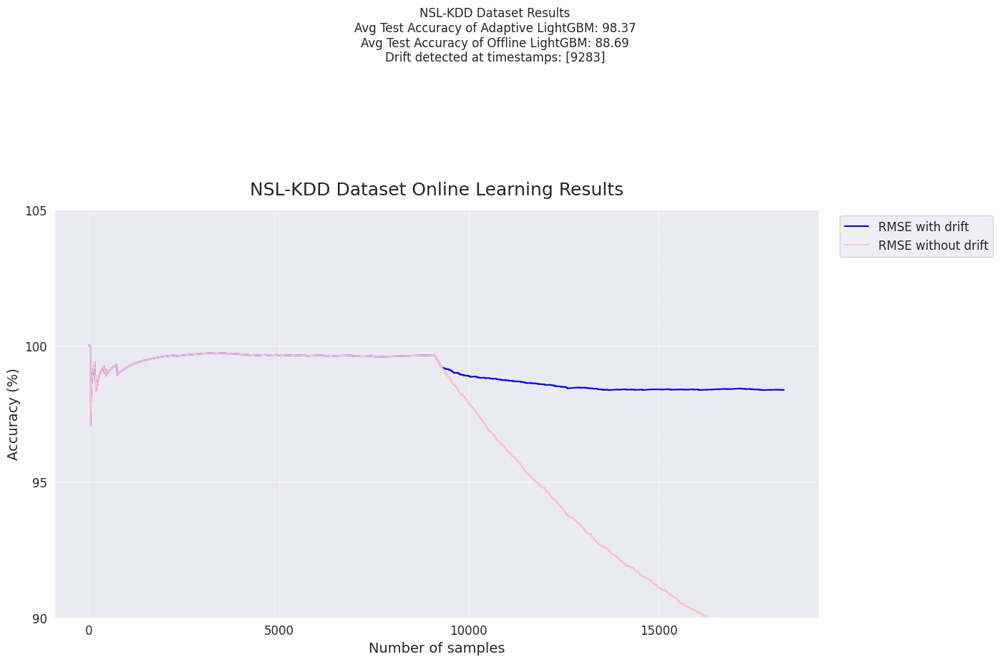

<Figure size 640x480 with 0 Axes>

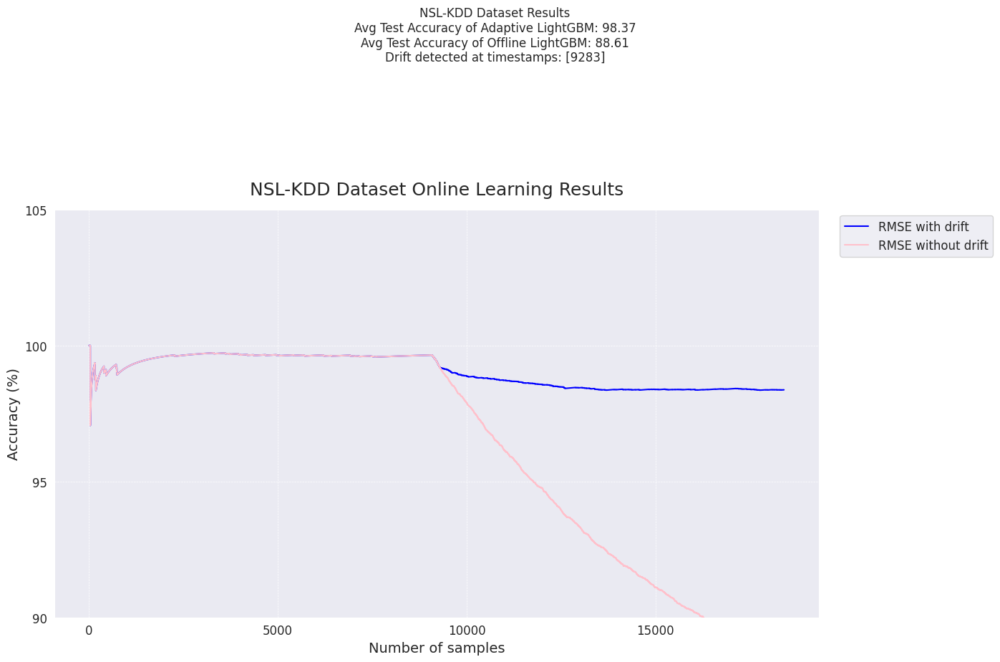

<Figure size 640x480 with 0 Axes>

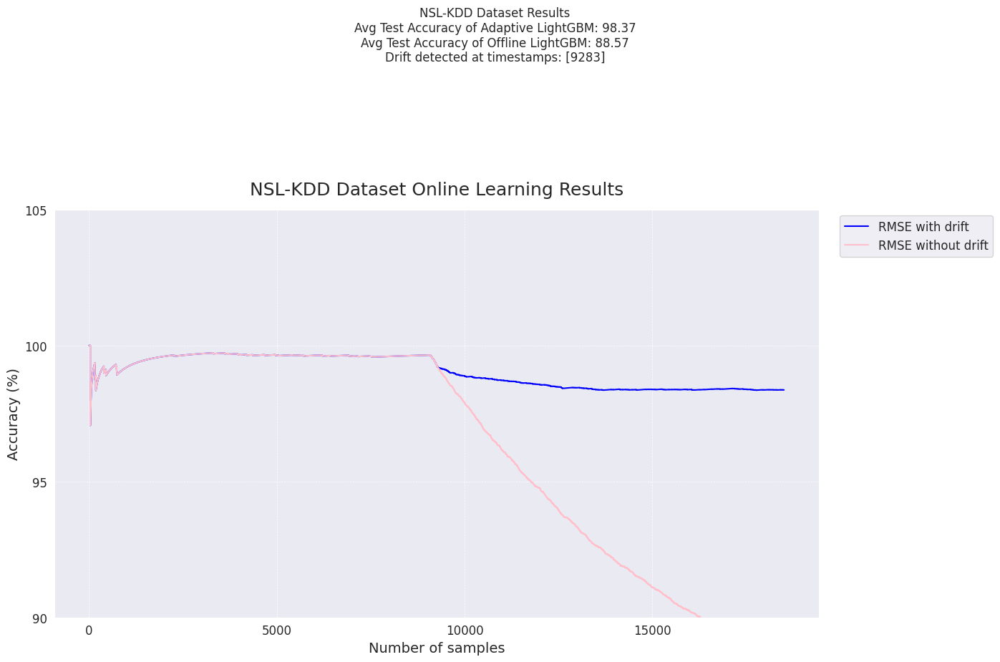

<Figure size 640x480 with 0 Axes>

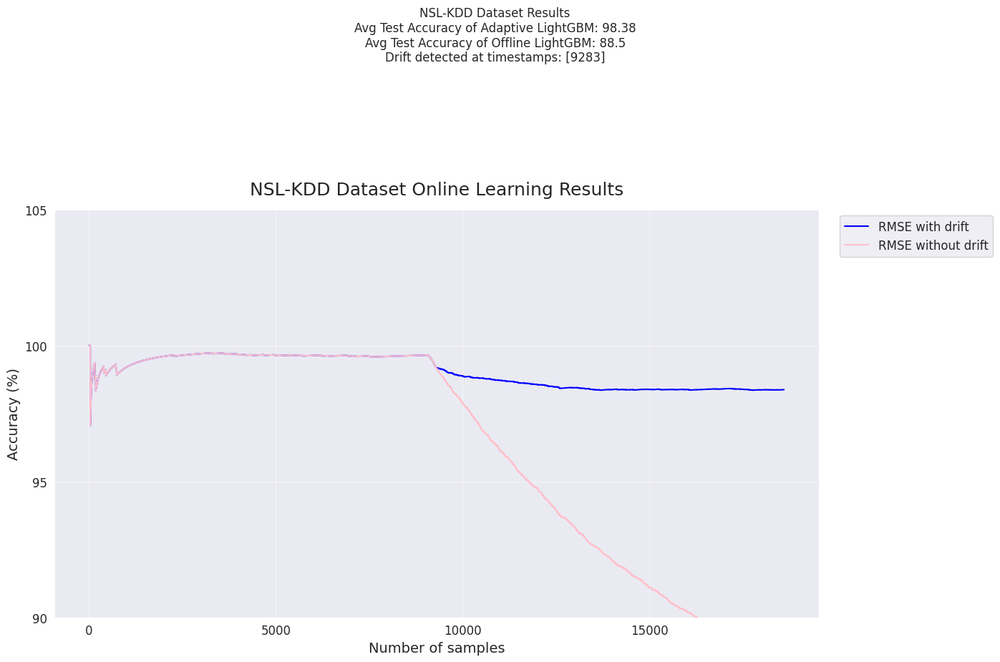

<Figure size 640x480 with 0 Axes>

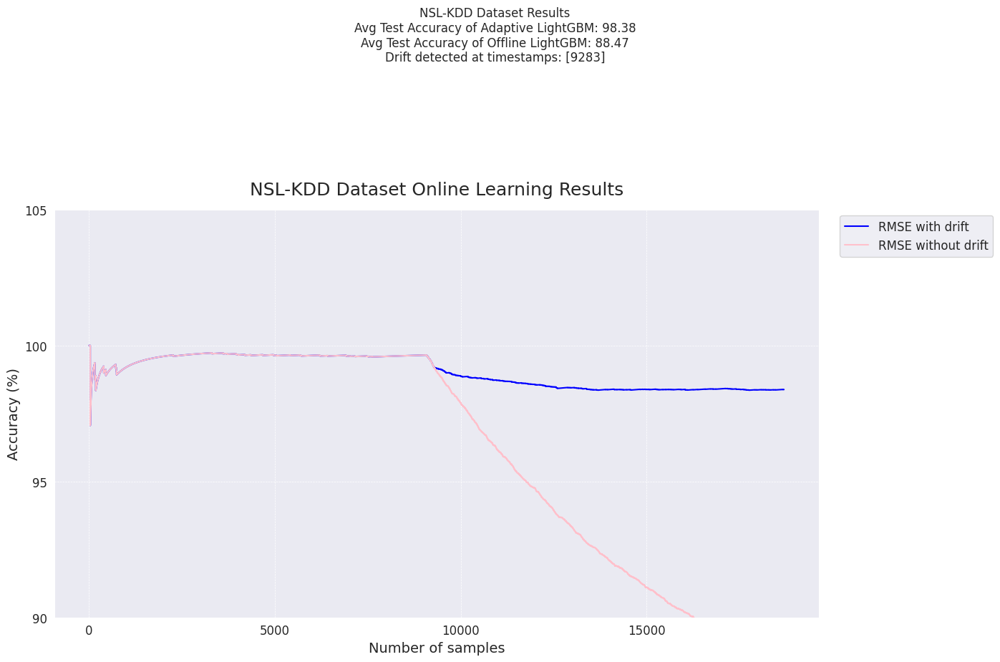

<Figure size 640x480 with 0 Axes>

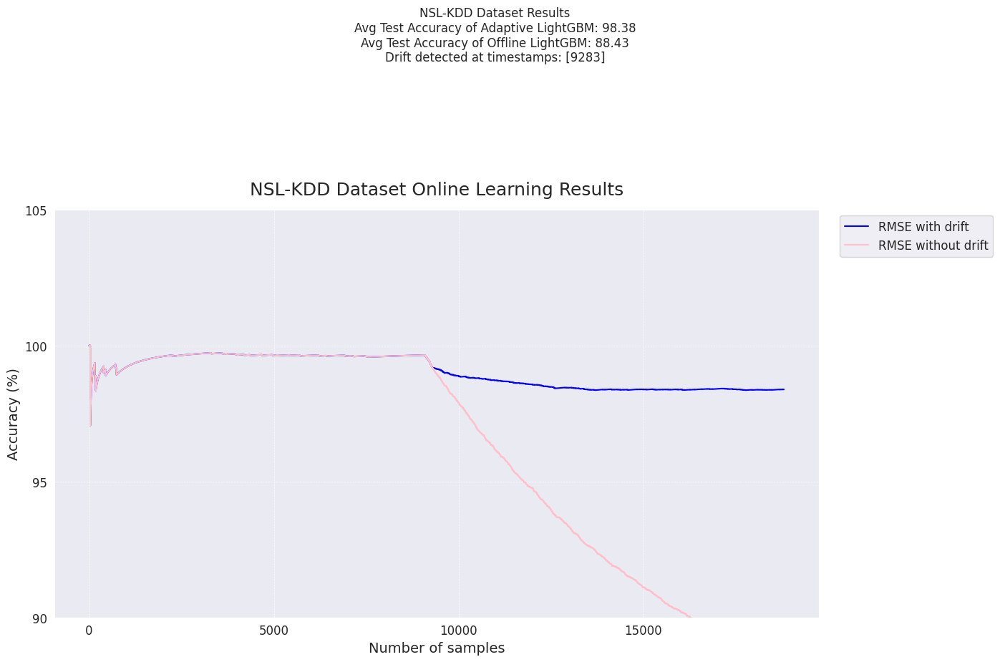

<Figure size 640x480 with 0 Axes>

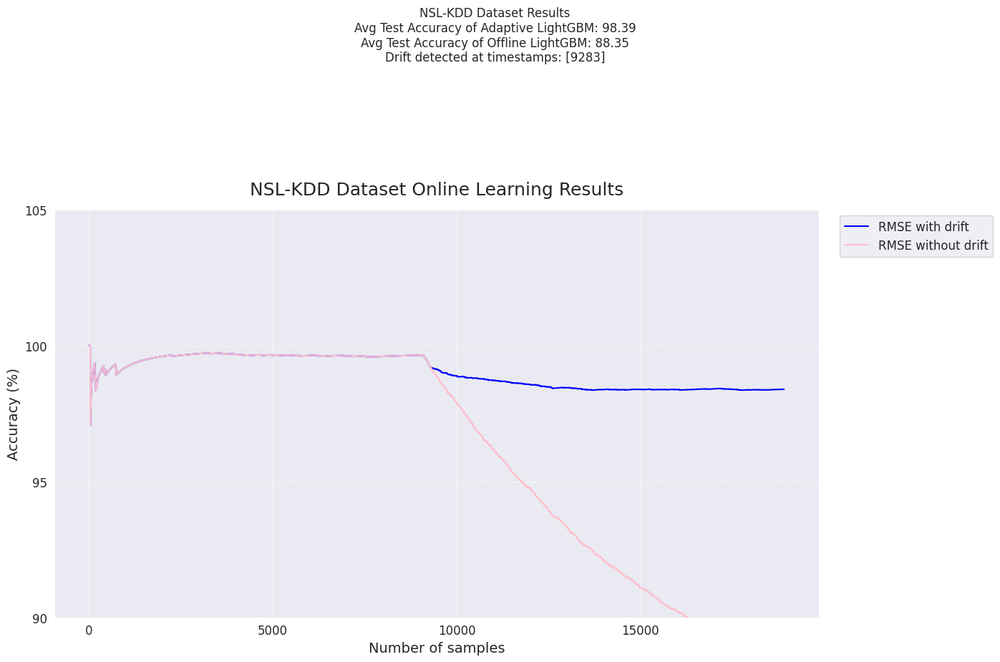

<Figure size 640x480 with 0 Axes>

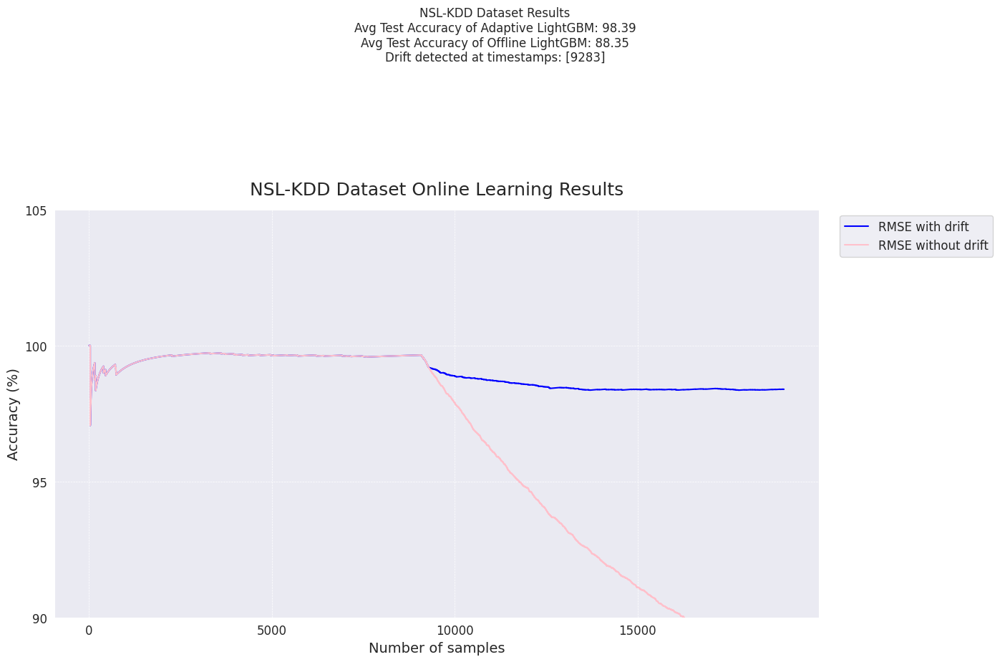

<Figure size 640x480 with 0 Axes>

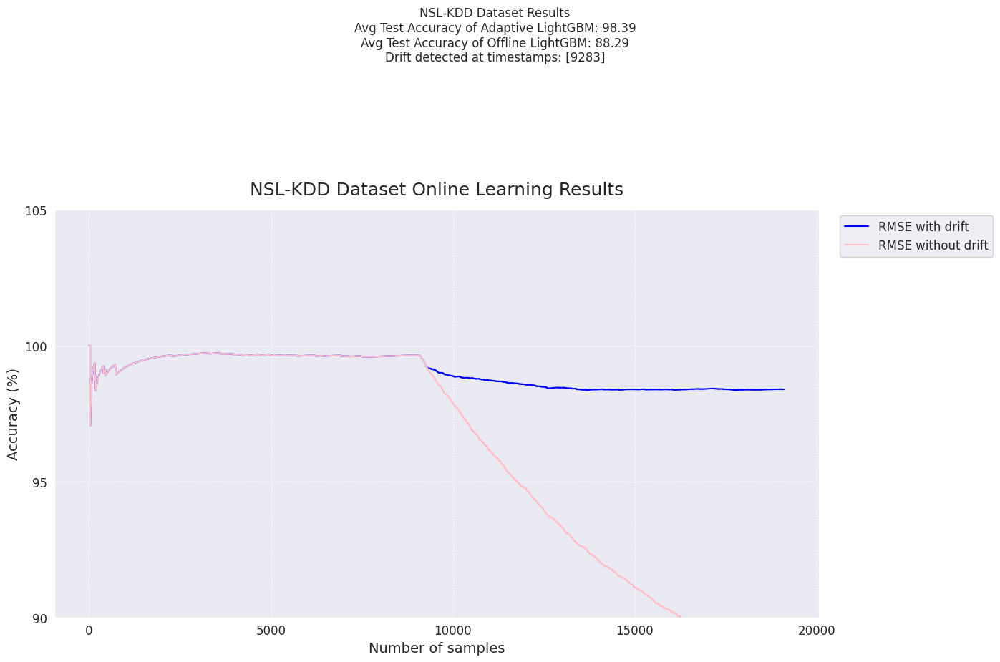

<Figure size 640x480 with 0 Axes>

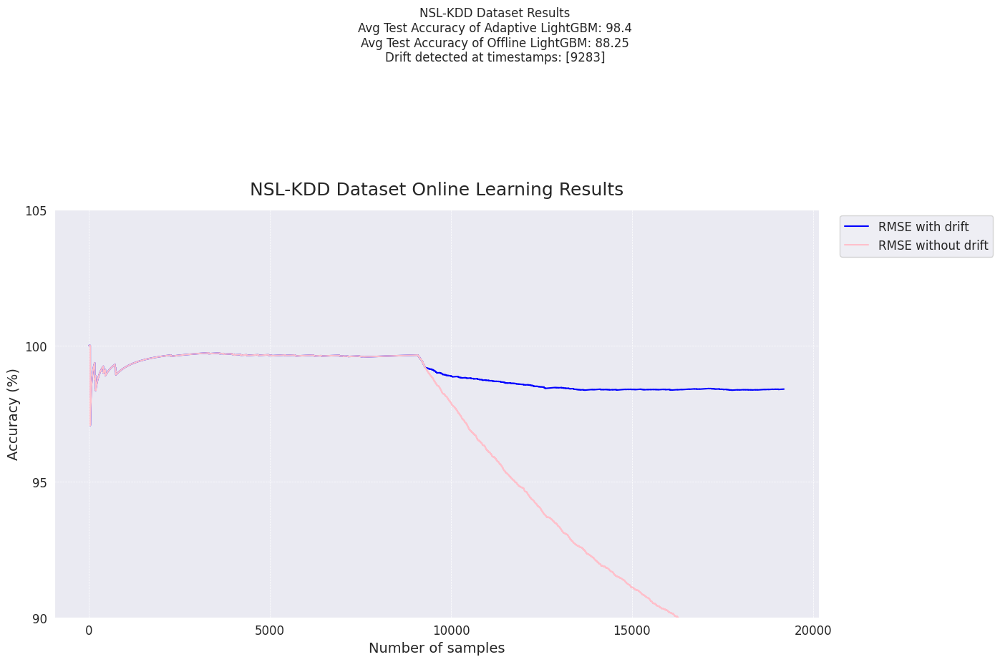

<Figure size 640x480 with 0 Axes>

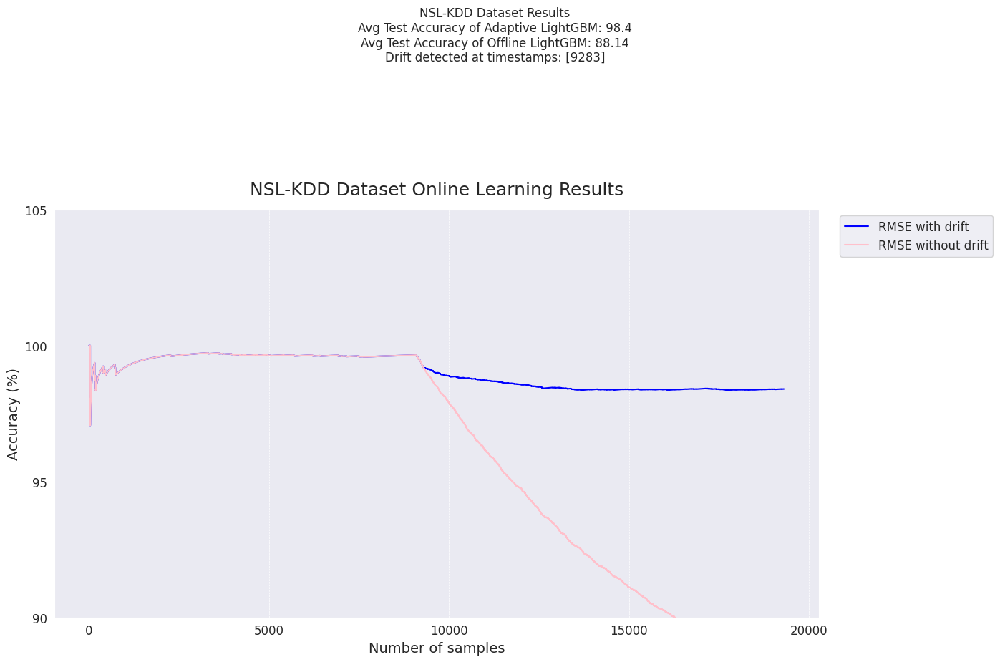

<Figure size 640x480 with 0 Axes>

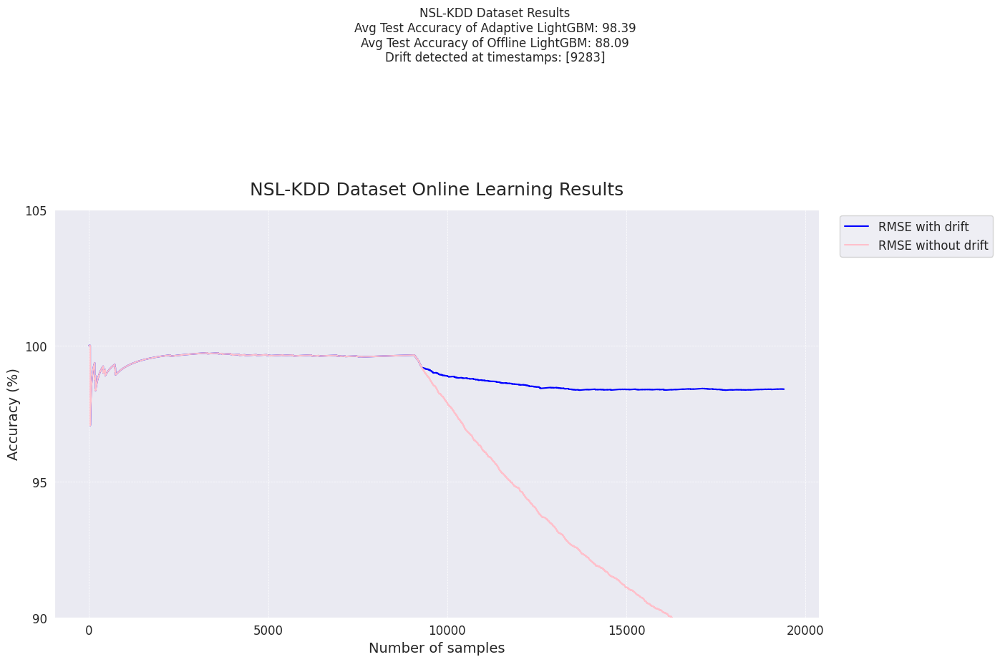

<Figure size 640x480 with 0 Axes>

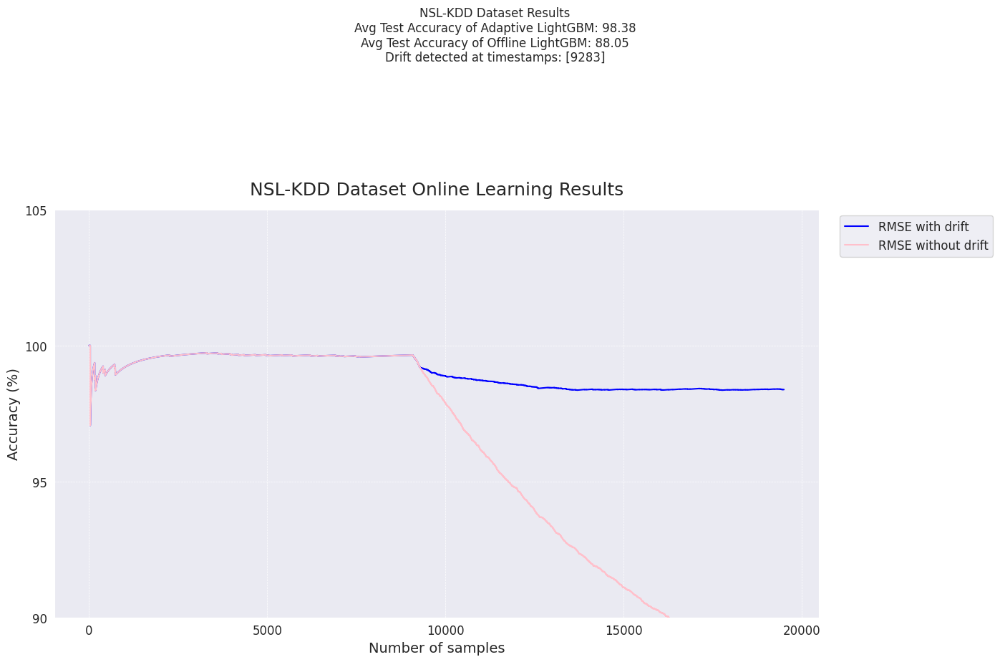

<Figure size 640x480 with 0 Axes>

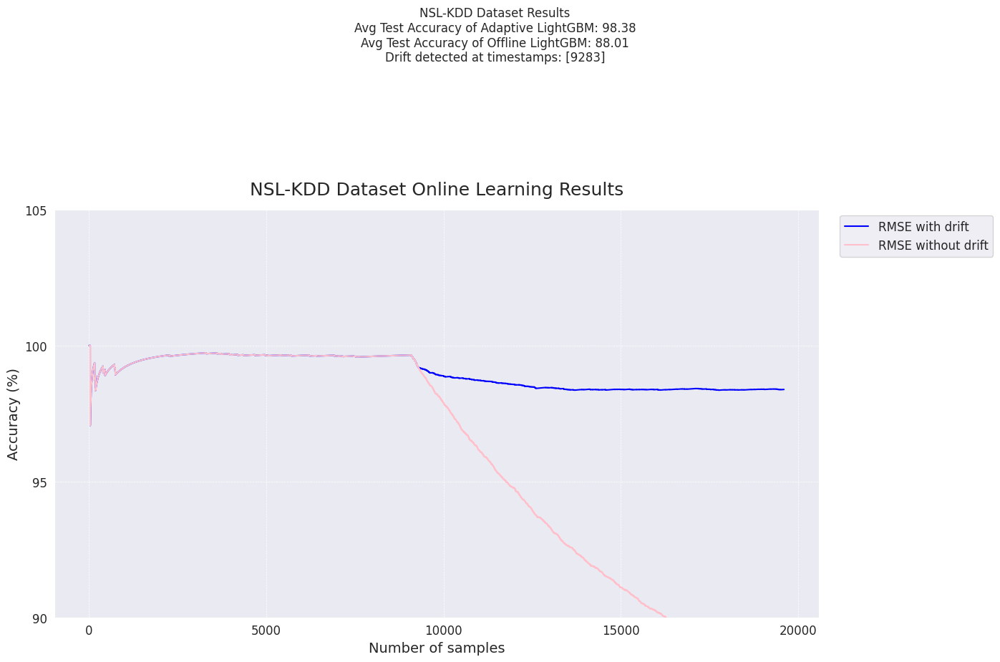

<Figure size 640x480 with 0 Axes>

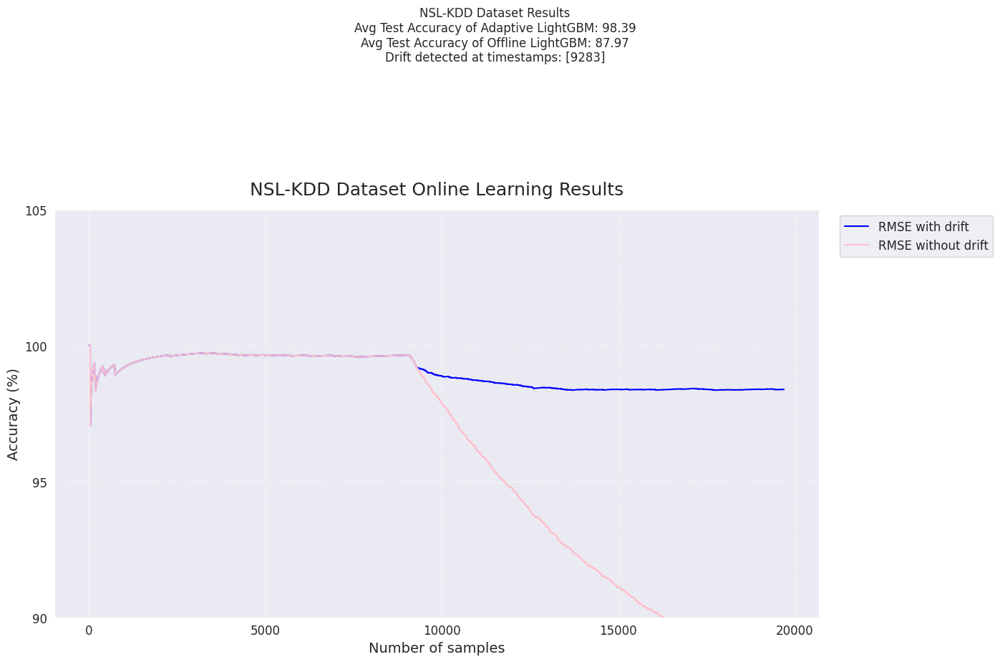

<Figure size 640x480 with 0 Axes>

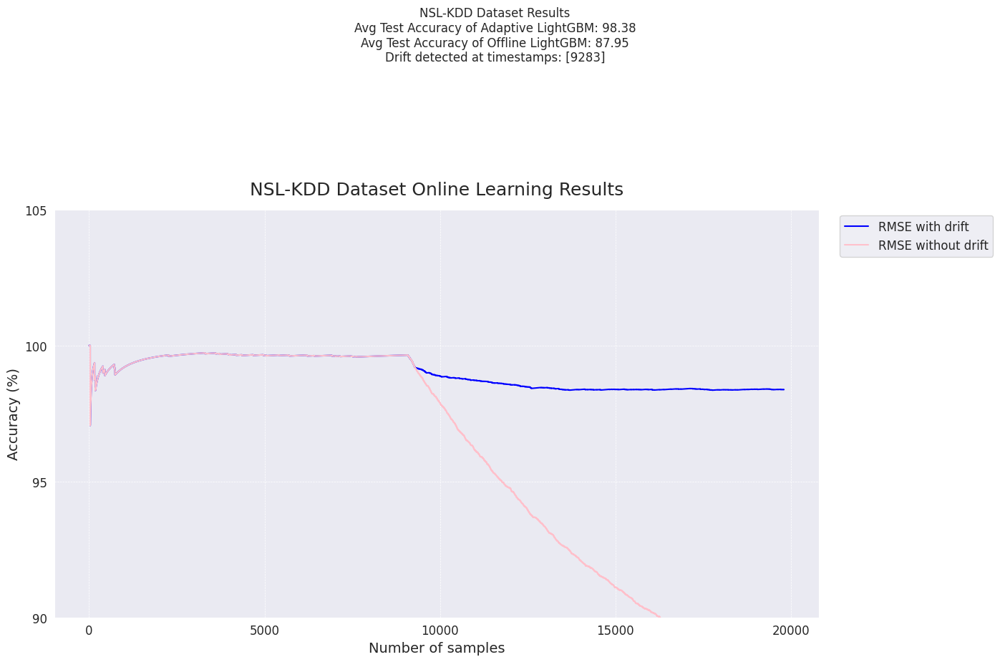

<Figure size 640x480 with 0 Axes>

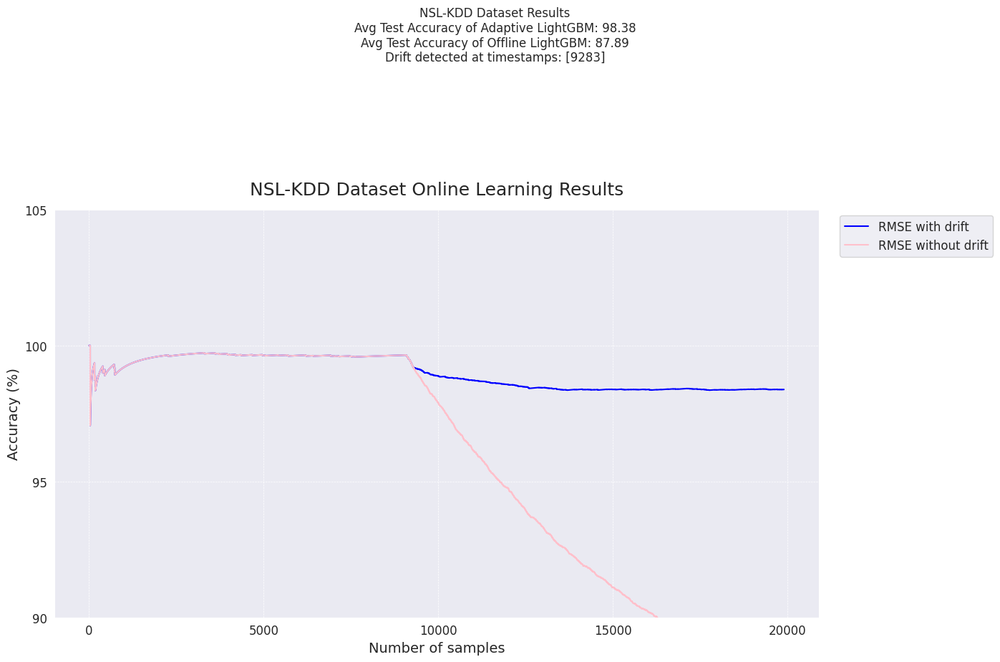

<Figure size 640x480 with 0 Axes>

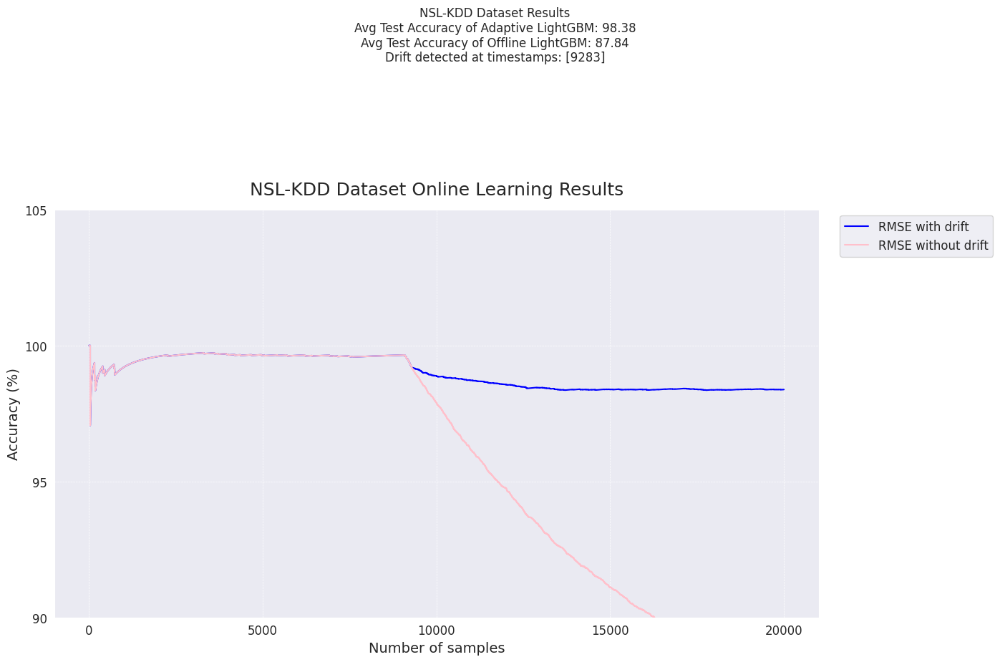

<Figure size 640x480 with 0 Axes>

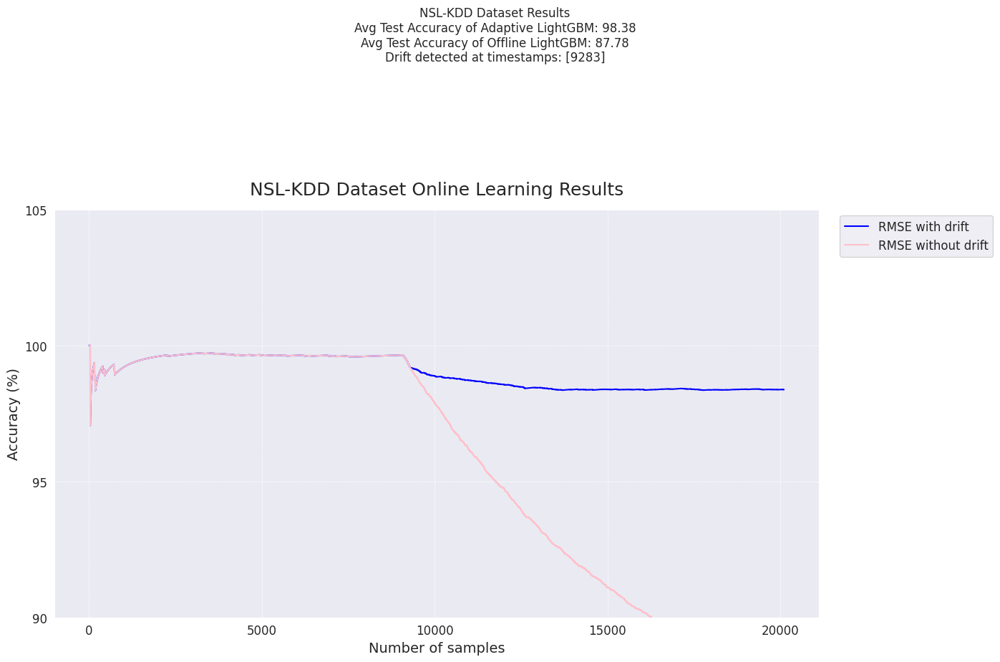

<Figure size 640x480 with 0 Axes>

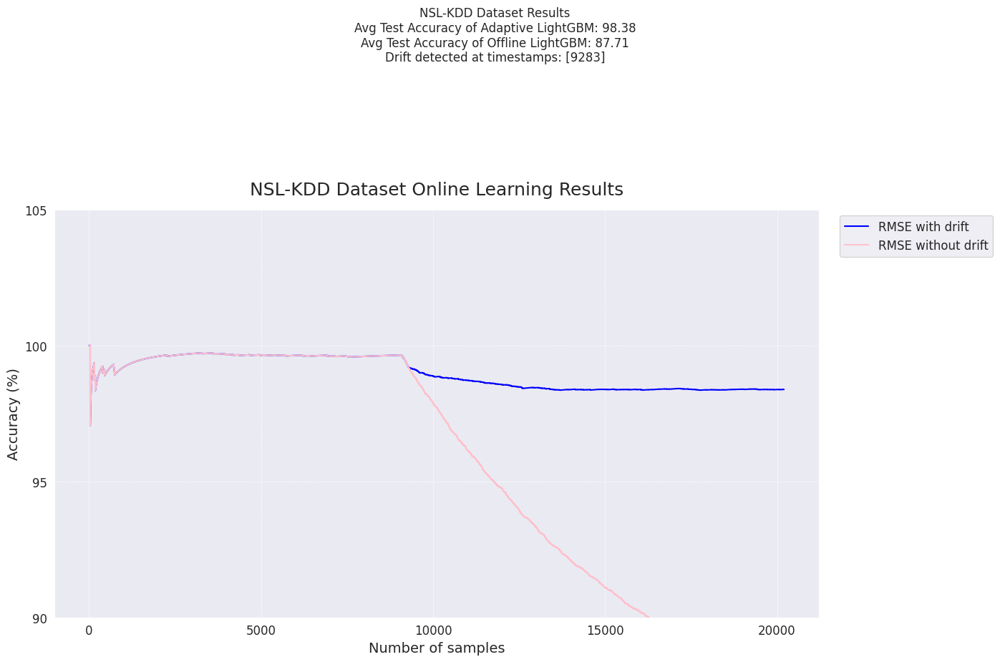

<Figure size 640x480 with 0 Axes>

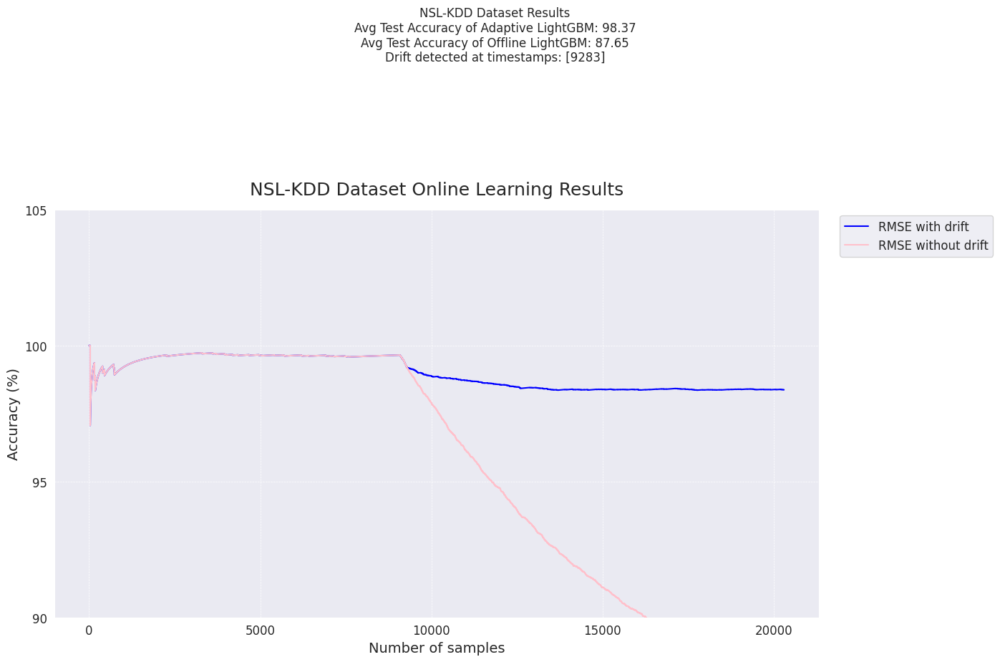

<Figure size 640x480 with 0 Axes>

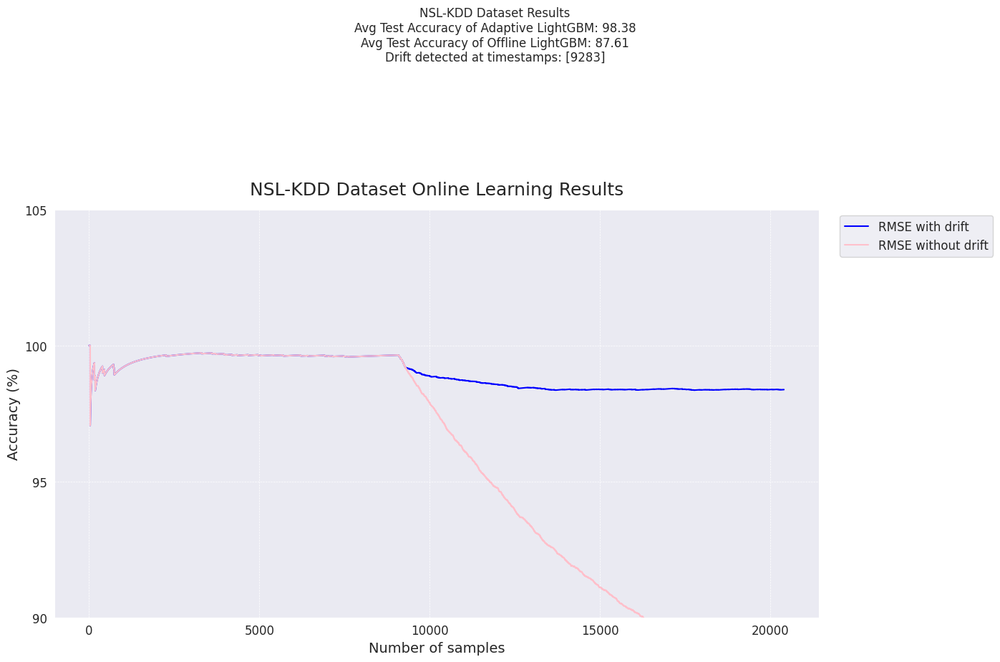

<Figure size 640x480 with 0 Axes>

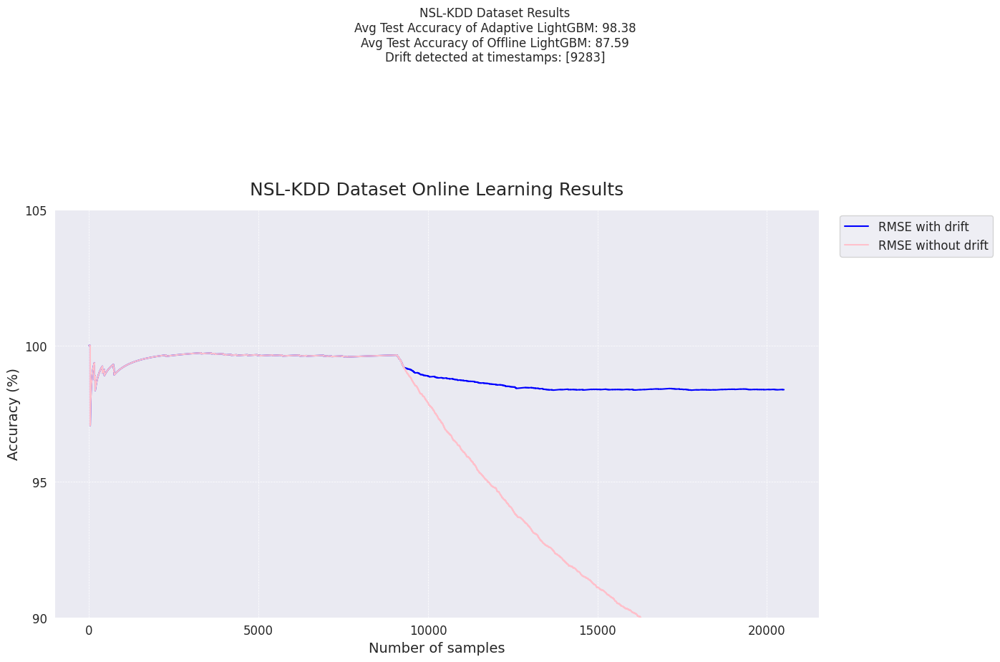

<Figure size 640x480 with 0 Axes>

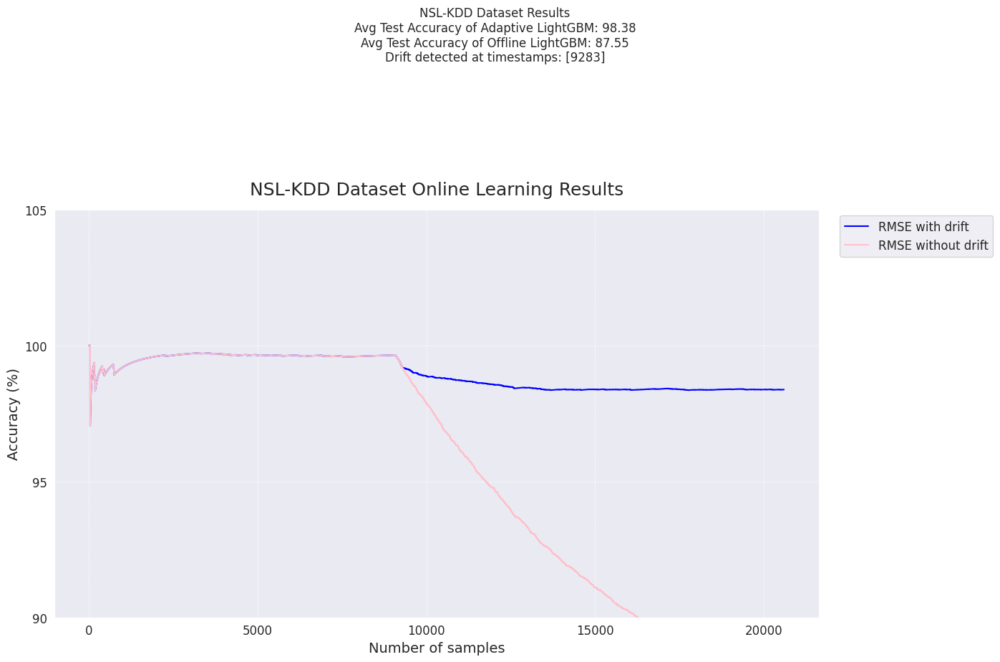

<Figure size 640x480 with 0 Axes>

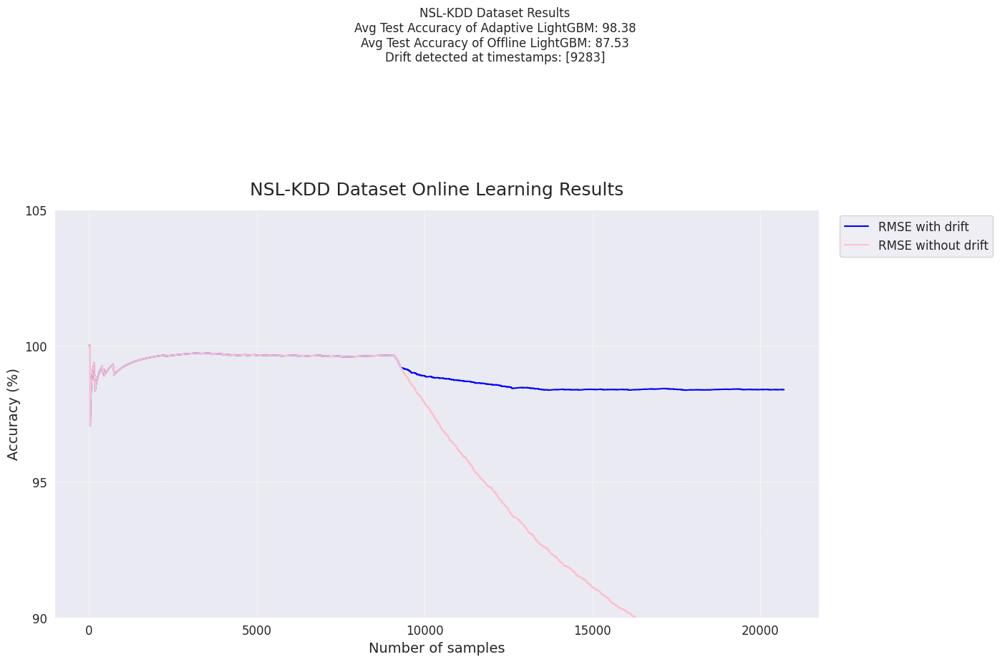

<Figure size 640x480 with 0 Axes>

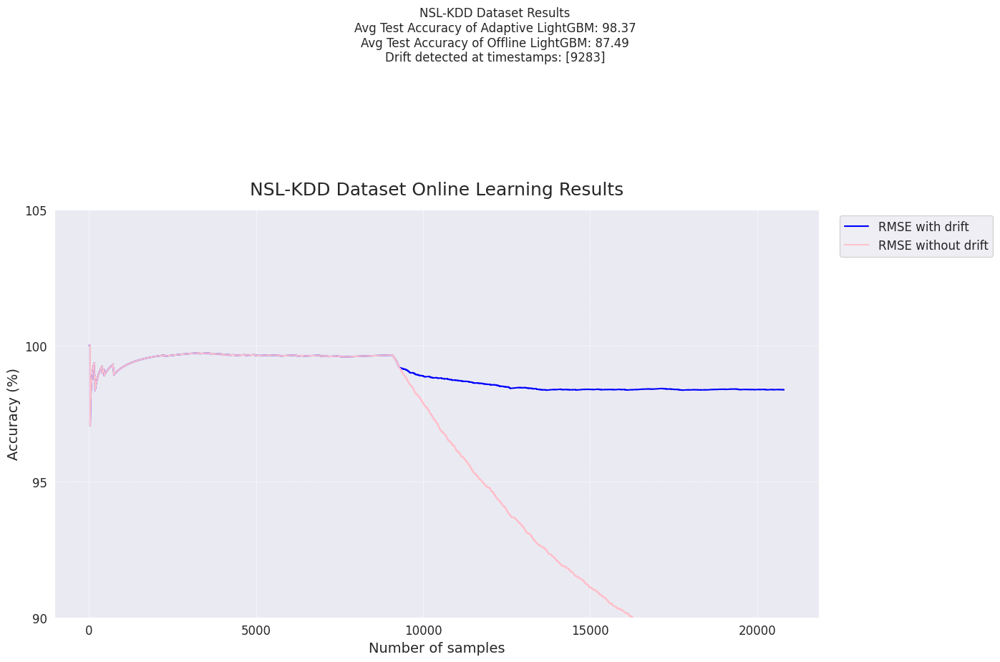

<Figure size 640x480 with 0 Axes>

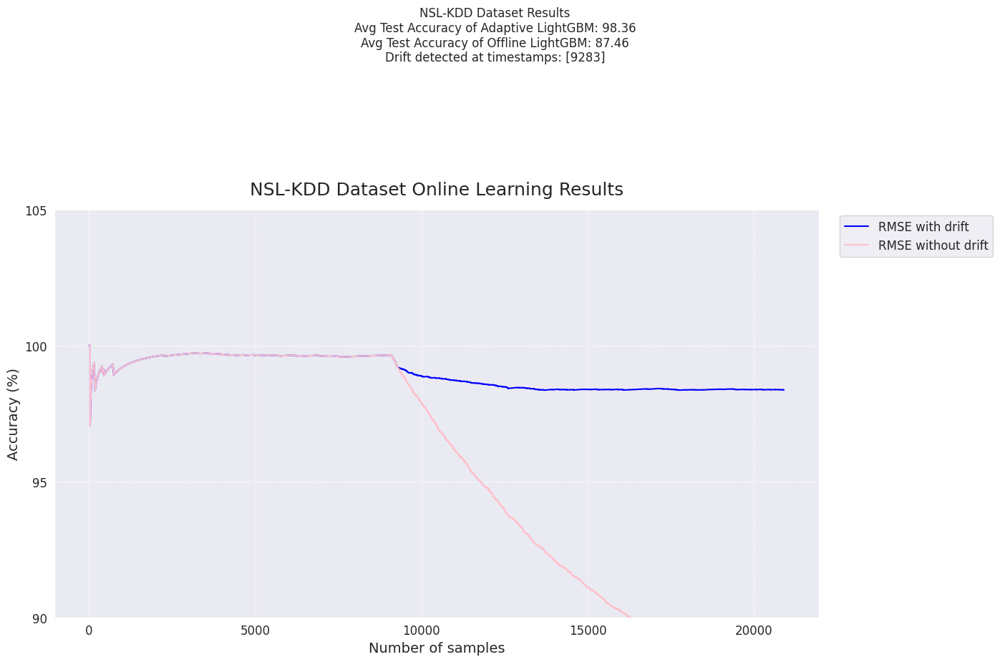

<Figure size 640x480 with 0 Axes>

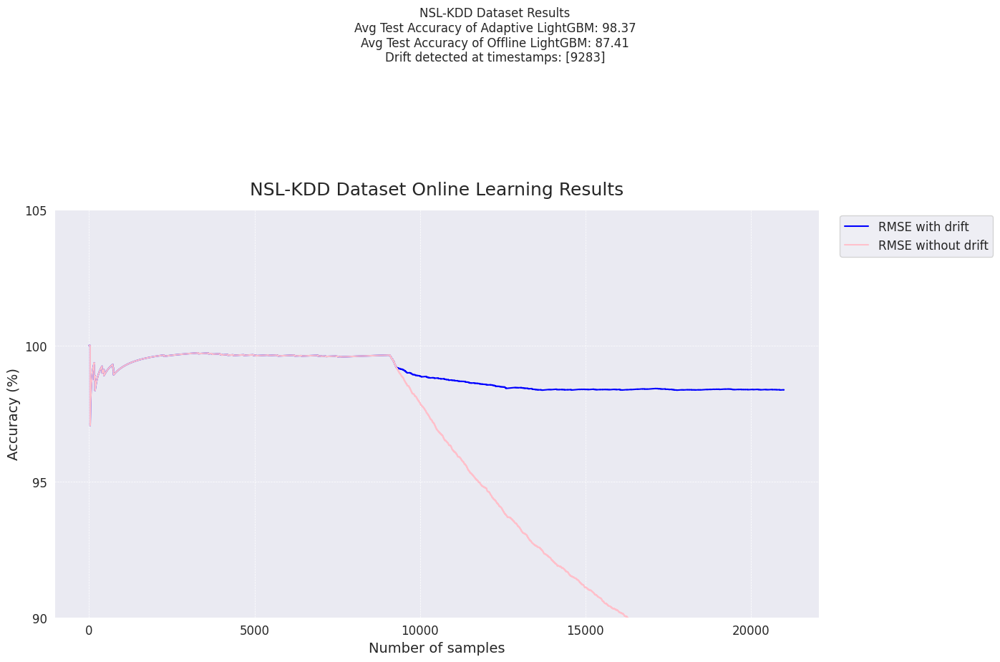

<Figure size 640x480 with 0 Axes>

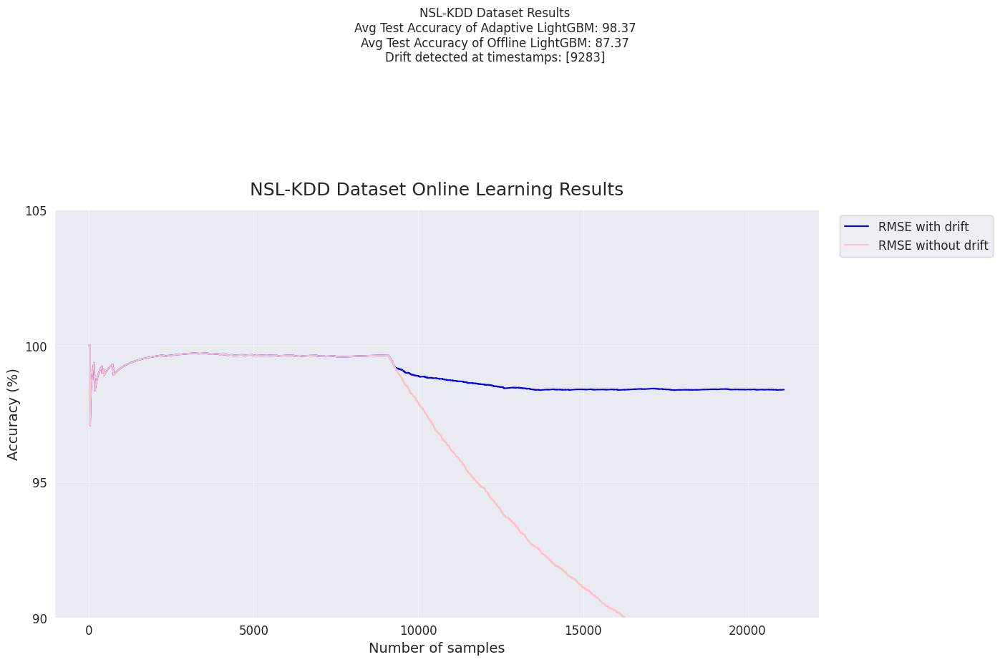

<Figure size 640x480 with 0 Axes>

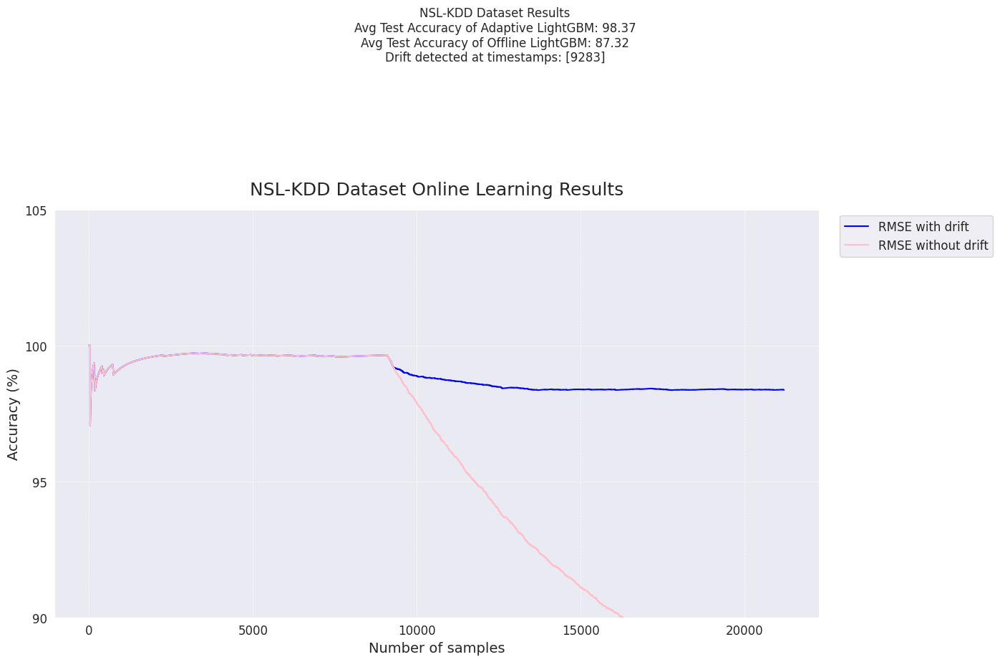

<Figure size 640x480 with 0 Axes>

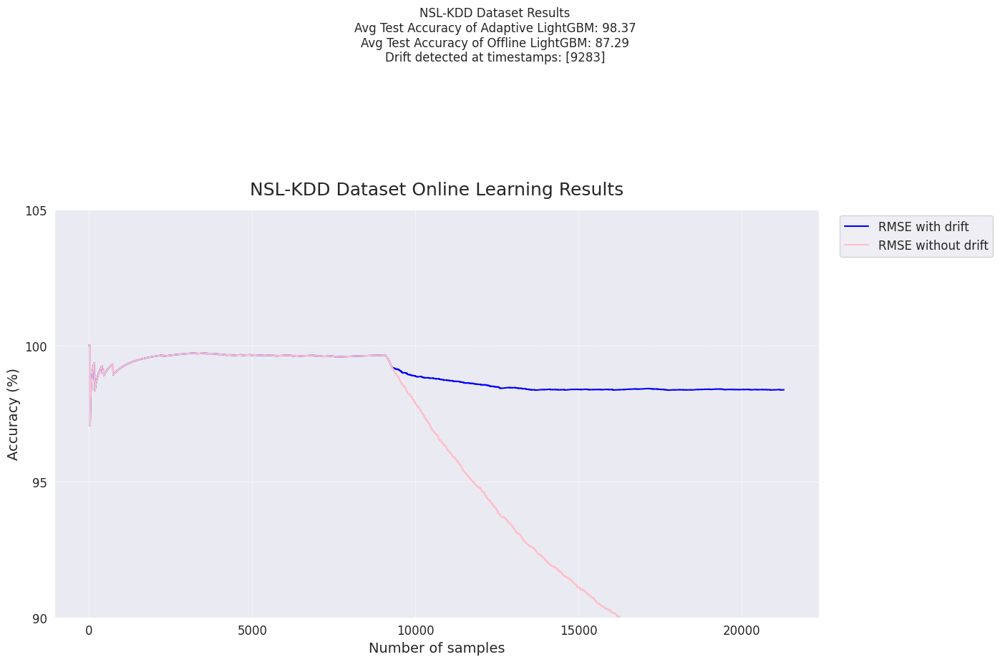

<Figure size 640x480 with 0 Axes>

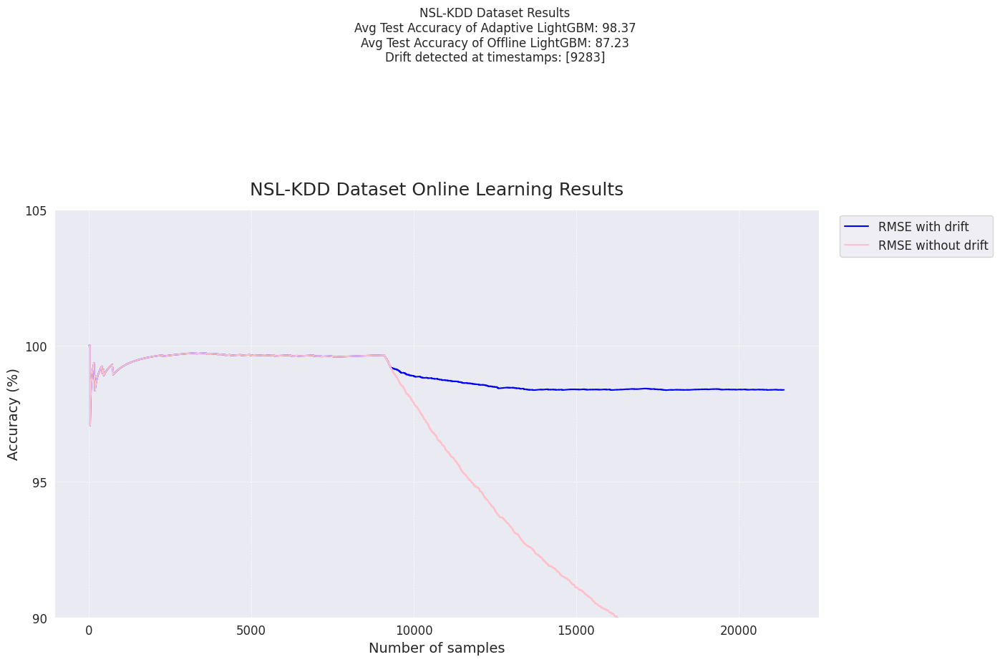

<Figure size 640x480 with 0 Axes>

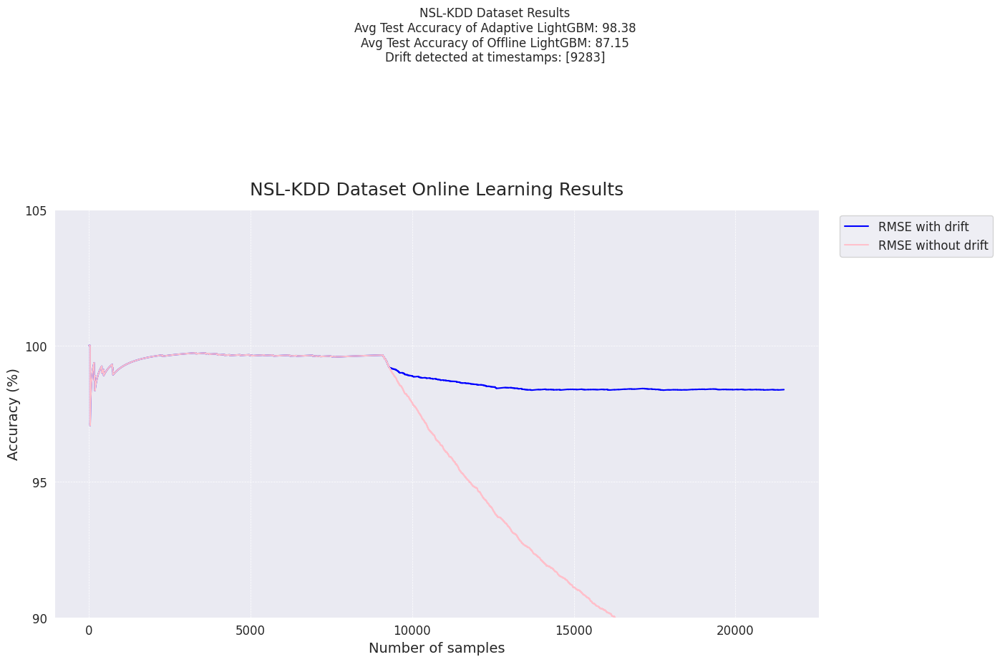

<Figure size 640x480 with 0 Axes>

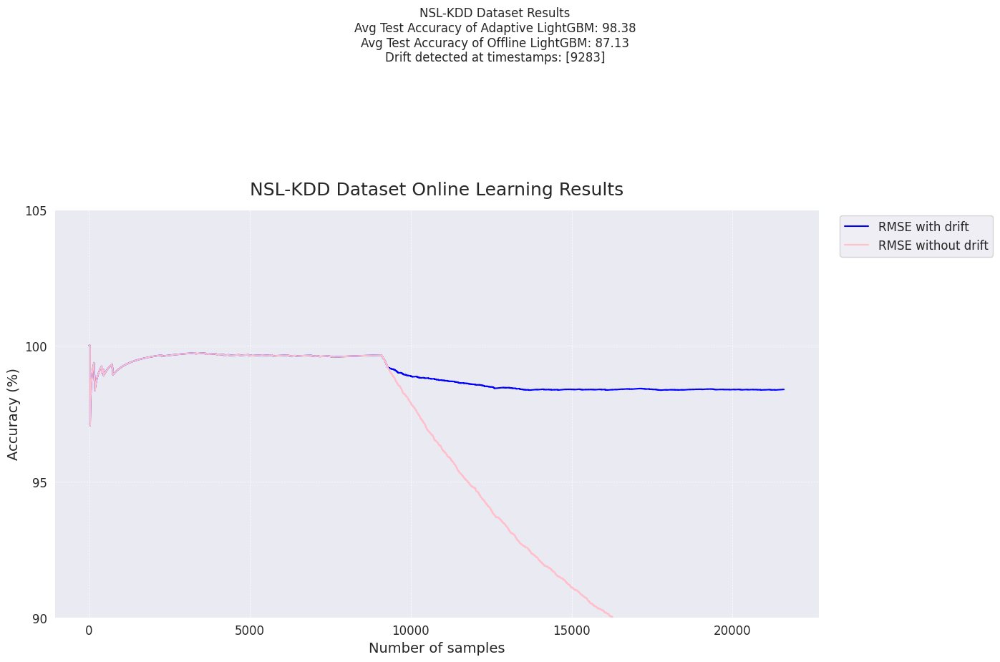

<Figure size 640x480 with 0 Axes>

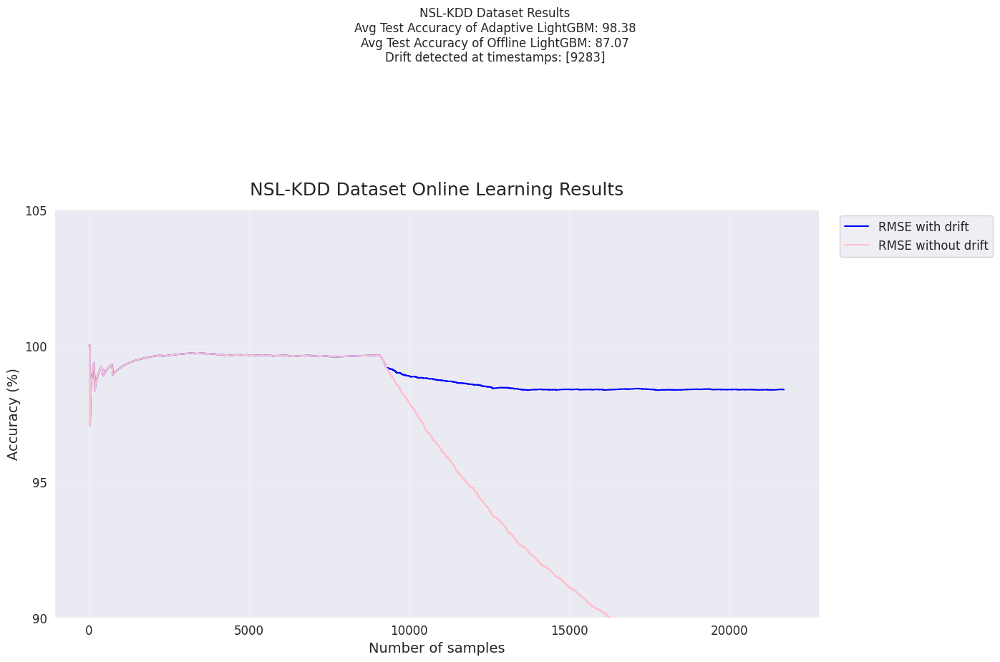

<Figure size 640x480 with 0 Axes>

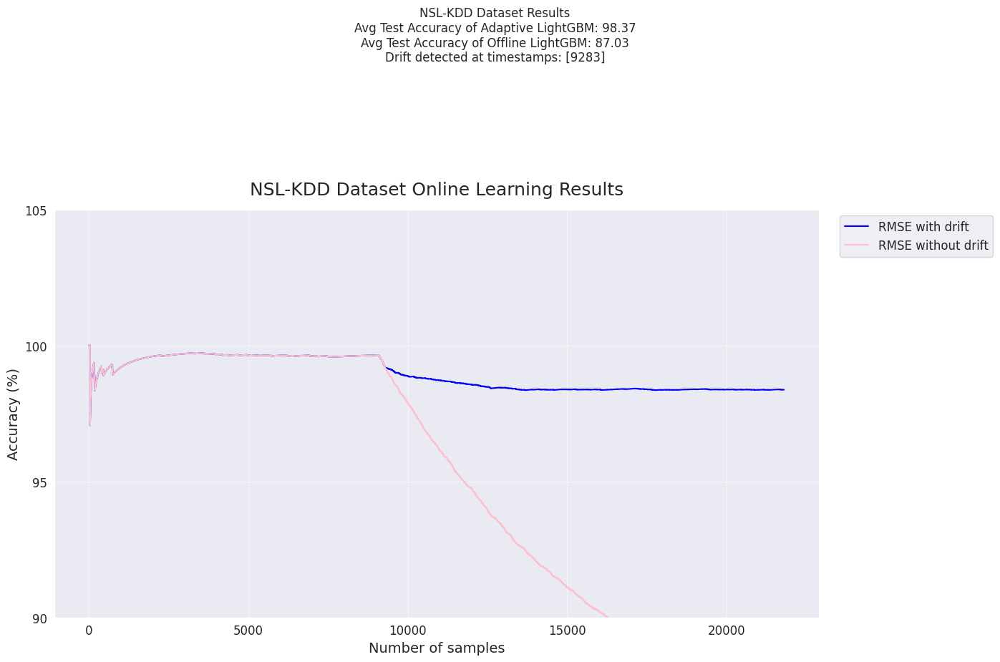

<Figure size 640x480 with 0 Axes>

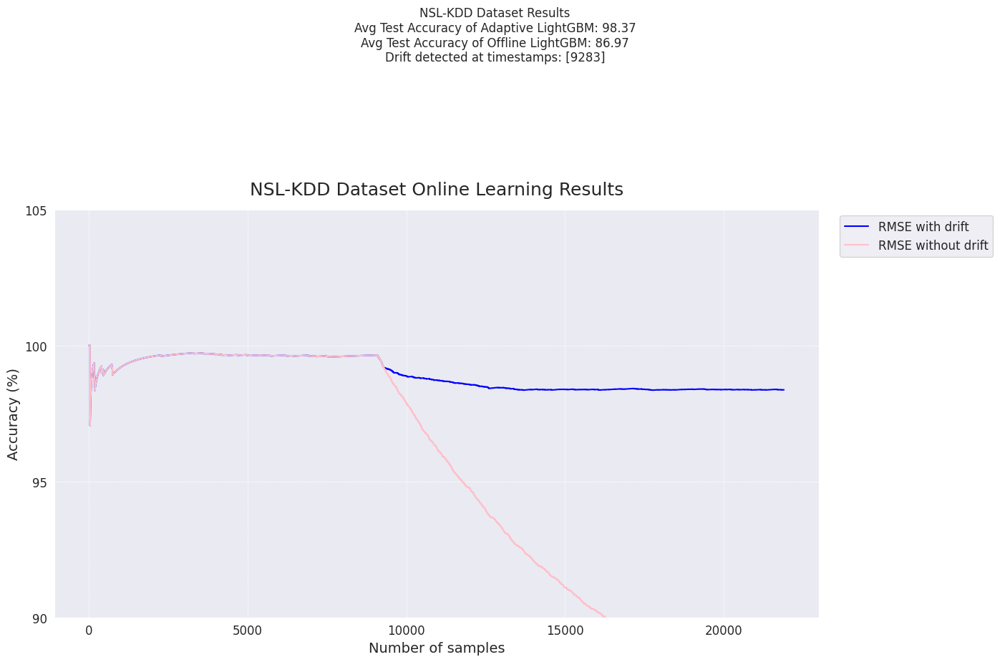

<Figure size 640x480 with 0 Axes>

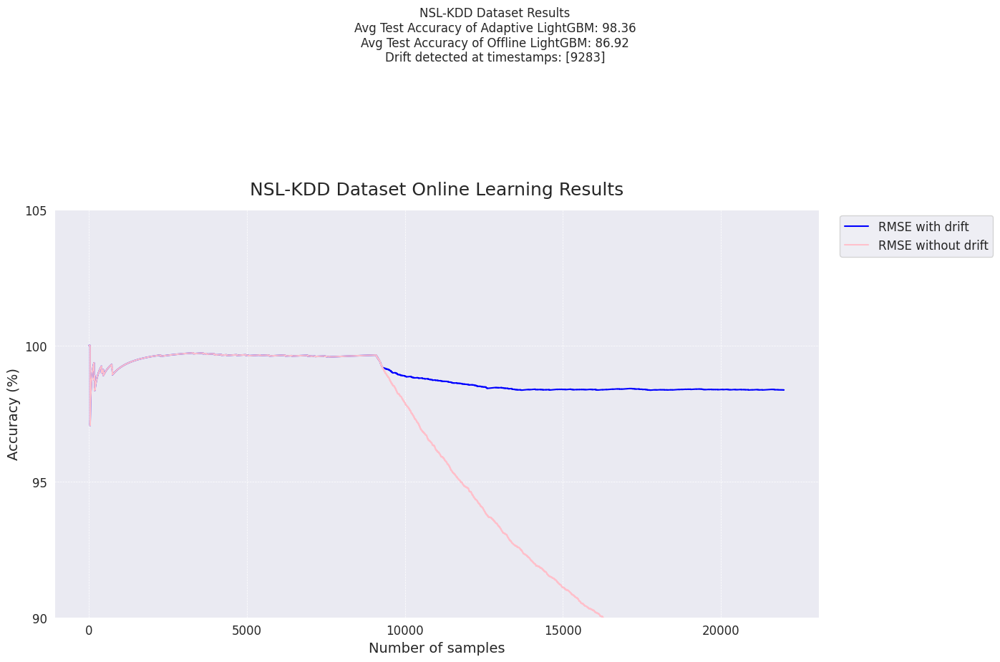

<Figure size 640x480 with 0 Axes>

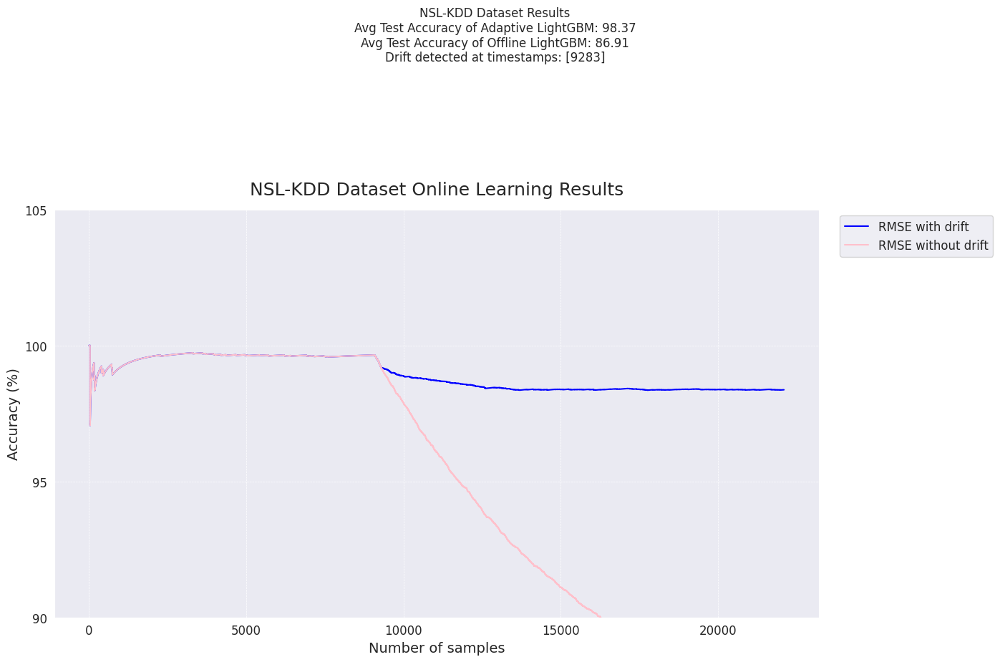

<Figure size 640x480 with 0 Axes>

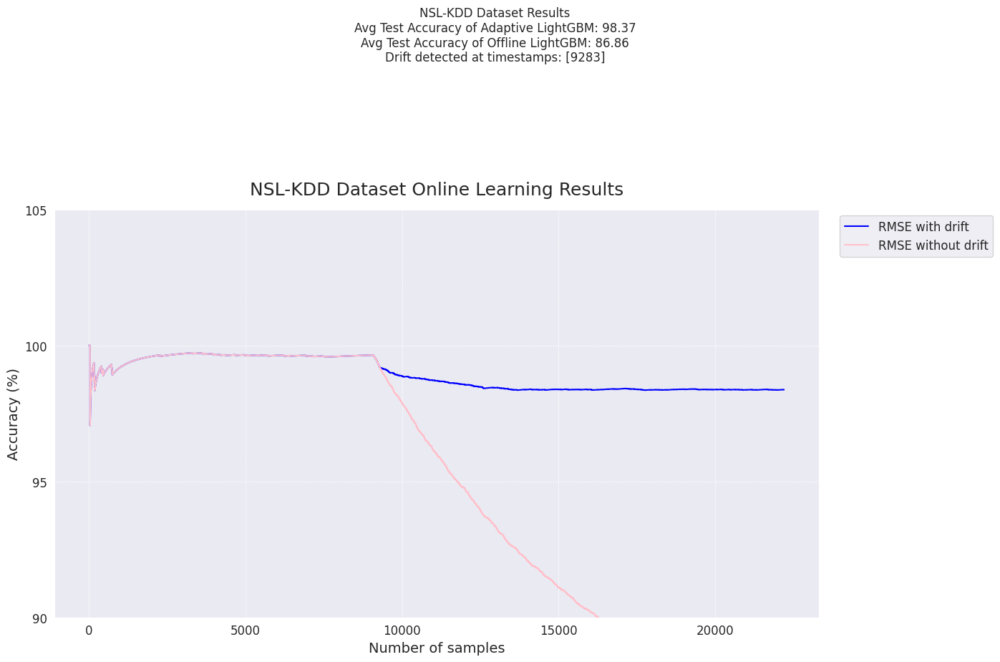

<Figure size 640x480 with 0 Axes>

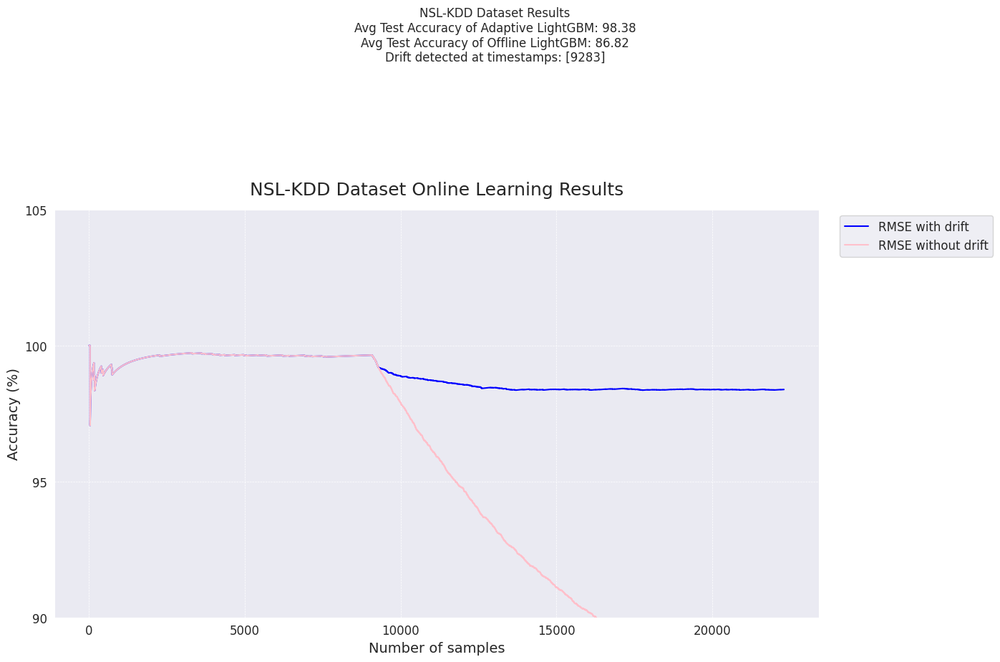

<Figure size 640x480 with 0 Axes>

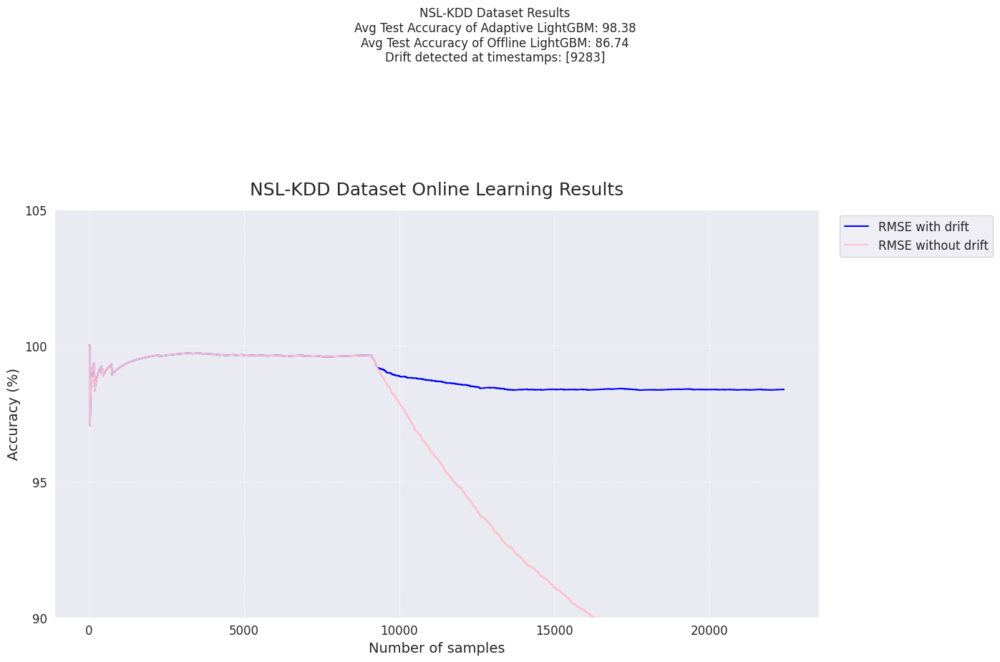

<Figure size 640x480 with 0 Axes>

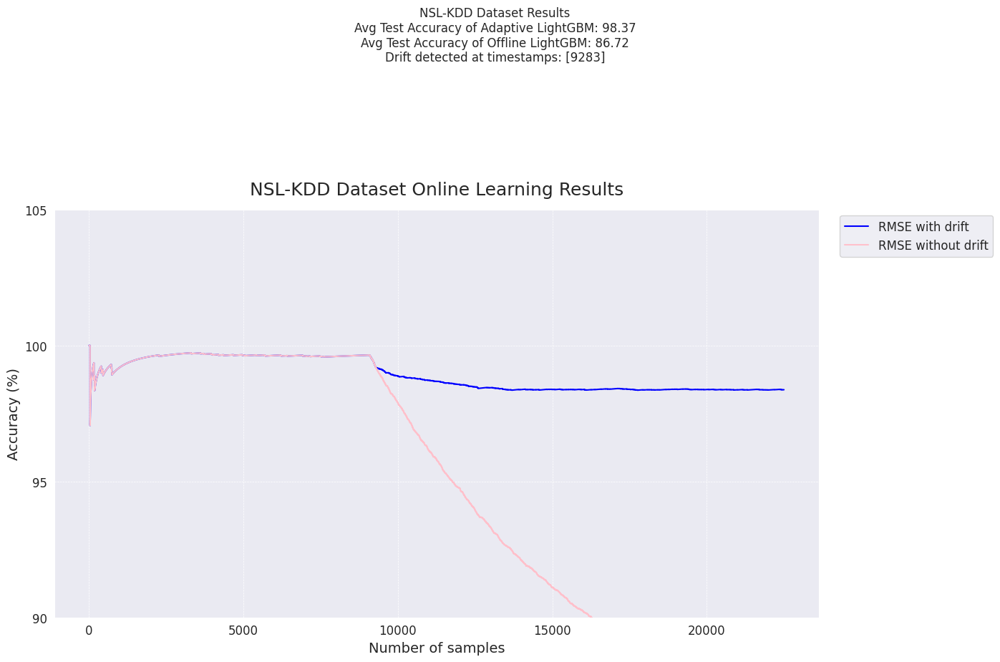

<Figure size 640x480 with 0 Axes>

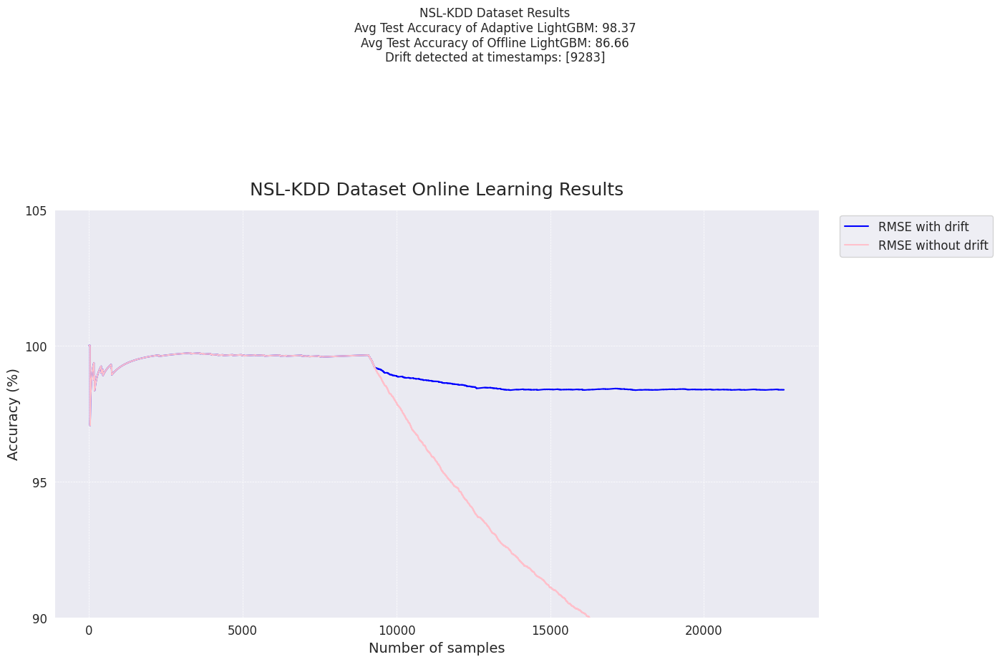

<Figure size 640x480 with 0 Axes>

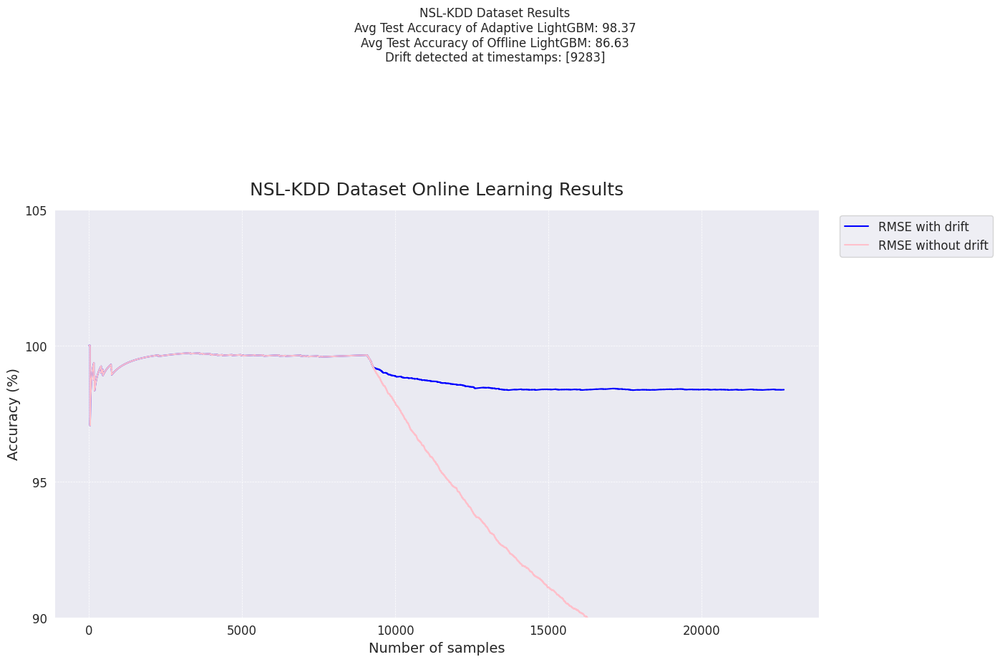

<Figure size 640x480 with 0 Axes>

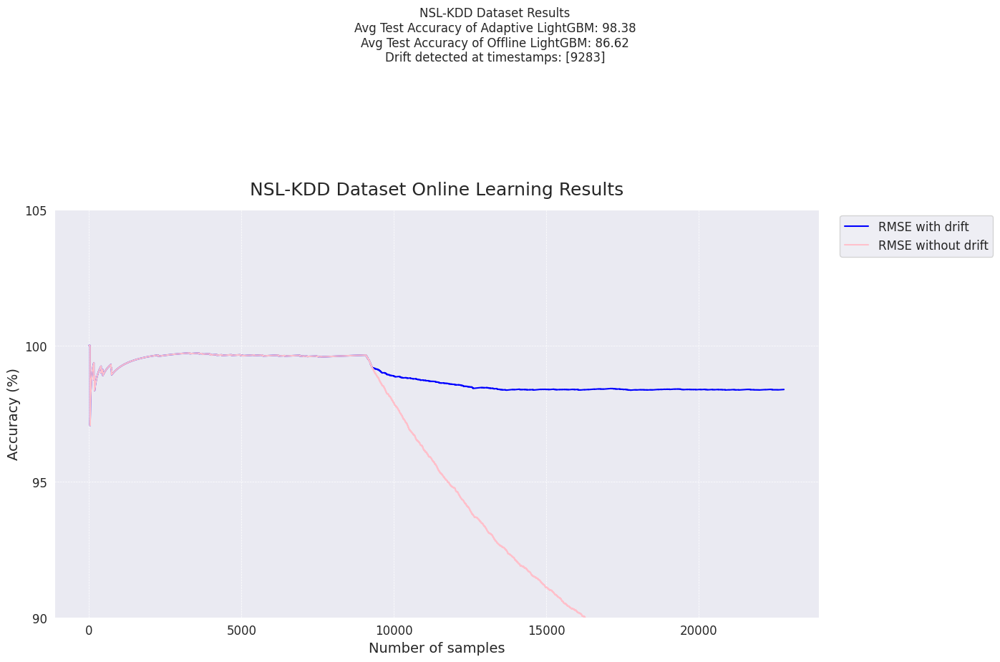

<Figure size 640x480 with 0 Axes>

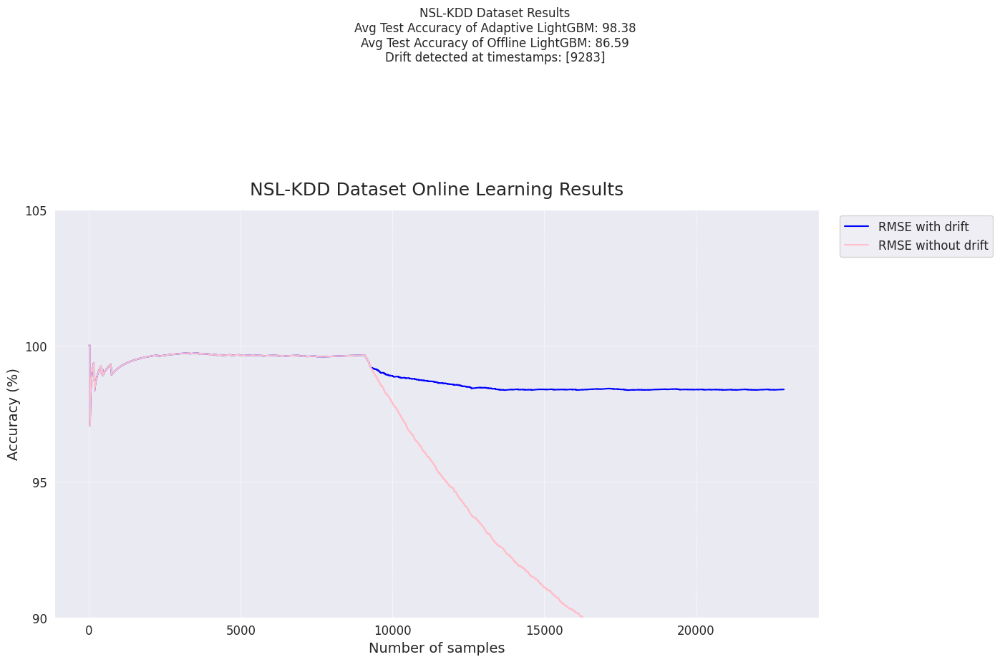

<Figure size 640x480 with 0 Axes>

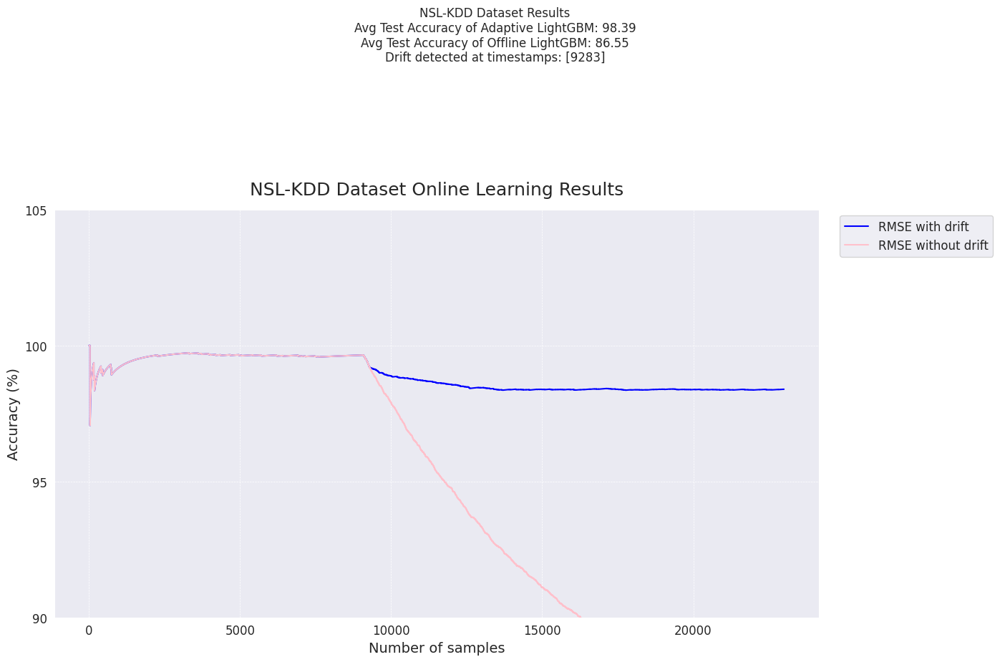

<Figure size 640x480 with 0 Axes>

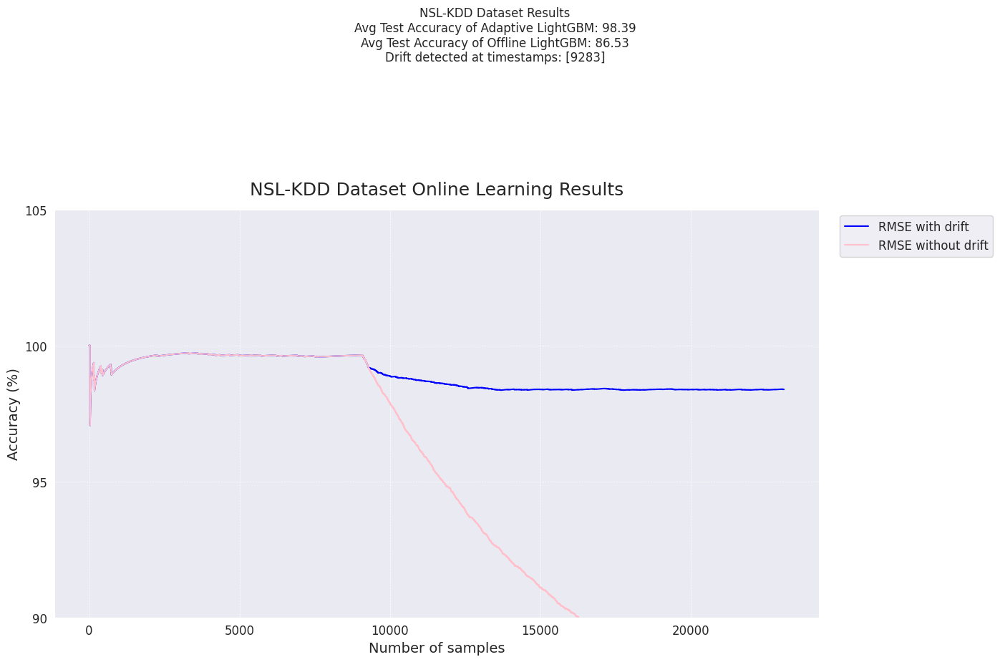

<Figure size 640x480 with 0 Axes>

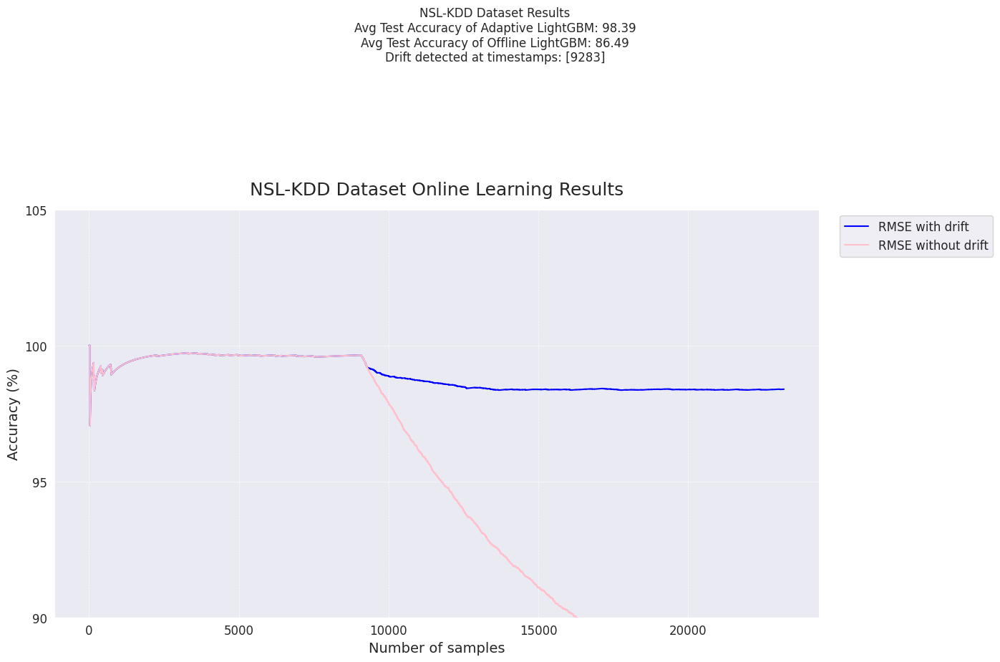

<Figure size 640x480 with 0 Axes>

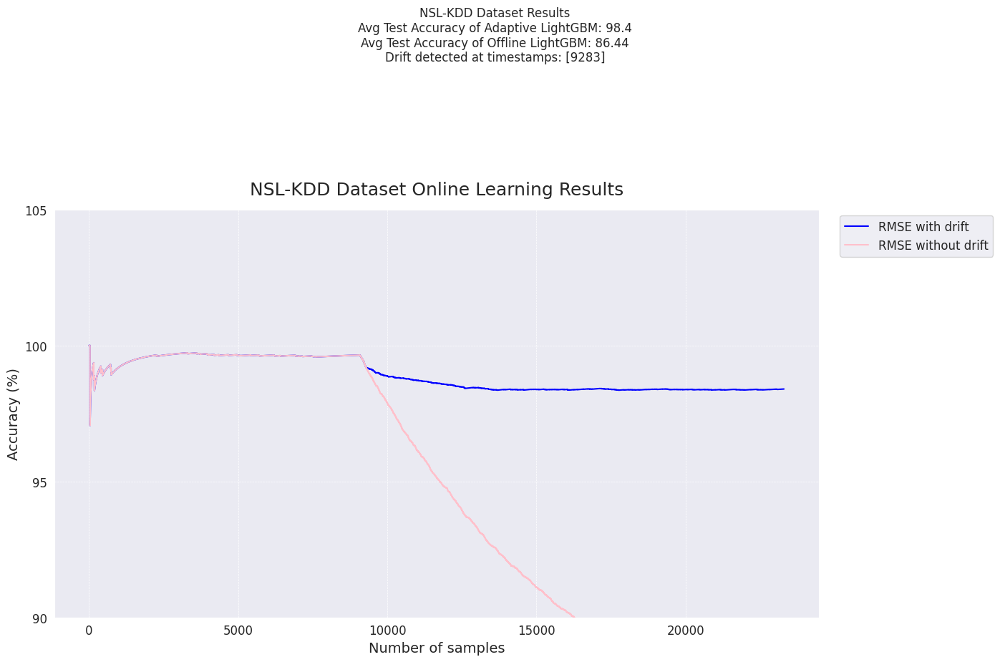

<Figure size 640x480 with 0 Axes>

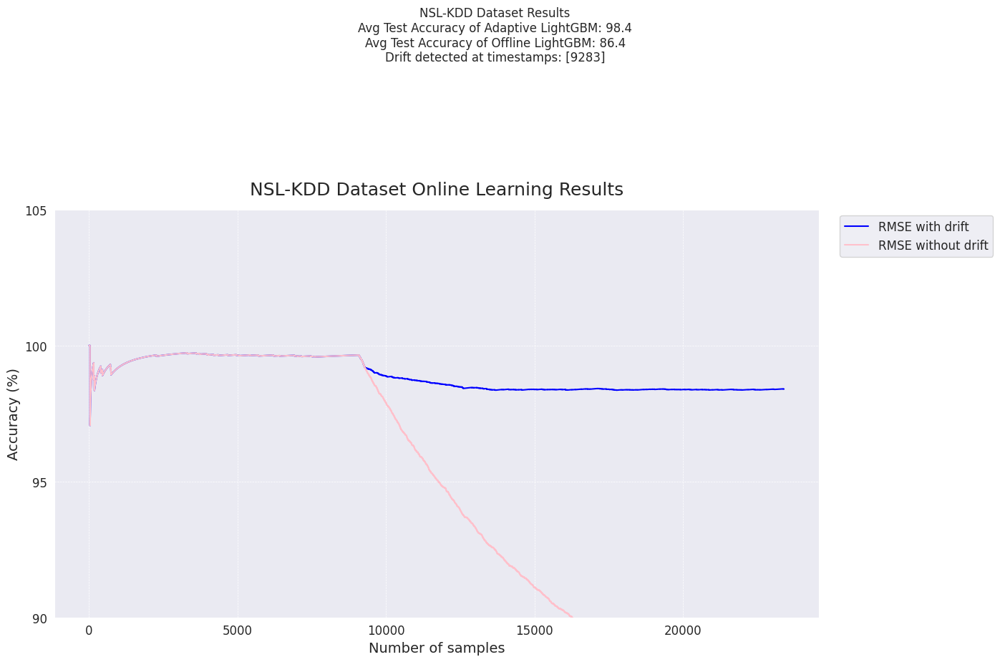

<Figure size 640x480 with 0 Axes>

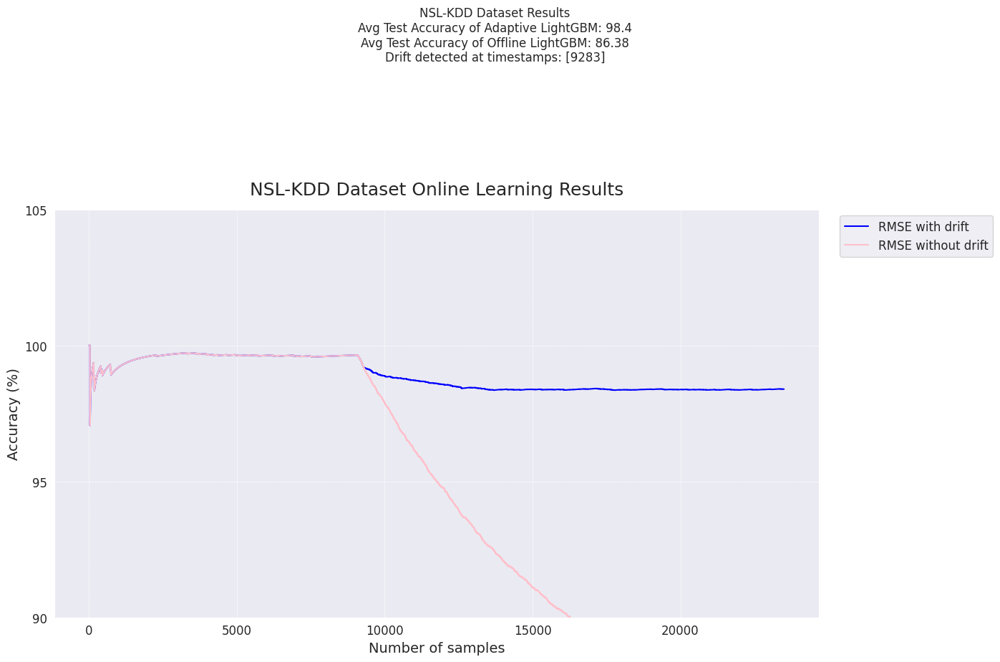

<Figure size 640x480 with 0 Axes>

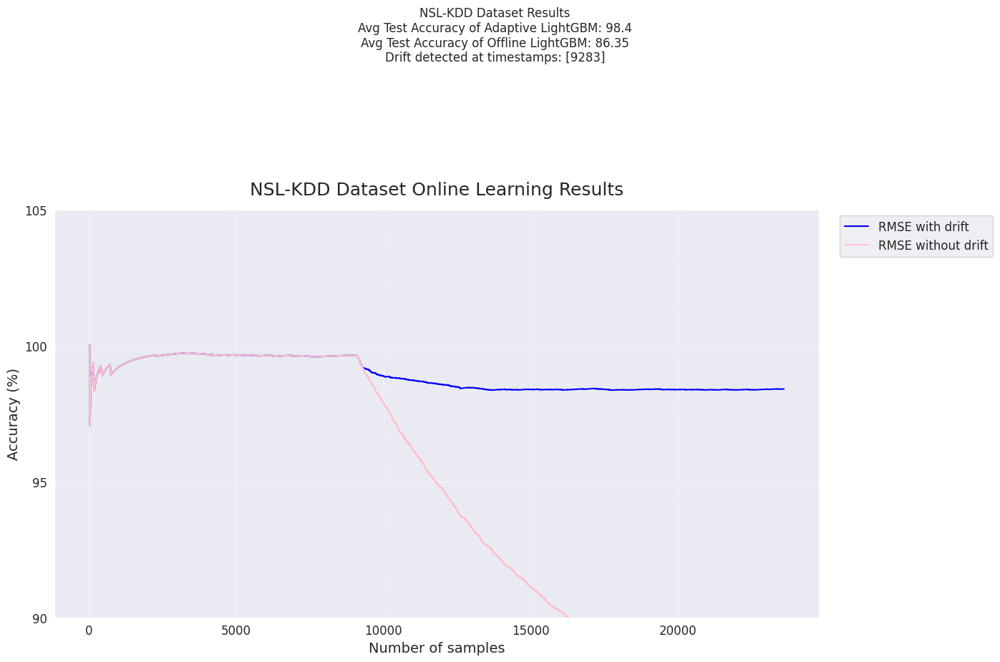

<Figure size 640x480 with 0 Axes>

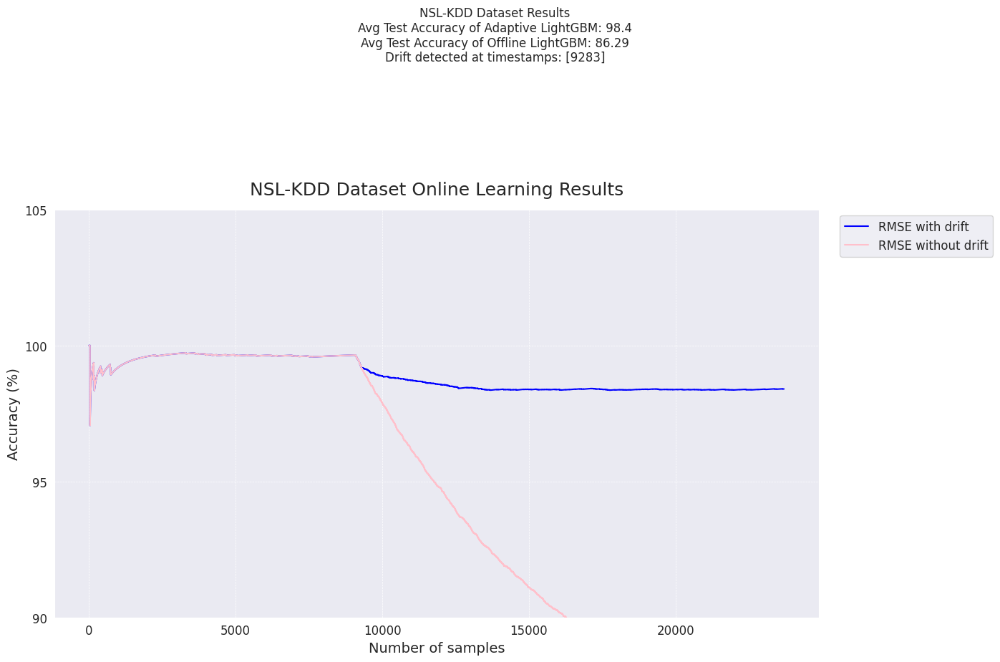

<Figure size 640x480 with 0 Axes>

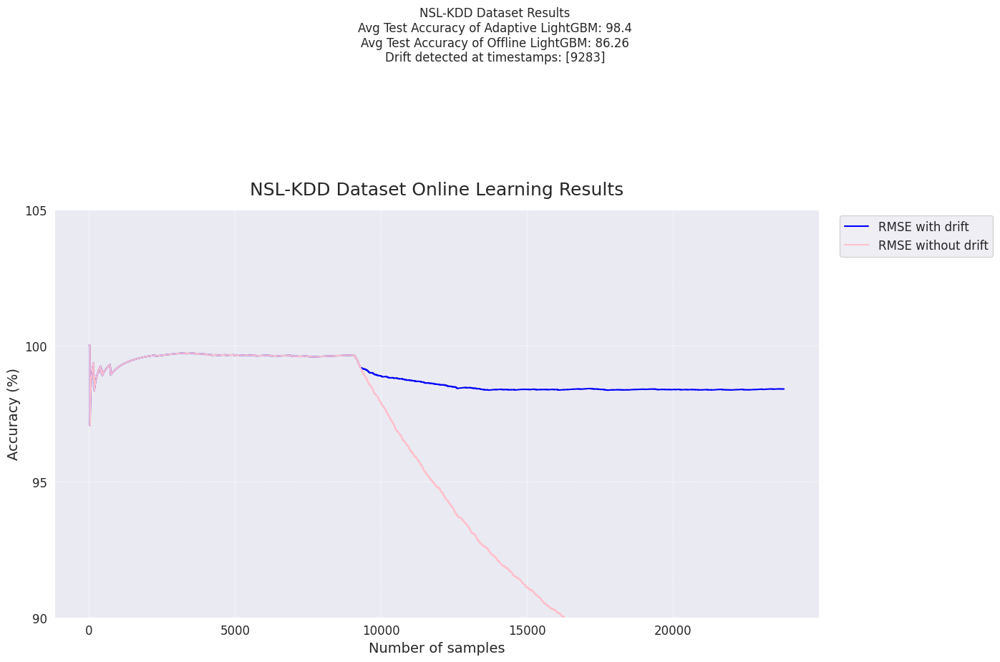

<Figure size 640x480 with 0 Axes>

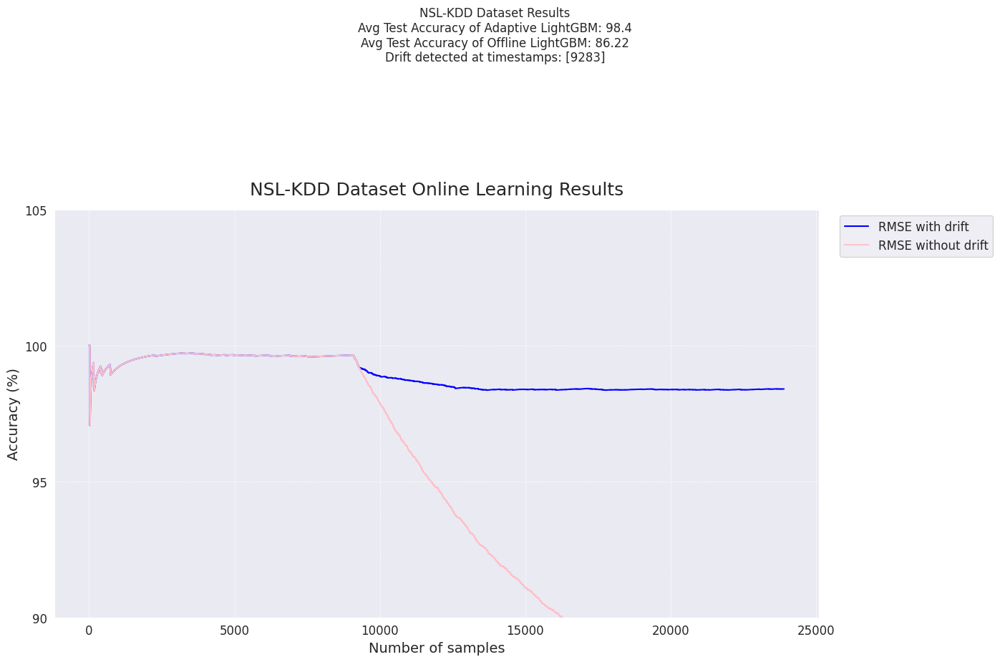

<Figure size 640x480 with 0 Axes>

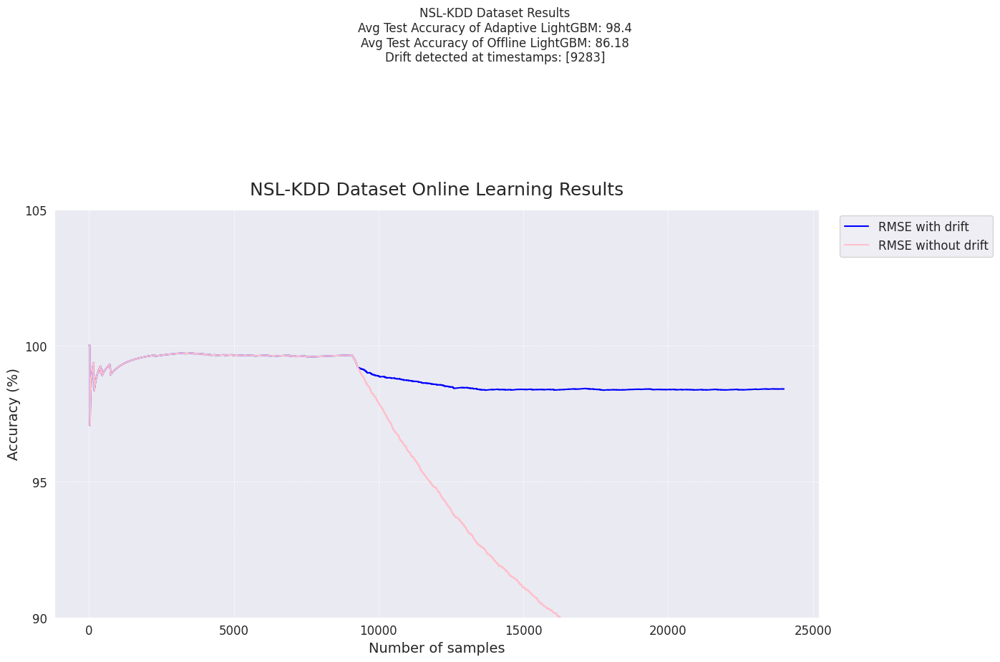

<Figure size 640x480 with 0 Axes>

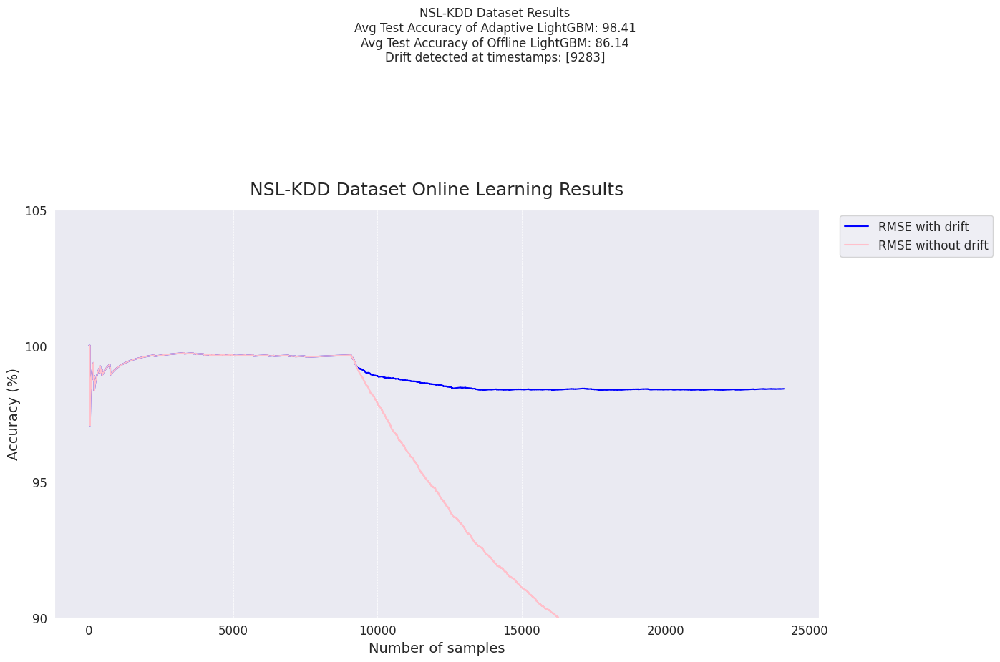

<Figure size 640x480 with 0 Axes>

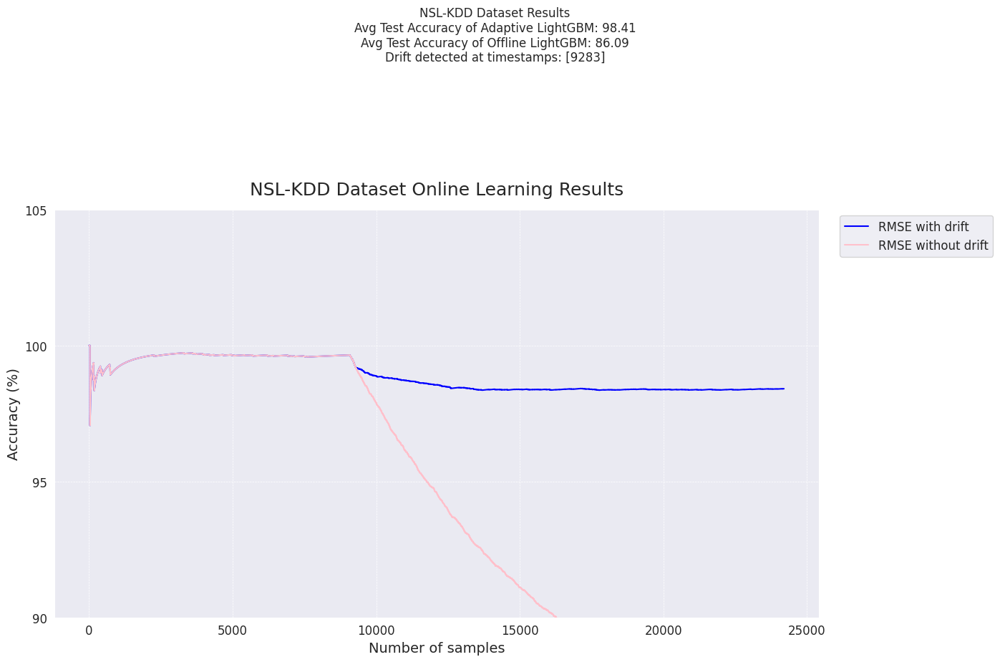

<Figure size 640x480 with 0 Axes>

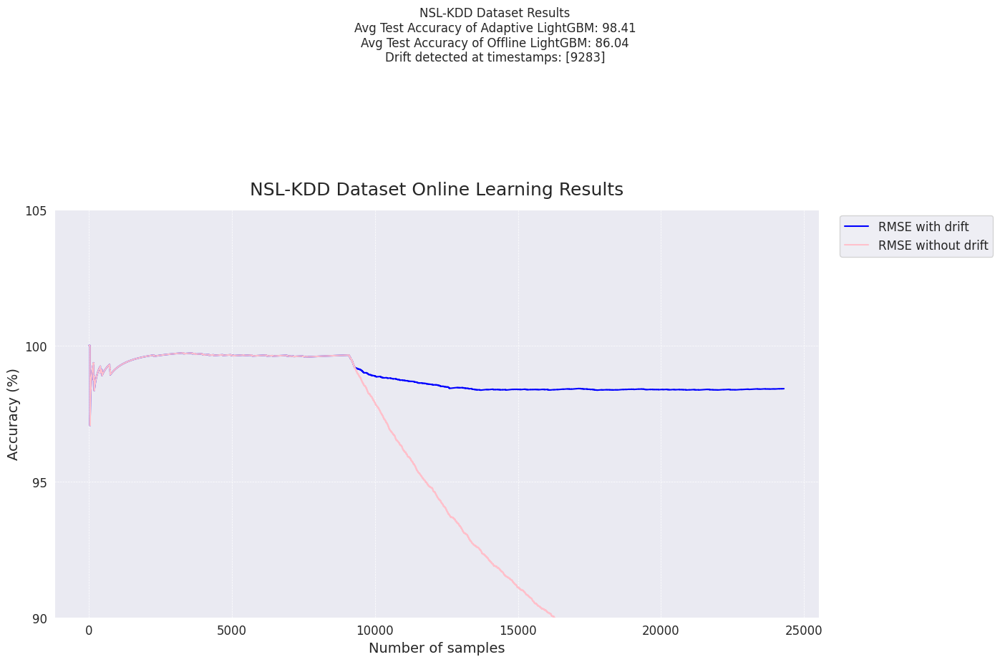

<Figure size 640x480 with 0 Axes>

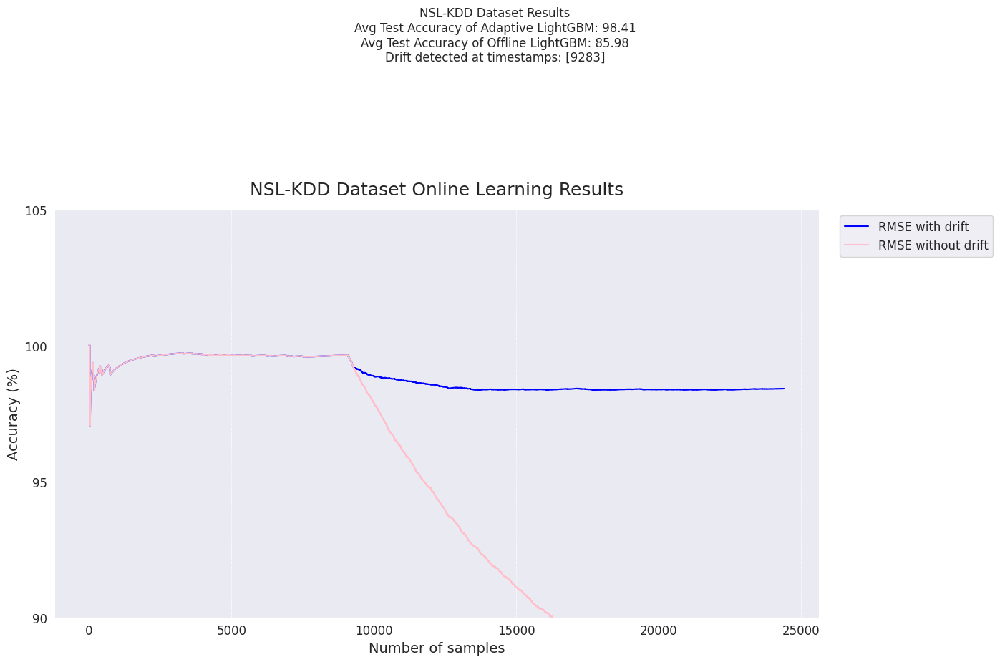

<Figure size 640x480 with 0 Axes>

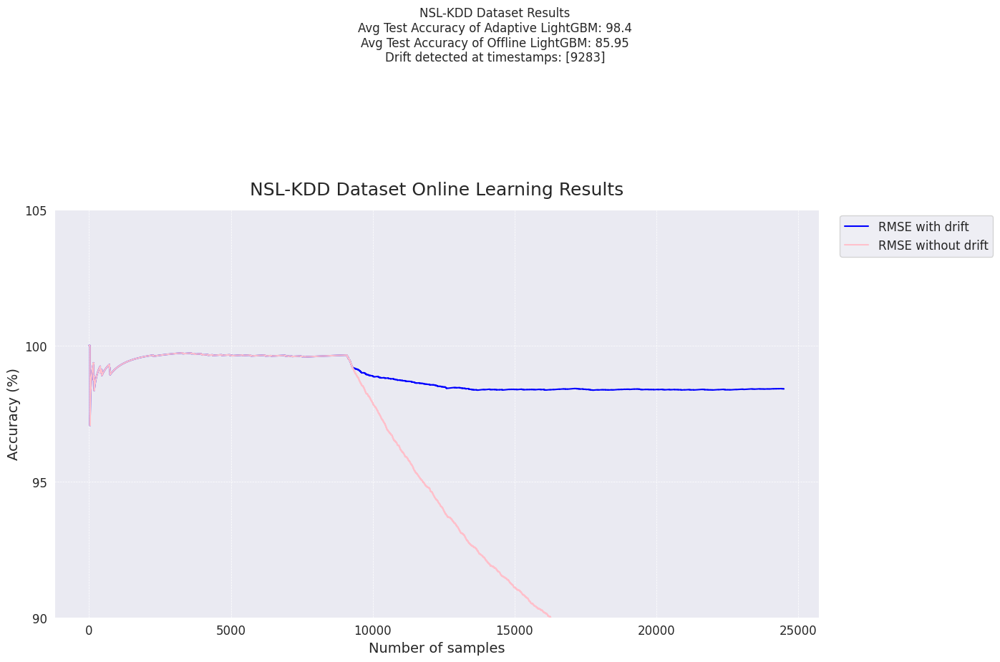

<Figure size 640x480 with 0 Axes>

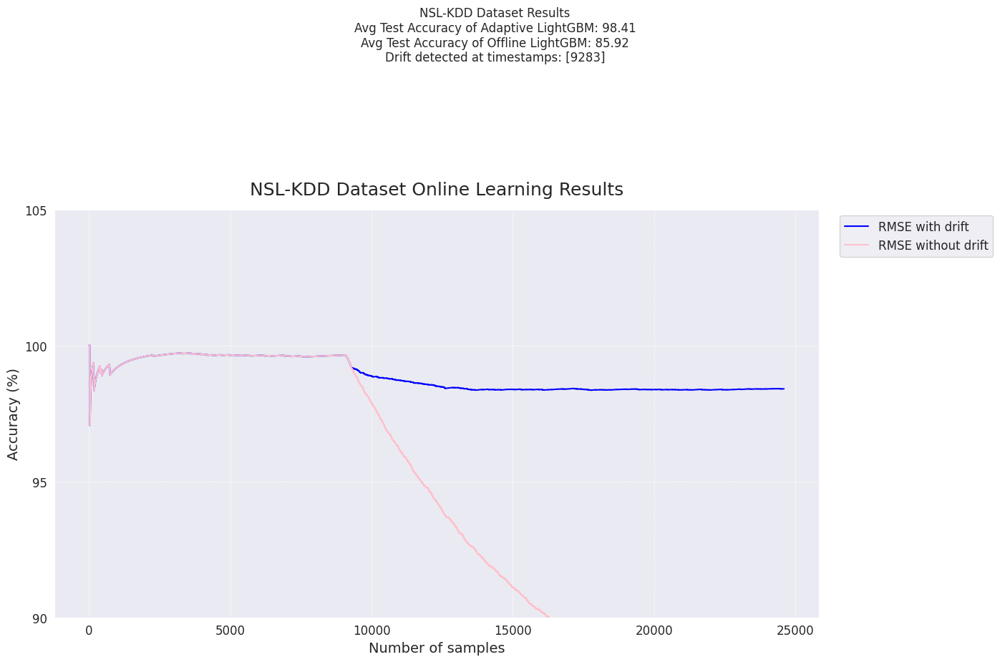

<Figure size 640x480 with 0 Axes>

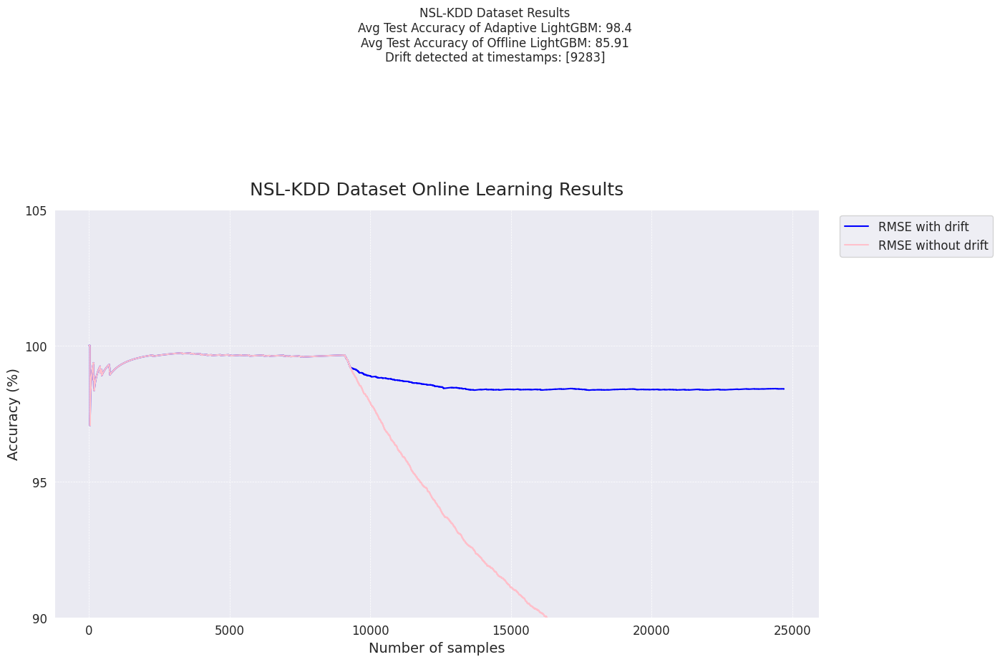

<Figure size 640x480 with 0 Axes>

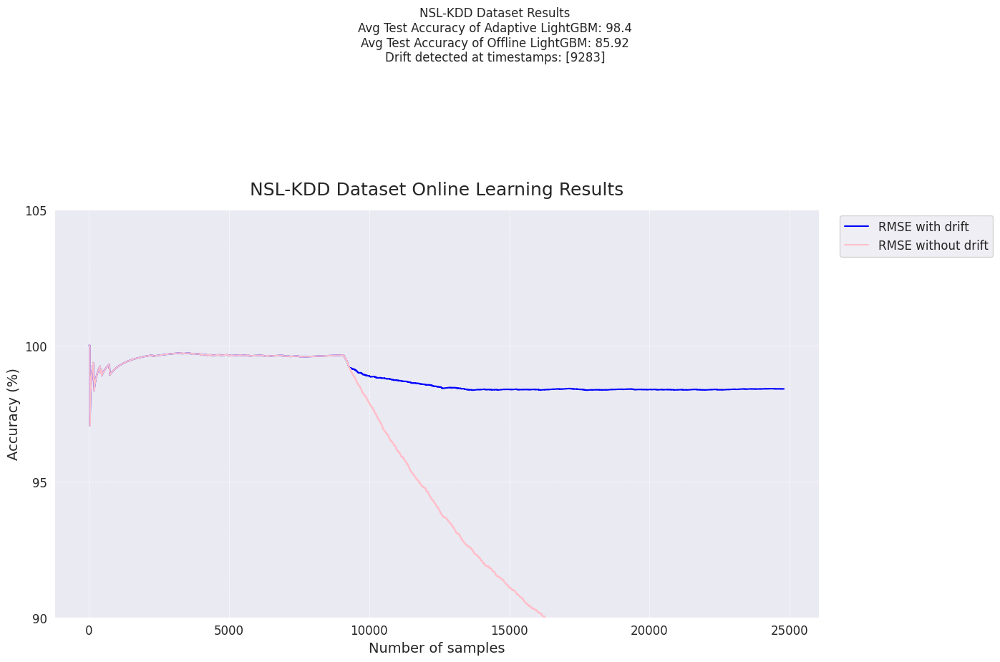

<Figure size 640x480 with 0 Axes>

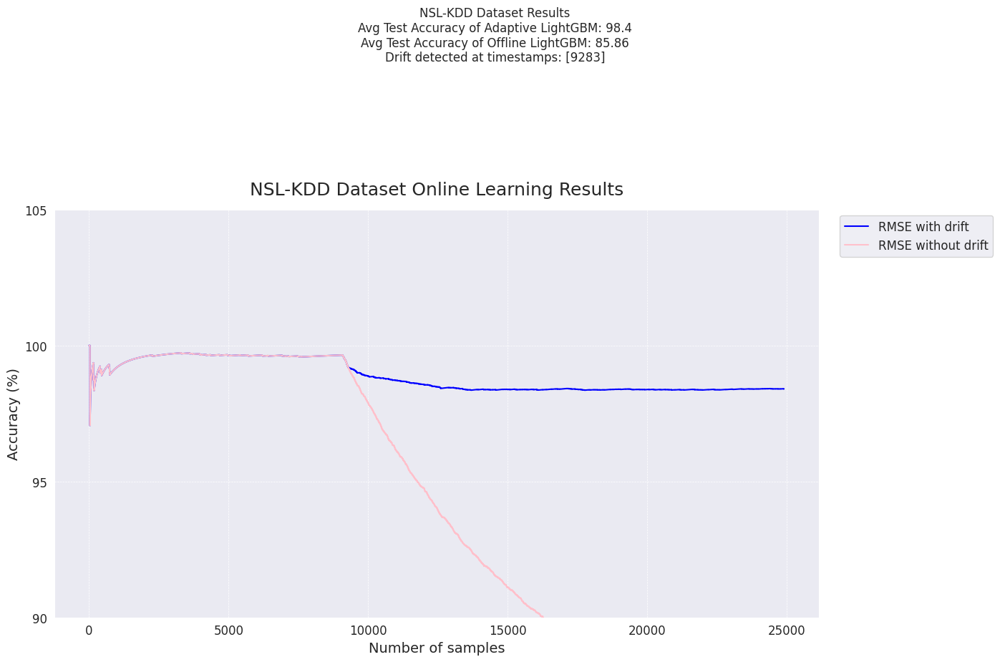

<Figure size 640x480 with 0 Axes>

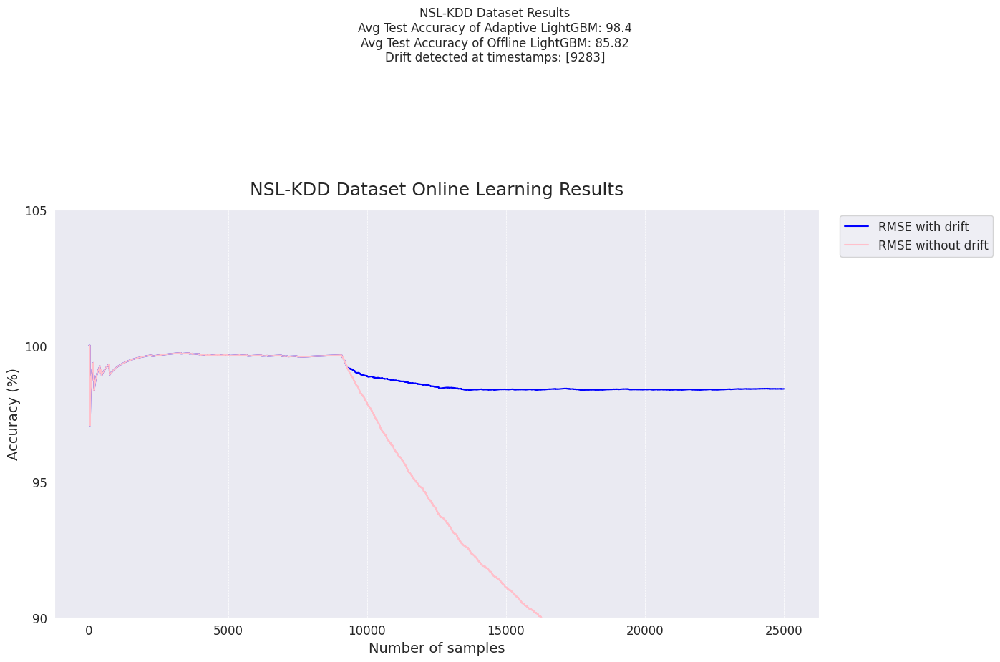

<Figure size 640x480 with 0 Axes>

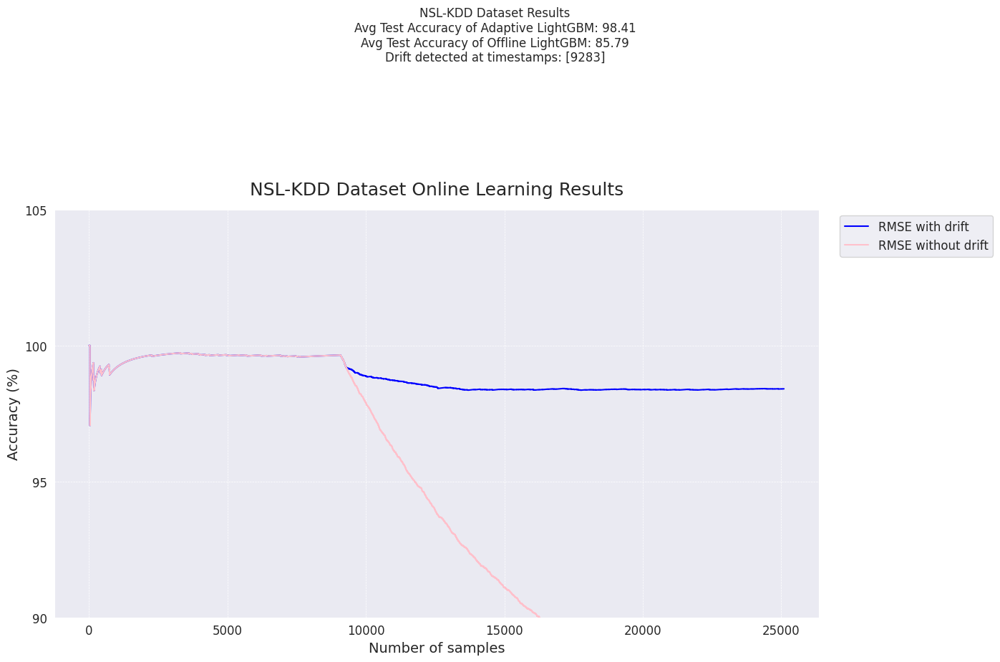

<Figure size 640x480 with 0 Axes>

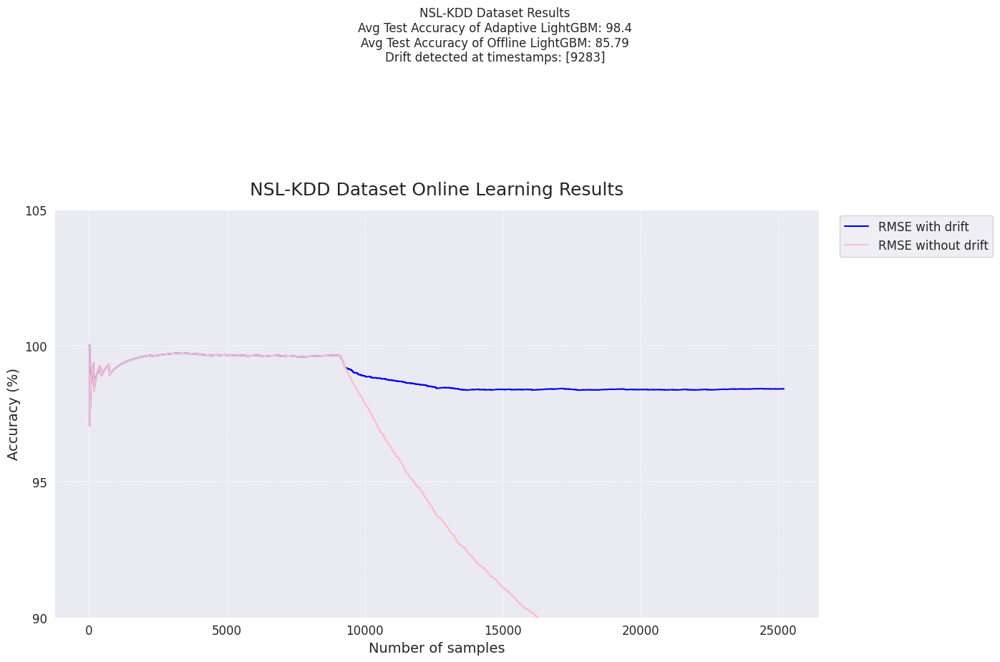

<Figure size 640x480 with 0 Axes>

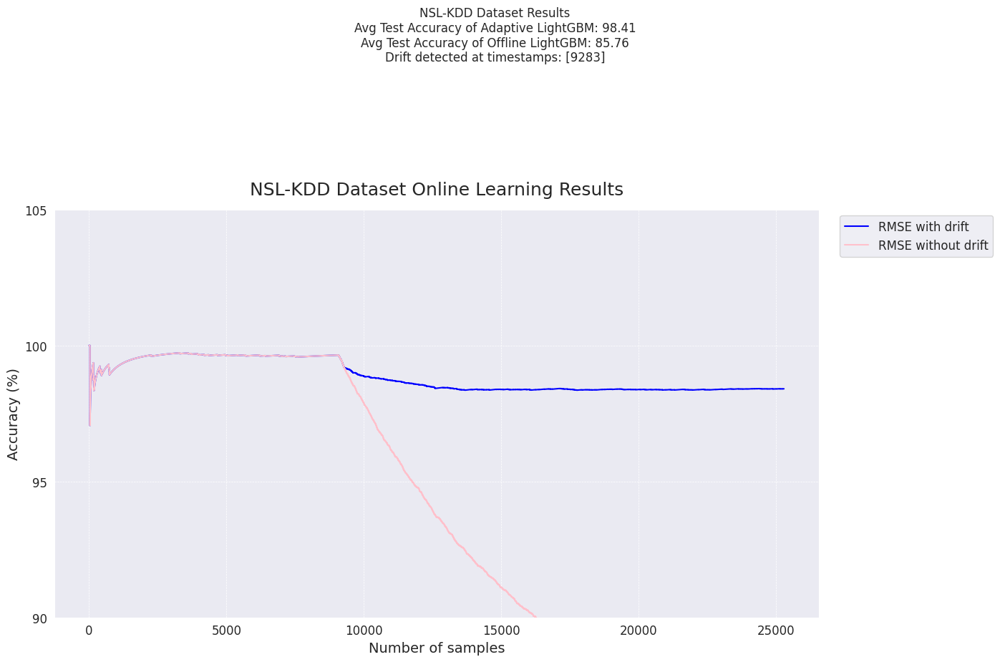

<Figure size 640x480 with 0 Axes>

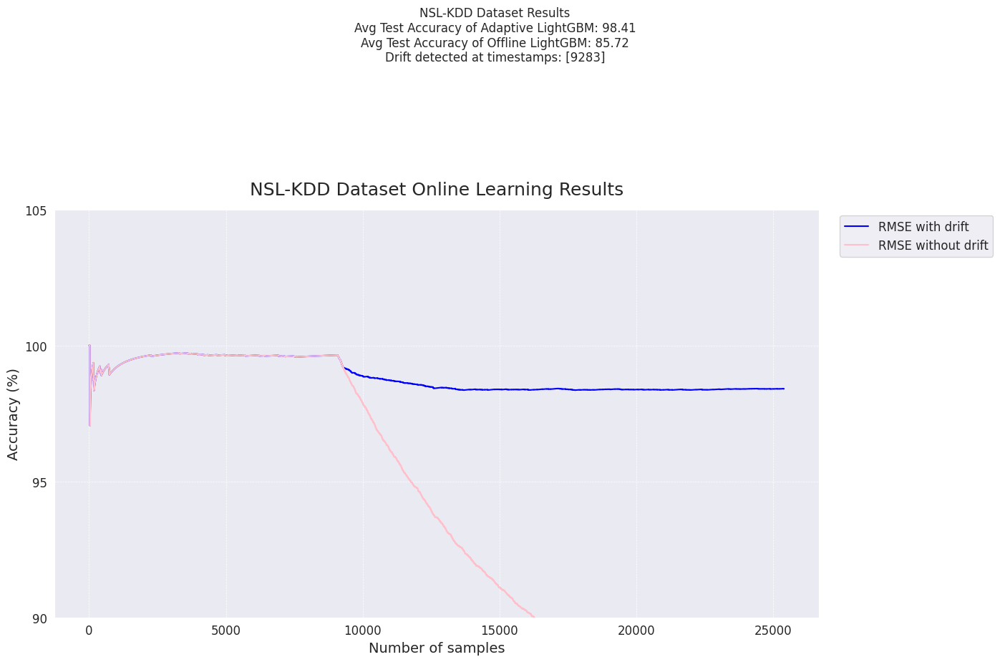

<Figure size 640x480 with 0 Axes>

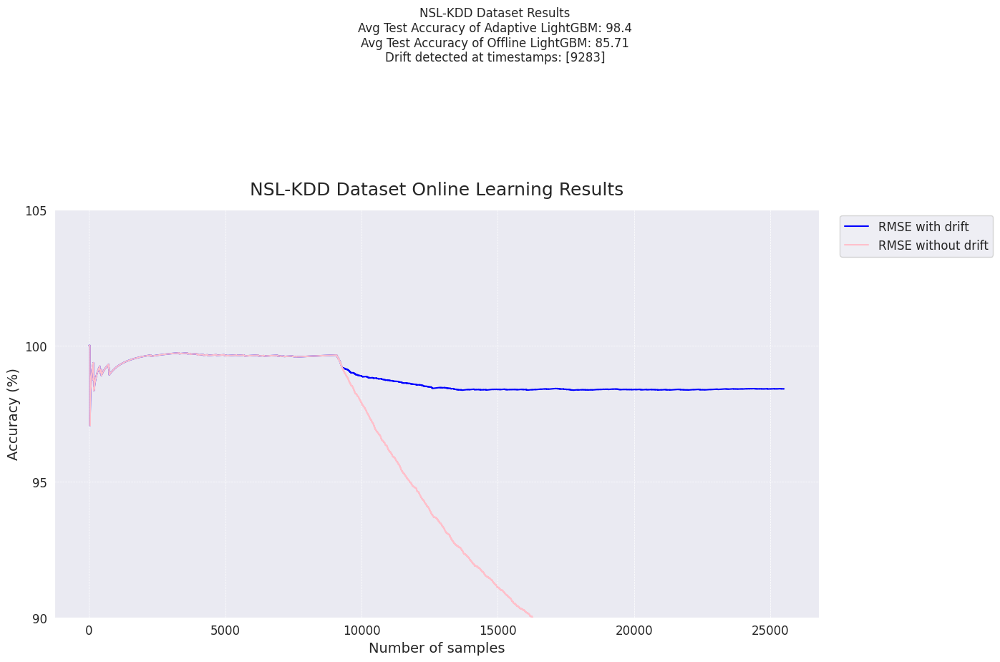

<Figure size 640x480 with 0 Axes>

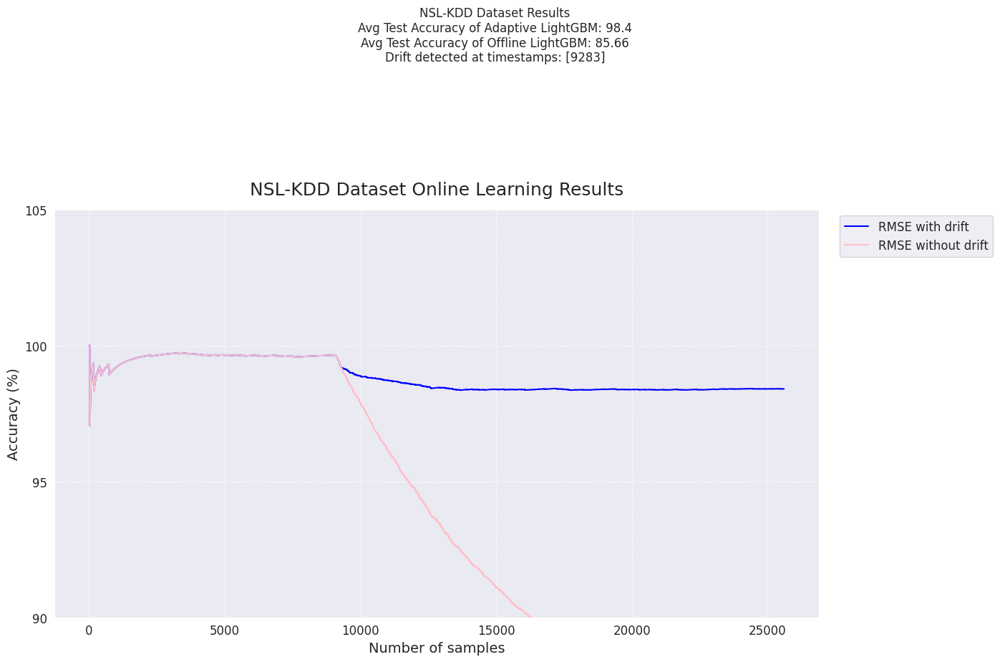

<Figure size 640x480 with 0 Axes>

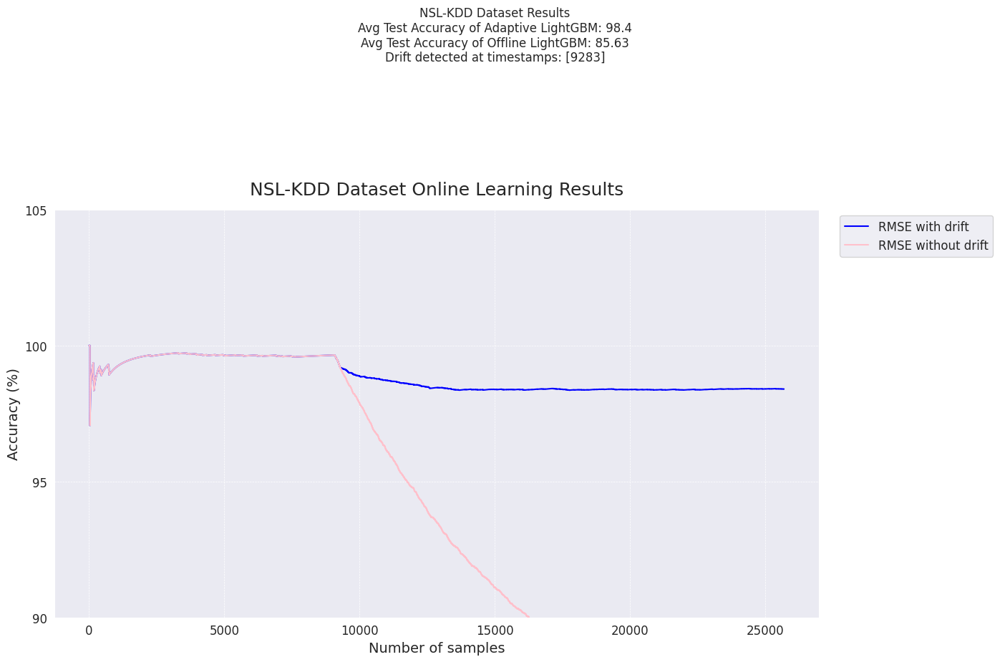

<Figure size 640x480 with 0 Axes>

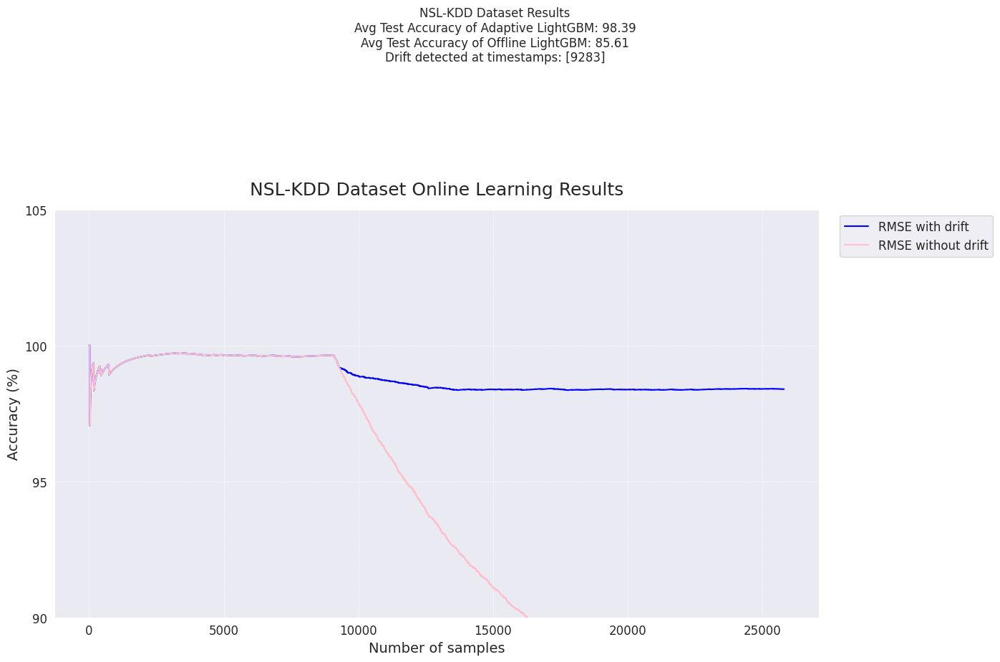

<Figure size 640x480 with 0 Axes>

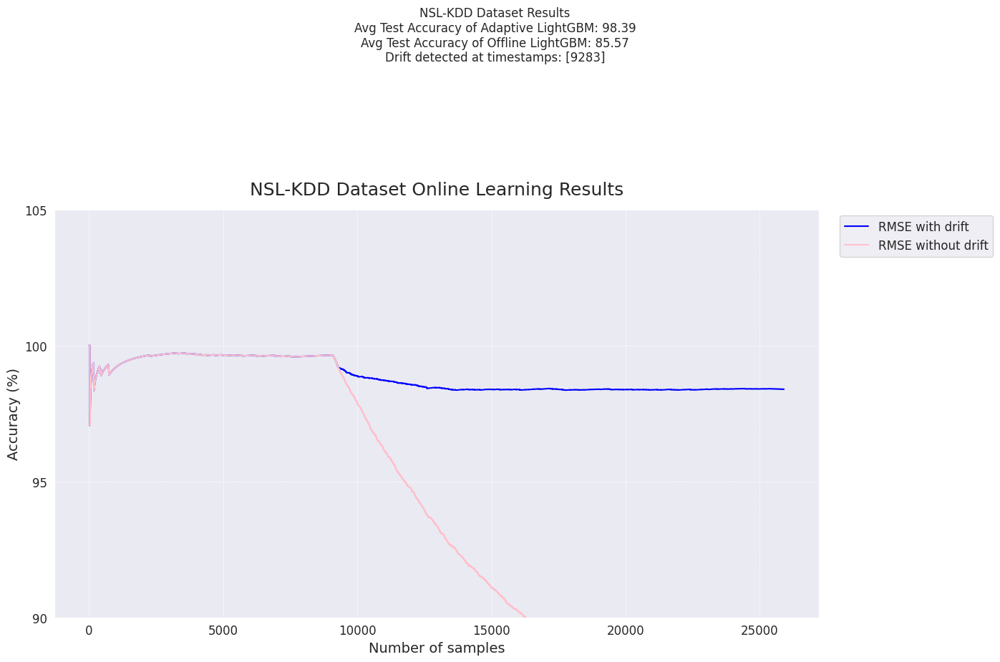

<Figure size 640x480 with 0 Axes>

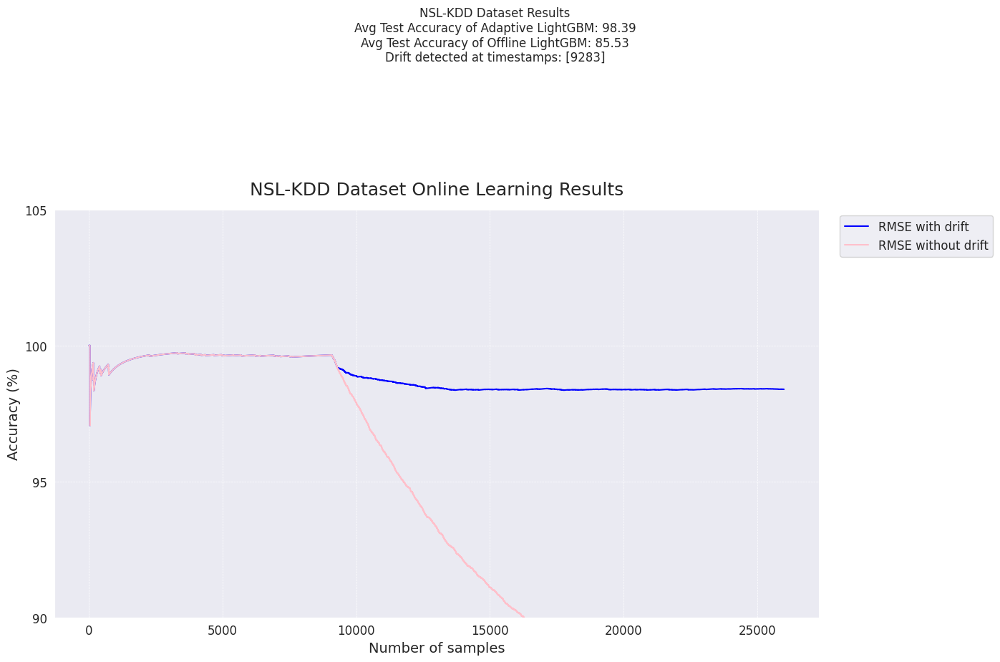

<Figure size 640x480 with 0 Axes>

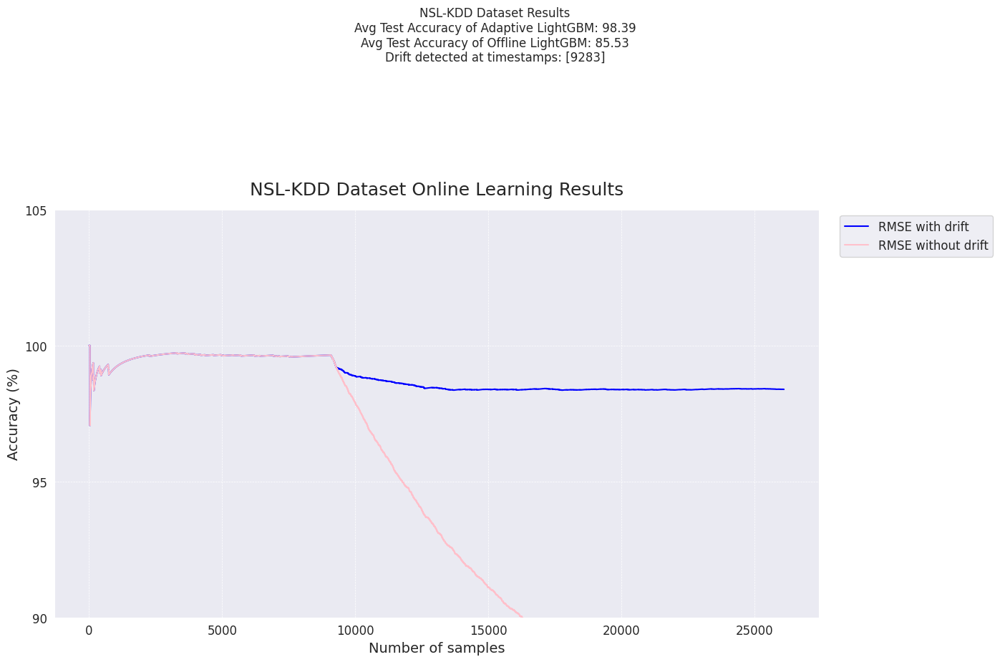

<Figure size 640x480 with 0 Axes>

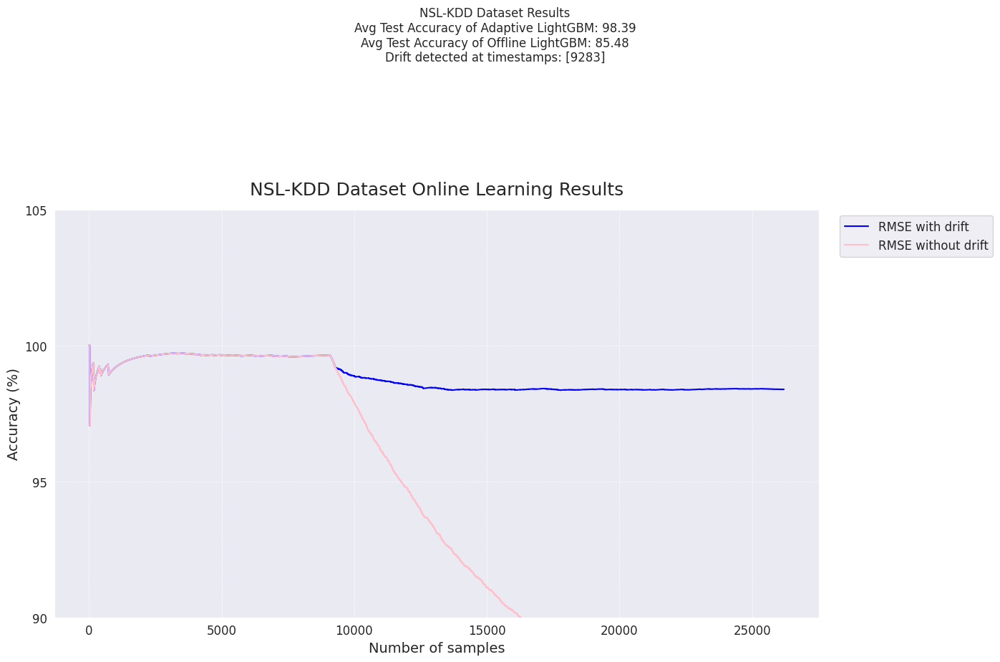

<Figure size 640x480 with 0 Axes>

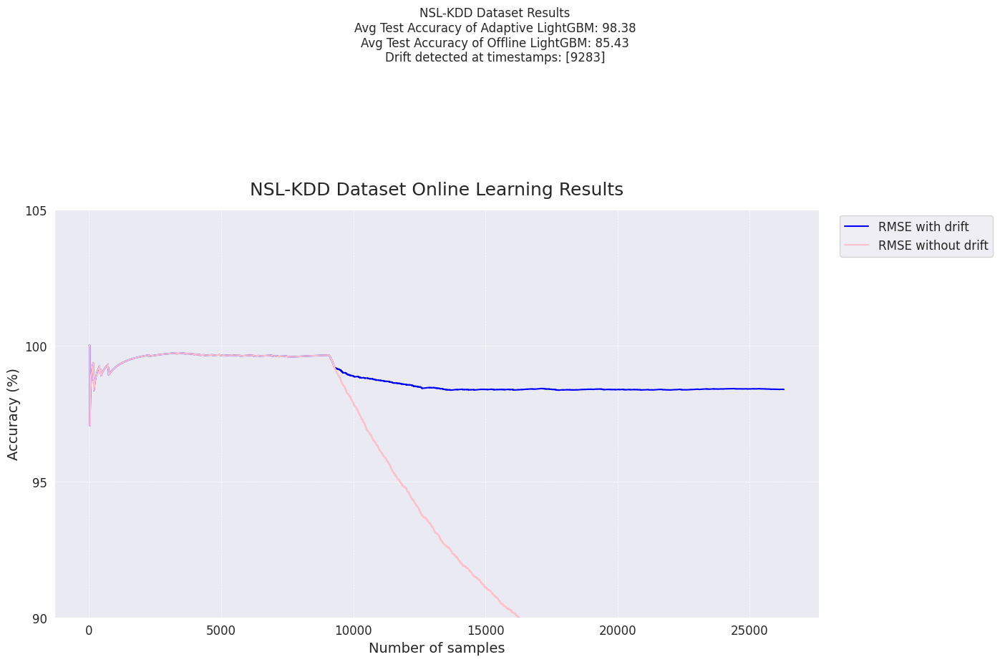

<Figure size 640x480 with 0 Axes>

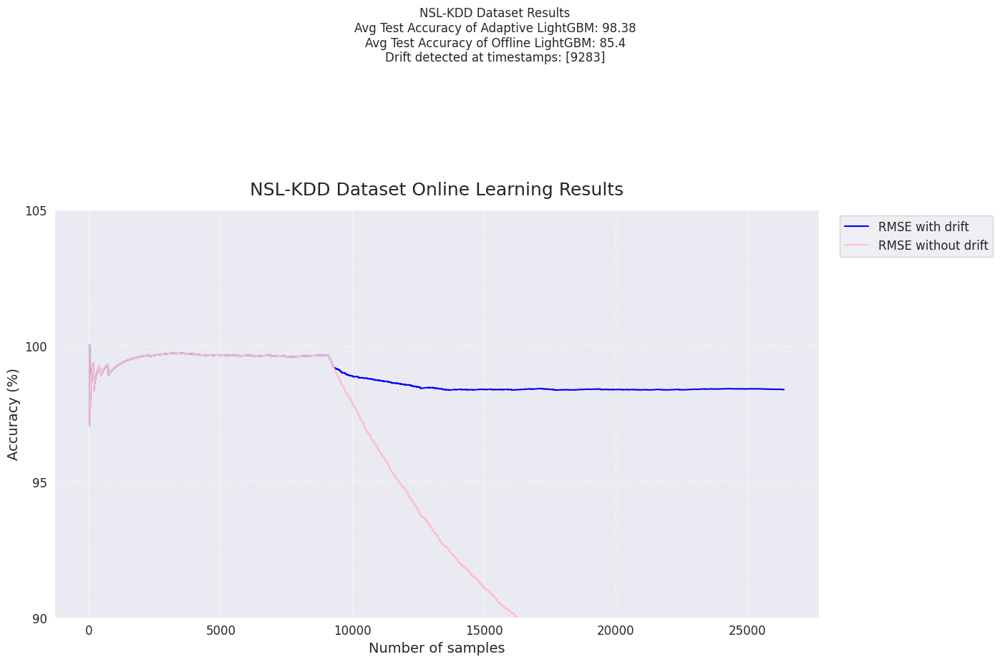

<Figure size 640x480 with 0 Axes>

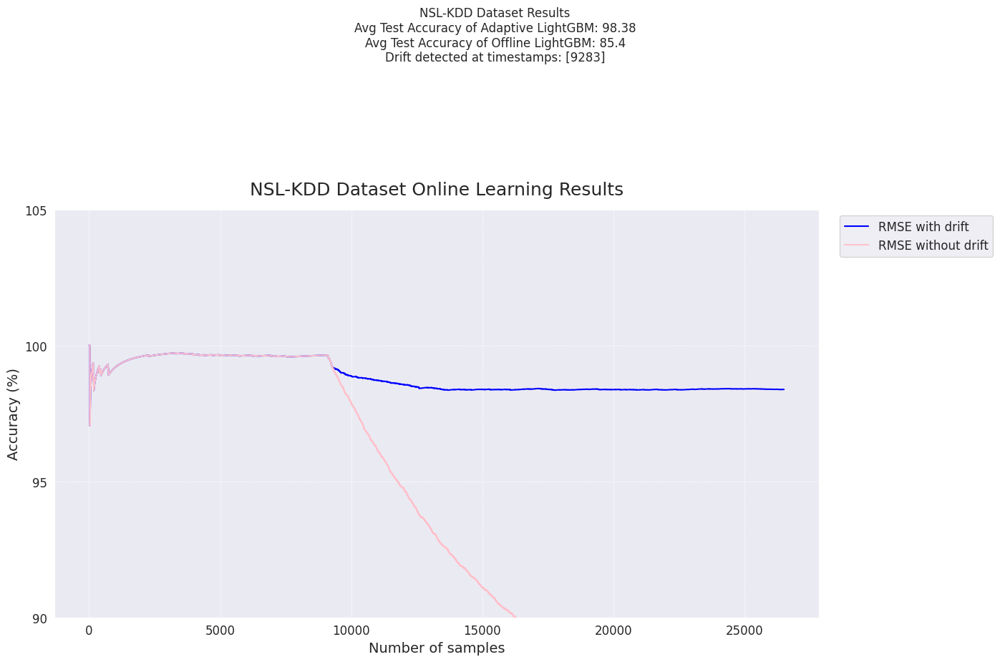

<Figure size 640x480 with 0 Axes>

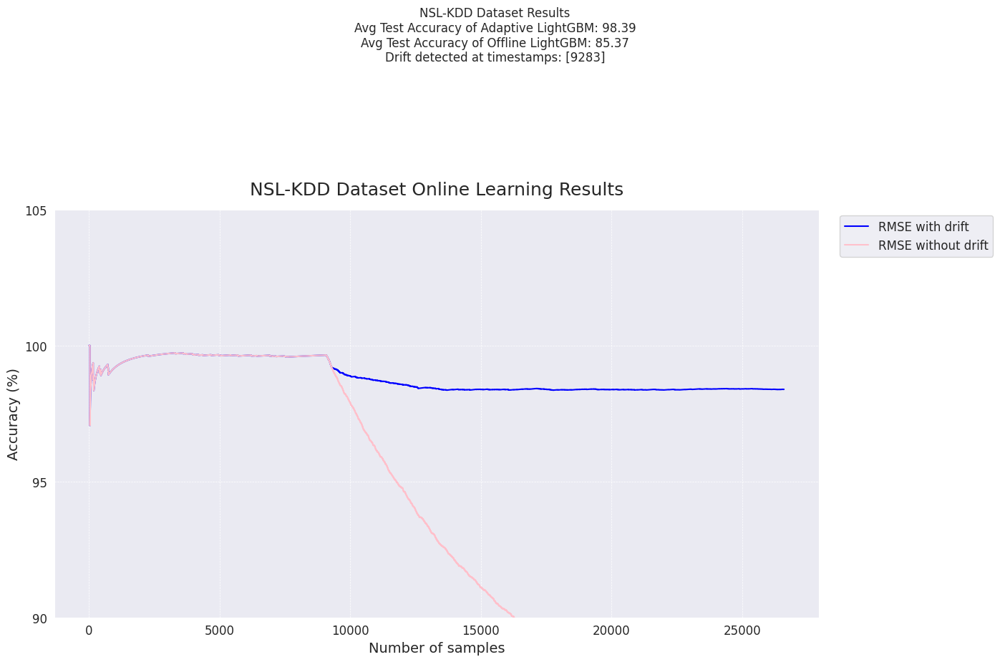

<Figure size 640x480 with 0 Axes>

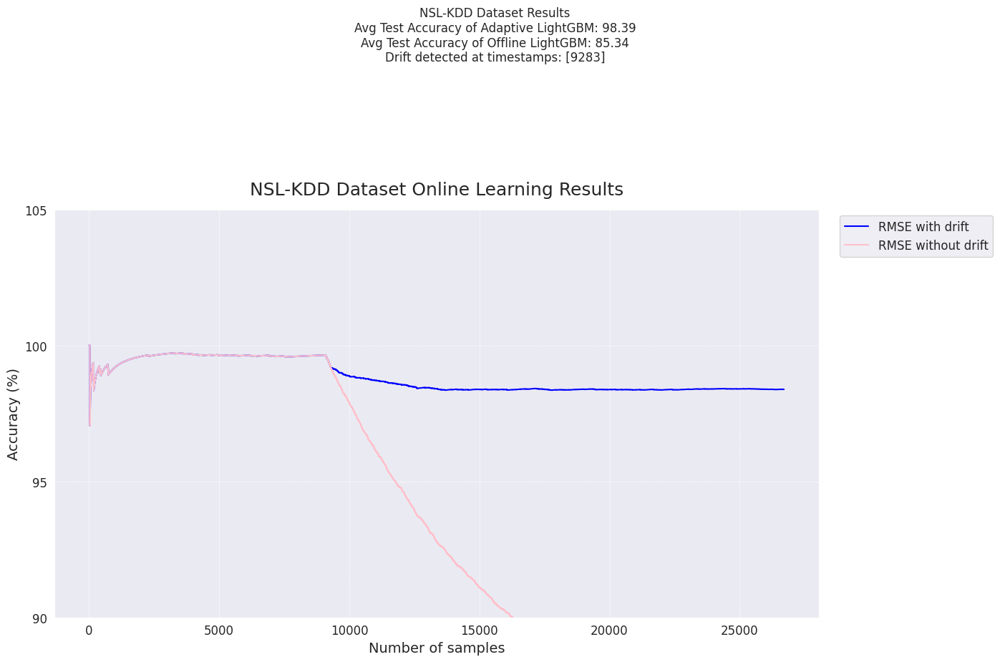

<Figure size 640x480 with 0 Axes>

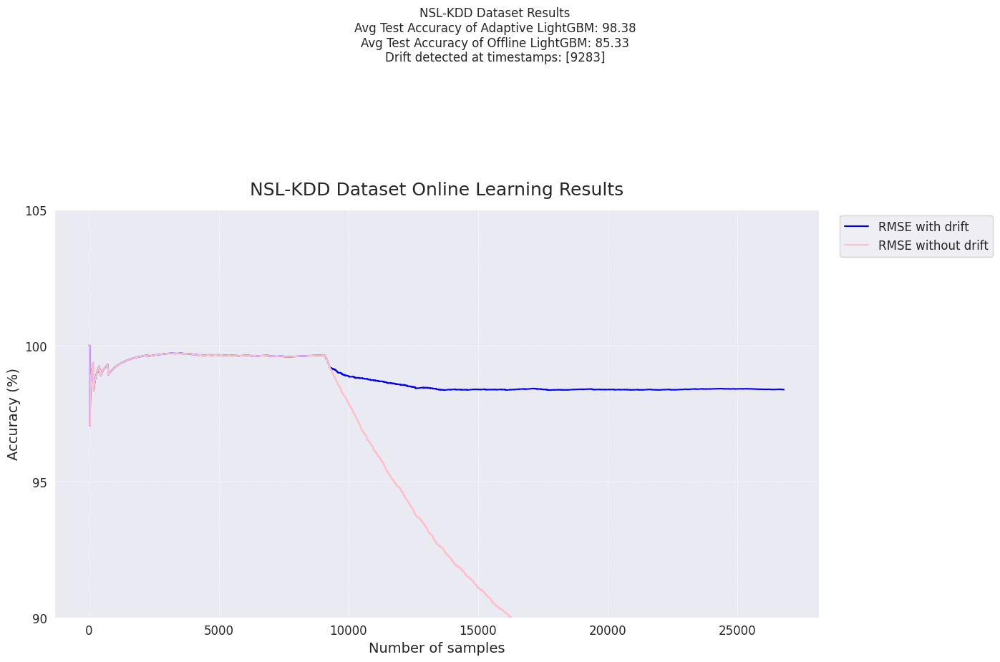

<Figure size 640x480 with 0 Axes>

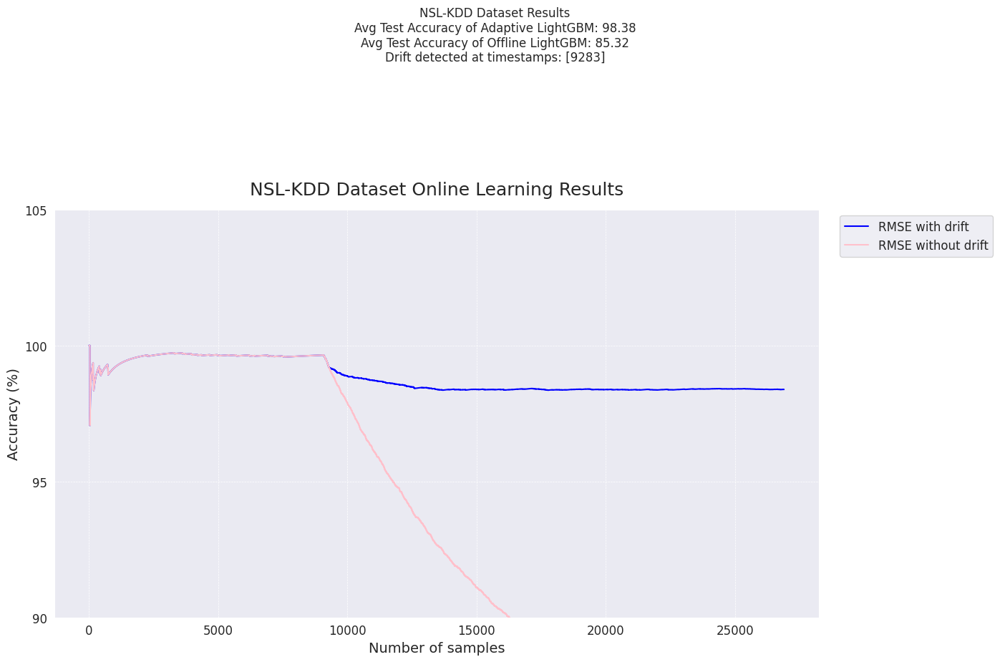

<Figure size 640x480 with 0 Axes>

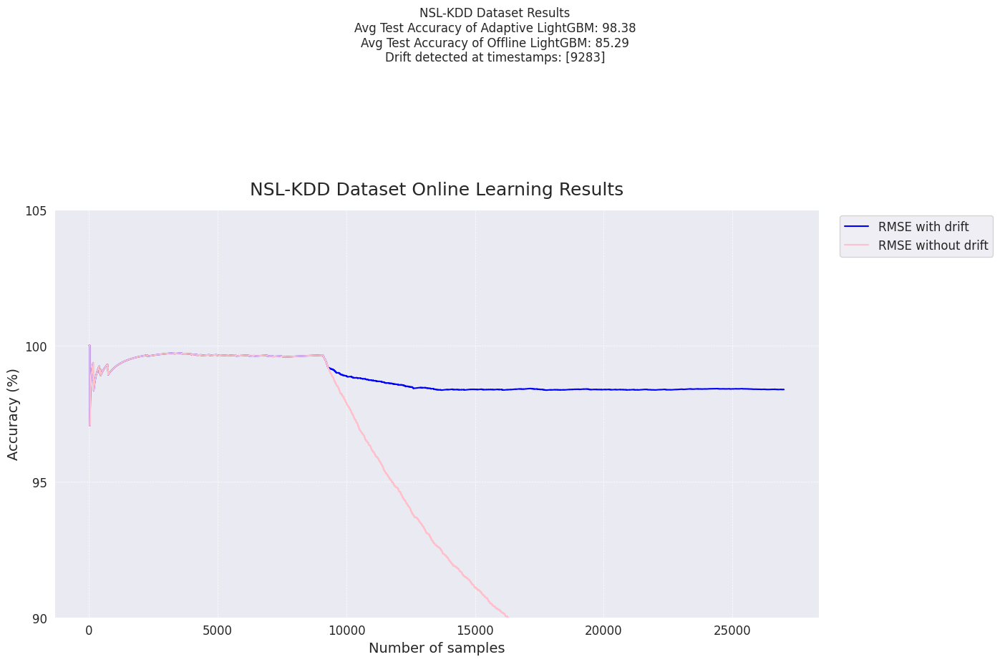

<Figure size 640x480 with 0 Axes>

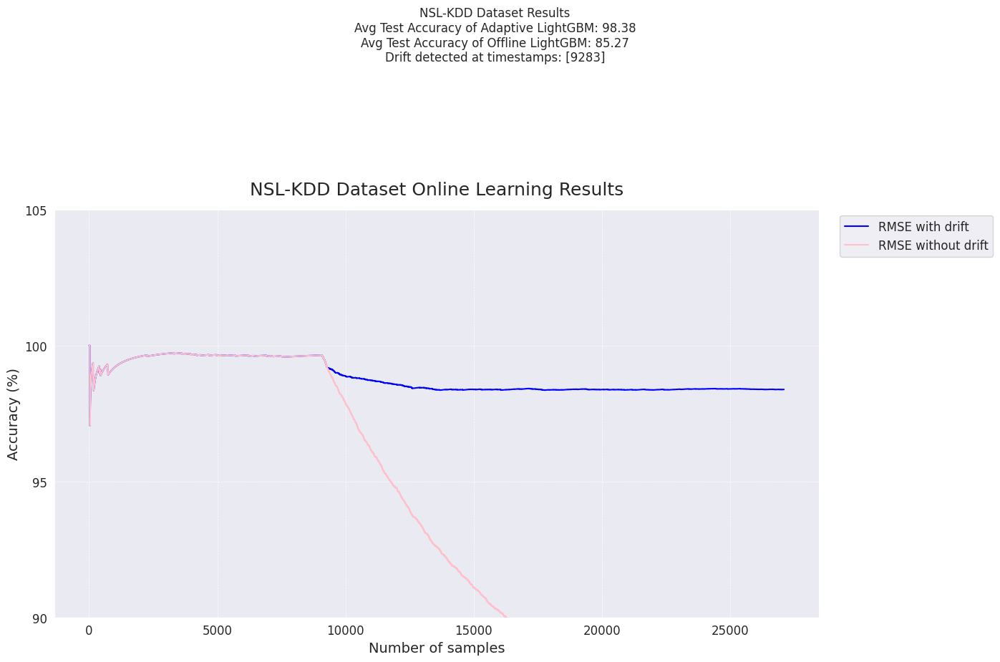

<Figure size 640x480 with 0 Axes>

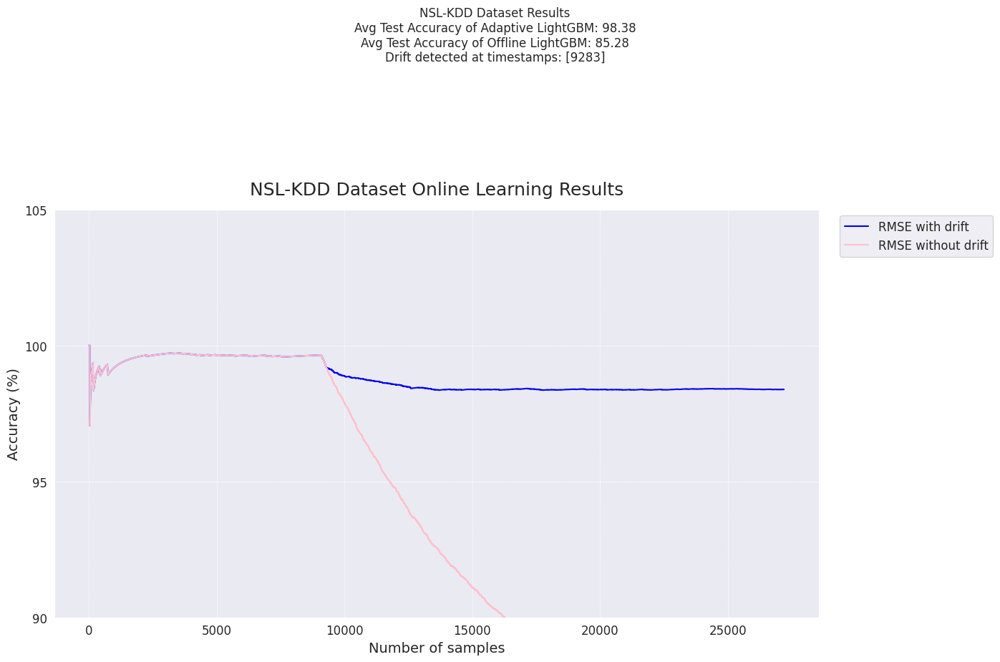

<Figure size 640x480 with 0 Axes>

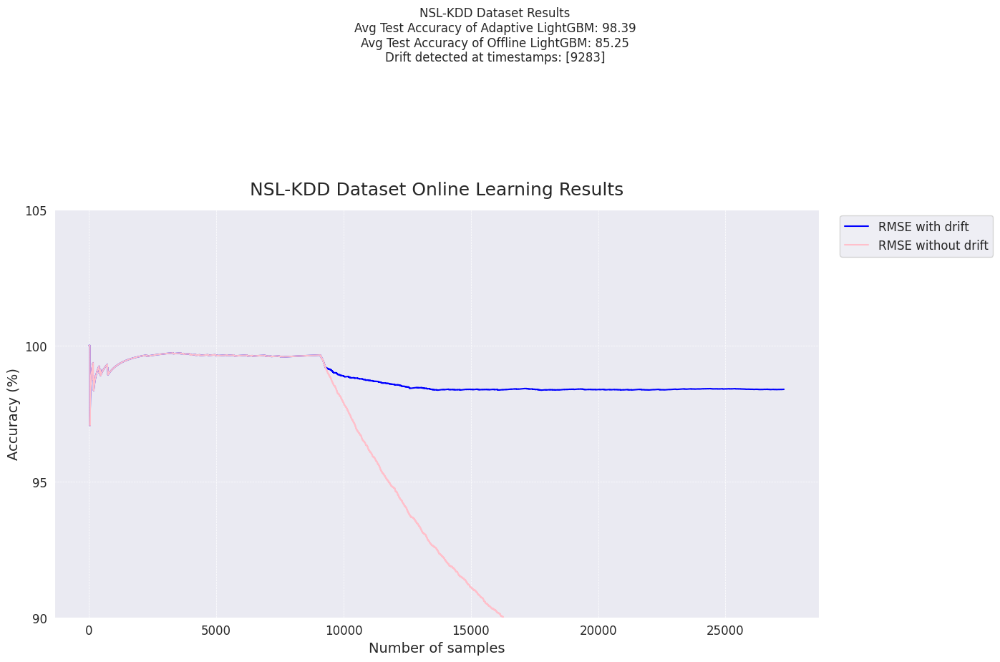

<Figure size 640x480 with 0 Axes>

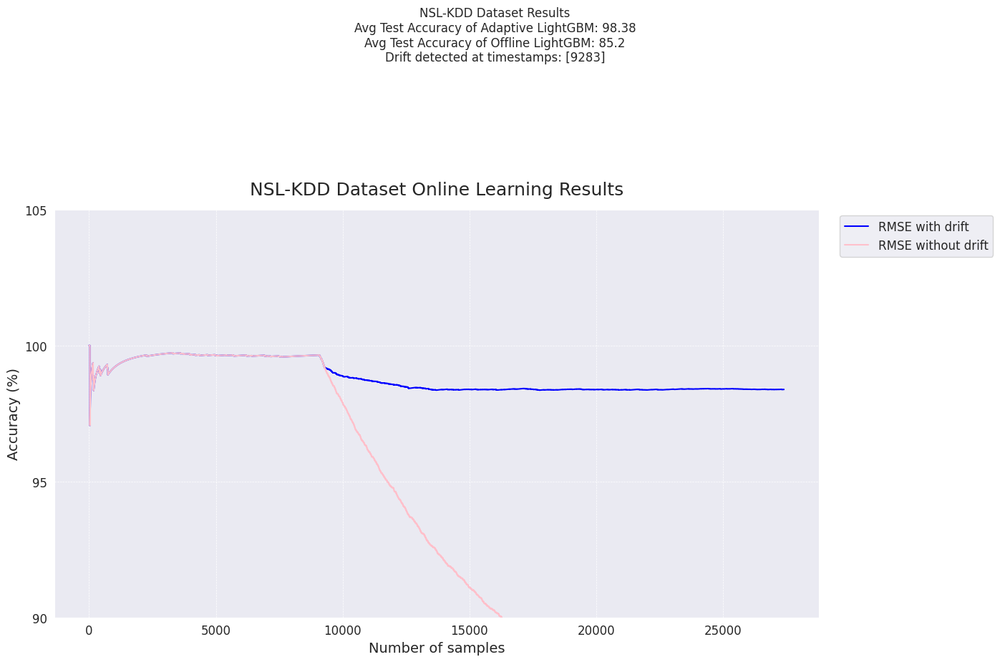

<Figure size 640x480 with 0 Axes>

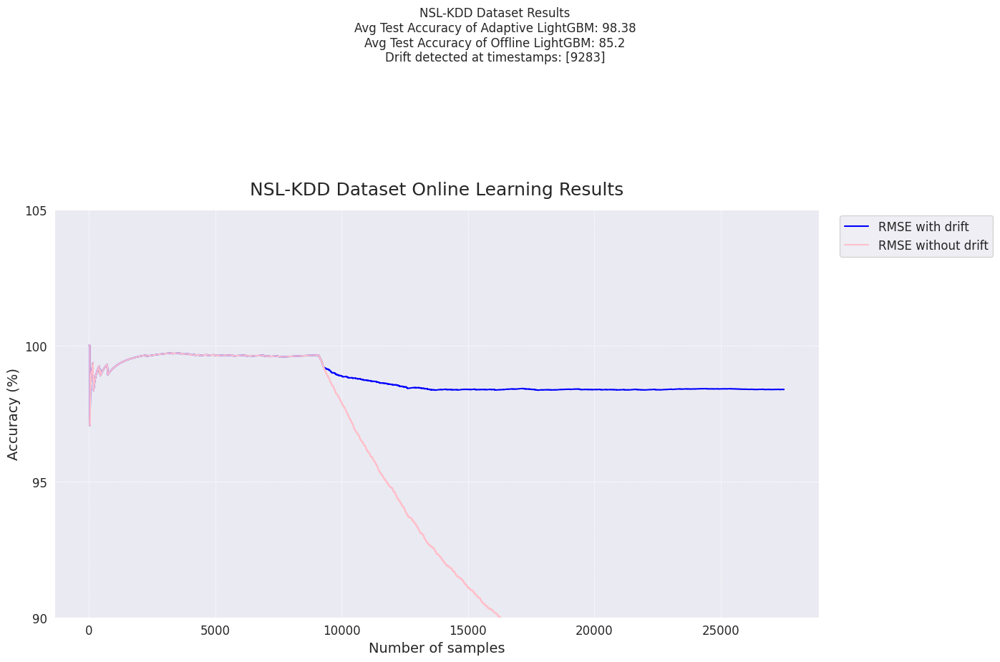

<Figure size 640x480 with 0 Axes>

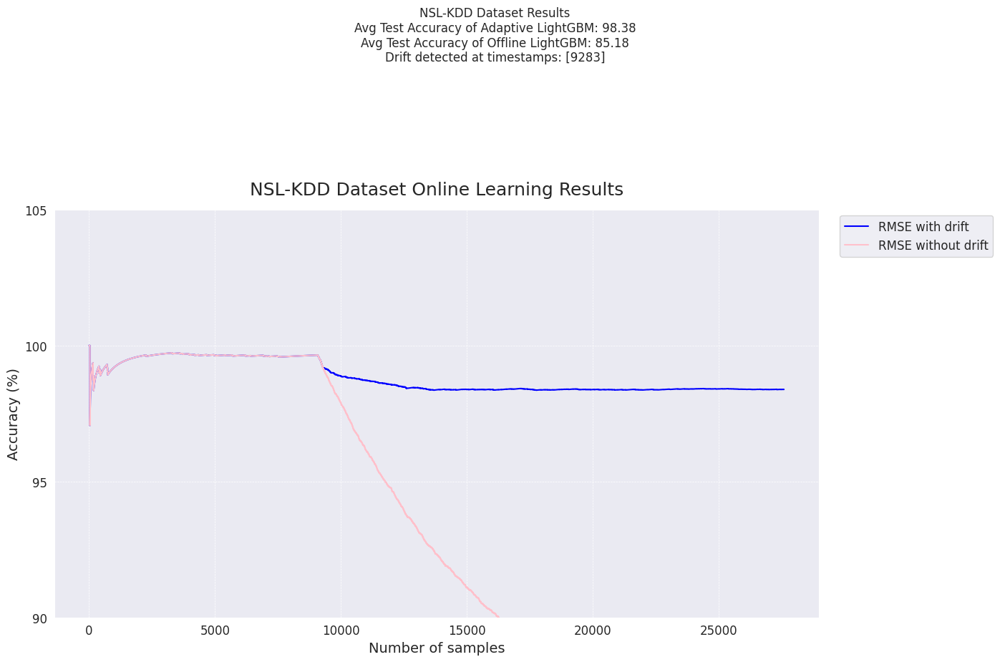

<Figure size 640x480 with 0 Axes>

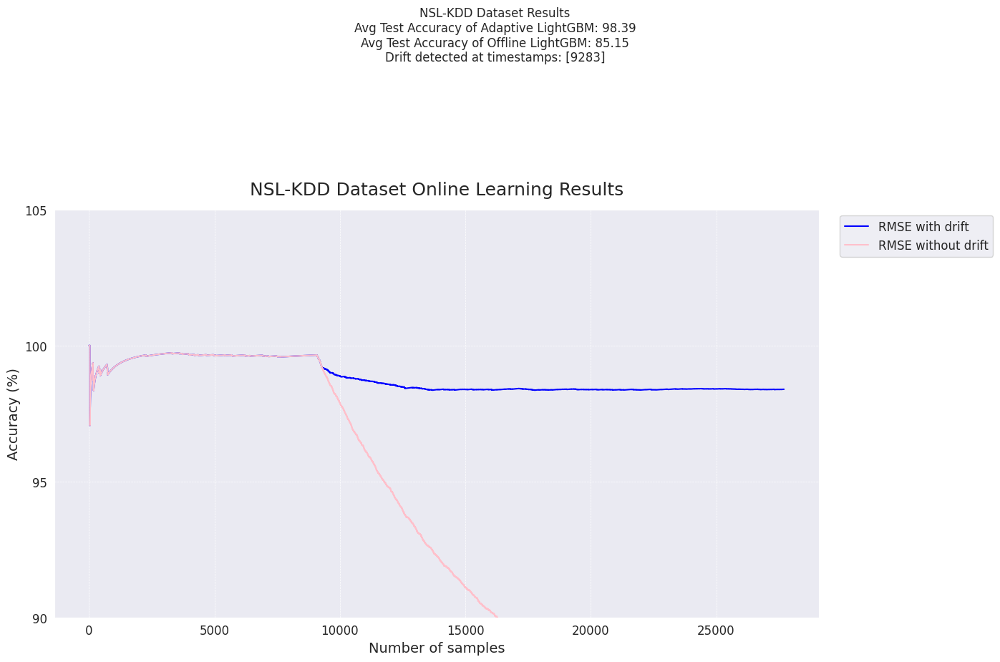

<Figure size 640x480 with 0 Axes>

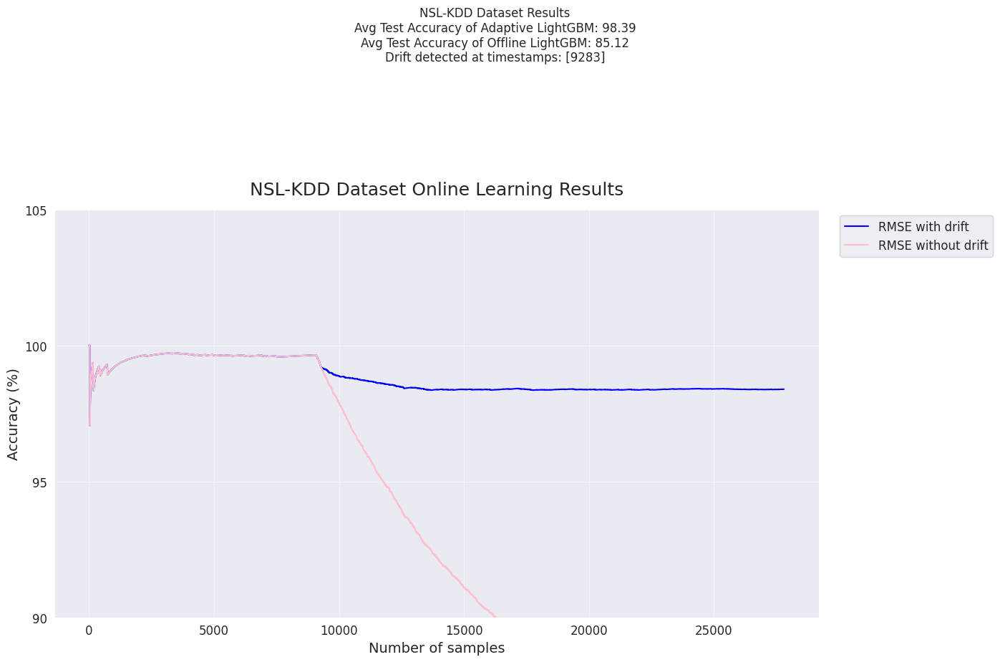

<Figure size 640x480 with 0 Axes>

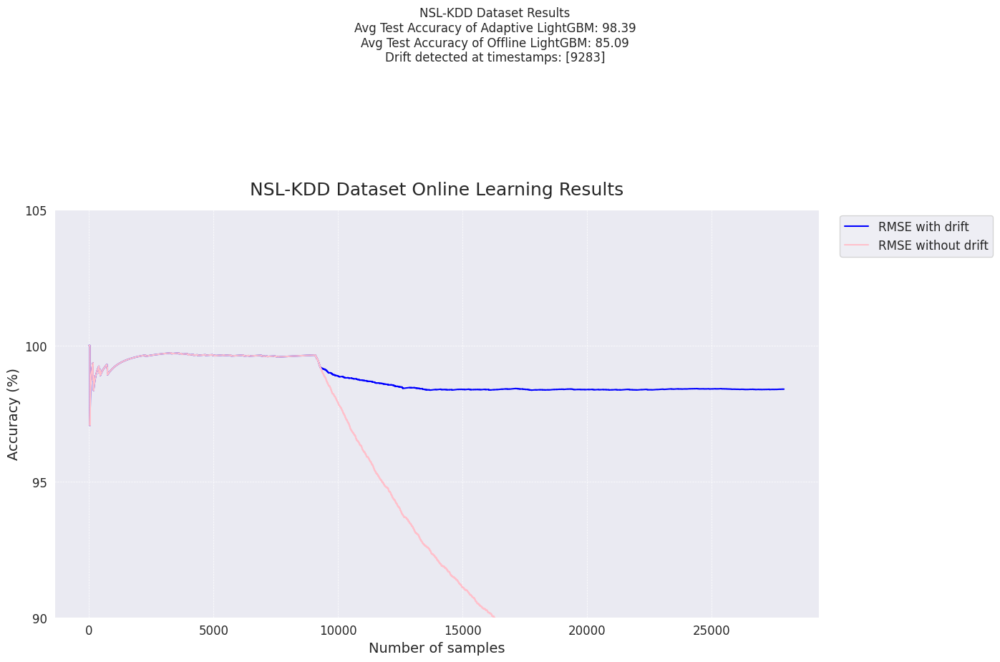

<Figure size 640x480 with 0 Axes>

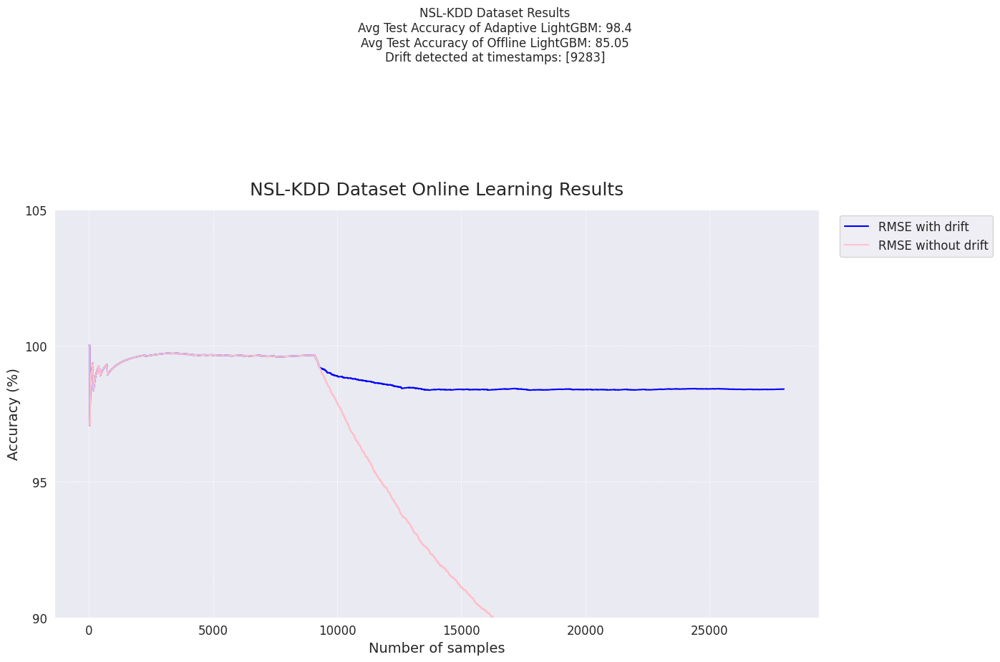

<Figure size 640x480 with 0 Axes>

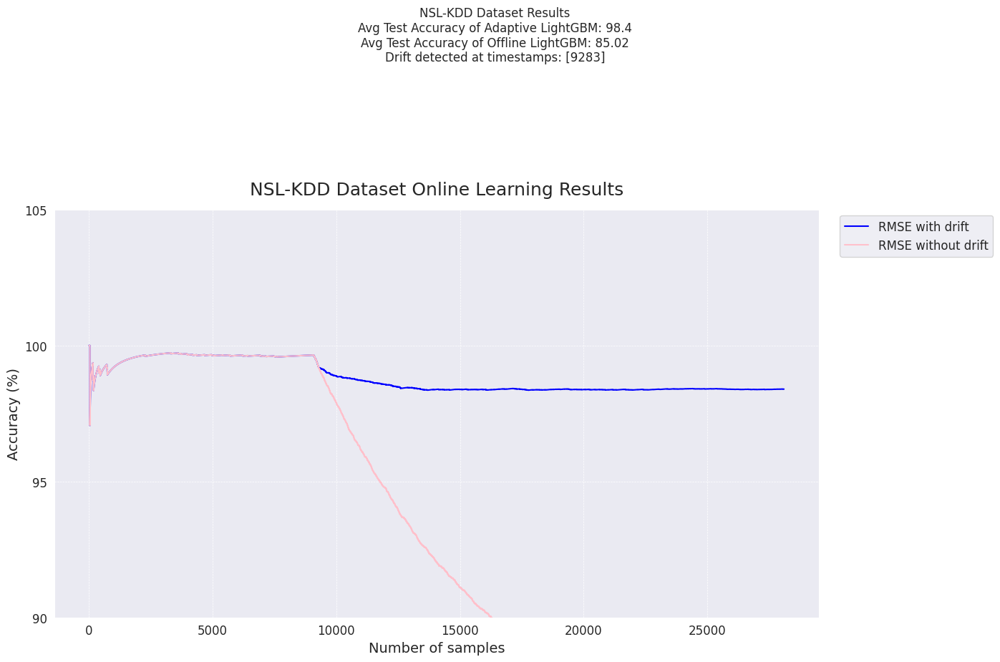

<Figure size 640x480 with 0 Axes>

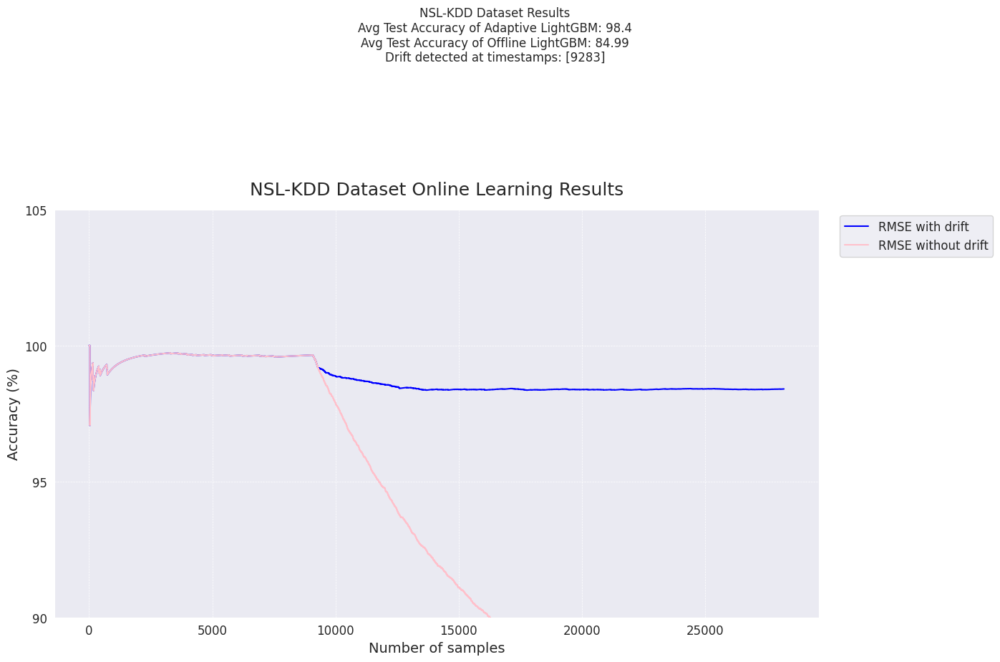

<Figure size 640x480 with 0 Axes>

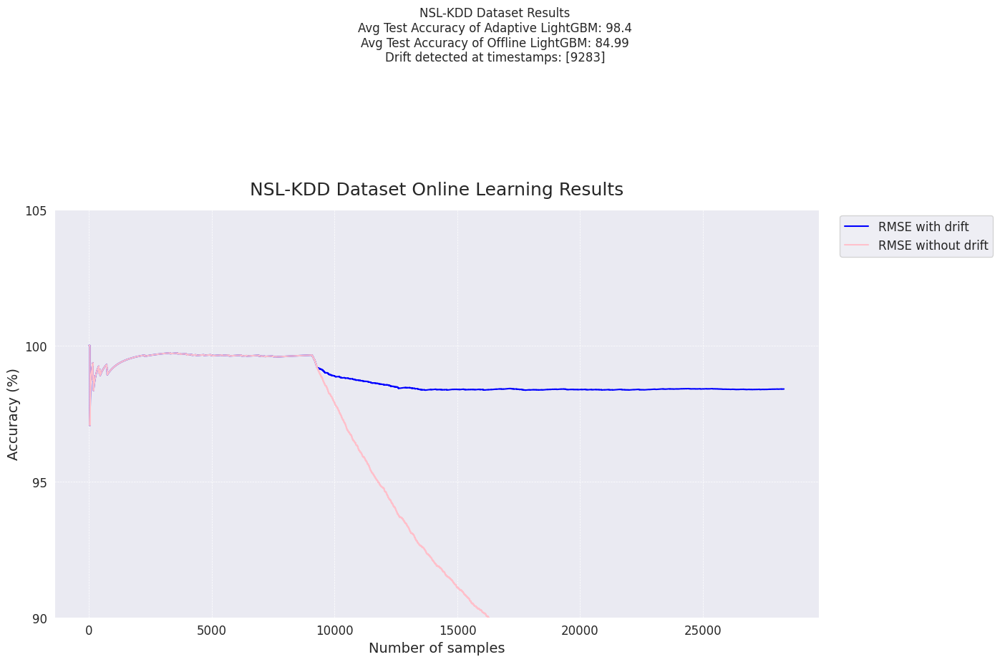

<Figure size 640x480 with 0 Axes>

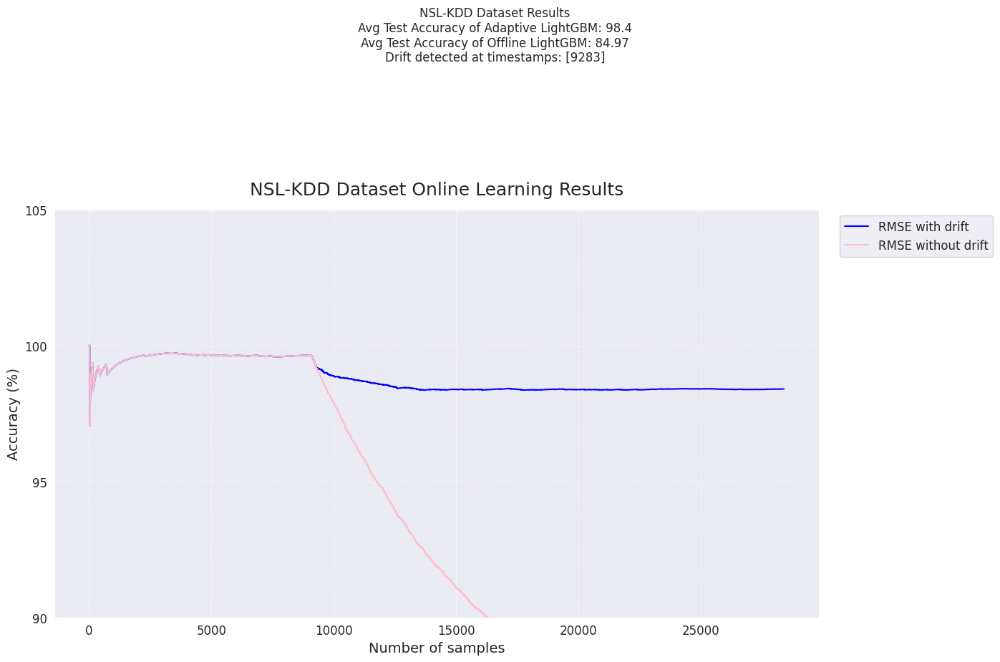

<Figure size 640x480 with 0 Axes>

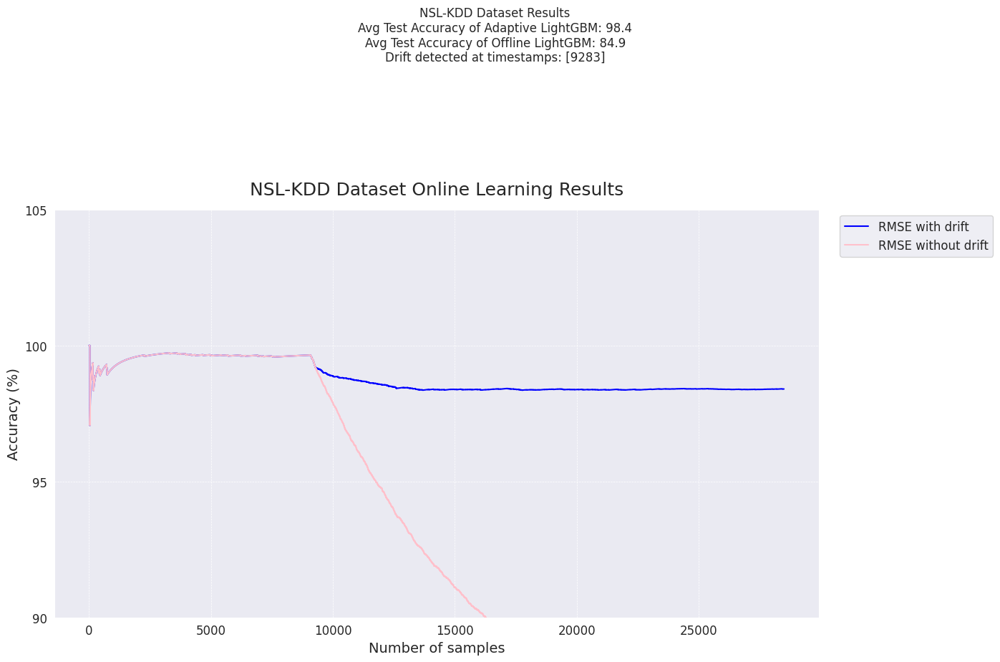

<Figure size 640x480 with 0 Axes>

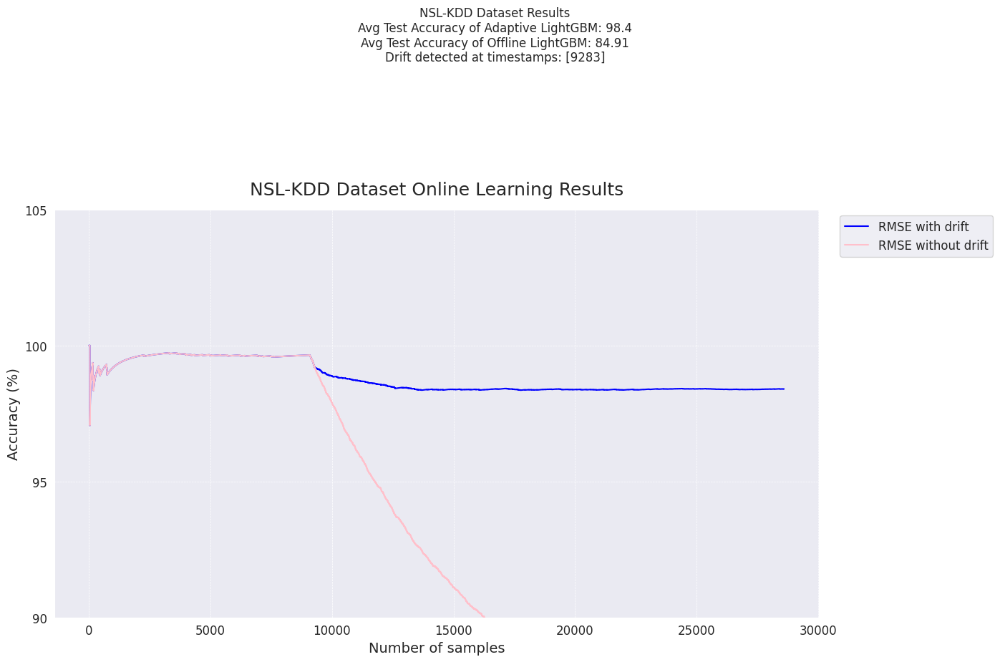

<Figure size 640x480 with 0 Axes>

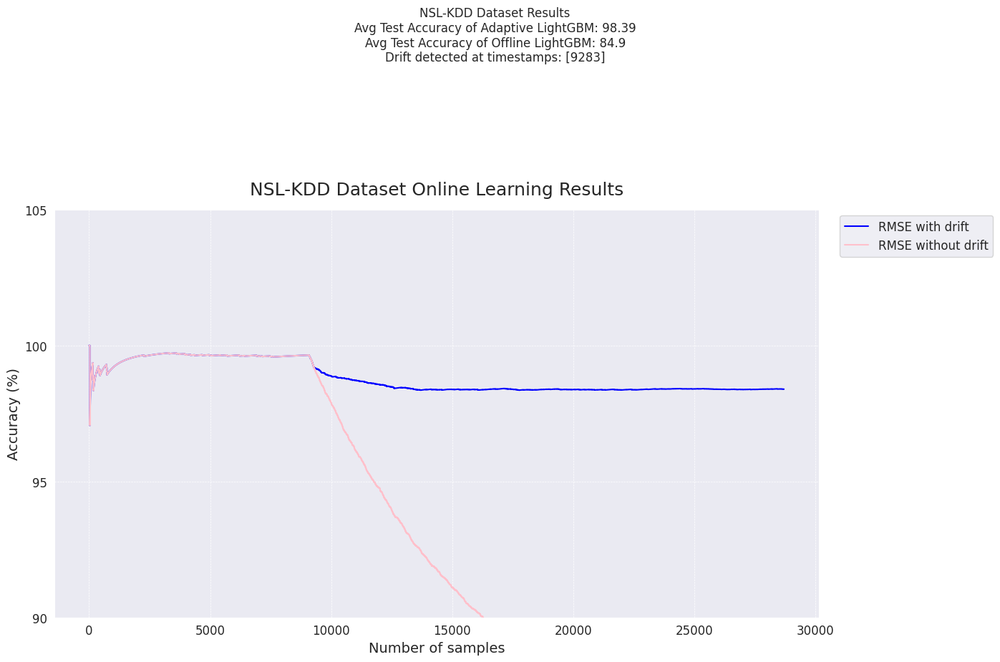

<Figure size 640x480 with 0 Axes>

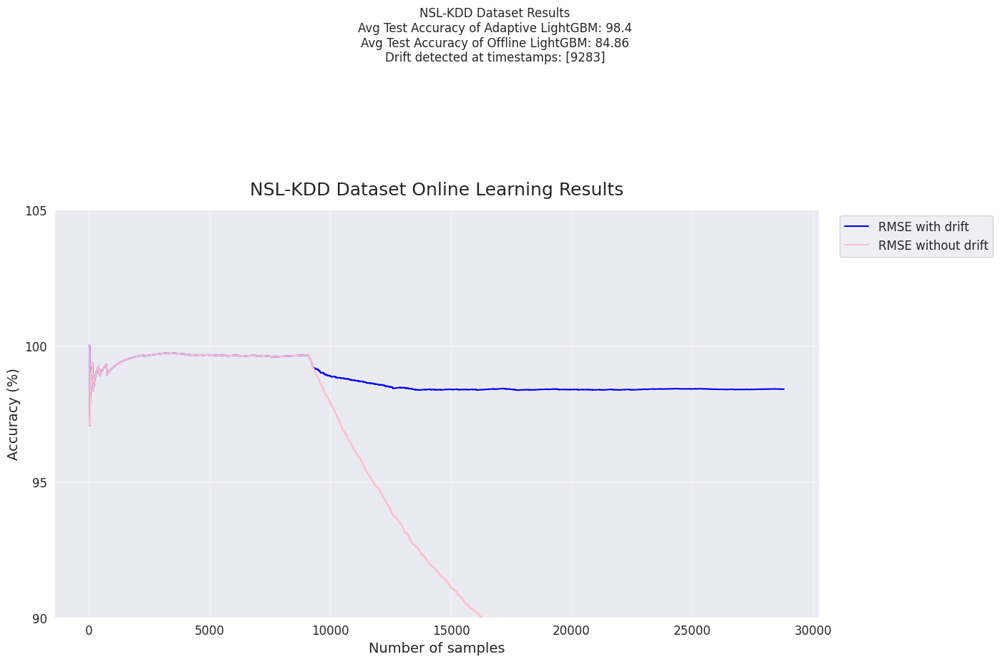

<Figure size 640x480 with 0 Axes>

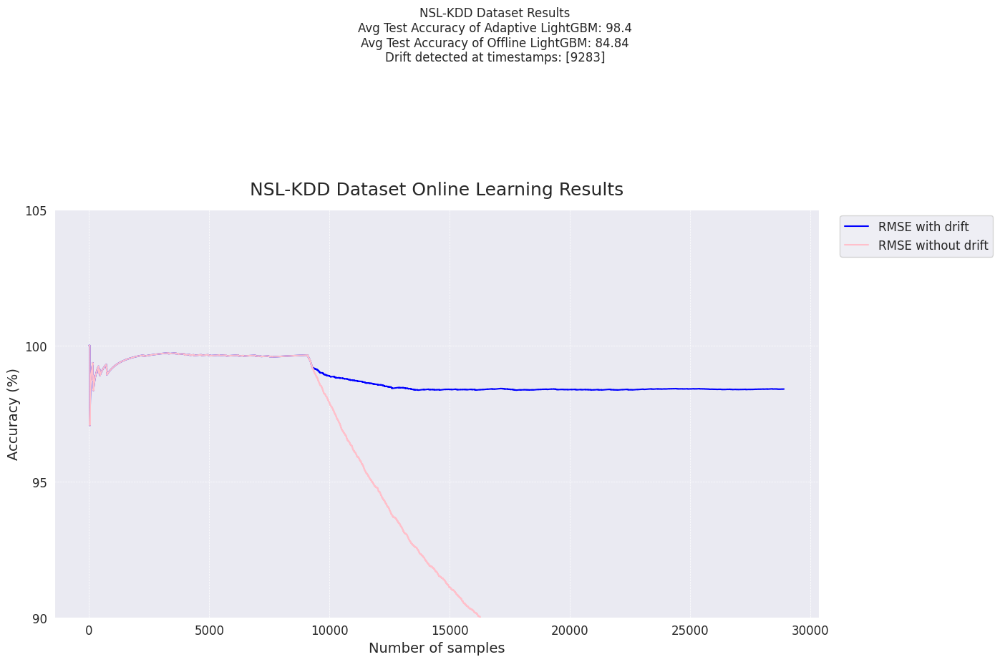

<Figure size 640x480 with 0 Axes>

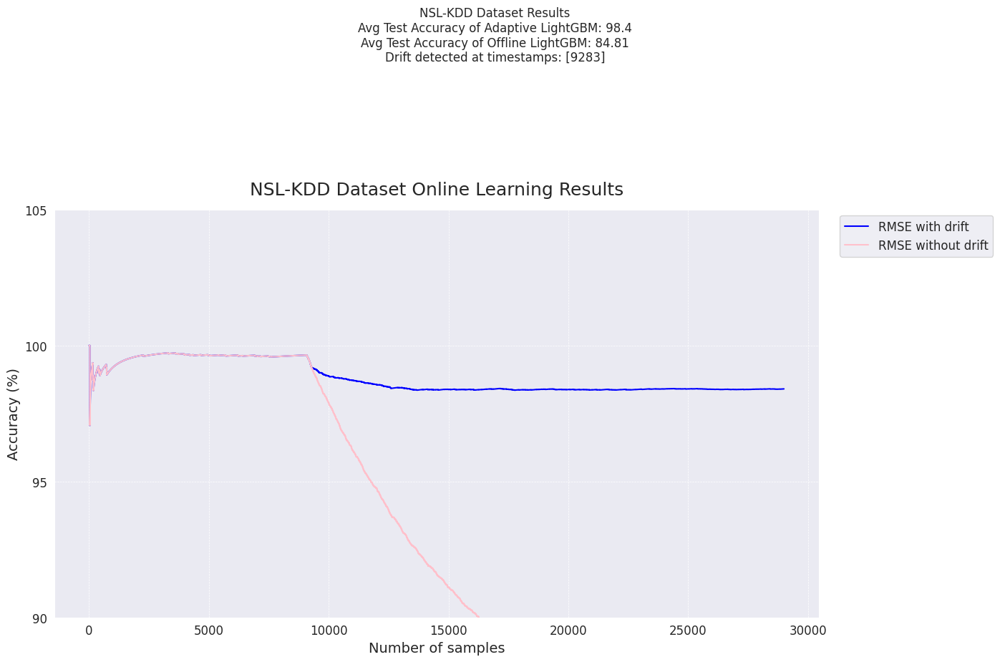

<Figure size 640x480 with 0 Axes>

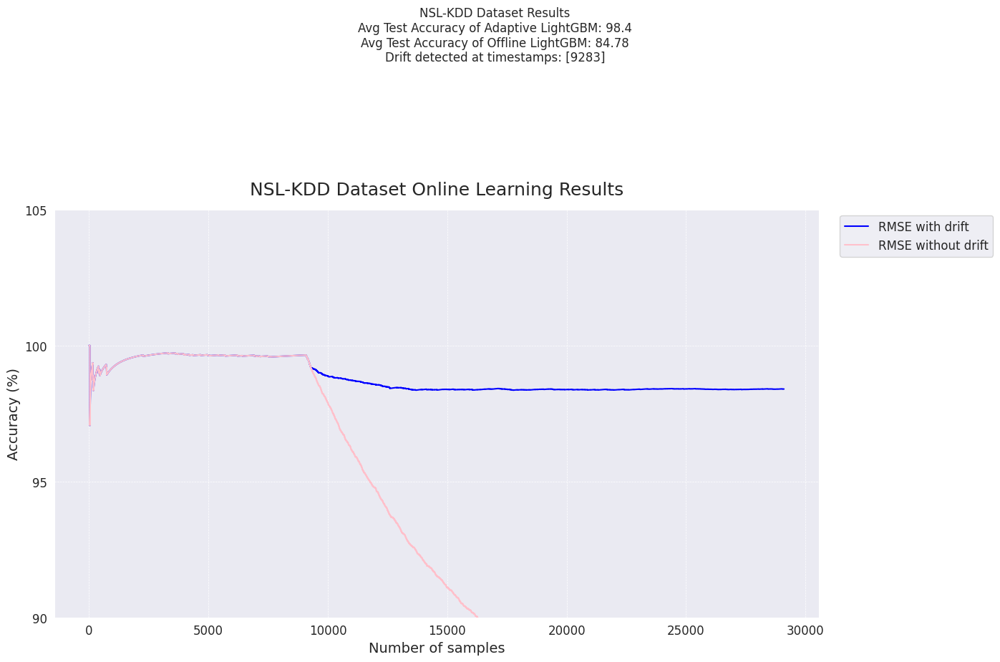

<Figure size 640x480 with 0 Axes>

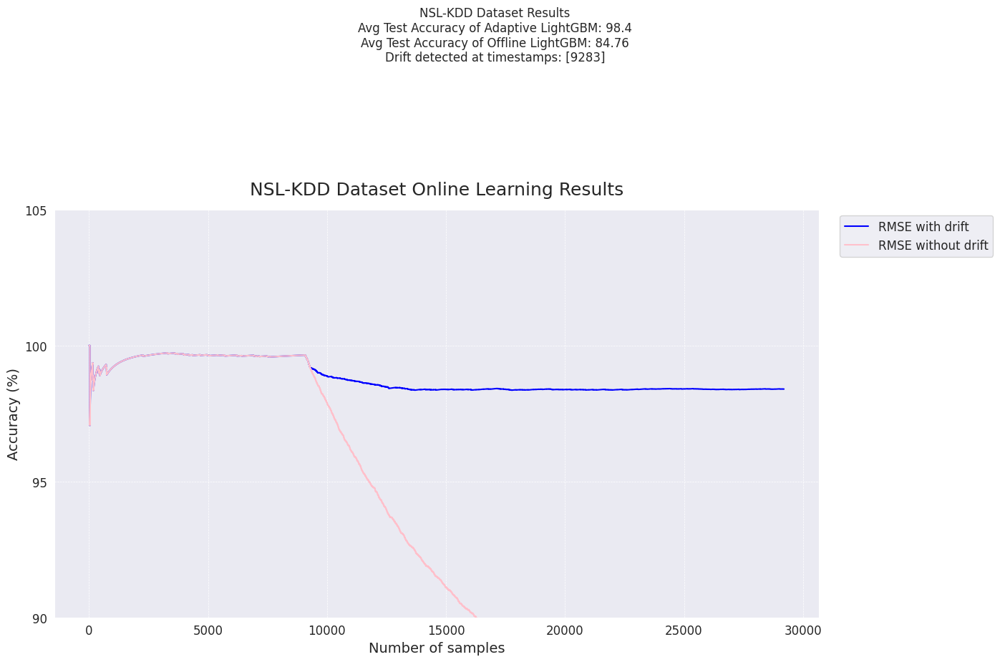

<Figure size 640x480 with 0 Axes>

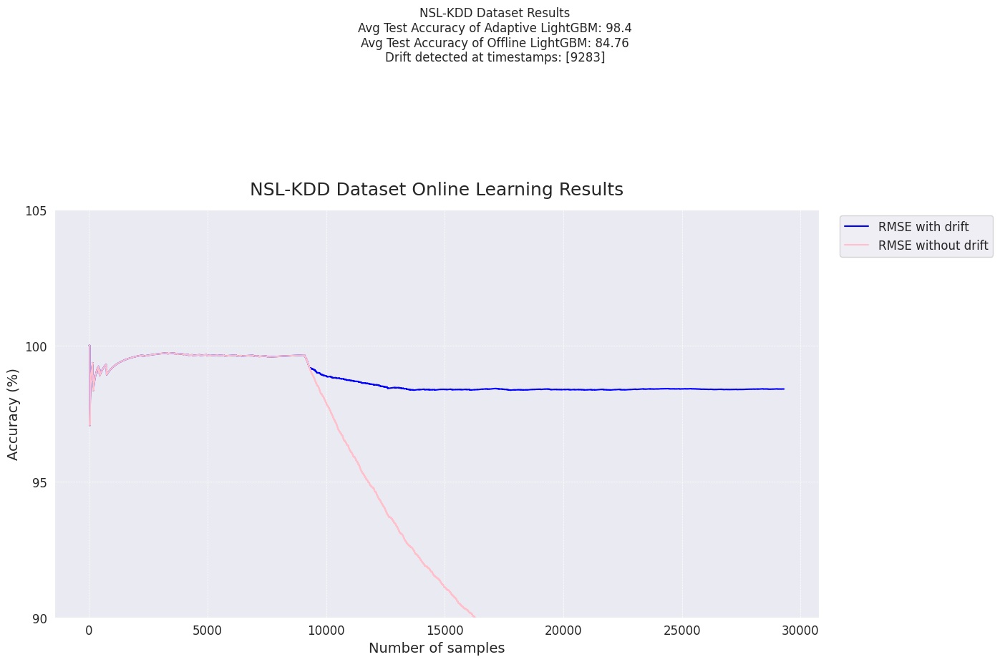

<Figure size 640x480 with 0 Axes>

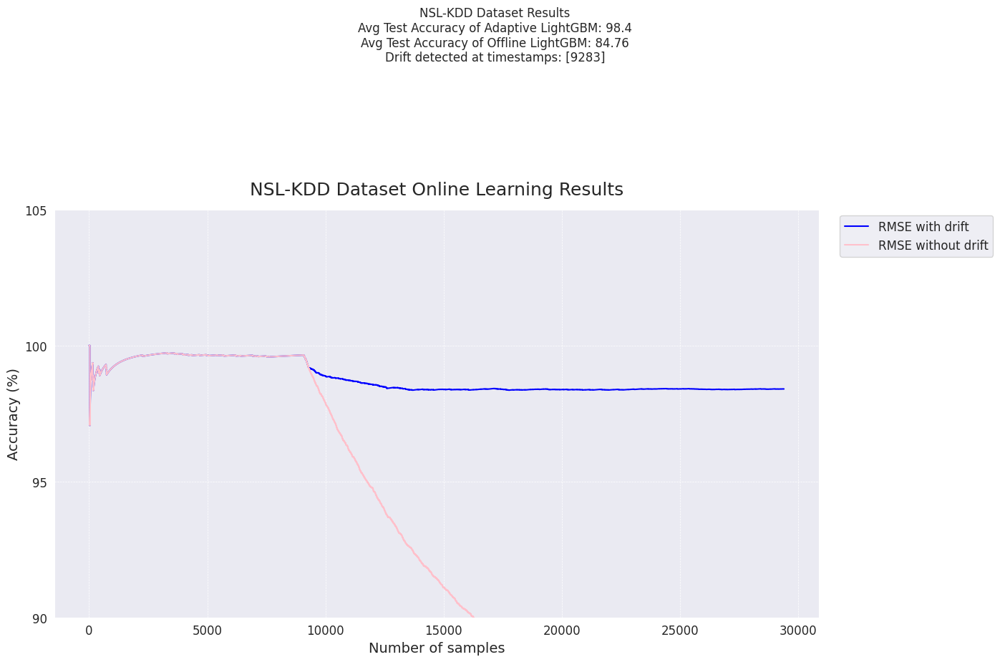

<Figure size 640x480 with 0 Axes>

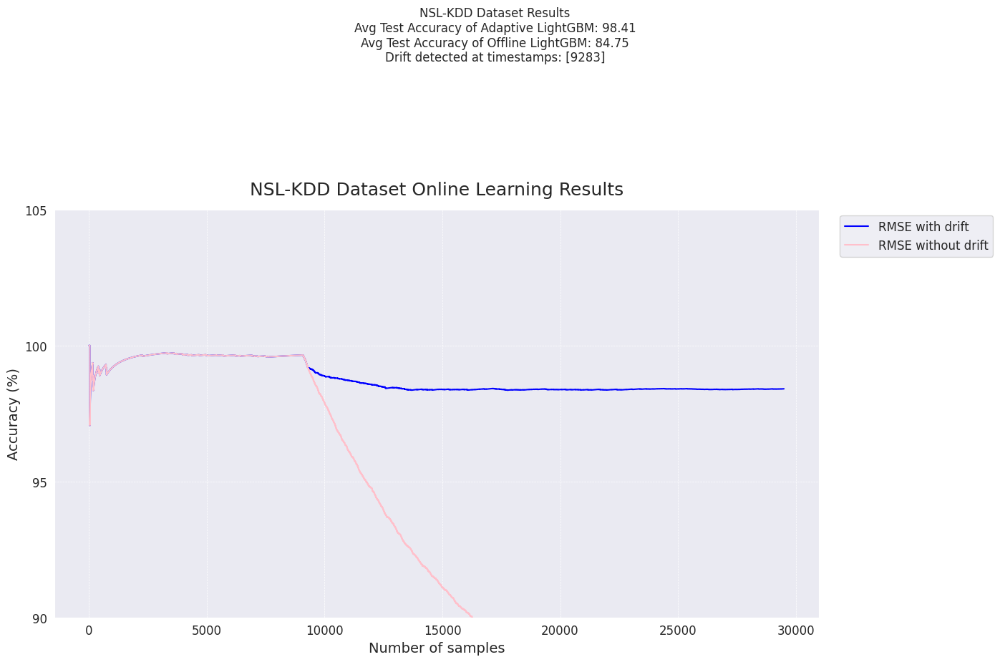

<Figure size 640x480 with 0 Axes>

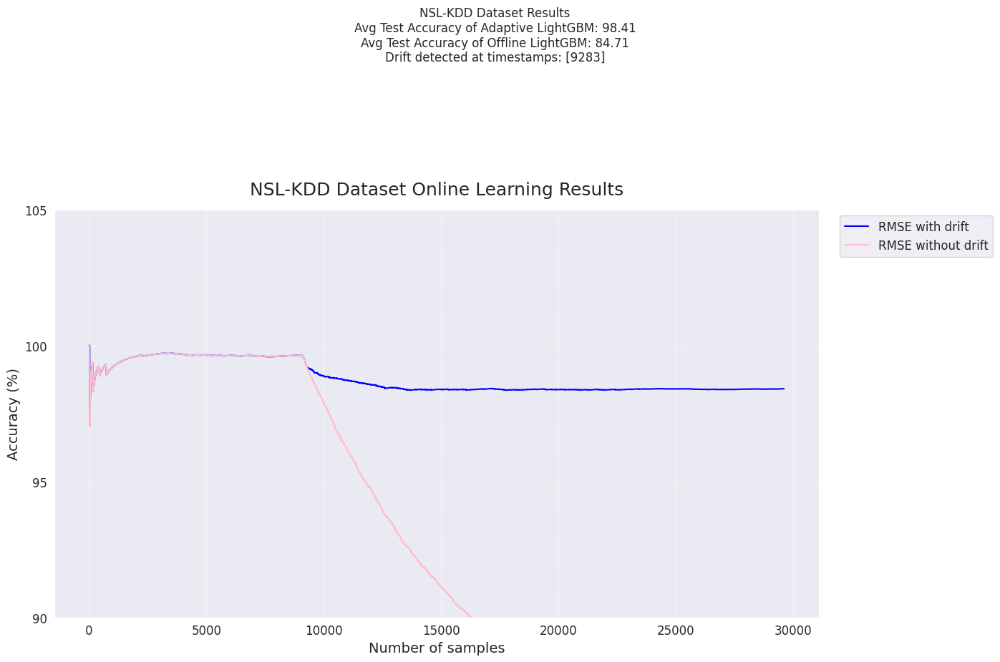

<Figure size 640x480 with 0 Axes>

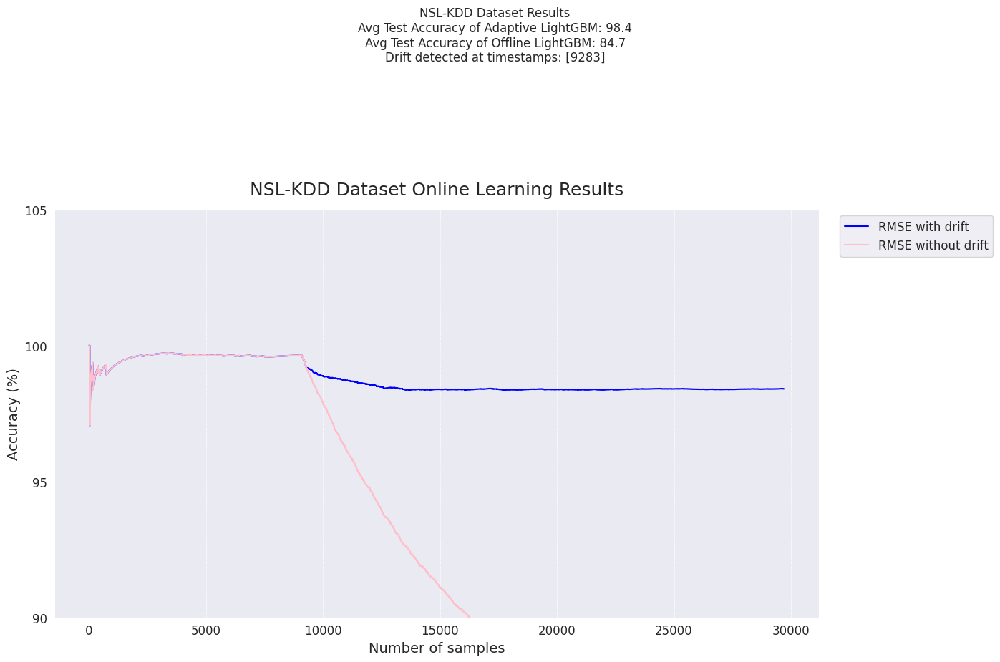

<Figure size 640x480 with 0 Axes>

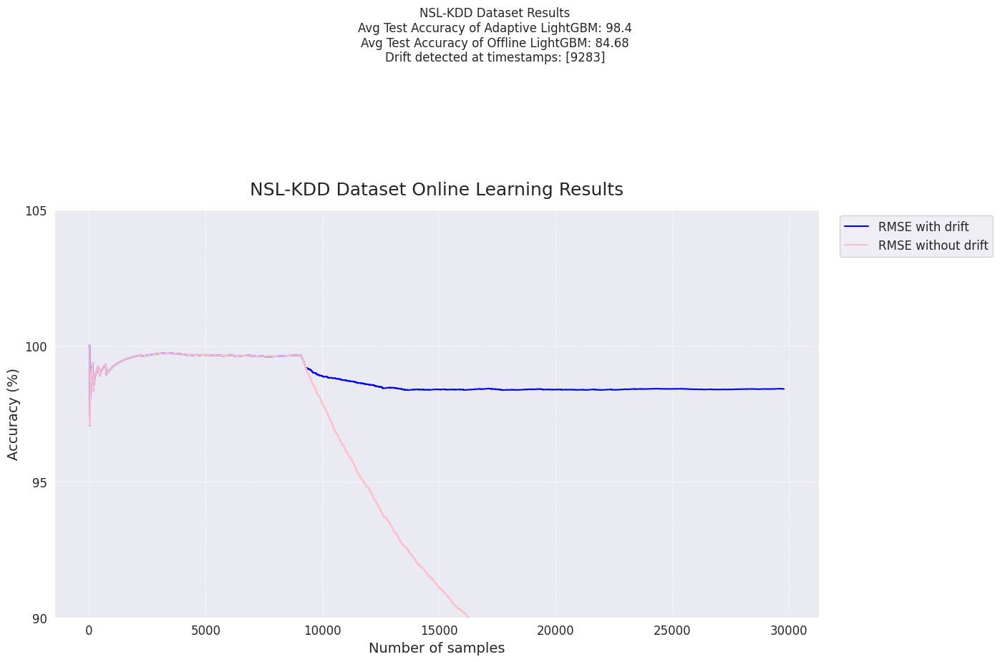

<Figure size 640x480 with 0 Axes>

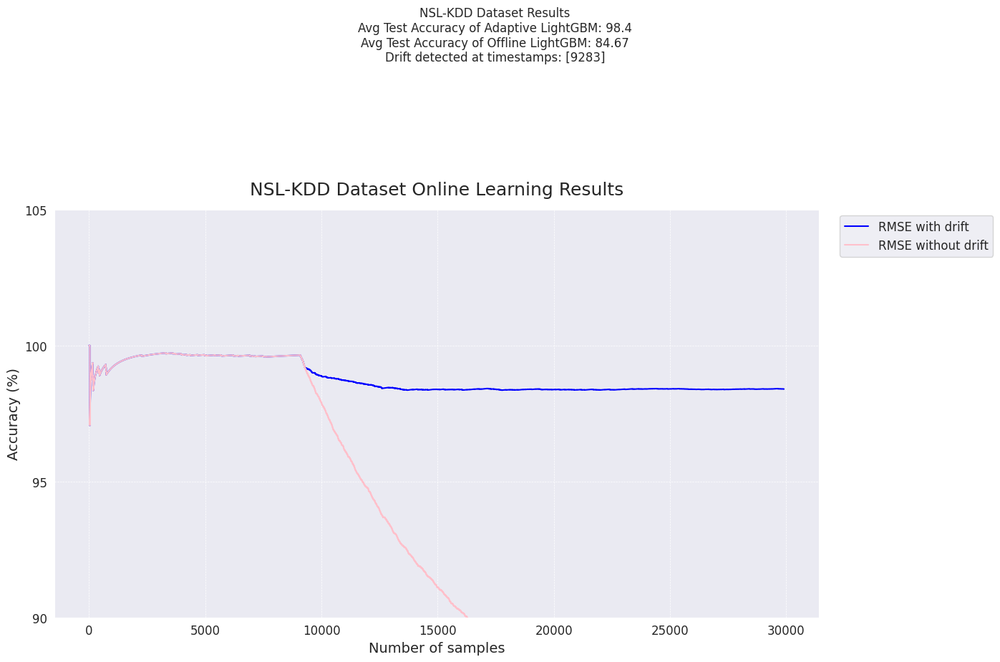

<Figure size 640x480 with 0 Axes>

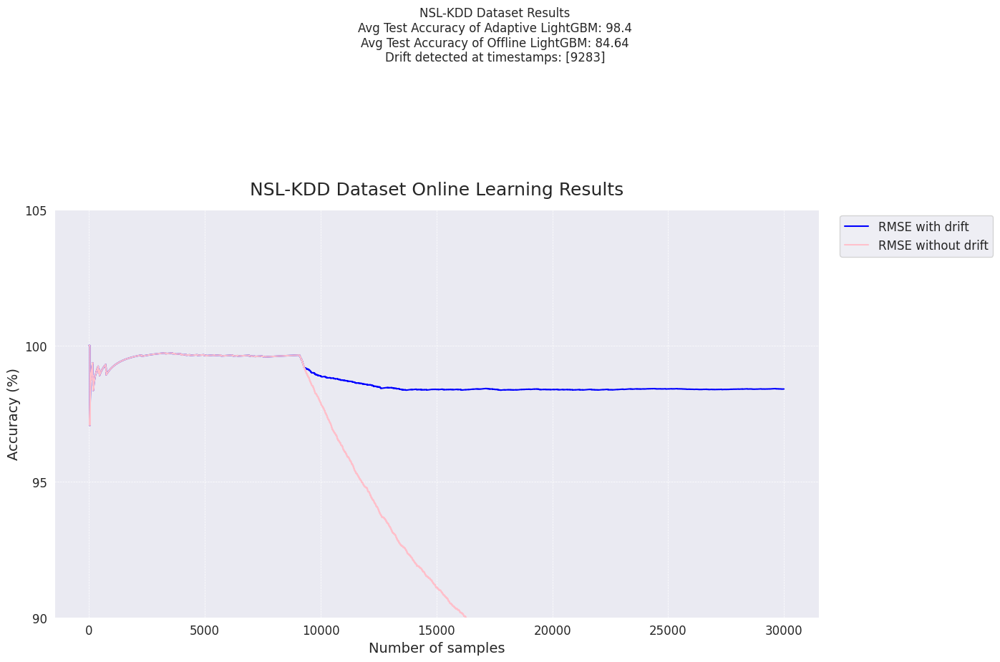

<Figure size 640x480 with 0 Axes>

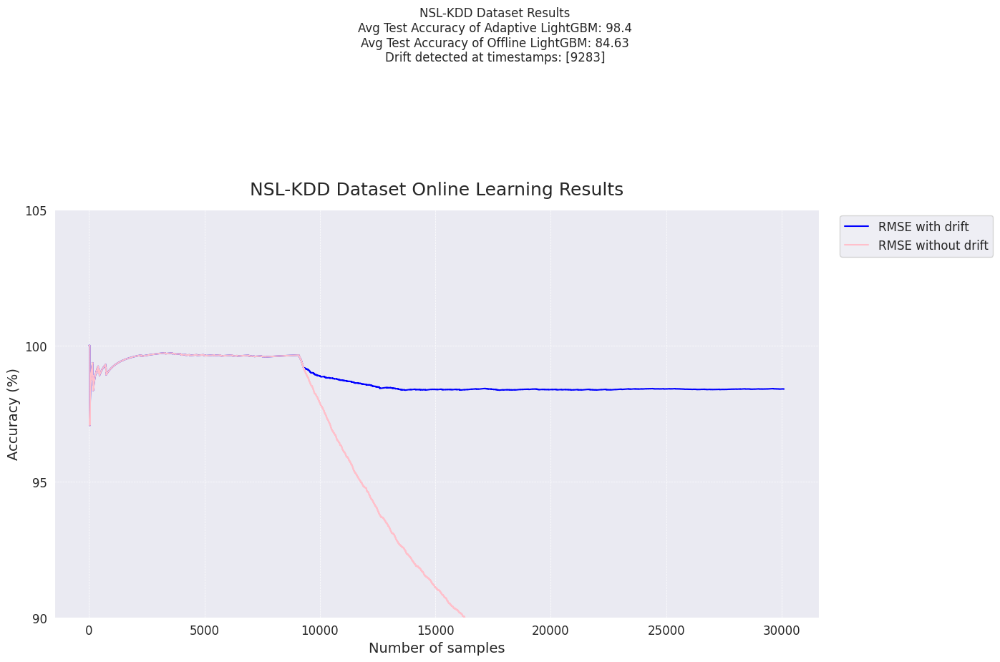

<Figure size 640x480 with 0 Axes>

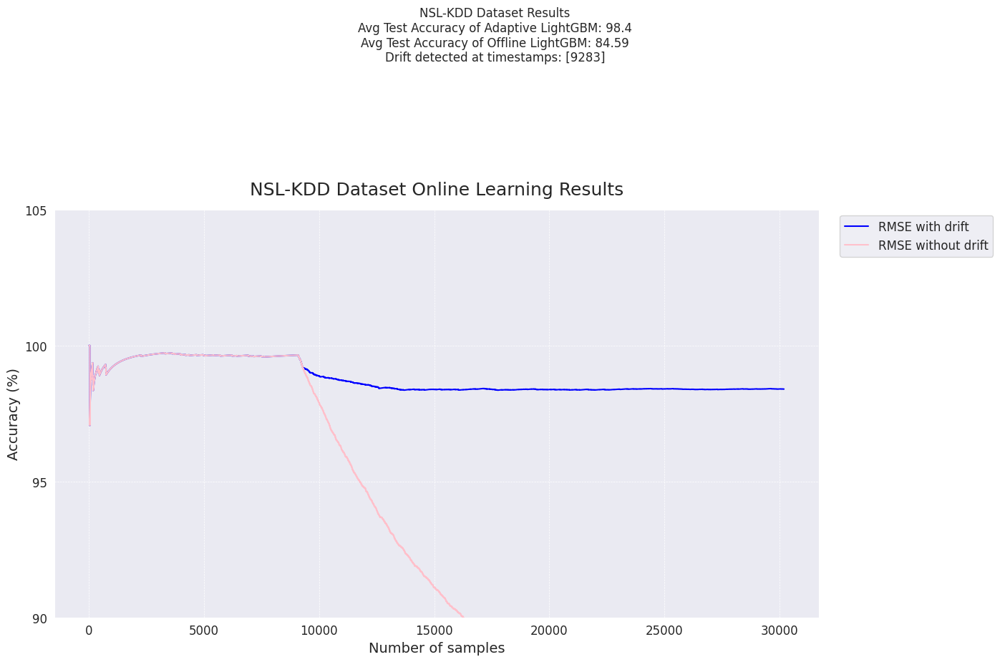

<Figure size 640x480 with 0 Axes>

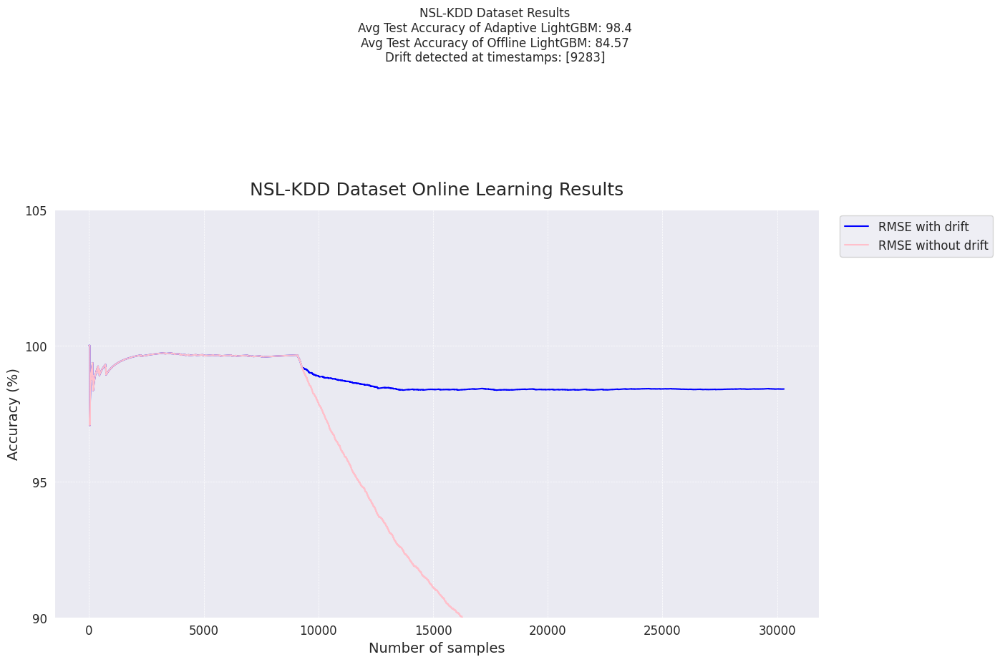

<Figure size 640x480 with 0 Axes>

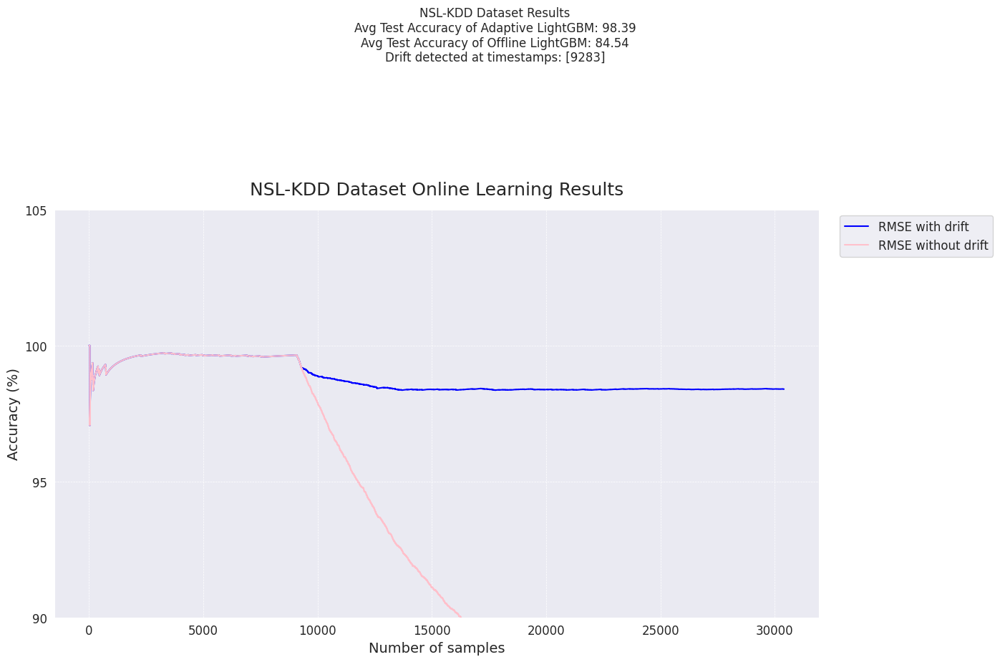

<Figure size 640x480 with 0 Axes>

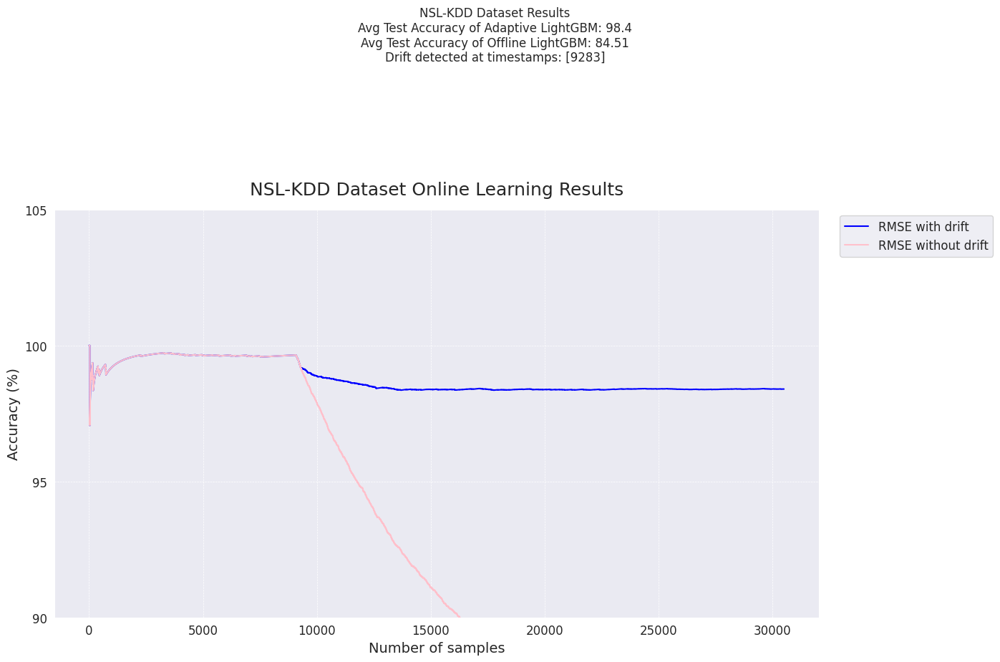

<Figure size 640x480 with 0 Axes>

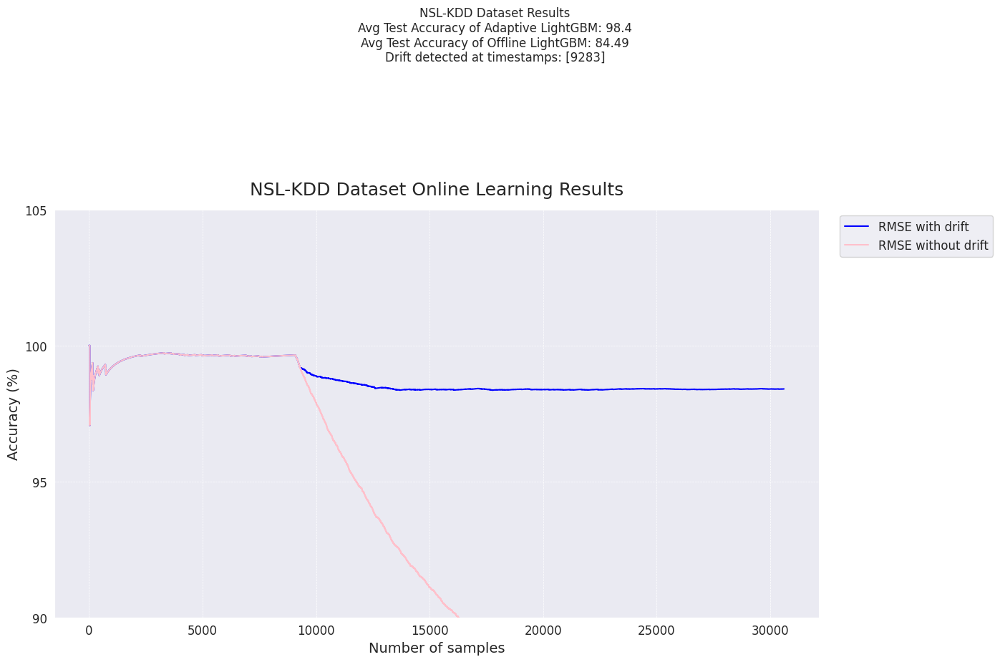

<Figure size 640x480 with 0 Axes>

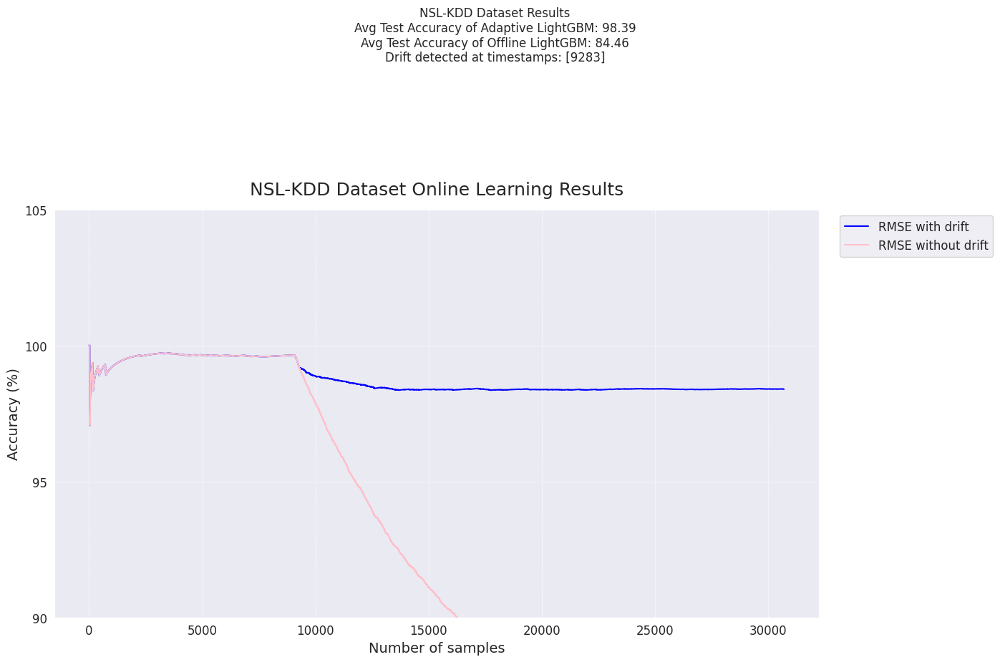

<Figure size 640x480 with 0 Axes>

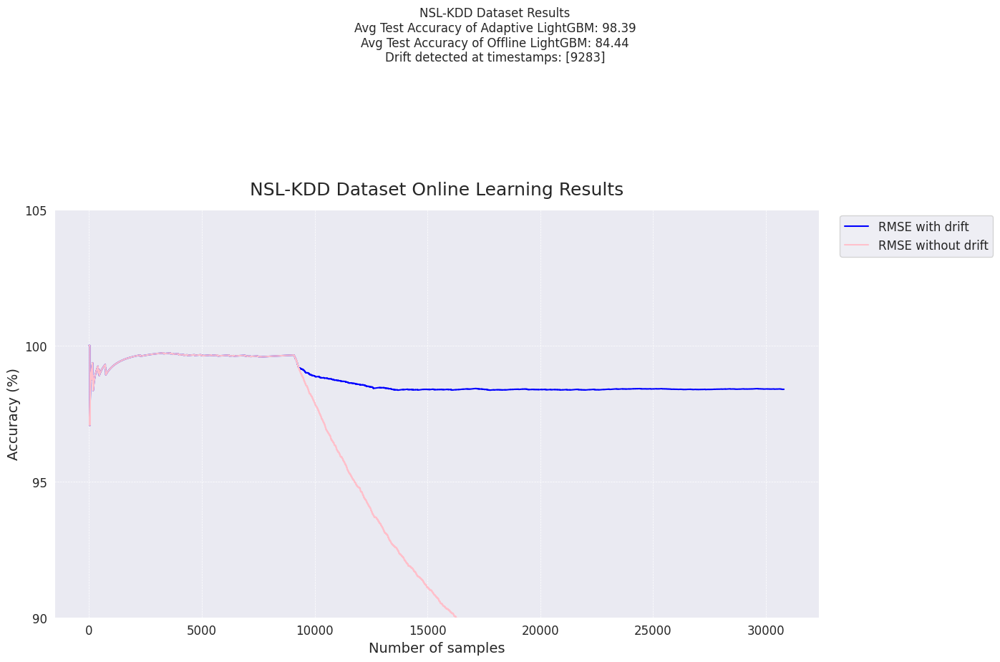

<Figure size 640x480 with 0 Axes>

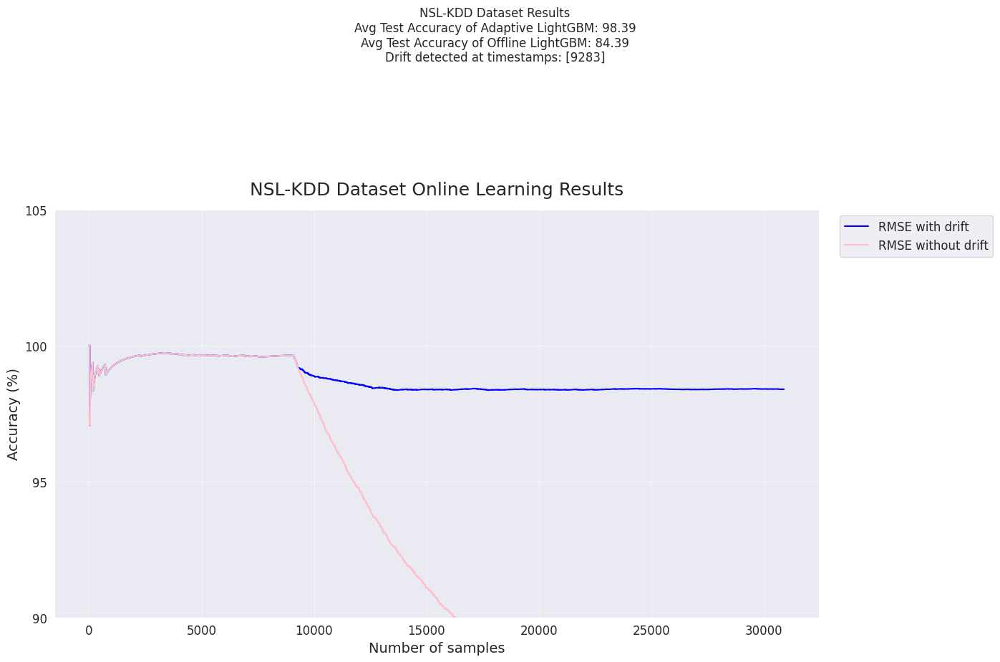

<Figure size 640x480 with 0 Axes>

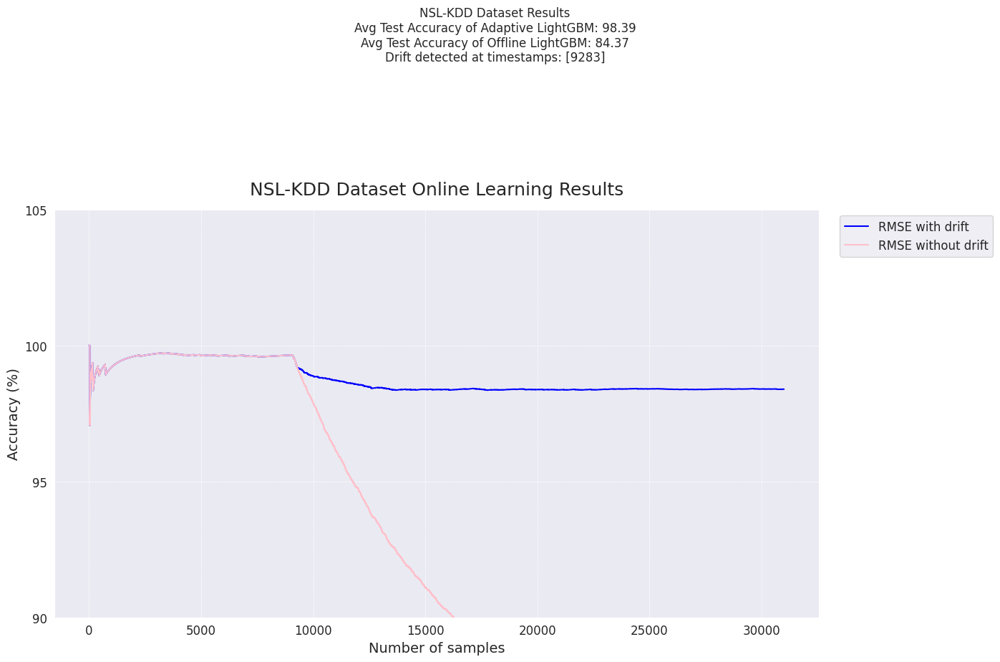

<Figure size 640x480 with 0 Axes>

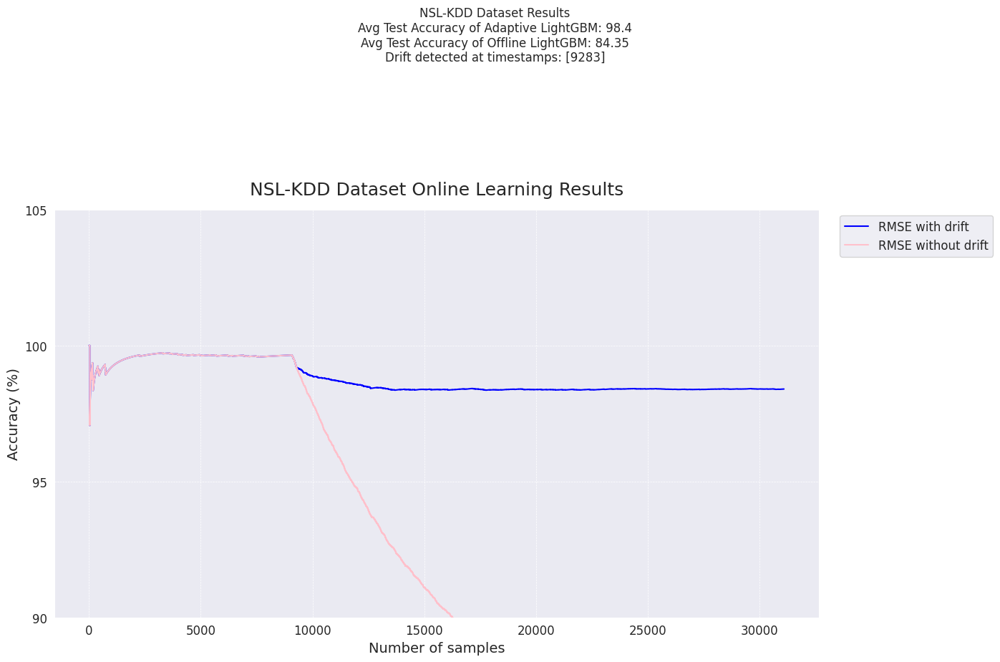

<Figure size 640x480 with 0 Axes>

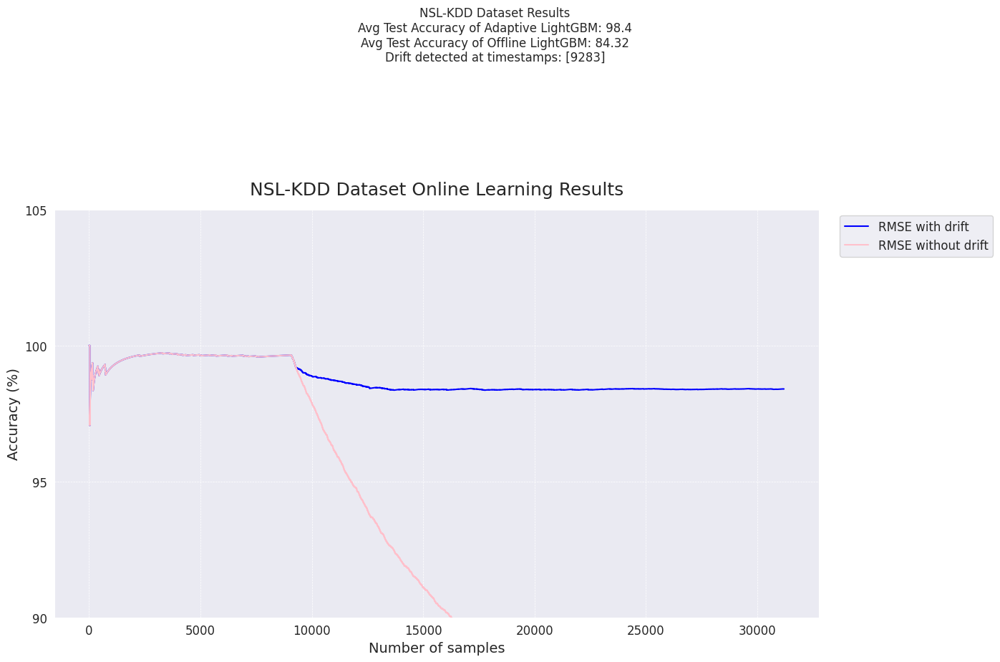

<Figure size 640x480 with 0 Axes>

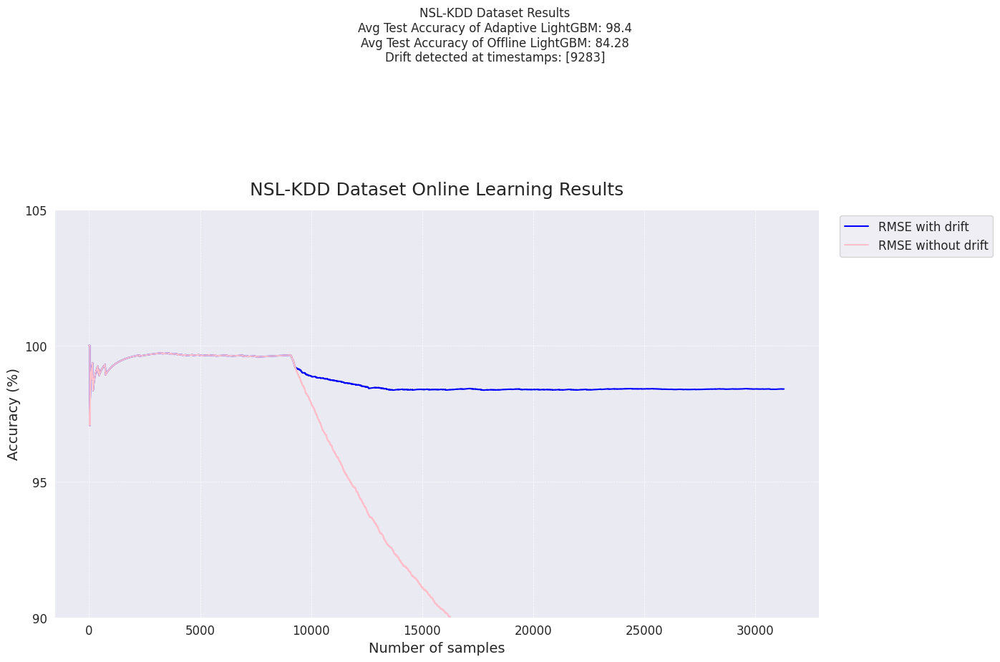

<Figure size 640x480 with 0 Axes>

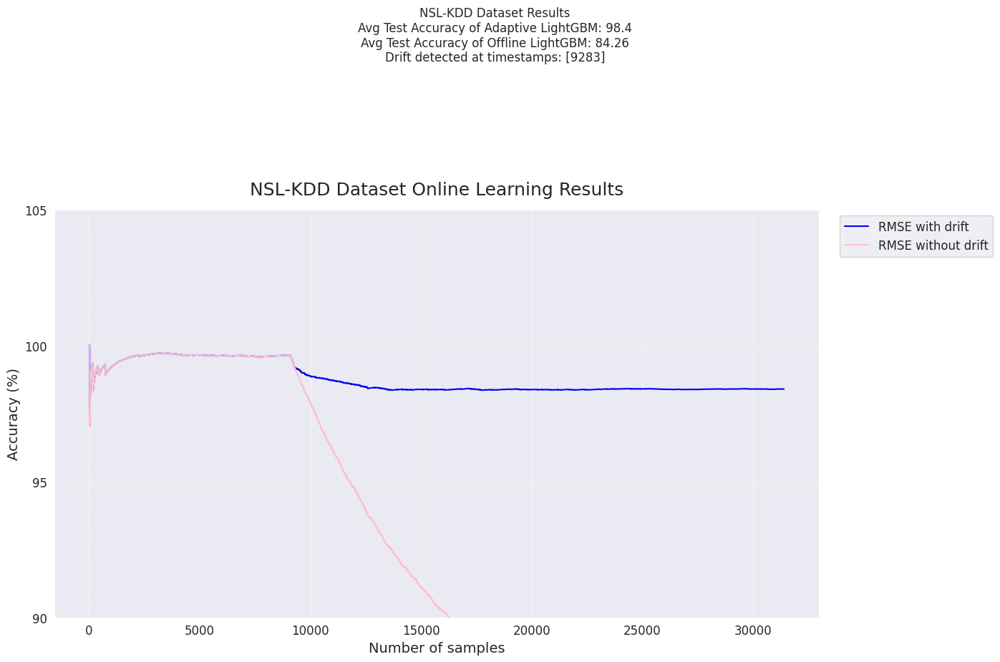

<Figure size 640x480 with 0 Axes>

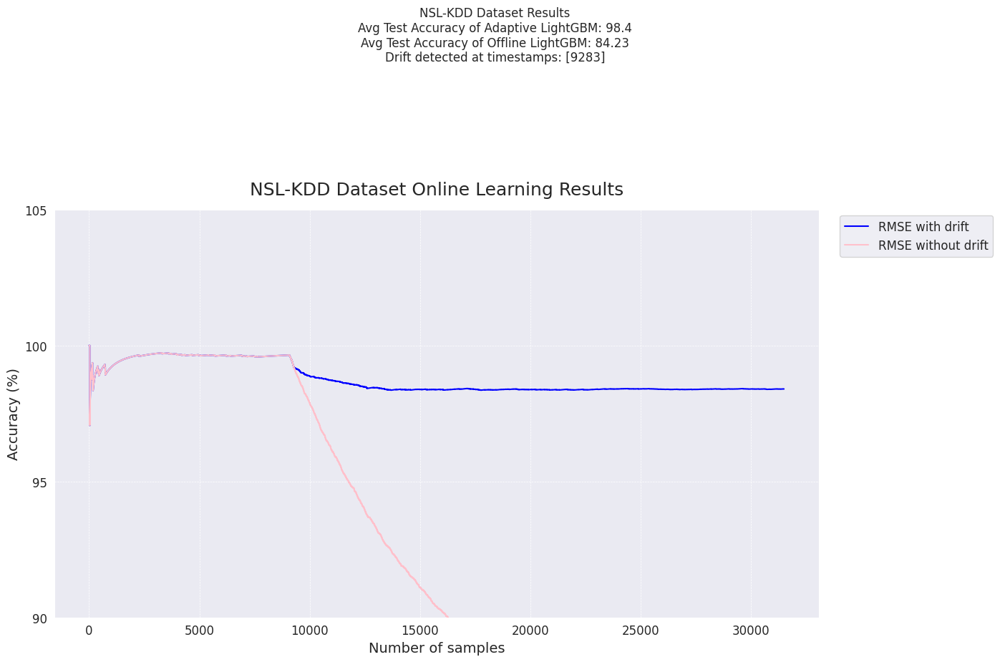

<Figure size 640x480 with 0 Axes>

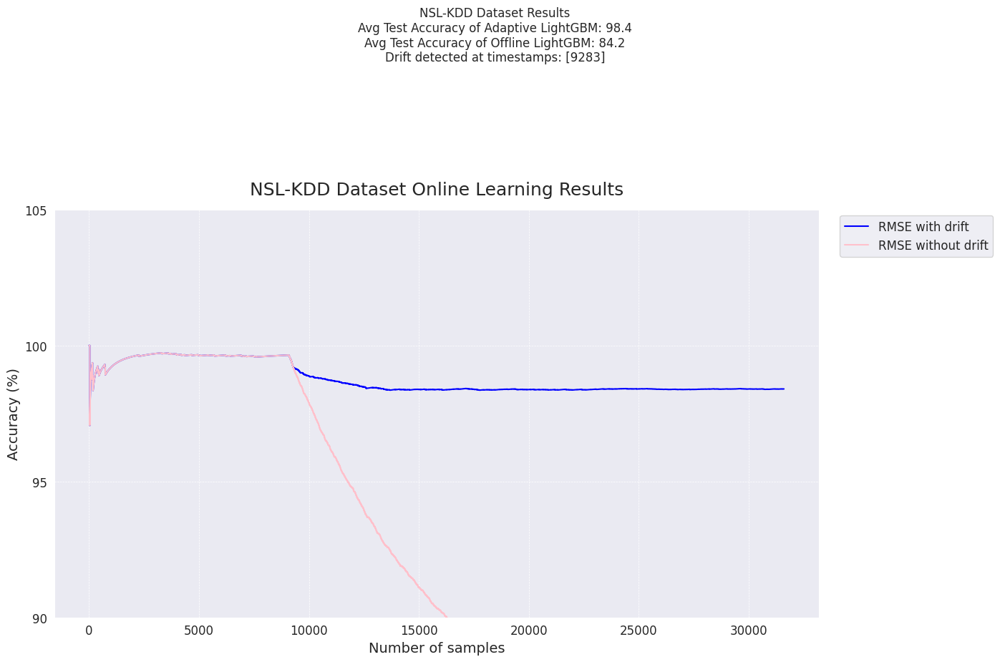

In [ ]:
oasw_real_time(a = 0.978, b = 0.931, win1 = 611, win2 = 4320)